In [136]:
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from keras.models import Sequential, Model
from keras.layers import (Dense, Conv2D, Input, MaxPool2D, 
                         UpSampling2D, Concatenate, Conv2DTranspose, 
                         Dropout, Cropping2D)
import tensorflow as tf
from keras.optimizers import Adam,SGD
from keras.initializers import he_normal
from keras.models import load_model
from scipy.misc import imresize
from skimage.measure import label as label_shape
from PIL import Image
from tqdm import tqdm
from sklearn.model_selection import train_test_split
import os
from keras.preprocessing.image import (array_to_img, img_to_array, 
                                       load_img, ImageDataGenerator)
from keras.callbacks import (Callback, ModelCheckpoint, CSVLogger, 
                             ReduceLROnPlateau)
import keras.backend as K
import itchat
from wechat_utils import SendMessage
import random
from importlib import reload
import pickle

import pdb
import gc
import sys

In [39]:
import keras
keras.__version__

'2.0.6'

## Prepare the data

In [40]:
# Set the necessary directories
data_dir = '../data/train/'
mask_dir = '../data/train_masks/'
data2_dir = '../data2/'
all_images = os.listdir(data_dir)

In [41]:
!mkdir tmp

mkdir: cannot create directory ‘tmp’: File exists


In [43]:
tmp_dir = './tmp/u-net-valid-padding-train-time-padding/'

In [46]:
!mkdir ./tmp/u-net-valid-padding-train-time-padding/

In [47]:
# Train validation split
train_images, validation_images = train_test_split(
    all_images, train_size=0.8, test_size=0.2)

In [48]:
# original size 1280, 1918
image_size = [906, 640]
input_dims = [572, 572]
output_dims = [388, 388]
batch_size = 4

In [49]:
# Utility function to convert greyscale images to rgb
def grey2rgb(img):
    new_img = []
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            new_img.append(list(img[i][j]) * 3)
    new_img = np.array(new_img).reshape(img.shape[0], img.shape[1], 3)
    return new_img

In [50]:
def read_image_and_mask(data_dir, mask_dir, image):
    return (load_img(data_dir + image), 
            load_img(mask_dir + image.split('.')[0] + '_mask.gif'))

In [51]:
def show_image_and_mask(image, mask):
    plt.figure()
    plt.subplot(121)
    plt.imshow(image)
    plt.subplot(122)
    plt.imshow(mask)

(572, 572)
[[ 200.  201.  196.]
 [ 200.  201.  196.]
 [ 200.  201.  196.]
 ..., 
 [ 196.  195.  200.]
 [ 196.  195.  200.]
 [ 196.  195.  200.]]


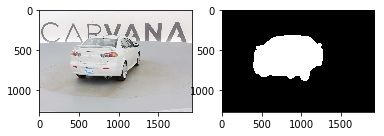

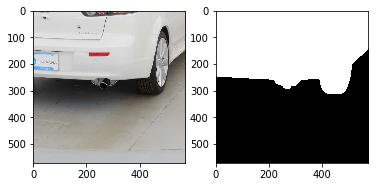

In [52]:
def random_crop(image_pair, dims):
    image, mask = image_pair
    w, h = image.size
    x_s = random.randint(0, w - dims[1])
    y_s = random.randint(0, h - dims[0])
    box = (x_s, y_s, x_s+dims[1], y_s+dims[0])
    image = image.crop(box)
    mask = mask.crop(box)
    return image, mask
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_, mask_ = random_crop((image_, mask_), input_dims)
show_image_and_mask(image_, mask_)
print (image_.size)
print (img_to_array(image_)[:, input_dims[1]-1])

In [53]:
%%time
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
image_ = image_.resize(image_size, resample=Image.BILINEAR)
mask_ = mask_.resize(image_size, resample=Image.BILINEAR)

CPU times: user 88 ms, sys: 0 ns, total: 88 ms
Wall time: 95.3 ms


In [54]:
%%time
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

CPU times: user 120 ms, sys: 0 ns, total: 120 ms
Wall time: 125 ms


(906, 640)
[[ 241.  237.  238.]
 [ 241.  237.  238.]
 [ 241.  237.  238.]
 ..., 
 [ 193.  197.  200.]
 [ 193.  197.  200.]
 [ 193.  197.  200.]]


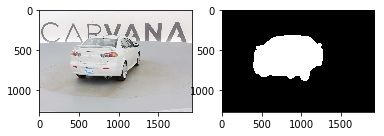

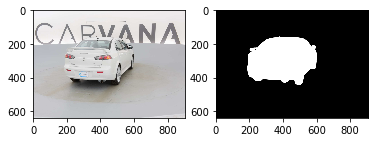

In [55]:
def resize_image(image_pair, dims):
    image, mask = image_pair
    image = image.resize(dims, resample=Image.BILINEAR)
    mask = mask.resize(dims, resample=Image.BILINEAR)
    return image, mask
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_, mask_ = resize_image((image_, mask_), image_size)
show_image_and_mask(image_, mask_)
print (image_.size)
print (img_to_array(image_)[:, input_dims[1]-1])

(1918, 1280)
[[ 240.  240.  240.]
 [ 240.  240.  240.]
 [ 240.  240.  240.]
 ..., 
 [ 190.  194.  197.]
 [ 190.  194.  197.]
 [ 190.  194.  197.]]


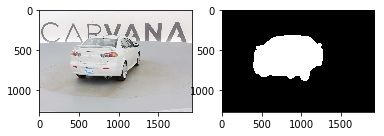

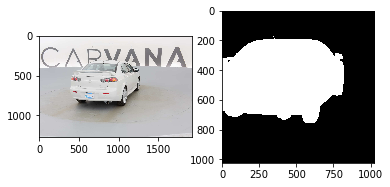

In [56]:
def cut_mask(image_pair, dims):
    assert dims[0] % 2 == 0 and dims[1] % 2 == 0, 'Output dims must be even numbers.'
    image, mask = image_pair
    # Because the image size is reversed of what we defined
    original_dims = image.size[::-1]
    x_s = (original_dims[1] - dims[1]) / 2
    y_s = (original_dims[0] - dims[0]) / 2
    box = (x_s, y_s, x_s+dims[1], y_s+dims[0])
    mask = mask.crop(box)
    return image, mask
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_, mask_ = cut_mask((image_, mask_), [1024, 1024])
show_image_and_mask(image_, mask_)
print (image_.size)
print (img_to_array(image_)[:, input_dims[1]-1])

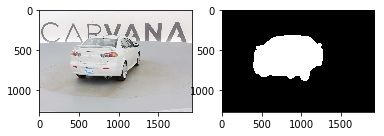

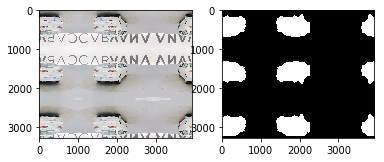

In [58]:
def pad_image_and_mask(image_pair, pad_width, mode='symmetric'):
    """
    Padding the image and mask, the mode is 
    same as the one in numpy.pad
    
    # Args 
    image_pair:      PIL Image or array
    pad_width:  the width to pad around the image
    
    # Return
                PIL Image padded and mask padded
    """
    image, mask = image_pair
    
    array = img_to_array(image)
    padding = ((pad_width, pad_width), (pad_width, pad_width), (0, 0))
    padded_array = np.pad(array, padding, mode=mode)
    padded_image = array_to_img(padded_array)
    
    array = img_to_array(mask)
    padding = ((pad_width, pad_width), (pad_width, pad_width), (0, 0))
    padded_array = np.pad(array, padding, mode=mode)
    padded_mask = array_to_img(padded_array)
    
    return padded_image, padded_mask
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_, mask_ = pad_image_and_mask((image_, mask_), 1000)
show_image_and_mask(image_, mask_)

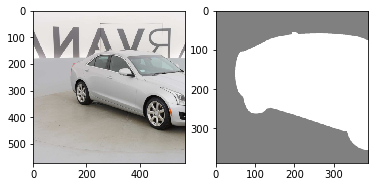

In [82]:
from data_utils import random_horizontal_flip
transform_resize = lambda image_pair: resize_image(image_pair, image_size)
transform_flip = lambda image_pair: random_horizontal_flip(image_pair, prob=0.5)
transform_pad = lambda image_pair: pad_image_and_mask(image_pair, 144)
transform_crop = lambda image_pair: random_crop(image_pair, input_dims)
transform_cut = lambda image_pair: cut_mask(image_pair, output_dims)
transforms = [transform_resize, transform_flip, transform_crop, transform_cut]

from data_utils import data_gen_small, threadsafe_iter
import data_utils
reload(data_utils)
del globals()['data_gen_small']
from data_utils import data_gen_small
            
# Example use
train_gen = data_gen_small(data_dir, mask_dir, train_images, batch_size, 
                          input_dims, transforms=transforms)
img, msk = next(train_gen)

plt.subplot(121)
plt.imshow(img[0])
plt.subplot(122)
plt.imshow(grey2rgb(msk[0]), alpha=0.5)

In [83]:
%%time
_ = next(train_gen)

CPU times: user 372 ms, sys: 0 ns, total: 372 ms
Wall time: 473 ms


In [84]:
val_gen = data_gen_small(data_dir, mask_dir, validation_images, 0, input_dims, transforms=transforms)

In [85]:
val_images, val_masks = next(val_gen)

  0%|          | 1/1018 [00:00<01:43,  9.78it/s]

Build generator, this may take some time...
total number of images: 1018


100%|██████████| 1018/1018 [01:47<00:00,  9.37it/s]


In [86]:
print (val_images.shape)
print (val_masks.shape)

(1018, 572, 572, 3)
(1018, 388, 388, 1)


In [87]:
image_, mask_ = next(train_gen)
print (image_.shape)
print (mask_.shape)
print (mask_[0].shape)
print (mask_[0][150])
print (mask_[0].sum())

(4, 572, 572, 3)
(4, 388, 388, 1)
(388, 388, 1)
[[ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.06666667]
 [ 0.34509805]
 [ 0.74117649]
 [ 0.96078432]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.        ]
 [ 1.  

## Build the network

In [88]:
# First, let's define the two different types of layers that we will 
# be using
def down(input_layer, filters, pool=True, padding='same', verbose=1):
    conv1 = Conv2D(filters, (3, 3), padding=padding, 
                   kernel_initializer=he_normal(), activation='relu')(
                   input_layer)
    residual = Conv2D(filters, (3, 3), padding=padding, 
                      kernel_initializer=he_normal(), activation='relu')(
                      conv1)
    if pool:
        max_pool = MaxPool2D()(residual)
        if verbose:
            print ('Down output shape')
            print ('max_pool {}, residual {}'.format(K.int_shape(max_pool), K.int_shape(residual)))
        return max_pool,residual
    else:
        if verbose:
            print ('Down output shape')
            print ('residual {}'.format(K.int_shape(residual)))
        return residual
    
def up(input_layer, residual, filters, padding='same', cropping=0, verbose=1):
    filters=int(filters)
    upsample = UpSampling2D()(input_layer)
    upconv = Conv2D(filters, kernel_size=(2, 2), padding='same', 
                    kernel_initializer=he_normal(), activation='relu')(upsample)
    if cropping != 0:
        residual = Cropping2D(cropping=cropping)(residual)

    concat = Concatenate(axis=3)([residual, upconv])
    conv1 = Conv2D(filters, (3, 3), padding=padding,
                   kernel_initializer=he_normal(), activation='relu')(
                   concat)
    conv2 = Conv2D(filters, (3, 3), padding=padding, 
                   kernel_initializer=he_normal(), activation='relu')(
                   conv1)
    if verbose:
        print ('Up output dims')
        print (K.int_shape(conv2))
    return conv2


In [100]:
K.clear_session()
# Make a custom U-nets implementation
padding = 'valid'
cropping = ((4, 4), (16, 16), (40, 40), (88, 88))
filters = 64

input_layer = Input(shape=[None, None] + [3])
layers = [input_layer]
residuals = []

# Down 1, 128
d1, res1 = down(input_layer, filters, padding=padding)
residuals.append(res1)

# Down 2, 64
filters = filters * 2
d2, res2 = down(d1, filters, padding=padding)
residuals.append(res2)

# Down 3 32
filters = filters * 2
d3, res3 = down(d2, filters, padding=padding)
residuals.append(res3)

# Down 4, 16
filters = filters * 2
d4, res4 = down(d3, filters, padding=padding)
residuals.append(res4)

# Down 5, 8
filters = filters * 2
d4 = Dropout(0.5)(d4)
d5 = down(d4, filters, pool=False, padding=padding)
d5 = Dropout(0.5)(d5)

# Up 1
filters = filters / 2
up1 = up(d5, residual=residuals[-1], filters=filters, padding=padding, cropping=cropping[0])

# Up 2,3,4
up_ = up1
for layer_i in range(3):
    filters = filters / 2
    up_ = up(up_, residual=residuals[-(layer_i + 2)], filters=filters, 
             padding=padding, cropping=cropping[layer_i+1])
    
# Out, or up 5
out = Conv2D(filters=1, kernel_size=(1, 1), kernel_initializer=he_normal(), 
             activation='sigmoid', padding=padding)(up_)

model = Model(input_layer, out)
model.summary()

Down output shape
max_pool (None, None, None, 64), residual (None, None, None, 64)
Down output shape
max_pool (None, None, None, 128), residual (None, None, None, 128)
Down output shape
max_pool (None, None, None, 256), residual (None, None, None, 256)
Down output shape
max_pool (None, None, None, 512), residual (None, None, None, 512)
Down output shape
residual (None, None, None, 1024)
Up output dims
(None, None, None, 512)
Up output dims
(None, None, None, 256)
Up output dims
(None, None, None, 128)
Up output dims
(None, None, None, 64)
____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, None, None, 3) 0                                            
____________________________________________________________________________________________________
conv2d_1 (Conv2D)                (None, None, None,

In [90]:
# Parameters distribution
# For convnet, parameters number = size_w * size_h * pre_depth * 
# curr_depth
# increase intial depth by 2 will result 4x params 
# Down 
# 2k 37k
# 74k 148k
# 295k 590k
# 1180k 2400k
# 4720k 9438k
# Up
# 2098k 4719k 2360k
# 524k 1180k 590k
# 131k 295k 148k
# 33k 74k 37k
# 0k last 1x1 conv
# Total, 31032k

In [91]:
# Computation (multiply) 
# Down
# 3 * 64 * 9 * 570^2 = 561m
# 64 * 64 * 9 * 568^2 = 11893m
# 64 * 128 * 9 * 280^2 * 3 = 17340m
# 128 * 256 * 9 * 136^2 * 3 = 16264m
# 256 * 512 * 9 * 64^2 * 3 = 14496m
# 512 * 1024 * 9 * 28^2 * 3 = 11098m
# Down in all, 71652m
# Up
# 1024 * 512 * 4 * 56^2 = 6576m
# 1024 * 512 * 9 * 52^2 * 1.5 = 19139m
# 512 * 256 * 4 * 104^2 = 5671m
# 512 * 256 * 9 * 100^2 * 1.5 = 17695m
# 256 * 128 * 4 * 200^2 = 5243m
# 256 * 128 * 9 * 196^2 * 1.5 = 16994m
# 128 * 64 * 4 * 392^ 2 = 5035m
# 128 * 64 * 9 * 388^2 * 1.5 = 16648m
# Up in all, 93001m
# Omit last 1x1 conv and activation
# Total, 164653m ~ 0.16T
# Every layer, computation is almost the same, becasue the size decrease
# by a factor of 2, while filter increase by factor of 2
# Increase the filter size will significantly increase the computation
# Increase input size by 2, the number of multiplication will x4
# Increase intial depth by 2, the number of mutiplication will x4

In [92]:
# Now let's use Tensorflow to write our dice_coefficcient metric
def dice_coef(y_true, y_pred):
    smooth = 1e-5
    
    y_true = tf.round(tf.reshape((y_true), [-1]))
    y_pred = tf.round(tf.reshape((y_pred), [-1]))
    
    isct = tf.reduce_sum(y_true * y_pred)
    
    return 2 * isct / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred))

In [104]:
# Model checkpoint
checkpoint = ModelCheckpoint(filepath=tmp_dir + 'weights.hdf5',
                             verbose=1, save_best_only=True)
csv_logger = CSVLogger(tmp_dir + 'training.log')
send_message = SendMessage(fexten=tmp_dir)
reduce_lr = ReduceLROnPlateau(monitor='val_dice_coef')

In [102]:
#optimizer = SGD(lr=0.001, momentum=0.99)
optimizer = SGD(lr=0.001, momentum=0.99)
model.compile(optimizer=optimizer, loss='binary_crossentropy', 
             metrics=[dice_coef])

In [95]:
# For keras 2.0.5, the max_queue_size should be max_q_size
# no relu in 2x2 conv, no advanced initializer
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=2, 
                              callbacks=[checkpoint, csv_logger, send_message], 
                              validation_data=(val_images[0:2], val_masks[0:2]), 
                              validation_steps=float('inf'), 
                              max_q_size=6, 
                              workers=1, 
                              epochs=2, 
                              initial_epoch=0)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:11: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., epochs=2, steps_per_epoch=2, validation_data=(array([[[..., workers=1, max_queue_size=6, callbacks=[<keras.ca..., initial_epoch=0, validation_steps=inf)`
  # This is added back by InteractiveShellApp.init_path()
Start auto replying.


Epoch 1/2
2/2 [==============================] - 27s - loss: 0.7019 - dice_coef: 0.6352 - val_loss: 0.6899 - val_dice_coef: 0.0164
Epoch 2/2
2/2 [==============================] - 7s - loss: 0.7053 - dice_coef: 0.0403 - val_loss: 0.6931 - val_dice_coef: 0.0060


In [ ]:
# For keras 2.0.5, the max_queue_size should be max_q_size
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, send_message, reduce_lr], 
                              validation_data=next(val_gen), 
                              validation_steps=float('inf'), 
                              max_q_size=6, 
                              workers=1, 
                              epochs=15, 
                              initial_epoch=0)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:10: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., epochs=15, steps_per_epoch=1024.0, validation_data=(array([[[..., workers=1, max_queue_size=6, callbacks=[<keras.ca..., initial_epoch=0, validation_steps=inf)`
  # Remove the CWD from sys.path while we load stuff.
Start auto replying.


Epoch 1/15
1024/1024 [==============================] - 3306s - loss: 0.2943 - dice_coef: 0.8566 - val_loss: 0.0681 - val_dice_coef: 0.9761
Epoch 2/15
1024/1024 [==============================] - 3299s - loss: 0.0644 - dice_coef: 0.9775 - val_loss: 0.0753 - val_dice_coef: 0.9739
Epoch 3/15
1024/1024 [==============================] - 3302s - loss: 0.0418 - dice_coef: 0.9853 - val_loss: 0.0342 - val_dice_coef: 0.9880
Epoch 4/15
1024/1024 [==============================] - 3304s - loss: 0.0287 - dice_coef: 0.9900 - val_loss: 0.0264 - val_dice_coef: 0.9911
Epoch 5/15
1024/1024 [==============================] - 3307s - loss: 0.0271 - dice_coef: 0.9907 - val_loss: 0.0249 - val_dice_coef: 0.9912
Epoch 6/15
1024/1024 [==============================] - 3325s - loss: 0.0246 - dice_coef: 0.9916 - val_loss: 0.0222 - val_dice_coef: 0.9923
Epoch 7/15
1024/1024 [==============================] - 3354s - loss: 0.0224 - dice_coef: 0.9924 - val_loss: 0.0230 - val_dice_coef: 0.9920
Epoch 8/15
1024/1024

In [ ]:
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, send_message, reduce_lr], 
                              validation_data=next(val_gen), 
                              validation_steps=float('inf'), 
                              max_q_size=6, 
                              workers=1, 
                              epochs=40, 
                              initial_epoch=15)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:9: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., epochs=40, steps_per_epoch=1024.0, validation_data=(array([[[..., workers=1, max_queue_size=6, callbacks=[<keras.ca..., initial_epoch=15, validation_steps=inf)`
  if __name__ == '__main__':
Start auto replying.


Epoch 16/40
1024/1024 [==============================] - 3374s - loss: 0.0135 - dice_coef: 0.9955 - val_loss: 0.0139 - val_dice_coef: 0.9953
Epoch 17/40
1024/1024 [==============================] - 3379s - loss: 0.0131 - dice_coef: 0.9956 - val_loss: 0.0137 - val_dice_coef: 0.9954
Epoch 18/40
1024/1024 [==============================] - 3376s - loss: 0.0131 - dice_coef: 0.9956 - val_loss: 0.0138 - val_dice_coef: 0.9953
Epoch 19/40
1024/1024 [==============================] - 3379s - loss: 0.0130 - dice_coef: 0.9957 - val_loss: 0.0136 - val_dice_coef: 0.9954
Epoch 20/40
 147/1024 [===>..........................] - ETA: 2683s - loss: 0.0131 - dice_coef: 0.9956

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

1024/1024 [==============================] - 3382s - loss: 0.0128 - dice_coef: 0.9957 - val_loss: 0.0134 - val_dice_coef: 0.9955
Epoch 21/40
1024/1024 [==============================] - 3379s - loss: 0.0129 - dice_coef: 0.9957 - val_loss: 0.0134 - val_dice_coef: 0.9955
Epoch 22/40
1024/1024 [==============================] - 3379s - loss: 0.0128 - dice_coef: 0.9957 - val_loss: 0.0134 - val_dice_coef: 0.9955
Epoch 23/40
1024/1024 [==============================] - 3375s - loss: 0.0128 - dice_coef: 0.9957 - val_loss: 0.0136 - val_dice_coef: 0.9954
Epoch 24/40
1024/1024 [==============================] - 3379s - loss: 0.0126 - dice_coef: 0.9958 - val_loss: 0.0132 - val_dice_coef: 0.9956
Epoch 25/40
1024/1024 [==============================] - 3377s - loss: 0.0126 - dice_coef: 0.9958 - val_loss: 0.0132 - val_dice_coef: 0.9956
Epoch 26/40
1024/1024 [==============================] - 3382s - loss: 0.0126 - dice_coef: 0.9958 - val_loss: 0.0132 - val_dice_coef: 0.9955
Epoch 27/40
1024/1024 [==

In [ ]:
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, send_message, reduce_lr], 
                              validation_data=next(val_gen), 
                              validation_steps=float('inf'), 
                              max_q_size=6, 
                              workers=1, 
                              epochs=46, 
                              initial_epoch=40)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:9: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., epochs=46, steps_per_epoch=1024.0, validation_data=(array([[[..., workers=1, max_queue_size=6, callbacks=[<keras.ca..., initial_epoch=40, validation_steps=inf)`
  if __name__ == '__main__':
Start auto replying.


Epoch 41/46
1024/1024 [==============================] - 3408s - loss: 0.0123 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 42/46
1024/1024 [==============================] - 3414s - loss: 0.0124 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 43/46
1024/1024 [==============================] - 3408s - loss: 0.0124 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 44/46
1024/1024 [==============================] - 3410s - loss: 0.0122 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 46/46
1024/1024 [==============================] - 3415s - loss: 0.0123 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956


In [107]:
K.get_value(model.optimizer.lr)

1.0000001e-06

In [108]:
model.save(tmp_dir+'best-in-46')

In [ ]:
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, send_message, reduce_lr], 
                              validation_data=next(val_gen), 
                              validation_steps=float('inf'), 
                              max_q_size=6, 
                              workers=1, 
                              epochs=62, 
                              initial_epoch=46)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:9: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., epochs=62, steps_per_epoch=1024.0, validation_data=(array([[[..., workers=1, max_queue_size=6, callbacks=[<keras.ca..., initial_epoch=46, validation_steps=inf)`
  if __name__ == '__main__':
Start auto replying.


Epoch 47/62
1024/1024 [==============================] - 3404s - loss: 0.0122 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 48/62
1024/1024 [==============================] - 3402s - loss: 0.0124 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 49/62
1024/1024 [==============================] - 3405s - loss: 0.0123 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 50/62
1024/1024 [==============================] - 3401s - loss: 0.0125 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 51/62
 189/1024 [====>.........................] - ETA: 2576s - loss: 0.0124 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

1024/1024 [==============================] - 3410s - loss: 0.0124 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 52/62
1024/1024 [==============================] - 3414s - loss: 0.0120 - dice_coef: 0.9960 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 53/62
1024/1024 [==============================] - 3410s - loss: 0.0124 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 54/62
 852/1024 [=======================>......] - ETA: 530s - loss: 0.0122 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

1024/1024 [==============================] - 3405s - loss: 0.0123 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 55/62
  44/1024 [>.............................] - ETA: 3027s - loss: 0.0125 - dice_coef: 0.9958

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

1024/1024 [==============================] - 3392s - loss: 0.0123 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956


Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81


Conection error,failed to send the figure!



Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the message!

Epoch 56/62
   4/1024 [..............................] - ETA: 3030s - loss: 0.0133 - dice_coef: 0.9954

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

  43/1024 [>.............................] - ETA: 2926s - loss: 0.0120 - dice_coef: 0.9961

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

1024/1024 [==============================] - 3322s - loss: 0.0123 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956


Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the message!

Epoch 57/62


Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

  45/1024 [>.............................] - ETA: 2917s - loss: 0.0127 - dice_coef: 0.9957

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

  50/1024 [>.............................] - ETA: 2904s - loss: 0.0126 - dice_coef: 0.9957

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

1023/1024 [============================>.] - ETA: 3s - loss: 0.0122 - dice_coef: 0.9959Epoch 00056: val_loss did not improve

Conection error,failed to send the message!

1024/1024 [==============================] - 3472s - loss: 0.0122 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

Epoch 58/62
   3/1024 [..............................] - ETA: 3103s - loss: 0.0133 - dice_coef: 0.9955

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

  43/1024 [>.............................] - ETA: 2970s - loss: 0.0122 - dice_coef: 0.9960

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

  47/1024 [>.............................] - ETA: 2960s - loss: 0.0120 - dice_coef: 0.9960

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

1024/1024 [==============================] - 3375s - loss: 0.0124 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956


Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!



Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the message!

Epoch 59/62
  42/1024 [>.............................] - ETA: 2977s - loss: 0.0127 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the message!

  84/1024 [=>............................] - ETA: 2869s - loss: 0.0124 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

1023/1024 [============================>.] - ETA: 3s - loss: 0.0123 - dice_coef: 0.9959Epoch 00058: val_loss improved from 0.01297 to 0.01296, saving model to ./tmp/u-net-valid-padding-train-time-padding/weights.hdf5

Conection error,failed to send the message!

1024/1024 [==============================] - 3504s - loss: 0.0123 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

Epoch 60/62
  43/1024 [>.............................] - ETA: 2990s - loss: 0.0113 - dice_coef: 0.9961

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

  47/1024 [>.............................] - ETA: 2980s - loss: 0.0114 - dice_coef: 0.9961

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

 139/1024 [===>..........................] - ETA: 2707s - loss: 0.0118 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

 240/1024 [======>.......................] - ETA: 2399s - loss: 0.0120 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

1023/1024 [============================>.] - ETA: 3s - loss: 0.0123 - dice_coef: 0.9959Epoch 00059: val_loss did not improve

Conection error,failed to send the message!

1024/1024 [==============================] - 3507s - loss: 0.0123 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

Epoch 61/62
  42/1024 [>.............................] - ETA: 2989s - loss: 0.0119 - dice_coef: 0.9960

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

  84/1024 [=>............................] - ETA: 2870s - loss: 0.0121 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the message!

1024/1024 [==============================] - 3348s - loss: 0.0124 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956
Epoch 62/62
  41/1024 [>.............................] - ETA: 2955s - loss: 0.0119 - dice_coef: 0.9960

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!

 383/1024 [==========>...................] - ETA: 1928s - loss: 0.0123 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

 793/1024 [======================>.......] - ETA: 695s - loss: 0.0121 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

 796/1024 [======================>.......] - ETA: 686s - loss: 0.0121 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

 800/1024 [======================>.......] - ETA: 674s - loss: 0.0121 - dice_coef: 0.9959

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

1023/1024 [============================>.] - ETA: 3s - loss: 0.0122 - dice_coef: 0.9959Epoch 00061: val_loss did not improve

Conection error,failed to send the message!

1024/1024 [==============================] - 3447s - loss: 0.0122 - dice_coef: 0.9959 - val_loss: 0.0130 - val_dice_coef: 0.9956

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!



Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
TimeoutError: [Errno 110] Connection timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connec


Conection error,failed to send the figure!



Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connection.py", line 142, in _new_conn
    (self.host, self.port), self.timeout, **extra_kw)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 91, in create_connection
    raise err
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/util/connection.py", line 81, in create_connection
    sock.connect(sa)
socket.timeout: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 578, in urlopen
    chunked=chunked)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 351, in _make_request
    self._validate_conn(conn)
  File "/usr/local/lib/python3.5/site-packages/requests/packages/urllib3/connectionpool.py", line 81

In [110]:
model.save(tmp_dir + 'weights-epoch-62')

In [115]:
K.clear_session()
custom_objects = {'dice_coef': dice_coef}
model = load_model(tmp_dir + 'weights.hdf5', custom_objects=custom_objects)

CPU times: user 0 ns, sys: 0 ns, total: 0 ns
Wall time: 7.39 µs


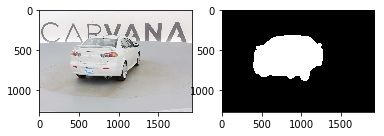

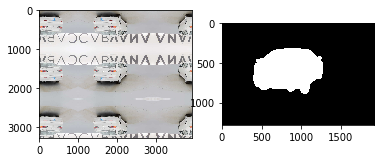

In [116]:
def pad_image(image, pad_width, mode='symmetric'):
    """
    Padding the image for prediction, the mode is 
    same as the one in numpy.pad
    
    # Args 
    image:      PIL Image or array
    pad_width:  the width to pad around the image
    
    # Return
                PIL Image padded
    """
    array = img_to_array(image)
    padding = ((pad_width, pad_width), (pad_width, pad_width), (0, 0))
    padded_array = np.pad(array, padding, mode=mode)
    padded_image = array_to_img(padded_array)
    return padded_image
%time
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_ = pad_image(image_, 1000)
show_image_and_mask(image_, mask_)

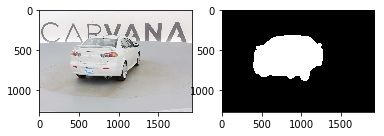

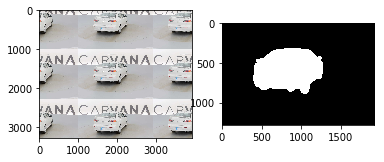

In [117]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_ = pad_image(image_, 1000, mode='wrap')
show_image_and_mask(image_, mask_)

In [118]:
array_ = img_to_array(image_)
array_.shape

(3280, 3918, 3)

In [119]:
def show_3_images(i1, i2, i3):
    plt.figure()
    plt.subplot(131)
    plt.imshow(i1)
    plt.subplot(132)
    plt.imshow(i2)
    plt.subplot(133)
    plt.imshow(i3)
    plt.show()
def show_4_images(i1, i2, i3, i4):
    plt.figure()
    plt.subplot(141)
    plt.imshow(i1)
    plt.subplot(142)
    plt.imshow(i2)
    plt.subplot(143)
    plt.imshow(i3)
    plt.subplot(144)
    plt.imshow(i4)
    plt.show()

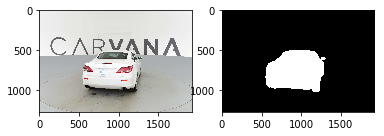

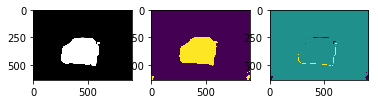

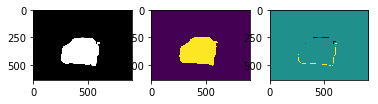

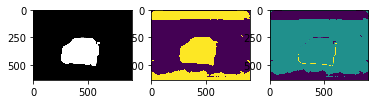

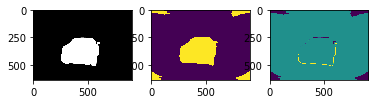

In [142]:
def predict_on_patch(model, image, pad_width, mode, image_size, input_size, output_size, verbose=0):
    """
    Predict the mask patch by patch since the valid padding is used in train
    
    # Args:
    image:      PIL Image
    mode:       Method to pading the image. The same as np.pad
    image_size: The size to perform prediction, (w, h). e.g (906, 640)
    input_size: The size of image to feed into the network
    output_size:The output mask size, which is smaller than input because the edge of the 
                input is discard gradually
    
    """
    image = imresize(image, image_size[::-1])
    image = pad_image(image, pad_width, mode)
    array = img_to_array(image) / 255
    mask = np.zeros(image_size[::-1])
    h, w = array.shape[0:2]
    mask_h, mask_w = mask.shape
    
    patch_width = output_size[0]
    patch_high = output_size[1]
    assert patch_width == patch_high, 'Output_size must be square'
    
    input_patch_width = input_size[0]
    input_patch_high = input_size[1]
    assert input_patch_width == input_patch_high, 'Input_size must be square'
    
    if verbose:
        plt.figure()
        plt.imshow(image)
        plt.show()
    
    # Function for judge the position of the patch
    def _is_last_col():
        return patch_width * i + input_patch_width >= w
    def _is_last_row():
        return patch_high * j + input_patch_high >= h
    
    # Predict patch by patch
    for i in range(int(np.ceil((w - input_patch_width) / patch_width)) + 1):
        for j in range(int(np.ceil((h - input_patch_high) / patch_high)) + 1):
            
            xs = i * patch_width
            xe = xs + input_patch_width
            ys = j * patch_high
            ye = ys + input_patch_high
            
            if (_is_last_row()):
                ys = h - input_patch_high - 1
                ye = h - 1
            if (_is_last_col()):
                xs = w - input_patch_width - 1
                xe = w - 1
                
            if verbose:
                print ('Now processing ({}, {}), ({}, {}).'.
                       format(xs, ys, xe, ye))
            
            # Predict the patch
            patch = array[ys:ye, xs:xe]
            patch = patch[None,:,:,:]
            output_patch = model.predict(patch, batch_size=1)
            
            if verbose:
                show_image_and_mask(patch[0], output_patch[0,:,:,0])
            
            # Fill the mask
            xs = i * patch_width
            xe = (i + 1) * patch_width
            ys = j * patch_high
            ye = (j + 1) * patch_high
            if (_is_last_row()):
                ys = mask_h - patch_high - 1
                ye = mask_h - 1
            if (_is_last_col()):
                xs = mask_w - patch_width - 1
                xe = mask_w - 1
            mask[ys:ye, xs:xe] = output_patch[0,:,:,0]
            
    return mask

image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[0])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

# Symmetric padding, (mirror)
mask_pred_ = predict_on_patch(model, image_, 96, 'symmetric',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Edge padding
mask_pred_ = predict_on_patch(model, image_, 96, 'edge',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Zero padding
mask_pred_ = predict_on_patch(model, image_, 96, 'constant',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Wrap padding
mask_pred_ = predict_on_patch(model, image_, 96, 'wrap',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

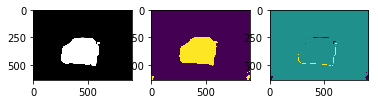

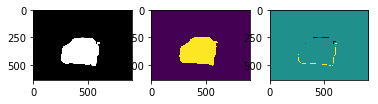

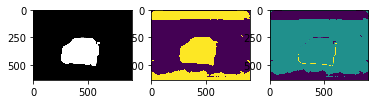

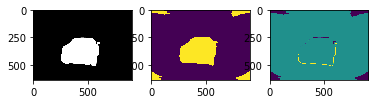

In [143]:
# Symmetric padding, (mirror)
mask_pred_ = predict_on_patch(model, image_, 96, 'symmetric',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Edge padding
mask_pred_ = predict_on_patch(model, image_, 96, 'edge',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Zero padding
mask_pred_ = predict_on_patch(model, image_, 96, 'constant',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Wrap padding
mask_pred_ = predict_on_patch(model, image_, 96, 'wrap',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

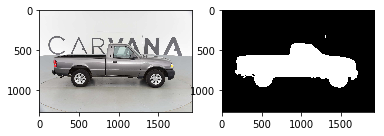

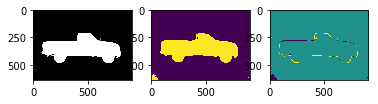

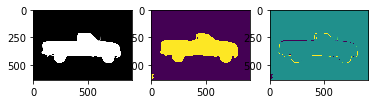

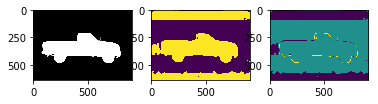

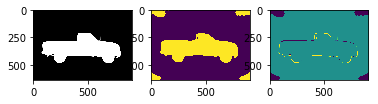

In [144]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[1])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

# Symmetric padding, (mirror)
mask_pred_ = predict_on_patch(model, image_, 96, 'symmetric',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Edge padding
mask_pred_ = predict_on_patch(model, image_, 96, 'edge',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Zero padding
mask_pred_ = predict_on_patch(model, image_, 96, 'constant',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Wrap padding
mask_pred_ = predict_on_patch(model, image_, 96, 'wrap',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

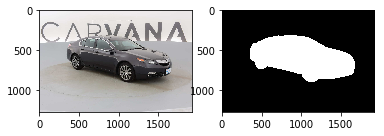

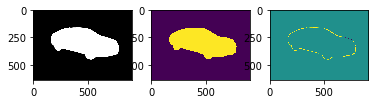

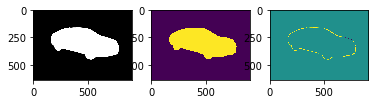

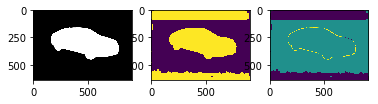

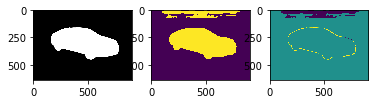

In [145]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[2])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

# Symmetric padding, (mirror)
mask_pred_ = predict_on_patch(model, image_, 96, 'symmetric',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Edge padding
mask_pred_ = predict_on_patch(model, image_, 96, 'edge',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Zero padding
mask_pred_ = predict_on_patch(model, image_, 96, 'constant',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Wrap padding
mask_pred_ = predict_on_patch(model, image_, 96, 'wrap',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

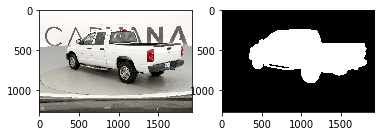

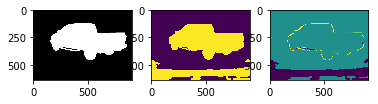

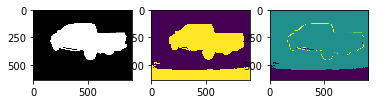

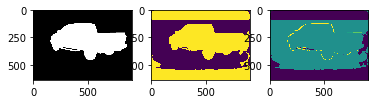

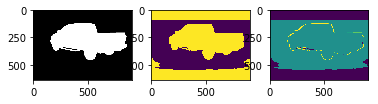

In [146]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, '2cb06c1f5bb1_07.jpg')
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

# Symmetric padding, (mirror)
mask_pred_ = predict_on_patch(model, image_, 96, 'symmetric',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Edge padding
mask_pred_ = predict_on_patch(model, image_, 96, 'edge',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Zero padding
mask_pred_ = predict_on_patch(model, image_, 96, 'constant',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

# Wrap padding
mask_pred_ = predict_on_patch(model, image_, 96, 'wrap',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

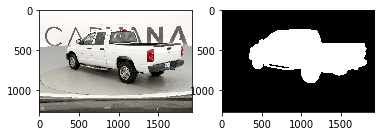

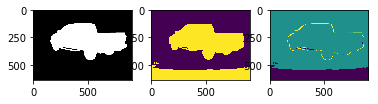

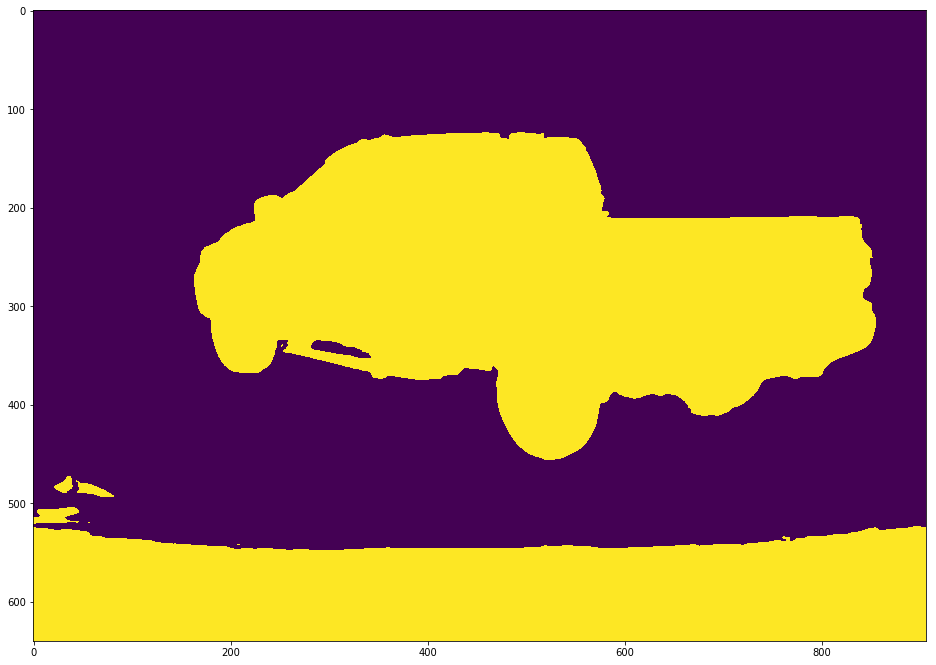

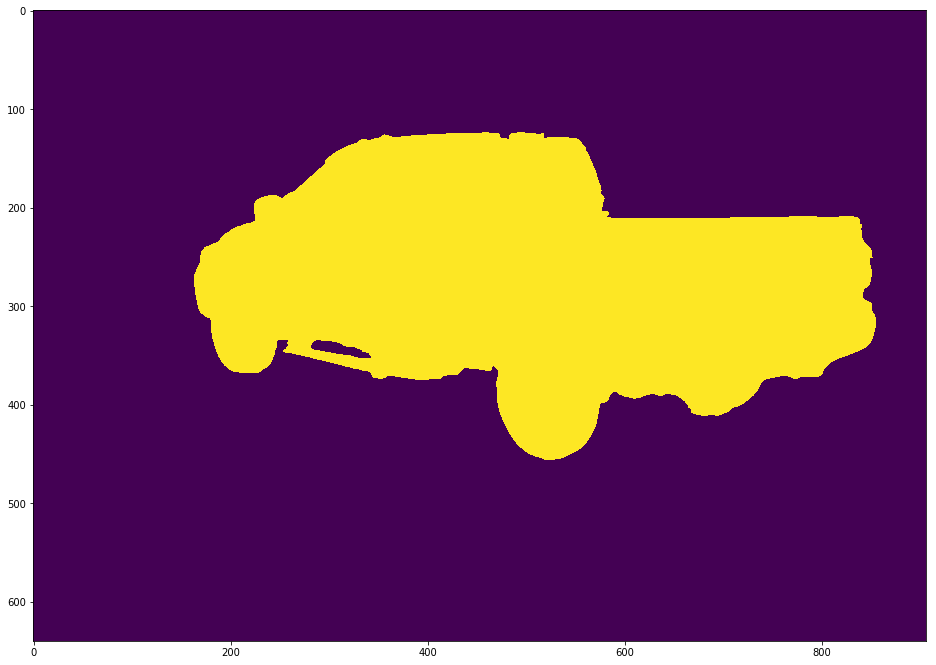

In [140]:
def remove_artifacts(mask):
    """
    # Args:
     mask:      2D array
    """
    mask = mask.astype(np.int32)
    label = label_shape(mask, connectivity=2)
    
    (h, w) = mask.shape
    bottom_left = label[h-1,0]
    bottom_right = label[h-1,w-1]
    if bottom_left == bottom_right and bottom_left != 0:
        # Remove bottom blob
        mask[label==bottom_left] = 0
    label[label==bottom_left] = 0
    # Remove other small area
    label_num = label.max()
    areas = [(label == i + 1).sum() for i in range(label_num + 1)]
    areas_max = max(areas)
    # retain the largest blob, remove all other blobs
    for i in range(1, label_num + 1):
        if areas[i-1] != areas_max:
            mask[label==i] = 0
    return mask

image_, mask_ = read_image_and_mask(data_dir, mask_dir, '2cb06c1f5bb1_07.jpg')
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

# Edge padding
mask_pred_ = predict_on_patch(model, image_, 96, 'edge',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

mask_processed_ = remove_artifacts(mask_pred_)
plt.figure(figsize=(16, 12))
plt.imshow(mask_pred_)
plt.show()
plt.figure(figsize=(16, 12))
plt.imshow(mask_processed_)
plt.show()

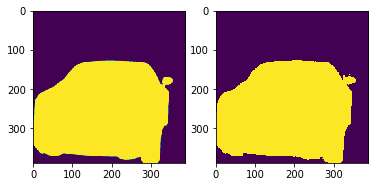

In [124]:
mask_pred_ = model.predict(val_images[0][None,:,:,:])
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_image_and_mask(val_masks[0][:,:,0], mask_pred_[0,:,:,0])

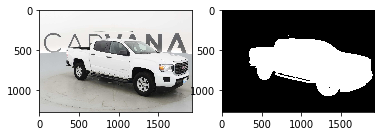

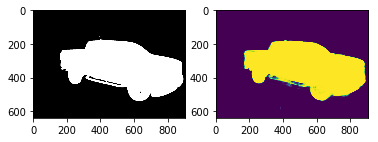

In [125]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[3])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

# Edge padding
mask_pred_ = predict_on_patch(model, image_, 96, 'edge',image_size, input_dims, output_dims)
show_image_and_mask(mask_, mask_pred_)

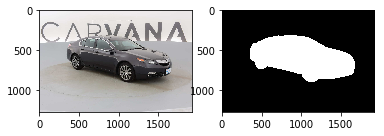

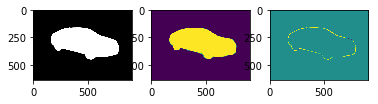

In [126]:
def mirror_average_prediction(model, image, pad_width, mode, image_size, input_size, output_size, threshold=None):
    """
    Predict the mask, average the result with mirror of the image
    
    # Args:
    The same as predict on patch
    threshold:      used to decide whether the whether the pixel is 1 or 0. 
                    Default is None. Set to 0.5 or other value when deployed. 
    """
    image2 = image.transpose(Image.FLIP_LEFT_RIGHT)
    mask = predict_on_patch(model, image, pad_width, mode, image_size, input_size, output_size)
    mask2 = predict_on_patch(model, image2, pad_width, mode, image_size, input_size, output_size)
    mask = mask + np.fliplr(mask2)
    mask /= 2.
    if threshold:
        mask[mask>=threshold] = 1
        mask[mask<threshold] = 0
    return mask
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[2])
show_image_and_mask(image_, mask_)
mask_ = imresize(mask_, image_size[::-1])
mask_pred_ = mirror_average_prediction(model, image_, 96, 'edge', image_size, input_dims, output_dims)
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

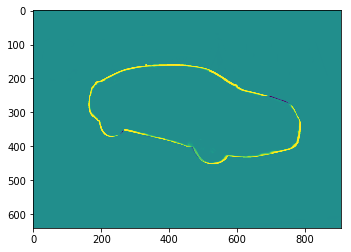

In [127]:
plt.figure()
plt.imshow(mask_[:,:,0] /255. - mask_pred_)
plt.show()
# Yellow: indicate fasle negtive
# Purper: indicate fasle positve

In [128]:
mask_[400,400]

array([0, 0, 0], dtype=uint8)

In [129]:
(mask_ / 255.)[400,400,1]

0.0

In [130]:
mask_pred_[400,400]

3.0192463214007148e-06

In [147]:
def cal_dice_coef(mask1, mask2):
    """
    Calculate dice coefficient
    
    mask1:    Groundtruth lable, size + channel
    mask2:    Predicted lable, 
    """
    if mask1.max() > 1:
        mask1 = (mask1 / 255.)[:,:,0]
    mask1 = mask1.astype(int)
    threshold = 0.5
    if threshold:
        mask2[mask2>=threshold] = 1
        mask2[mask2<threshold] = 0
        mask2 = mask2.astype(int)
    intersection = mask1 * mask2
    return 2. * intersection.sum() / (mask1 + mask2).sum()
cal_dice_coef(mask_, mask_pred_)

0.59951038172091753

In [132]:
# Calculate the dice coefficient on the validation set. The mask is smaller than the image.
def val_dice_coef(model, images, masks, 
                  pad_width, image_size, input_size, output_size):
    """
    Calculate dice coefficient on the generated validation data. This data is the
    same as the ones used in training. Hence no need to pad and can be predict 
    use model's original predict method.
    
    Will write the prediction to disk.
    
    # Args:
    image_size:      The size on which the image is cropped from
    input_size:      The input size of image, the cropped ones
    output_size:     The size of mask, smaller than input_size
    
    # Return:
    mean_dice
    mask_pred:       Lsit of predicted mask
    """
    dices = []
    masks_pred = []
    for image, mask in tqdm(zip(images, masks)):
        mask_pred = model.predict(image[None,:,:,:])
        mask_pred = mask_pred[0,:,:,:]
        dice = cal_dice_coef(mask, mask_pred)
        dices.append(dice)
        masks_pred.append([image, mask, mask_pred])
        # Show image, mask, prediction and difference
        show_4_images(image, mask[:,:,0], mask_pred[:,:,0], mask[:,:,0]-mask_pred[:,:,0])
    with open(tmp_dir + 'masks_pred.pickel', 'wb') as f:
        pickle.dump(masks_pred, f)
    dices = np.array(dices)
    return dices.mean(), mask_pred

0it [00:00, ?it/s]

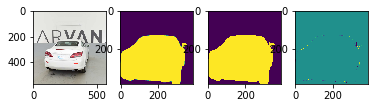

1it [00:00,  1.36it/s]

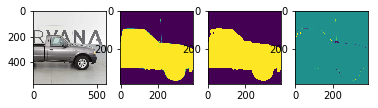

2it [00:01,  1.41it/s]

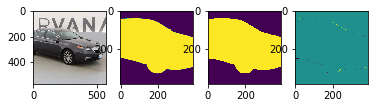

3it [00:02,  1.45it/s]

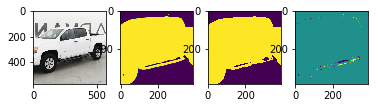

4it [00:02,  1.33it/s]

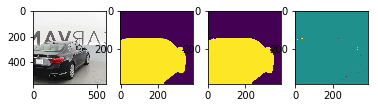

5it [00:03,  1.38it/s]

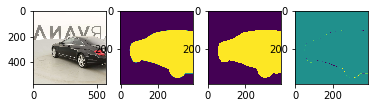

6it [00:04,  1.44it/s]

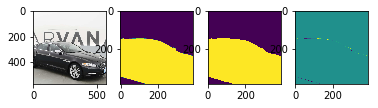

7it [00:04,  1.51it/s]

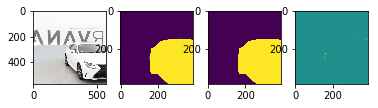

8it [00:05,  1.52it/s]

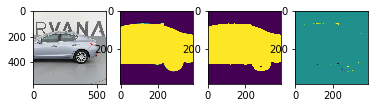

9it [00:06,  1.52it/s]

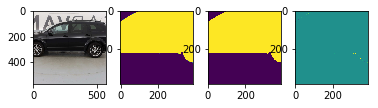

10it [00:06,  1.52it/s]

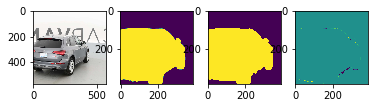

11it [00:07,  1.52it/s]

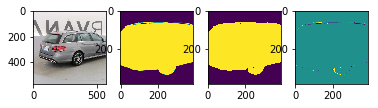

12it [00:08,  1.37it/s]

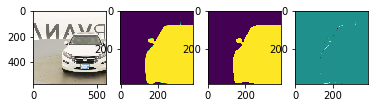

13it [00:08,  1.43it/s]

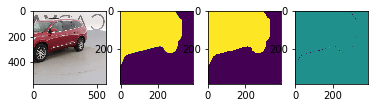

14it [00:09,  1.46it/s]

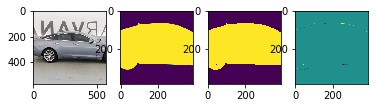

15it [00:10,  1.53it/s]

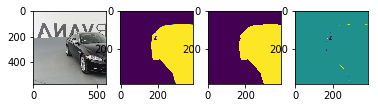

16it [00:10,  1.59it/s]

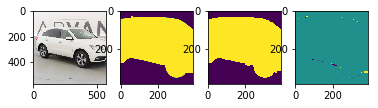

17it [00:11,  1.63it/s]

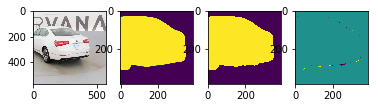

18it [00:11,  1.66it/s]

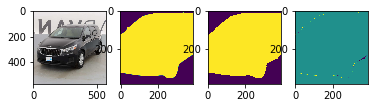

19it [00:12,  1.65it/s]

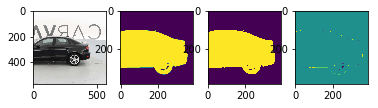

20it [00:13,  1.47it/s]

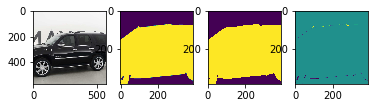

21it [00:14,  1.51it/s]

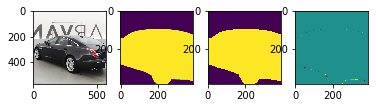

22it [00:14,  1.52it/s]

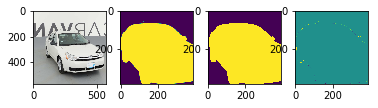

23it [00:15,  1.57it/s]

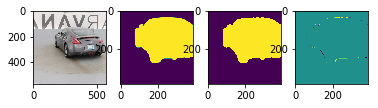

24it [00:15,  1.56it/s]

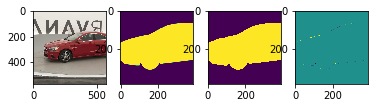

25it [00:16,  1.56it/s]

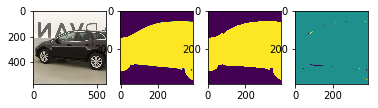

26it [00:17,  1.56it/s]

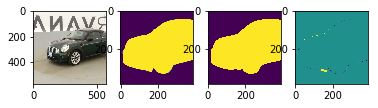

27it [00:17,  1.45it/s]

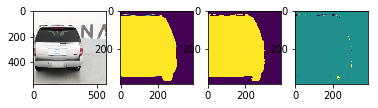

28it [00:18,  1.51it/s]

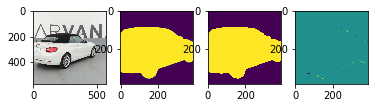

29it [00:19,  1.57it/s]

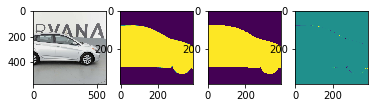

30it [00:19,  1.61it/s]

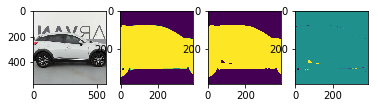

31it [00:20,  1.64it/s]

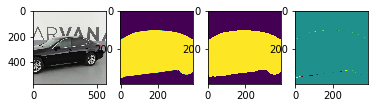

32it [00:20,  1.67it/s]

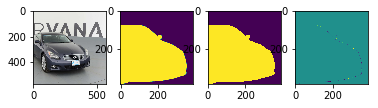

33it [00:21,  1.68it/s]

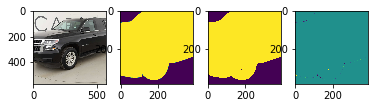

34it [00:22,  1.63it/s]

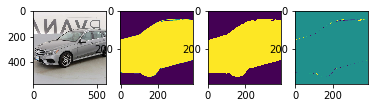

35it [00:23,  1.42it/s]

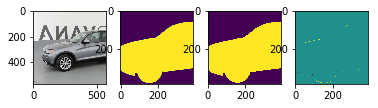

36it [00:23,  1.46it/s]

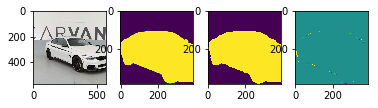

37it [00:24,  1.52it/s]

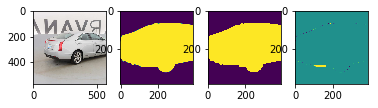

38it [00:24,  1.57it/s]

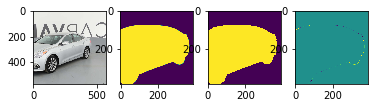

39it [00:25,  1.55it/s]

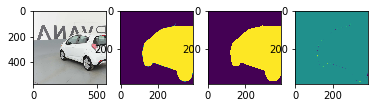

40it [00:26,  1.55it/s]

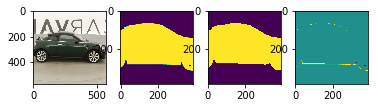

41it [00:26,  1.57it/s]

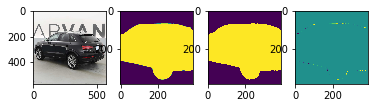

42it [00:27,  1.58it/s]

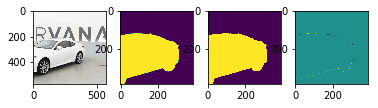

43it [00:28,  1.44it/s]

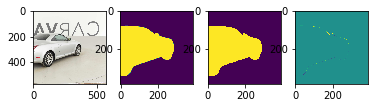

44it [00:28,  1.47it/s]

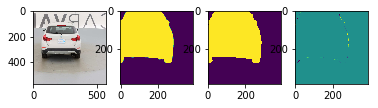

45it [00:29,  1.48it/s]

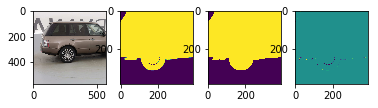

46it [00:30,  1.52it/s]

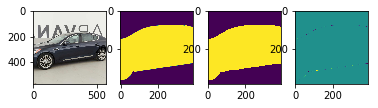

47it [00:30,  1.56it/s]

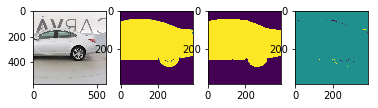

48it [00:31,  1.61it/s]

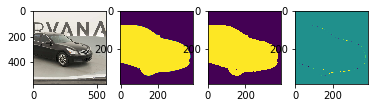

49it [00:31,  1.63it/s]

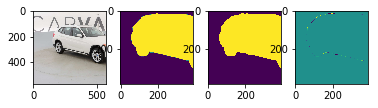

50it [00:32,  1.49it/s]

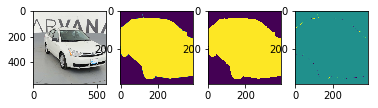

51it [00:33,  1.55it/s]

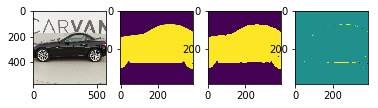

52it [00:33,  1.61it/s]

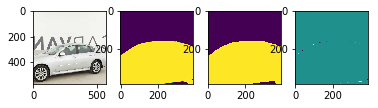

53it [00:34,  1.62it/s]

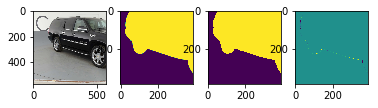

54it [00:35,  1.61it/s]

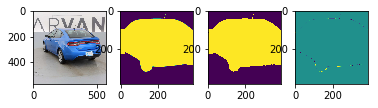

55it [00:35,  1.64it/s]

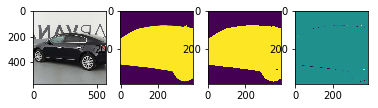

56it [00:36,  1.67it/s]

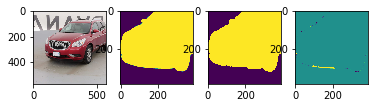

57it [00:36,  1.62it/s]

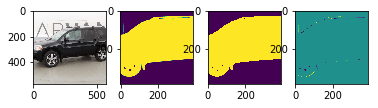

58it [00:37,  1.46it/s]

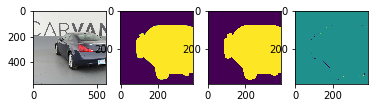

59it [00:38,  1.51it/s]

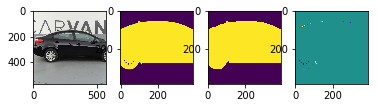

60it [00:39,  1.57it/s]

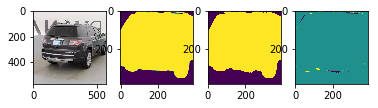

61it [00:39,  1.56it/s]

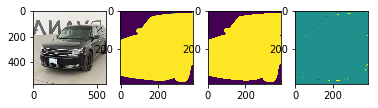

62it [00:40,  1.61it/s]

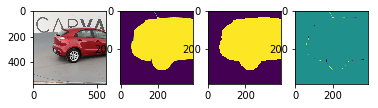

63it [00:40,  1.64it/s]

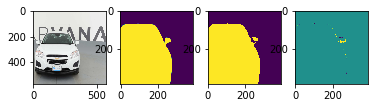

64it [00:41,  1.64it/s]

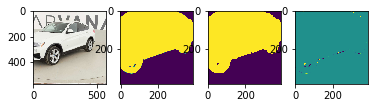

65it [00:42,  1.62it/s]

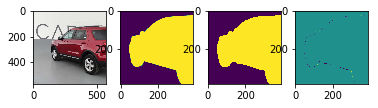

66it [00:42,  1.49it/s]

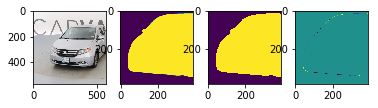

67it [00:43,  1.55it/s]

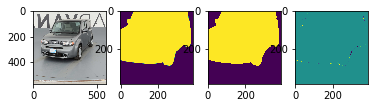

68it [00:44,  1.59it/s]

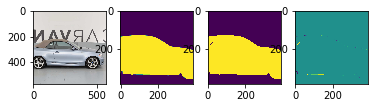

69it [00:44,  1.56it/s]

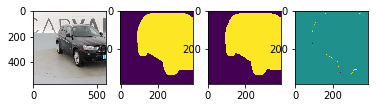

70it [00:45,  1.60it/s]

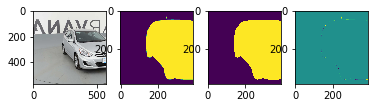

71it [00:45,  1.63it/s]

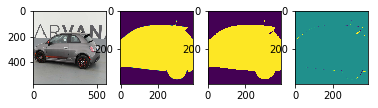

72it [00:46,  1.65it/s]

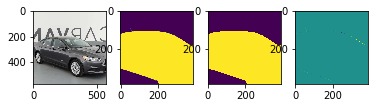

73it [00:47,  1.51it/s]

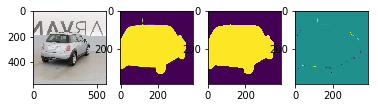

74it [00:47,  1.57it/s]

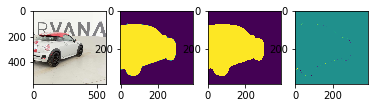

75it [00:48,  1.61it/s]

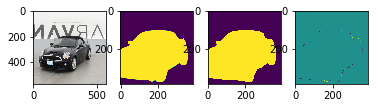

76it [00:49,  1.62it/s]

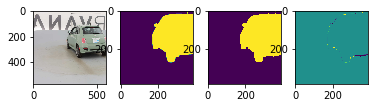

77it [00:49,  1.64it/s]

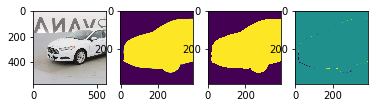

78it [00:50,  1.67it/s]

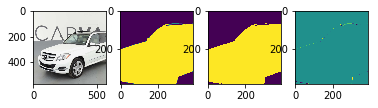

79it [00:50,  1.63it/s]

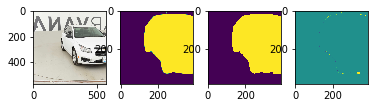

80it [00:51,  1.66it/s]

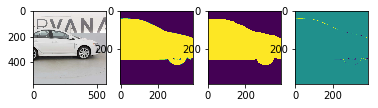

81it [00:52,  1.51it/s]

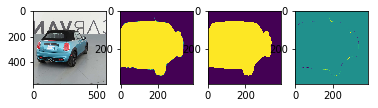

82it [00:52,  1.53it/s]

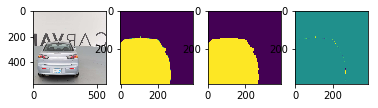

83it [00:53,  1.58it/s]

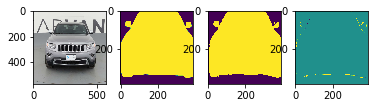

84it [00:54,  1.62it/s]

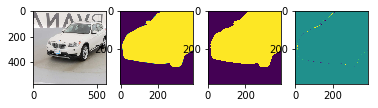

85it [00:54,  1.64it/s]

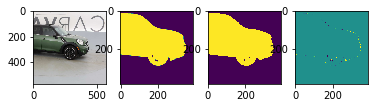

86it [00:55,  1.66it/s]

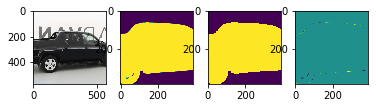

87it [00:55,  1.61it/s]

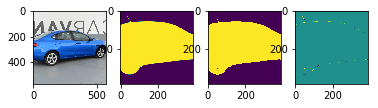

88it [00:56,  1.61it/s]

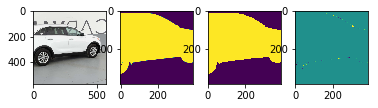

89it [00:57,  1.48it/s]

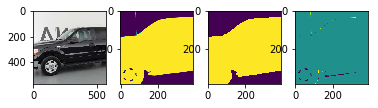

90it [00:57,  1.55it/s]

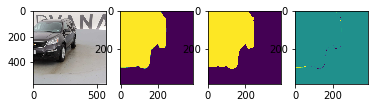

91it [00:58,  1.60it/s]

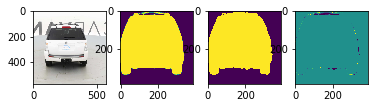

92it [00:59,  1.64it/s]

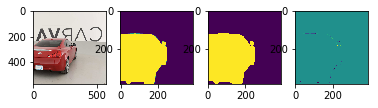

93it [00:59,  1.66it/s]

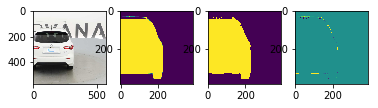

94it [01:00,  1.67it/s]

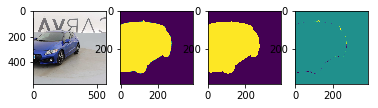

95it [01:00,  1.62it/s]

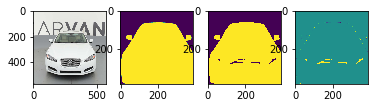

96it [01:01,  1.44it/s]

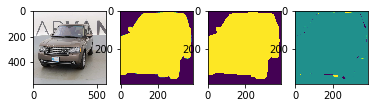

97it [01:02,  1.46it/s]

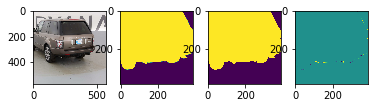

98it [01:03,  1.48it/s]

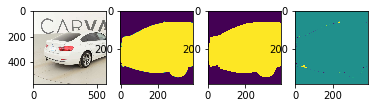

99it [01:03,  1.49it/s]

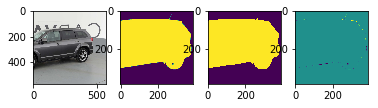

100it [01:04,  1.52it/s]

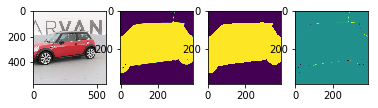

101it [01:05,  1.50it/s]

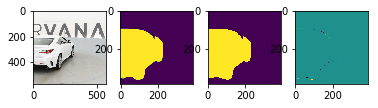

102it [01:05,  1.51it/s]

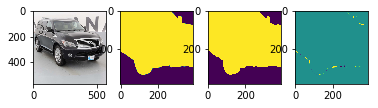

103it [01:06,  1.56it/s]

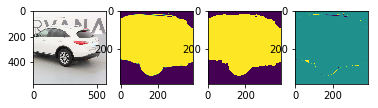

104it [01:07,  1.40it/s]

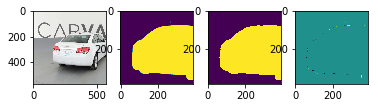

105it [01:07,  1.49it/s]

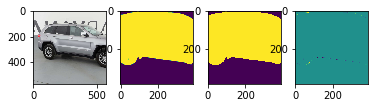

106it [01:08,  1.53it/s]

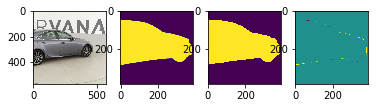

107it [01:08,  1.59it/s]

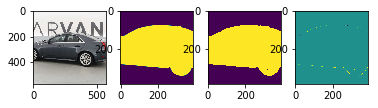

108it [01:09,  1.62it/s]

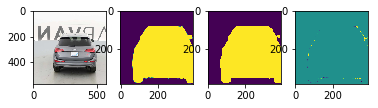

109it [01:10,  1.65it/s]

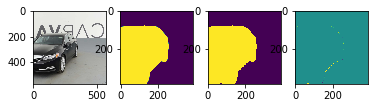

110it [01:10,  1.67it/s]

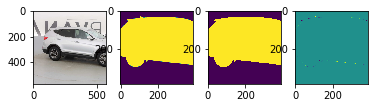

111it [01:11,  1.68it/s]

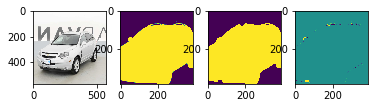

112it [01:12,  1.47it/s]

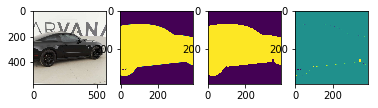

113it [01:12,  1.49it/s]

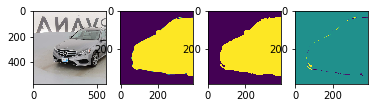

114it [01:13,  1.49it/s]

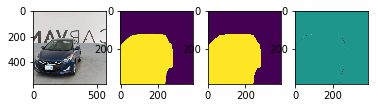

115it [01:14,  1.56it/s]

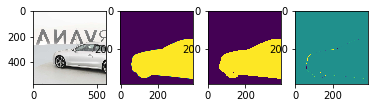

116it [01:14,  1.58it/s]

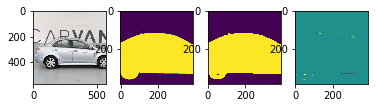

117it [01:15,  1.59it/s]

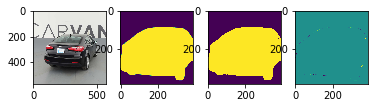

118it [01:15,  1.60it/s]

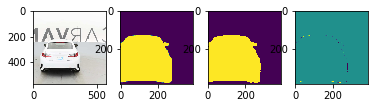

119it [01:16,  1.43it/s]

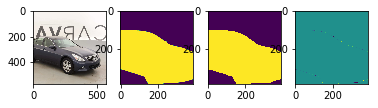

120it [01:17,  1.45it/s]

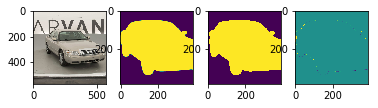

121it [01:17,  1.52it/s]

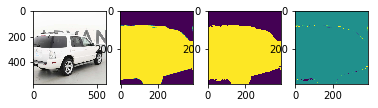

122it [01:18,  1.55it/s]

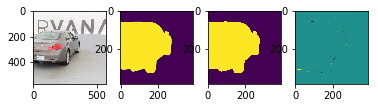

123it [01:19,  1.58it/s]

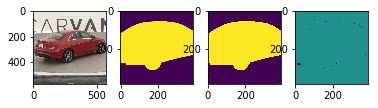

124it [01:19,  1.62it/s]

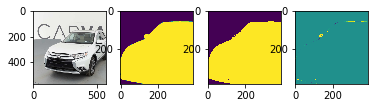

125it [01:20,  1.63it/s]

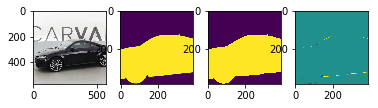

126it [01:20,  1.65it/s]

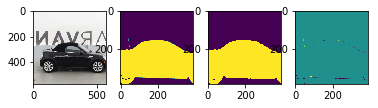

127it [01:21,  1.50it/s]

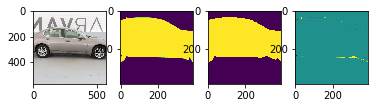

128it [01:22,  1.53it/s]

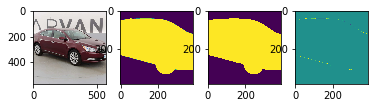

129it [01:23,  1.57it/s]

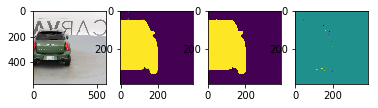

130it [01:23,  1.60it/s]

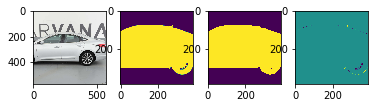

131it [01:24,  1.63it/s]

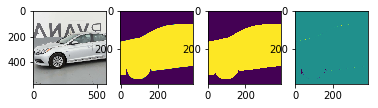

132it [01:24,  1.62it/s]

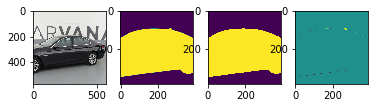

133it [01:25,  1.66it/s]

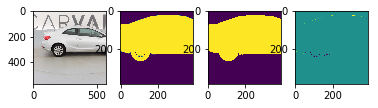

134it [01:25,  1.68it/s]

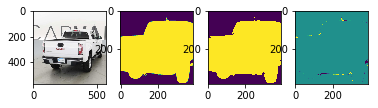

135it [01:26,  1.52it/s]

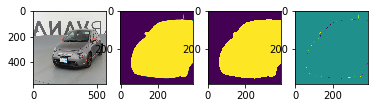

136it [01:27,  1.58it/s]

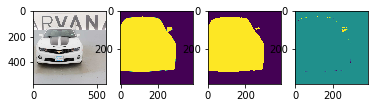

137it [01:27,  1.62it/s]

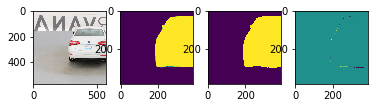

138it [01:28,  1.61it/s]

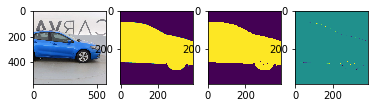

139it [01:29,  1.64it/s]

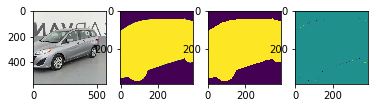

140it [01:29,  1.60it/s]

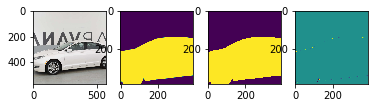

141it [01:30,  1.60it/s]

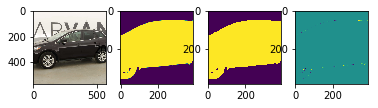

142it [01:31,  1.48it/s]

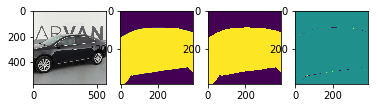

143it [01:31,  1.55it/s]

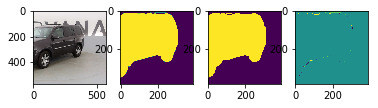

144it [01:32,  1.56it/s]

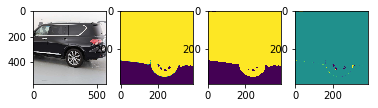

145it [01:33,  1.60it/s]

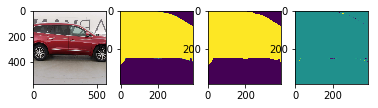

146it [01:33,  1.58it/s]

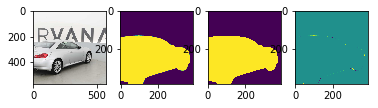

147it [01:34,  1.62it/s]

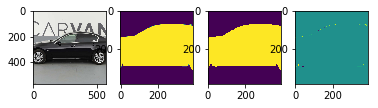

148it [01:34,  1.63it/s]

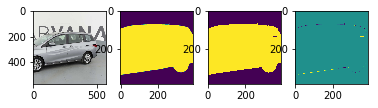

149it [01:35,  1.59it/s]

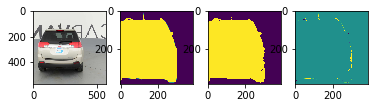

150it [01:36,  1.43it/s]

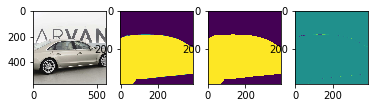

151it [01:36,  1.50it/s]

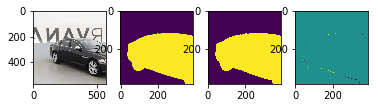

152it [01:37,  1.52it/s]

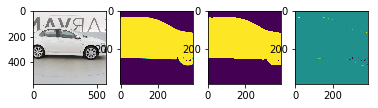

153it [01:38,  1.58it/s]

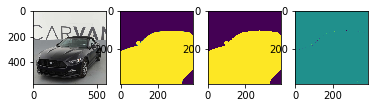

154it [01:38,  1.60it/s]

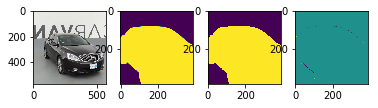

155it [01:39,  1.59it/s]

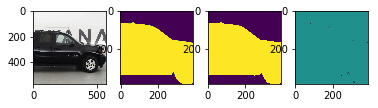

156it [01:39,  1.64it/s]

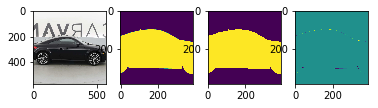

157it [01:40,  1.60it/s]

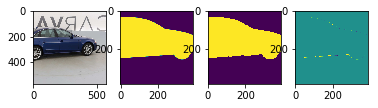

158it [01:41,  1.43it/s]

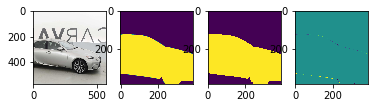

159it [01:42,  1.45it/s]

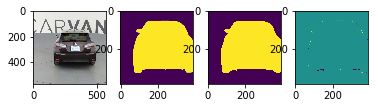

160it [01:42,  1.48it/s]

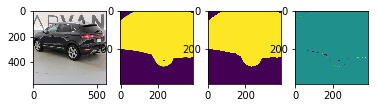

161it [01:43,  1.48it/s]

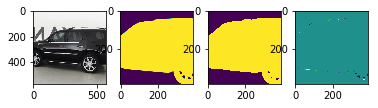

162it [01:44,  1.52it/s]

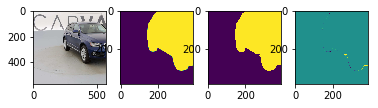

163it [01:44,  1.58it/s]

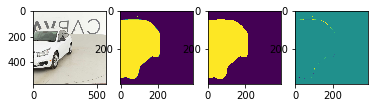

164it [01:45,  1.62it/s]

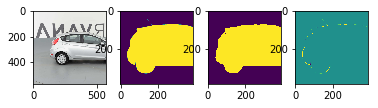

165it [01:46,  1.49it/s]

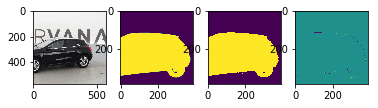

166it [01:46,  1.55it/s]

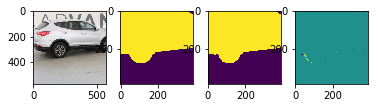

167it [01:47,  1.59it/s]

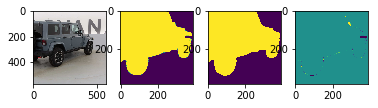

168it [01:47,  1.58it/s]

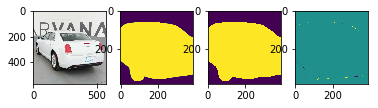

169it [01:48,  1.60it/s]

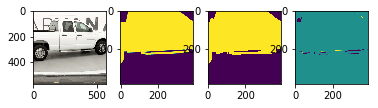

170it [01:49,  1.60it/s]

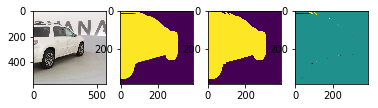

171it [01:49,  1.64it/s]

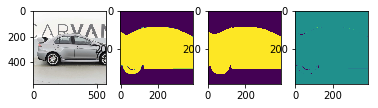

172it [01:50,  1.60it/s]

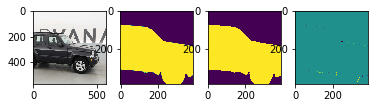

173it [01:51,  1.42it/s]

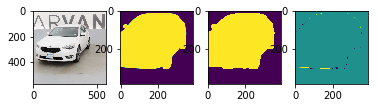

174it [01:51,  1.47it/s]

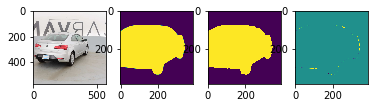

175it [01:52,  1.50it/s]

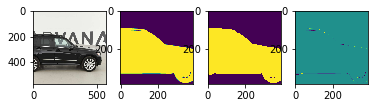

176it [01:53,  1.54it/s]

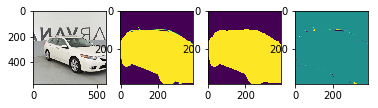

177it [01:53,  1.59it/s]

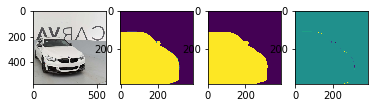

178it [01:54,  1.63it/s]

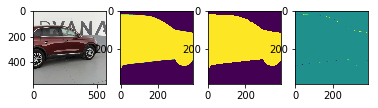

179it [01:54,  1.66it/s]

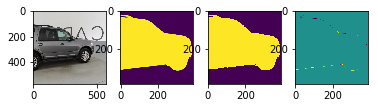

180it [01:55,  1.65it/s]

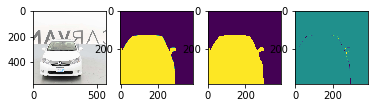

181it [01:56,  1.45it/s]

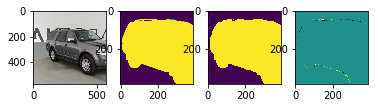

182it [01:57,  1.47it/s]

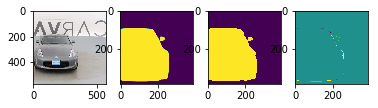

183it [01:57,  1.49it/s]

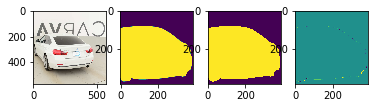

184it [01:58,  1.54it/s]

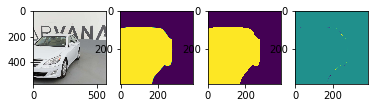

185it [01:58,  1.54it/s]

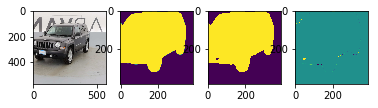

186it [01:59,  1.56it/s]

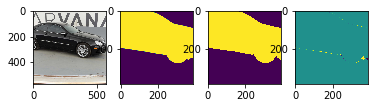

187it [02:00,  1.61it/s]

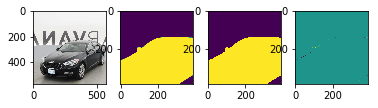

188it [02:00,  1.45it/s]

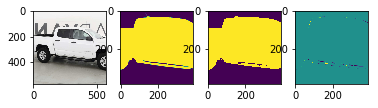

189it [02:01,  1.49it/s]

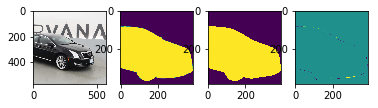

190it [02:02,  1.52it/s]

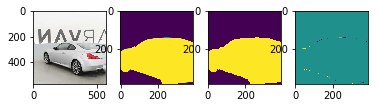

191it [02:02,  1.57it/s]

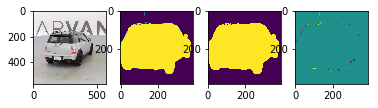

192it [02:03,  1.59it/s]

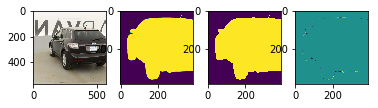

193it [02:04,  1.59it/s]

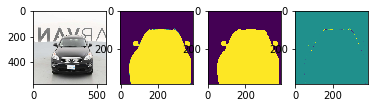

194it [02:04,  1.62it/s]

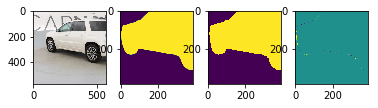

195it [02:05,  1.64it/s]

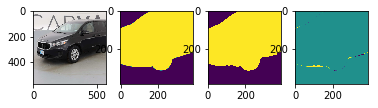

196it [02:06,  1.49it/s]

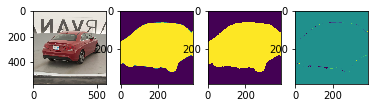

197it [02:06,  1.50it/s]

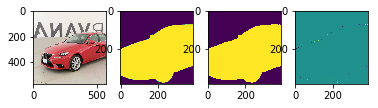

198it [02:07,  1.50it/s]

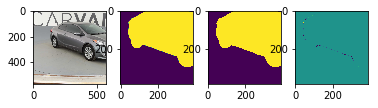

199it [02:07,  1.52it/s]

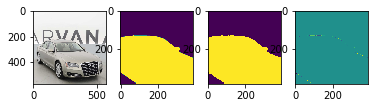

200it [02:08,  1.56it/s]

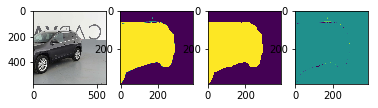

201it [02:09,  1.58it/s]

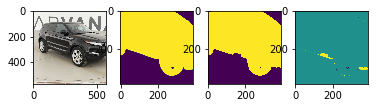

202it [02:09,  1.56it/s]

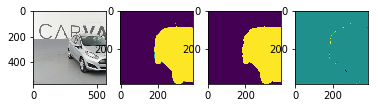

203it [02:10,  1.57it/s]

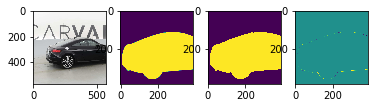

204it [02:11,  1.46it/s]

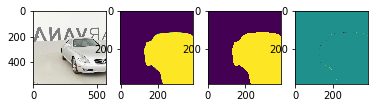

205it [02:11,  1.53it/s]

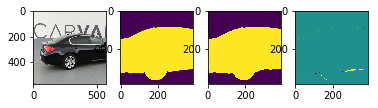

206it [02:12,  1.58it/s]

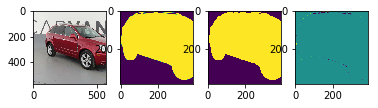

207it [02:13,  1.58it/s]

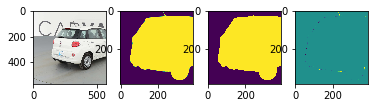

208it [02:13,  1.61it/s]

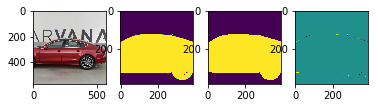

209it [02:14,  1.58it/s]

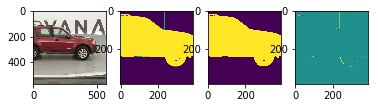

210it [02:14,  1.60it/s]

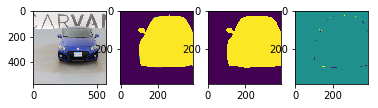

211it [02:15,  1.42it/s]

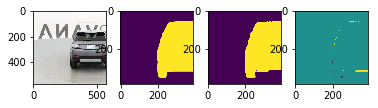

212it [02:16,  1.44it/s]

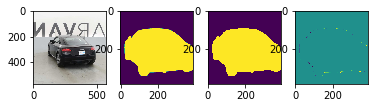

213it [02:17,  1.47it/s]

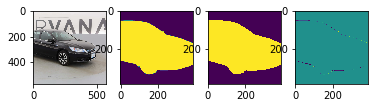

214it [02:17,  1.53it/s]

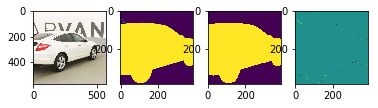

215it [02:18,  1.54it/s]

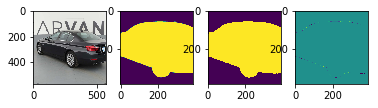

216it [02:18,  1.59it/s]

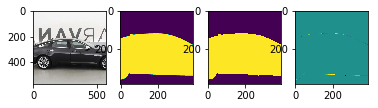

217it [02:19,  1.62it/s]

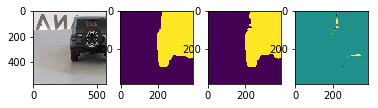

218it [02:20,  1.65it/s]

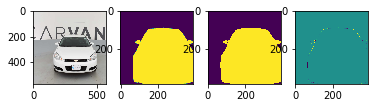

219it [02:21,  1.46it/s]

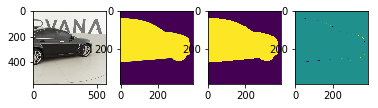

220it [02:21,  1.50it/s]

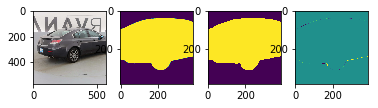

221it [02:22,  1.56it/s]

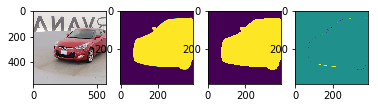

222it [02:22,  1.56it/s]

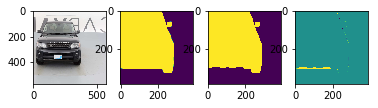

223it [02:23,  1.60it/s]

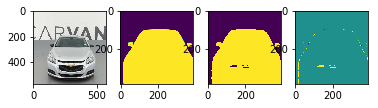

224it [02:24,  1.64it/s]

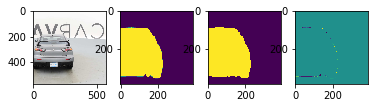

225it [02:24,  1.60it/s]

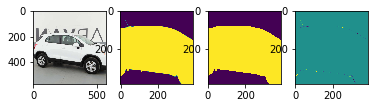

226it [02:25,  1.61it/s]

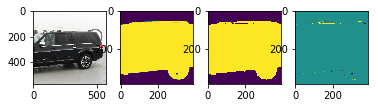

227it [02:26,  1.47it/s]

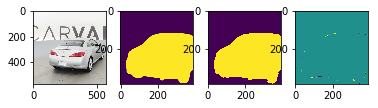

228it [02:26,  1.48it/s]

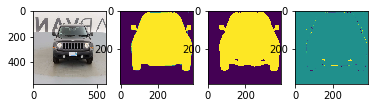

229it [02:27,  1.54it/s]

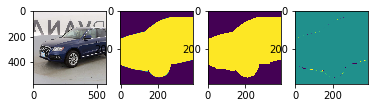

230it [02:28,  1.54it/s]

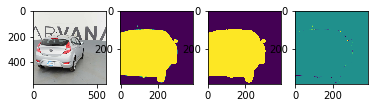

231it [02:28,  1.56it/s]

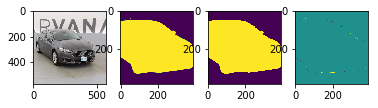

232it [02:29,  1.60it/s]

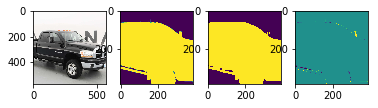

233it [02:29,  1.63it/s]

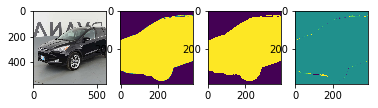

234it [02:30,  1.49it/s]

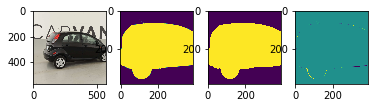

235it [02:31,  1.51it/s]

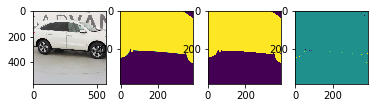

236it [02:31,  1.56it/s]

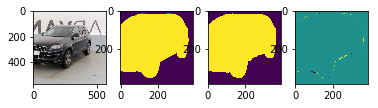

237it [02:32,  1.60it/s]

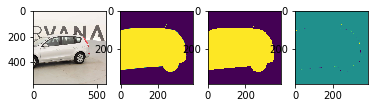

238it [02:33,  1.62it/s]

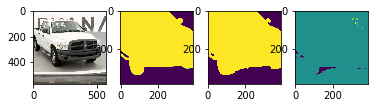

239it [02:33,  1.60it/s]

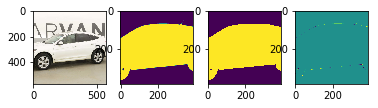

240it [02:34,  1.61it/s]

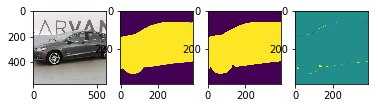

241it [02:34,  1.64it/s]

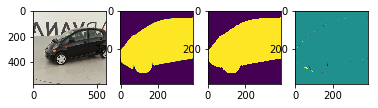

242it [02:35,  1.47it/s]

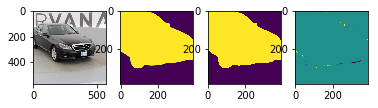

243it [02:36,  1.53it/s]

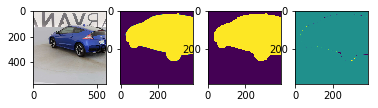

244it [02:36,  1.56it/s]

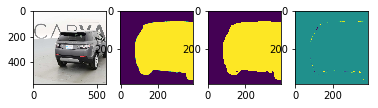

245it [02:37,  1.59it/s]

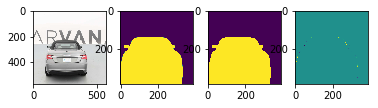

246it [02:38,  1.59it/s]

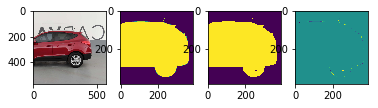

247it [02:38,  1.63it/s]

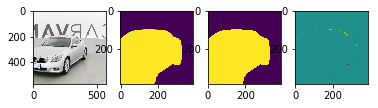

248it [02:39,  1.66it/s]

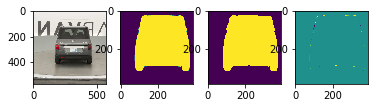

249it [02:39,  1.69it/s]

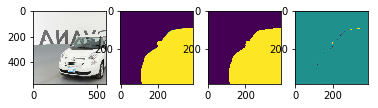

250it [02:40,  1.49it/s]

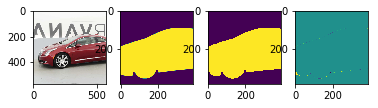

251it [02:41,  1.51it/s]

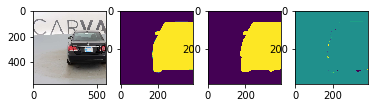

252it [02:41,  1.52it/s]

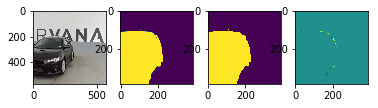

253it [02:42,  1.54it/s]

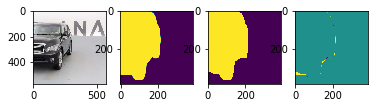

254it [02:43,  1.56it/s]

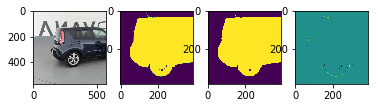

255it [02:43,  1.60it/s]

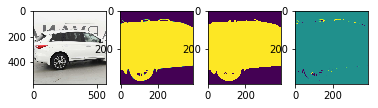

256it [02:44,  1.60it/s]

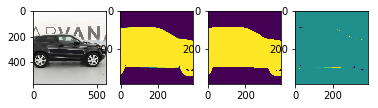

257it [02:45,  1.46it/s]

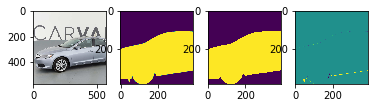

258it [02:45,  1.46it/s]

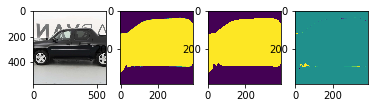

259it [02:46,  1.48it/s]

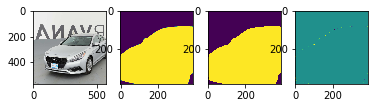

260it [02:47,  1.55it/s]

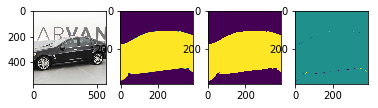

261it [02:47,  1.59it/s]

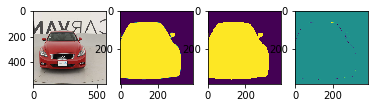

262it [02:48,  1.61it/s]

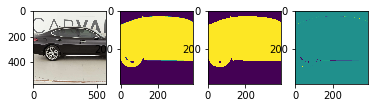

263it [02:48,  1.64it/s]

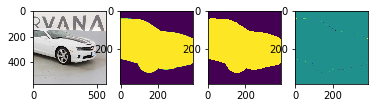

264it [02:49,  1.67it/s]

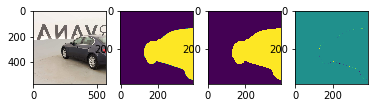

265it [02:50,  1.51it/s]

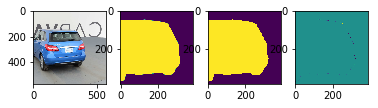

266it [02:50,  1.57it/s]

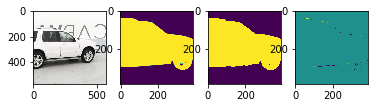

267it [02:51,  1.59it/s]

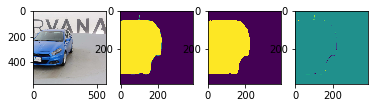

268it [02:52,  1.59it/s]

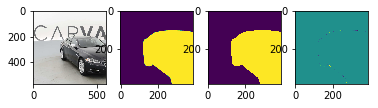

269it [02:52,  1.63it/s]

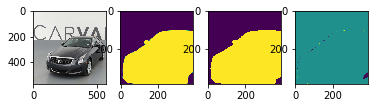

270it [02:53,  1.61it/s]

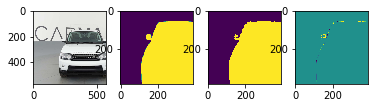

271it [02:54,  1.62it/s]

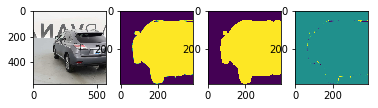

272it [02:54,  1.61it/s]

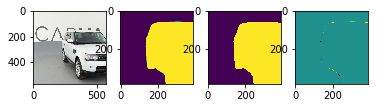

273it [02:55,  1.47it/s]

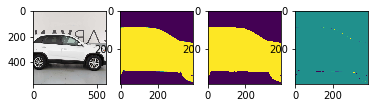

274it [02:56,  1.49it/s]

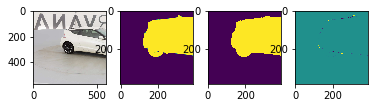

275it [02:56,  1.54it/s]

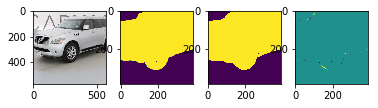

276it [02:57,  1.57it/s]

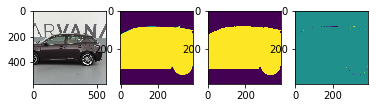

277it [02:57,  1.62it/s]

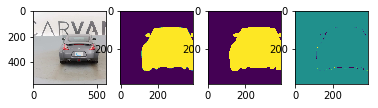

278it [02:58,  1.64it/s]

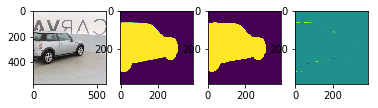

279it [02:59,  1.63it/s]

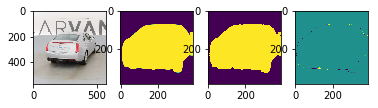

280it [02:59,  1.48it/s]

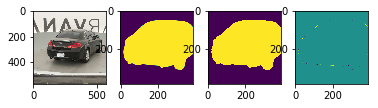

281it [03:00,  1.54it/s]

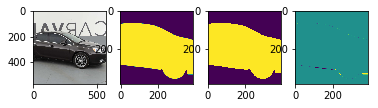

282it [03:01,  1.54it/s]

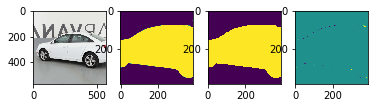

283it [03:01,  1.53it/s]

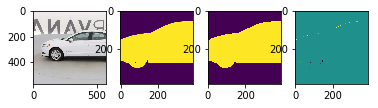

284it [03:02,  1.52it/s]

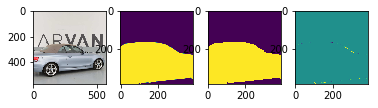

285it [03:03,  1.54it/s]

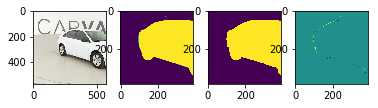

286it [03:03,  1.59it/s]

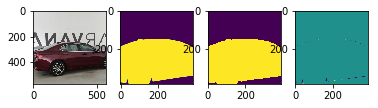

287it [03:04,  1.58it/s]

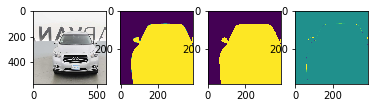

288it [03:05,  1.46it/s]

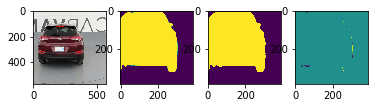

289it [03:05,  1.53it/s]

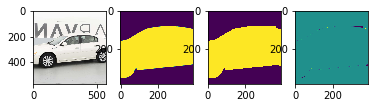

290it [03:06,  1.58it/s]

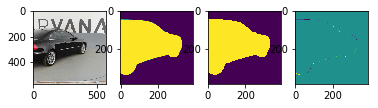

291it [03:06,  1.59it/s]

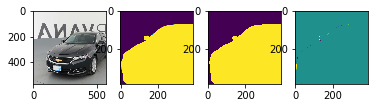

292it [03:07,  1.56it/s]

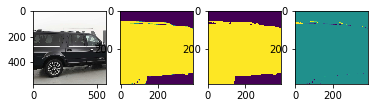

293it [03:08,  1.54it/s]

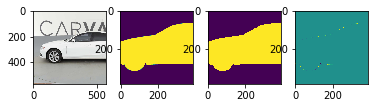

294it [03:08,  1.53it/s]

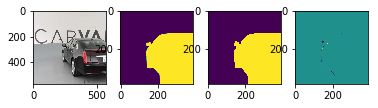

295it [03:09,  1.52it/s]

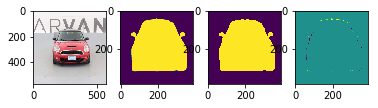

296it [03:10,  1.36it/s]

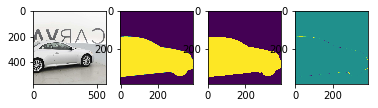

297it [03:11,  1.41it/s]

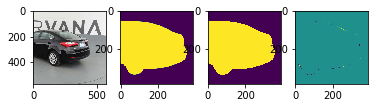

298it [03:11,  1.49it/s]

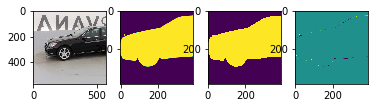

299it [03:12,  1.55it/s]

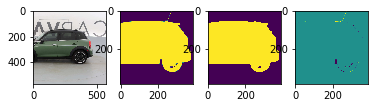

300it [03:12,  1.59it/s]

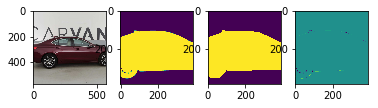

301it [03:13,  1.61it/s]

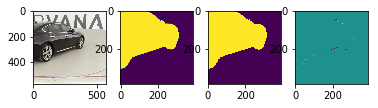

302it [03:14,  1.62it/s]

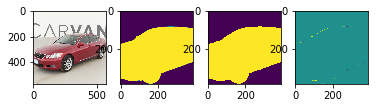

303it [03:14,  1.47it/s]

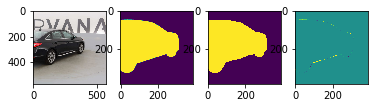

304it [03:15,  1.51it/s]

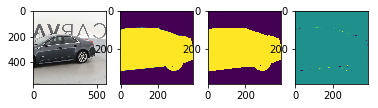

305it [03:16,  1.57it/s]

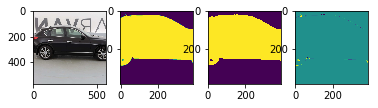

306it [03:16,  1.57it/s]

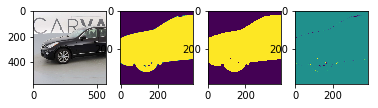

307it [03:17,  1.58it/s]

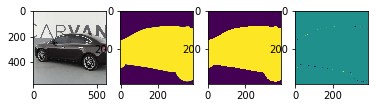

308it [03:17,  1.62it/s]

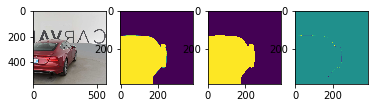

309it [03:18,  1.65it/s]

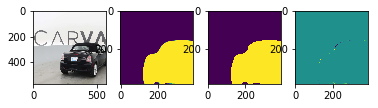

310it [03:19,  1.67it/s]

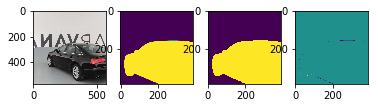

311it [03:19,  1.51it/s]

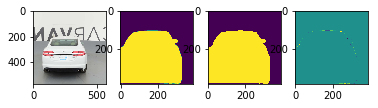

312it [03:20,  1.53it/s]

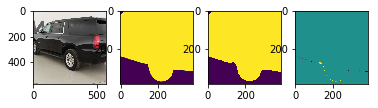

313it [03:21,  1.53it/s]

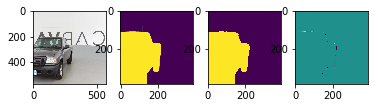

314it [03:21,  1.59it/s]

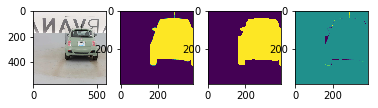

315it [03:22,  1.63it/s]

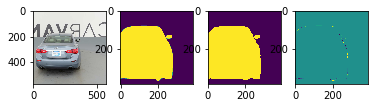

316it [03:22,  1.65it/s]

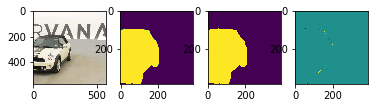

317it [03:23,  1.64it/s]

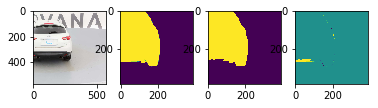

318it [03:24,  1.67it/s]

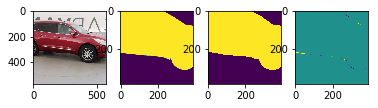

319it [03:25,  1.46it/s]

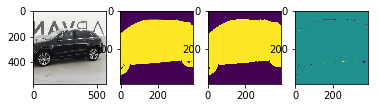

320it [03:25,  1.47it/s]

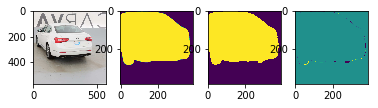

321it [03:26,  1.47it/s]

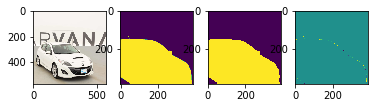

322it [03:27,  1.48it/s]

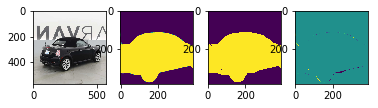

323it [03:27,  1.51it/s]

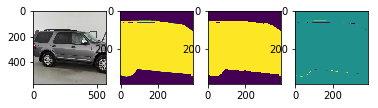

324it [03:28,  1.57it/s]

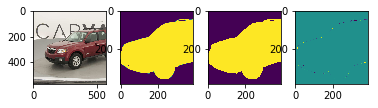

325it [03:28,  1.61it/s]

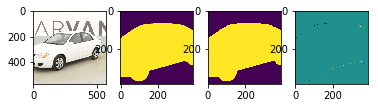

326it [03:29,  1.48it/s]

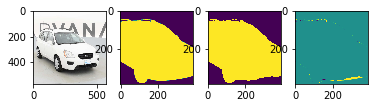

327it [03:30,  1.55it/s]

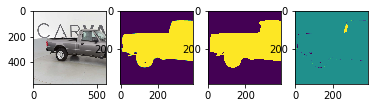

328it [03:30,  1.60it/s]

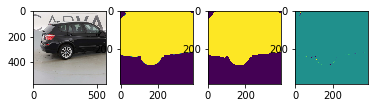

329it [03:31,  1.61it/s]

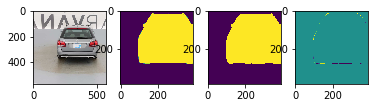

330it [03:32,  1.61it/s]

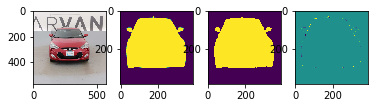

331it [03:32,  1.62it/s]

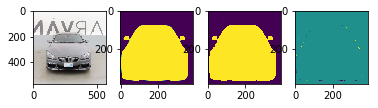

332it [03:33,  1.62it/s]

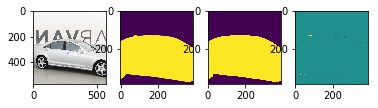

333it [03:33,  1.63it/s]

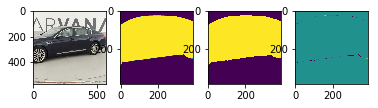

334it [03:34,  1.43it/s]

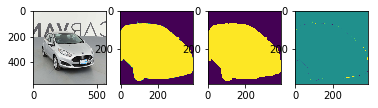

335it [03:35,  1.46it/s]

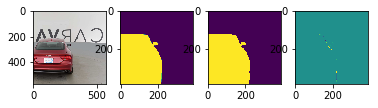

336it [03:36,  1.51it/s]

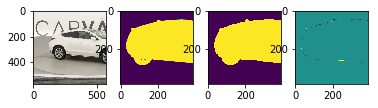

337it [03:36,  1.51it/s]

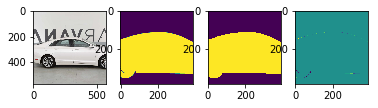

338it [03:37,  1.57it/s]

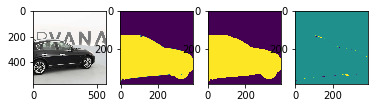

339it [03:37,  1.58it/s]

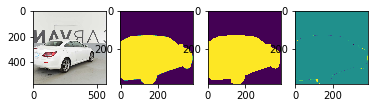

340it [03:38,  1.60it/s]

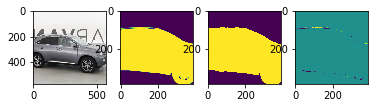

341it [03:39,  1.43it/s]

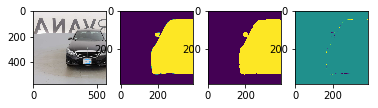

342it [03:40,  1.47it/s]

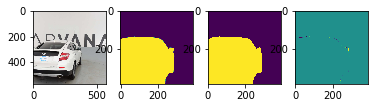

343it [03:40,  1.54it/s]

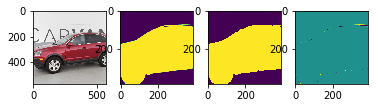

344it [03:41,  1.56it/s]

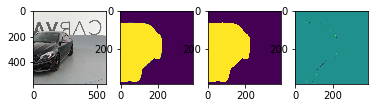

345it [03:41,  1.57it/s]

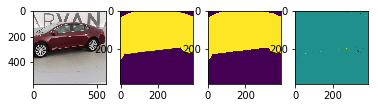

346it [03:42,  1.62it/s]

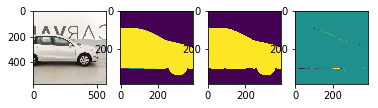

347it [03:43,  1.59it/s]

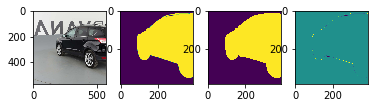

348it [03:43,  1.57it/s]

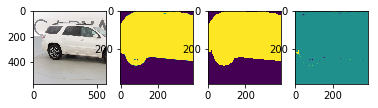

349it [03:44,  1.43it/s]

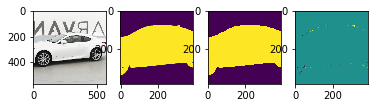

350it [03:45,  1.49it/s]

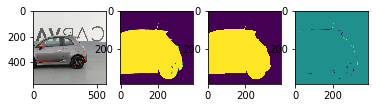

351it [03:45,  1.55it/s]

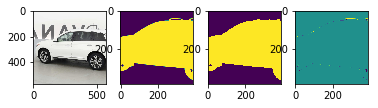

352it [03:46,  1.54it/s]

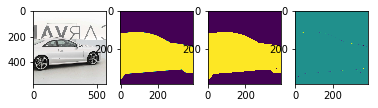

353it [03:47,  1.59it/s]

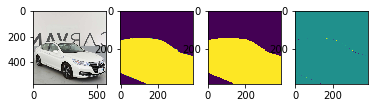

354it [03:47,  1.58it/s]

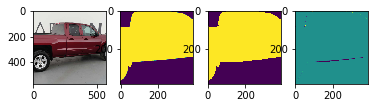

355it [03:48,  1.59it/s]

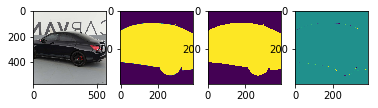

356it [03:48,  1.62it/s]

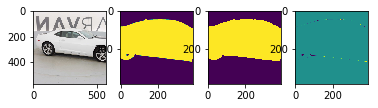

357it [03:49,  1.49it/s]

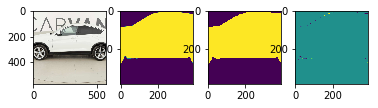

358it [03:50,  1.54it/s]

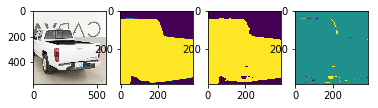

359it [03:50,  1.58it/s]

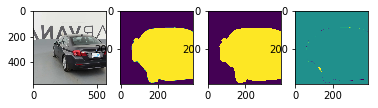

360it [03:51,  1.60it/s]

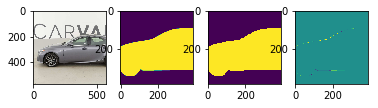

361it [03:52,  1.62it/s]

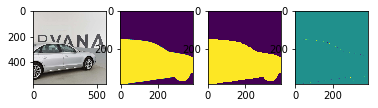

362it [03:52,  1.58it/s]

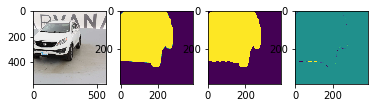

363it [03:53,  1.59it/s]

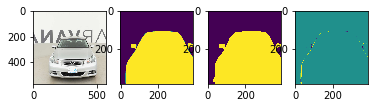

364it [03:54,  1.47it/s]

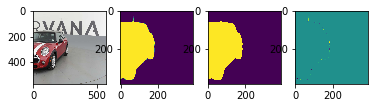

365it [03:54,  1.49it/s]

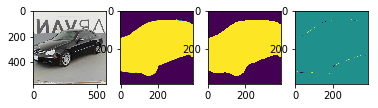

366it [03:55,  1.50it/s]

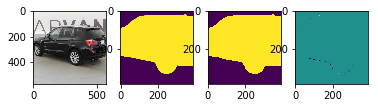

367it [03:56,  1.50it/s]

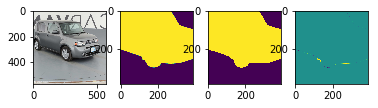

368it [03:56,  1.50it/s]

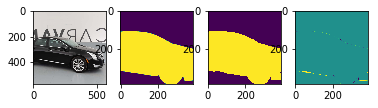

369it [03:57,  1.57it/s]

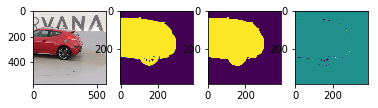

370it [03:58,  1.54it/s]

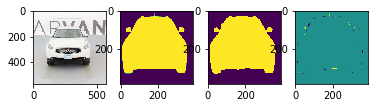

371it [03:58,  1.37it/s]

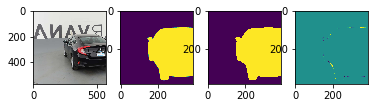

372it [03:59,  1.42it/s]

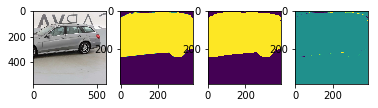

373it [04:00,  1.47it/s]

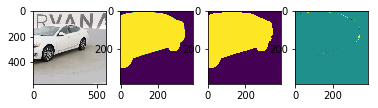

374it [04:00,  1.54it/s]

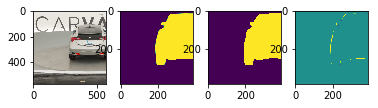

375it [04:01,  1.58it/s]

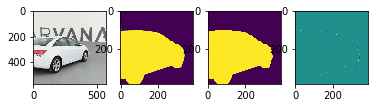

376it [04:01,  1.61it/s]

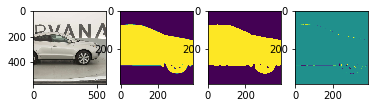

377it [04:02,  1.63it/s]

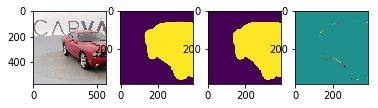

378it [04:03,  1.66it/s]

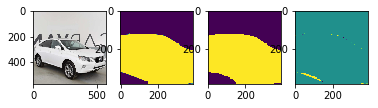

379it [04:04,  1.46it/s]

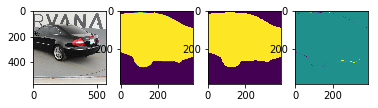

380it [04:04,  1.52it/s]

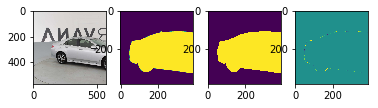

381it [04:05,  1.56it/s]

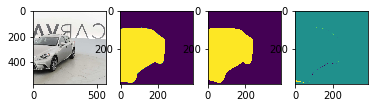

382it [04:05,  1.54it/s]

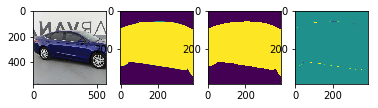

383it [04:06,  1.59it/s]

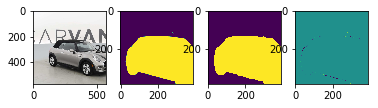

384it [04:07,  1.61it/s]

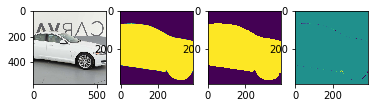

385it [04:07,  1.59it/s]

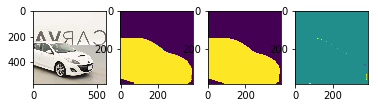

386it [04:08,  1.63it/s]

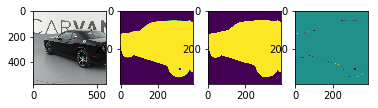

387it [04:09,  1.47it/s]

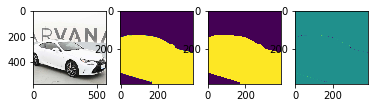

388it [04:09,  1.49it/s]

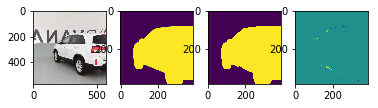

389it [04:10,  1.50it/s]

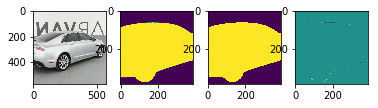

390it [04:11,  1.53it/s]

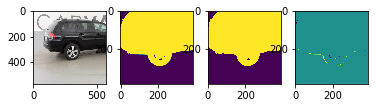

391it [04:11,  1.59it/s]

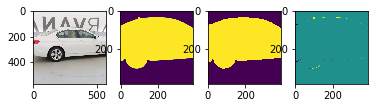

392it [04:12,  1.62it/s]

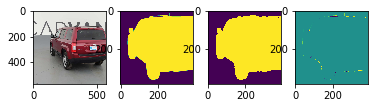

393it [04:12,  1.66it/s]

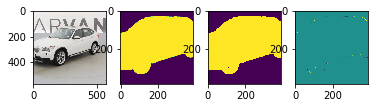

394it [04:13,  1.46it/s]

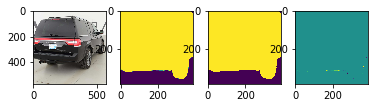

395it [04:14,  1.52it/s]

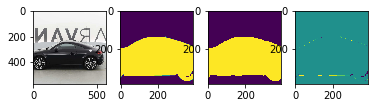

396it [04:14,  1.57it/s]

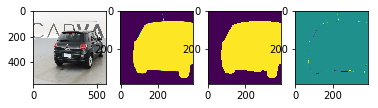

397it [04:15,  1.56it/s]

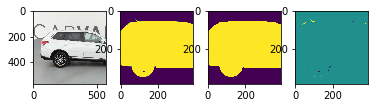

398it [04:16,  1.57it/s]

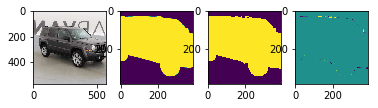

399it [04:16,  1.60it/s]

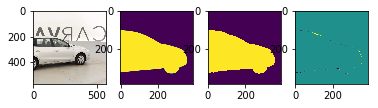

400it [04:17,  1.63it/s]

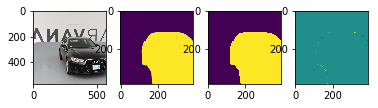

401it [04:17,  1.66it/s]

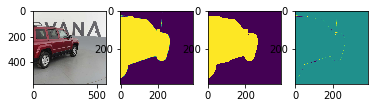

402it [04:18,  1.51it/s]

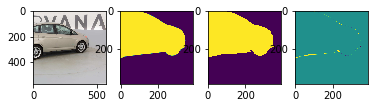

403it [04:19,  1.52it/s]

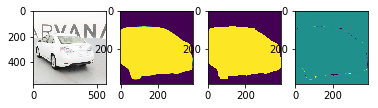

404it [04:19,  1.54it/s]

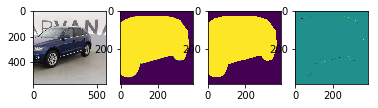

405it [04:20,  1.58it/s]

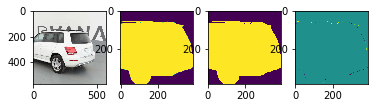

406it [04:21,  1.60it/s]

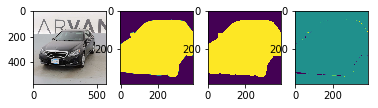

407it [04:21,  1.64it/s]

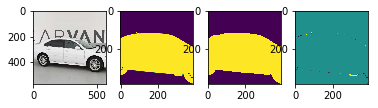

408it [04:22,  1.60it/s]

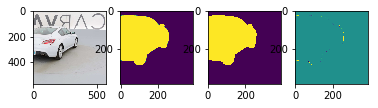

409it [04:23,  1.61it/s]

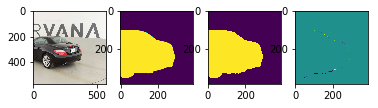

410it [04:23,  1.47it/s]

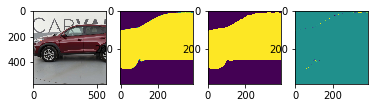

411it [04:24,  1.54it/s]

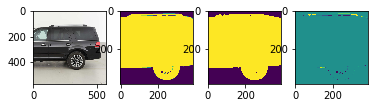

412it [04:25,  1.59it/s]

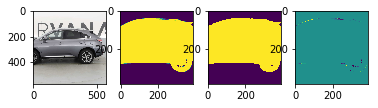

413it [04:25,  1.57it/s]

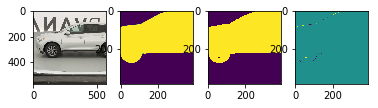

414it [04:26,  1.61it/s]

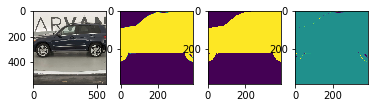

415it [04:26,  1.60it/s]

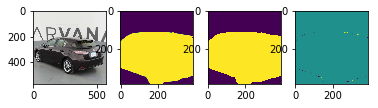

416it [04:27,  1.62it/s]

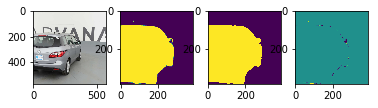

417it [04:28,  1.48it/s]

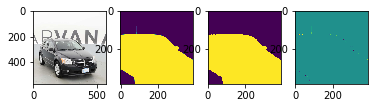

418it [04:28,  1.53it/s]

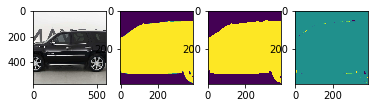

419it [04:29,  1.52it/s]

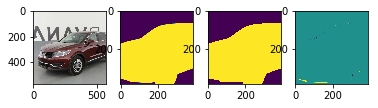

420it [04:30,  1.52it/s]

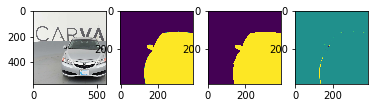

421it [04:30,  1.53it/s]

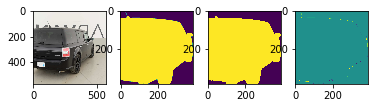

422it [04:31,  1.54it/s]

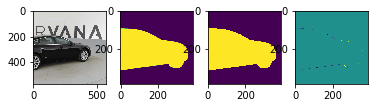

423it [04:32,  1.56it/s]

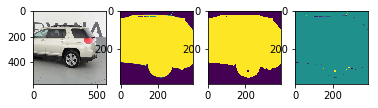

424it [04:32,  1.61it/s]

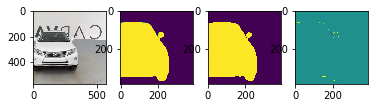

425it [04:33,  1.46it/s]

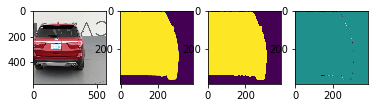

426it [04:34,  1.50it/s]

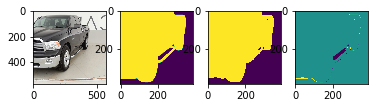

427it [04:34,  1.56it/s]

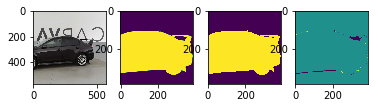

428it [04:35,  1.60it/s]

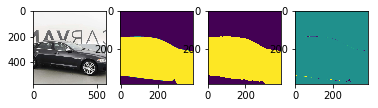

429it [04:35,  1.63it/s]

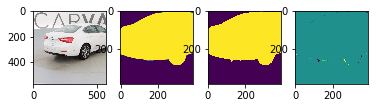

430it [04:36,  1.62it/s]

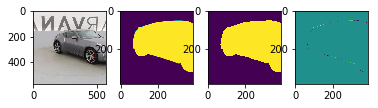

431it [04:37,  1.64it/s]

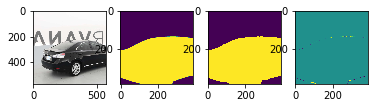

432it [04:37,  1.50it/s]

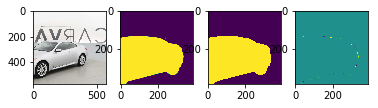

433it [04:38,  1.55it/s]

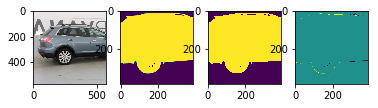

434it [04:39,  1.61it/s]

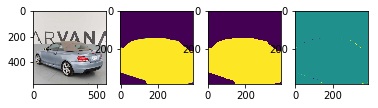

435it [04:39,  1.64it/s]

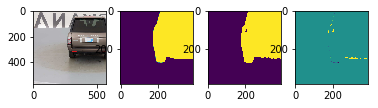

436it [04:40,  1.61it/s]

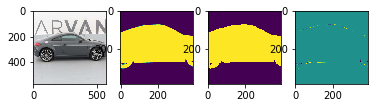

437it [04:40,  1.65it/s]

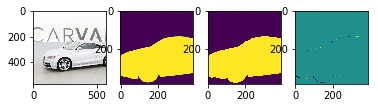

438it [04:41,  1.66it/s]

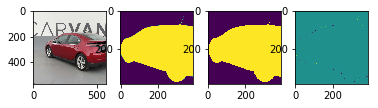

439it [04:42,  1.67it/s]

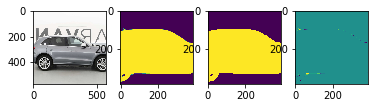

440it [04:42,  1.51it/s]

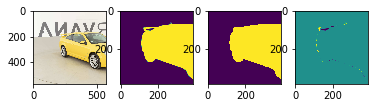

441it [04:43,  1.53it/s]

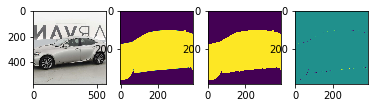

442it [04:44,  1.53it/s]

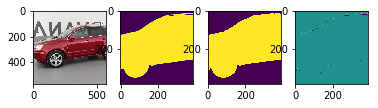

443it [04:44,  1.57it/s]

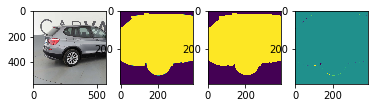

444it [04:45,  1.58it/s]

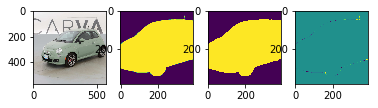

445it [04:46,  1.57it/s]

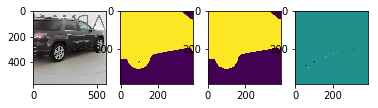

446it [04:46,  1.61it/s]

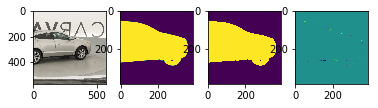

447it [04:47,  1.63it/s]

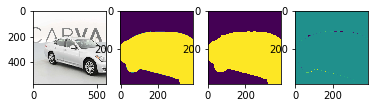

448it [04:48,  1.45it/s]

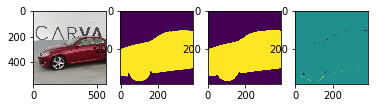

449it [04:48,  1.49it/s]

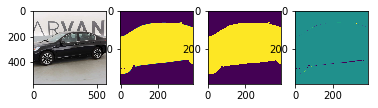

450it [04:49,  1.56it/s]

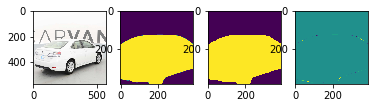

451it [04:49,  1.61it/s]

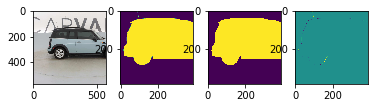

452it [04:50,  1.59it/s]

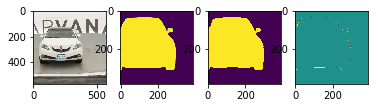

453it [04:51,  1.62it/s]

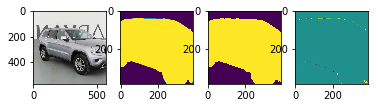

454it [04:51,  1.65it/s]

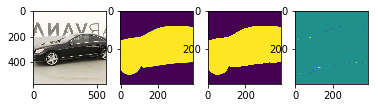

455it [04:52,  1.50it/s]

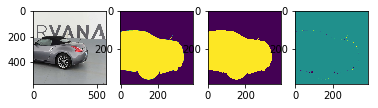

456it [04:53,  1.53it/s]

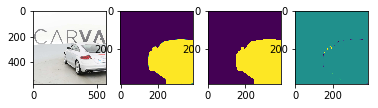

457it [04:53,  1.58it/s]

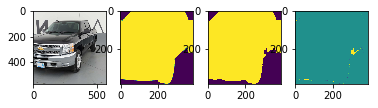

458it [04:54,  1.57it/s]

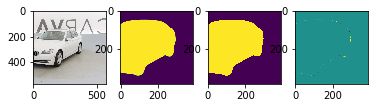

459it [04:54,  1.55it/s]

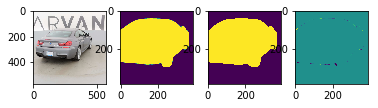

460it [04:55,  1.54it/s]

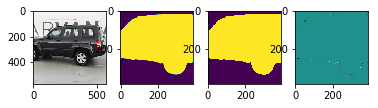

461it [04:56,  1.58it/s]

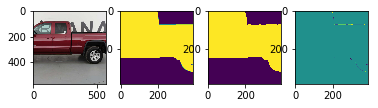

462it [04:56,  1.62it/s]

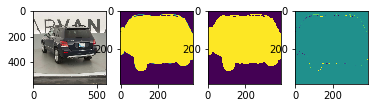

463it [04:57,  1.49it/s]

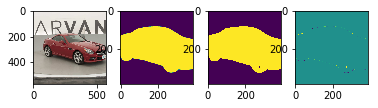

464it [04:58,  1.49it/s]

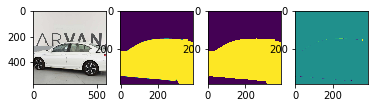

465it [04:58,  1.51it/s]

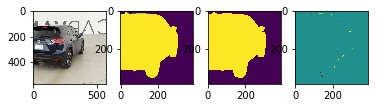

466it [04:59,  1.51it/s]

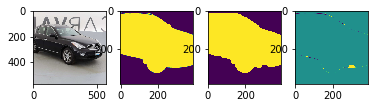

467it [05:00,  1.55it/s]

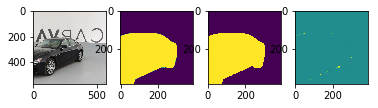

468it [05:00,  1.54it/s]

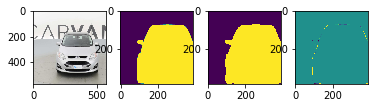

469it [05:01,  1.58it/s]

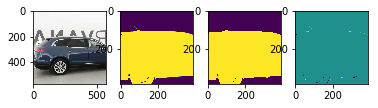

470it [05:02,  1.46it/s]

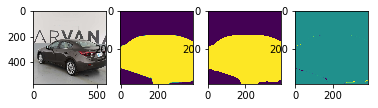

471it [05:02,  1.52it/s]

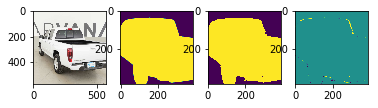

472it [05:03,  1.57it/s]

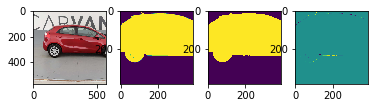

473it [05:04,  1.60it/s]

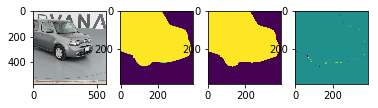

474it [05:04,  1.62it/s]

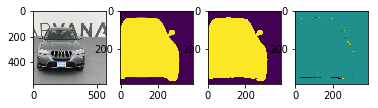

475it [05:05,  1.62it/s]

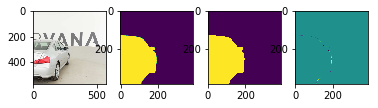

476it [05:05,  1.65it/s]

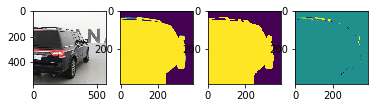

477it [05:06,  1.66it/s]

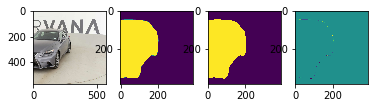

478it [05:07,  1.49it/s]

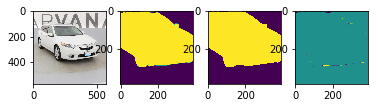

479it [05:07,  1.50it/s]

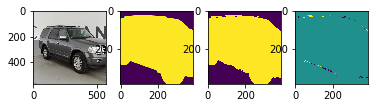

480it [05:08,  1.51it/s]

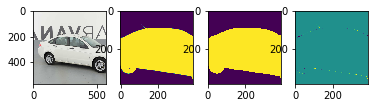

481it [05:09,  1.51it/s]

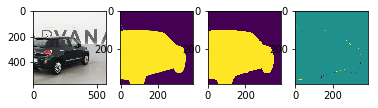

482it [05:09,  1.52it/s]

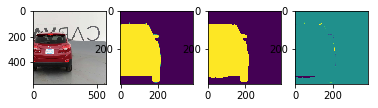

483it [05:10,  1.53it/s]

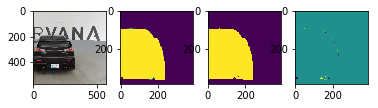

484it [05:11,  1.58it/s]

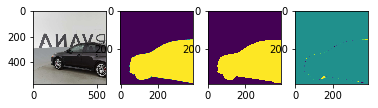

485it [05:11,  1.58it/s]

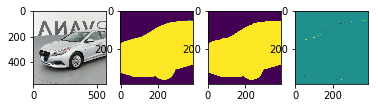

486it [05:12,  1.45it/s]

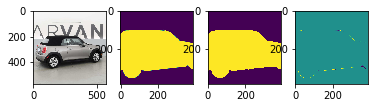

487it [05:13,  1.52it/s]

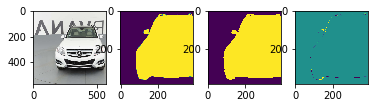

488it [05:13,  1.57it/s]

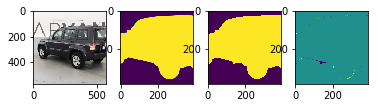

489it [05:14,  1.60it/s]

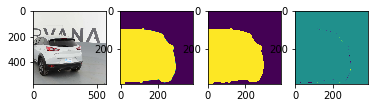

490it [05:14,  1.63it/s]

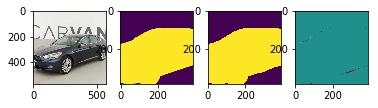

491it [05:15,  1.63it/s]

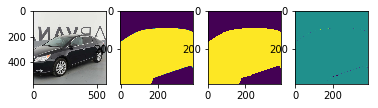

492it [05:16,  1.60it/s]

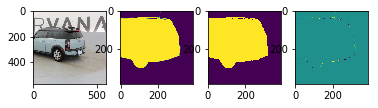

493it [05:17,  1.47it/s]

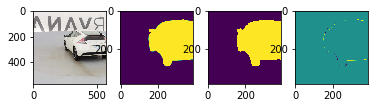

494it [05:17,  1.48it/s]

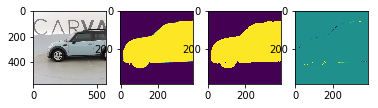

495it [05:18,  1.54it/s]

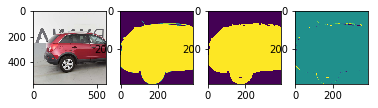

496it [05:18,  1.60it/s]

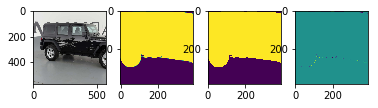

497it [05:19,  1.58it/s]

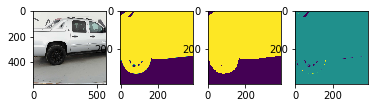

498it [05:20,  1.58it/s]

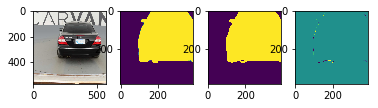

499it [05:20,  1.62it/s]

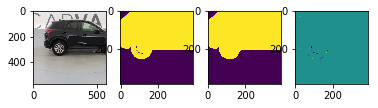

500it [05:21,  1.59it/s]

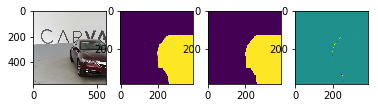

501it [05:22,  1.44it/s]

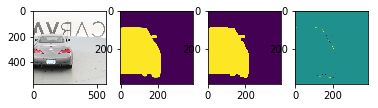

502it [05:22,  1.48it/s]

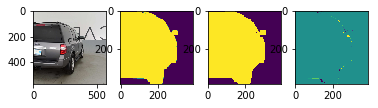

503it [05:23,  1.52it/s]

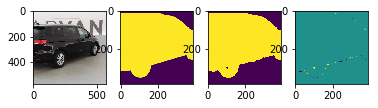

504it [05:24,  1.58it/s]

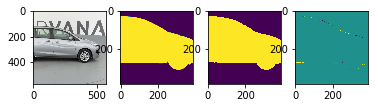

505it [05:24,  1.56it/s]

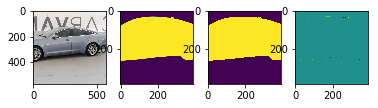

506it [05:25,  1.56it/s]

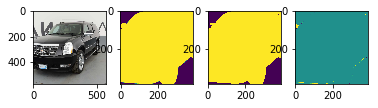

507it [05:25,  1.60it/s]

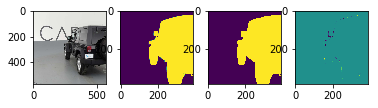

508it [05:26,  1.42it/s]

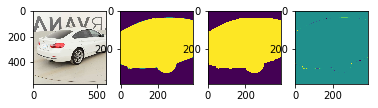

509it [05:27,  1.46it/s]

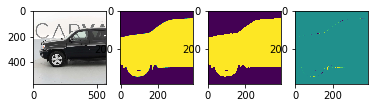

510it [05:28,  1.53it/s]

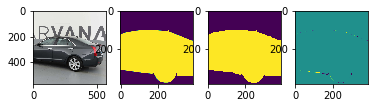

511it [05:28,  1.58it/s]

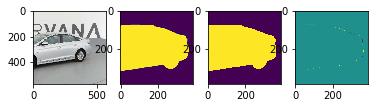

512it [05:29,  1.57it/s]

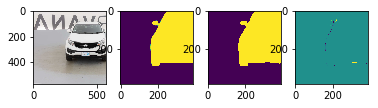

513it [05:29,  1.61it/s]

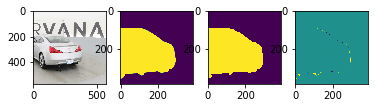

514it [05:30,  1.64it/s]

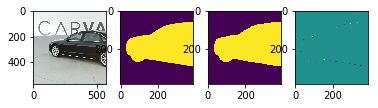

515it [05:30,  1.67it/s]

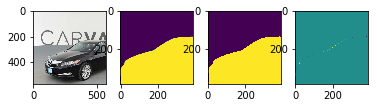

516it [05:31,  1.47it/s]

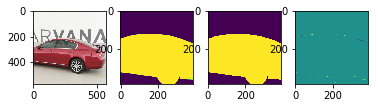

517it [05:32,  1.54it/s]

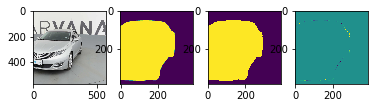

518it [05:33,  1.54it/s]

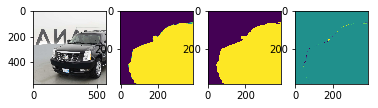

519it [05:33,  1.58it/s]

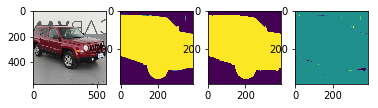

520it [05:34,  1.56it/s]

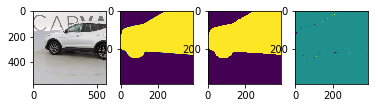

521it [05:34,  1.57it/s]

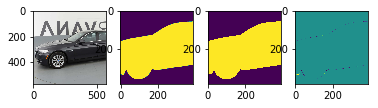

522it [05:35,  1.60it/s]

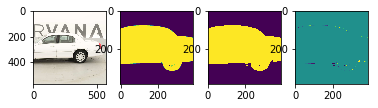

523it [05:36,  1.64it/s]

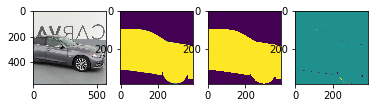

524it [05:36,  1.49it/s]

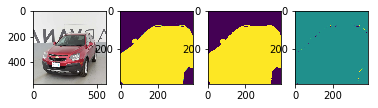

525it [05:37,  1.53it/s]

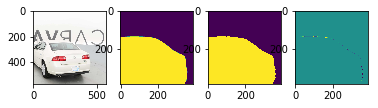

526it [05:38,  1.58it/s]

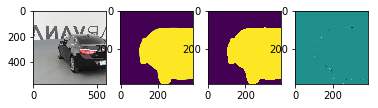

527it [05:38,  1.55it/s]

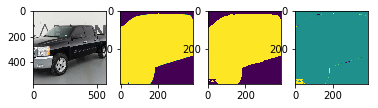

528it [05:39,  1.53it/s]

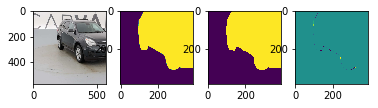

529it [05:40,  1.55it/s]

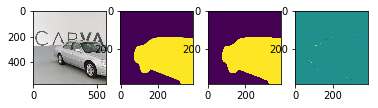

530it [05:40,  1.55it/s]

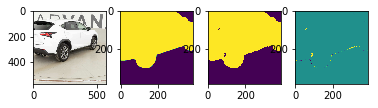

531it [05:41,  1.43it/s]

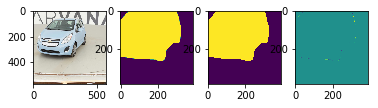

532it [05:42,  1.50it/s]

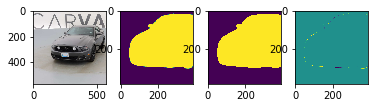

533it [05:42,  1.53it/s]

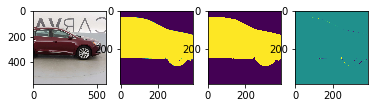

534it [05:43,  1.59it/s]

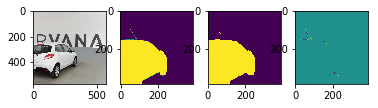

535it [05:43,  1.62it/s]

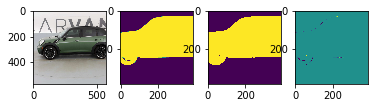

536it [05:44,  1.63it/s]

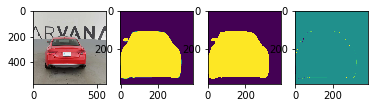

537it [05:45,  1.61it/s]

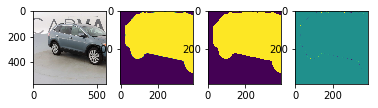

538it [05:45,  1.64it/s]

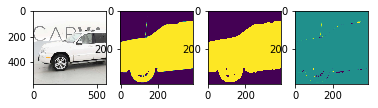

539it [05:46,  1.50it/s]

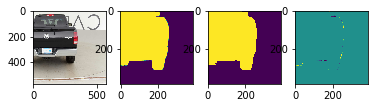

540it [05:47,  1.56it/s]

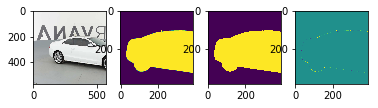

541it [05:47,  1.61it/s]

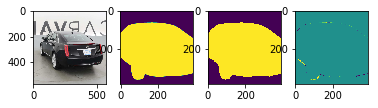

542it [05:48,  1.65it/s]

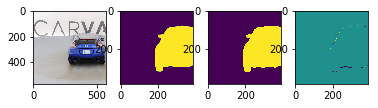

543it [05:48,  1.63it/s]

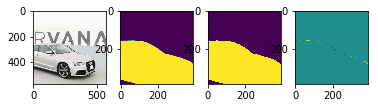

544it [05:49,  1.66it/s]

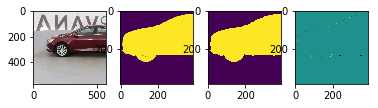

545it [05:50,  1.63it/s]

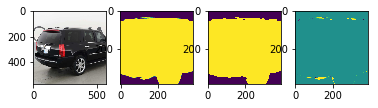

546it [05:50,  1.49it/s]

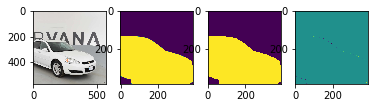

547it [05:51,  1.53it/s]

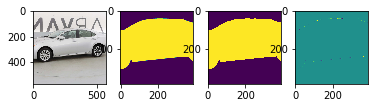

548it [05:52,  1.57it/s]

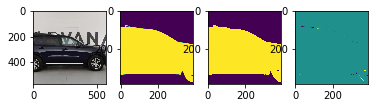

549it [05:52,  1.62it/s]

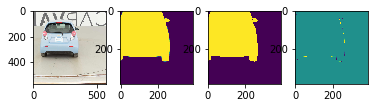

550it [05:53,  1.65it/s]

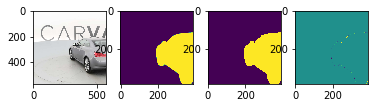

551it [05:53,  1.67it/s]

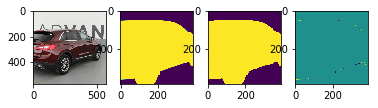

552it [05:54,  1.66it/s]

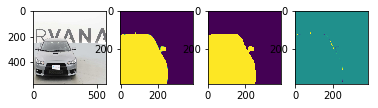

553it [05:55,  1.67it/s]

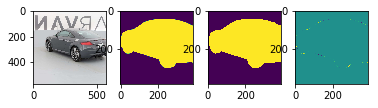

554it [05:55,  1.48it/s]

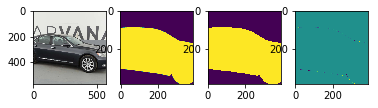

555it [05:56,  1.53it/s]

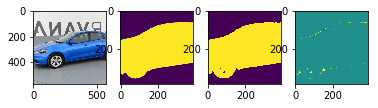

556it [05:57,  1.55it/s]

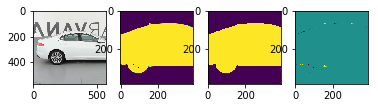

557it [05:57,  1.59it/s]

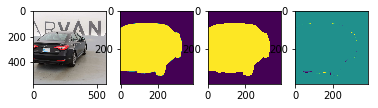

558it [05:58,  1.59it/s]

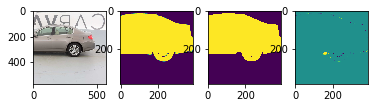

559it [05:59,  1.62it/s]

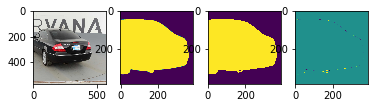

560it [05:59,  1.64it/s]

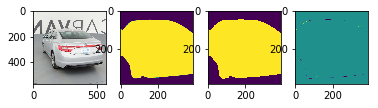

561it [06:00,  1.67it/s]

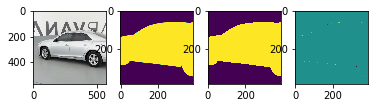

562it [06:00,  1.51it/s]

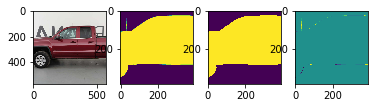

563it [06:01,  1.56it/s]

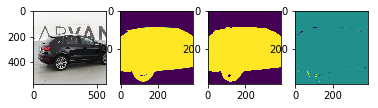

564it [06:02,  1.57it/s]

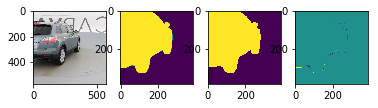

565it [06:02,  1.58it/s]

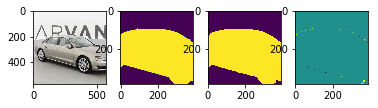

566it [06:03,  1.59it/s]

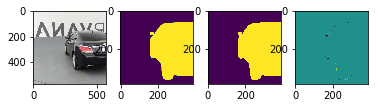

567it [06:04,  1.60it/s]

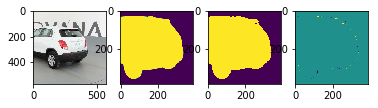

568it [06:04,  1.62it/s]

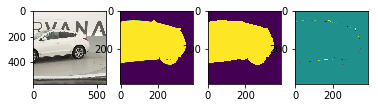

569it [06:05,  1.49it/s]

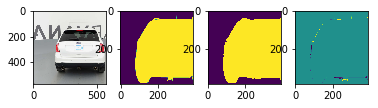

570it [06:06,  1.55it/s]

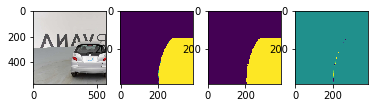

571it [06:06,  1.59it/s]

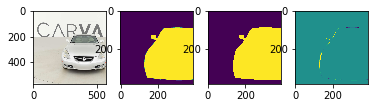

572it [06:07,  1.63it/s]

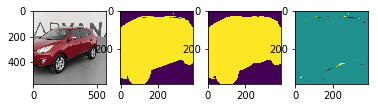

573it [06:07,  1.66it/s]

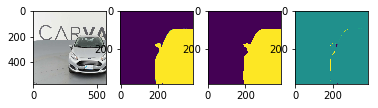

574it [06:08,  1.68it/s]

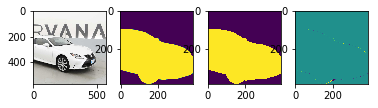

575it [06:08,  1.70it/s]

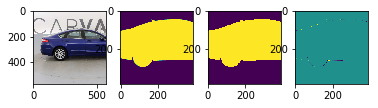

576it [06:09,  1.67it/s]

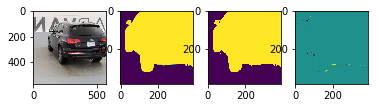

577it [06:10,  1.46it/s]

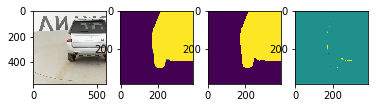

578it [06:11,  1.49it/s]

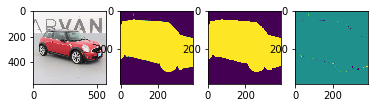

579it [06:11,  1.52it/s]

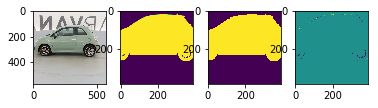

580it [06:12,  1.58it/s]

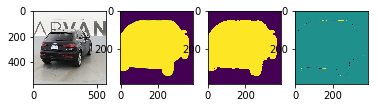

581it [06:12,  1.62it/s]

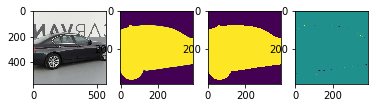

582it [06:13,  1.64it/s]

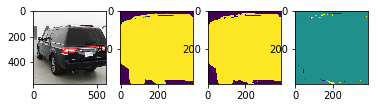

583it [06:14,  1.65it/s]

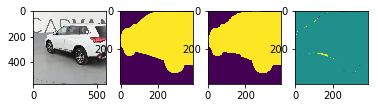

584it [06:14,  1.51it/s]

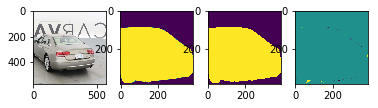

585it [06:15,  1.57it/s]

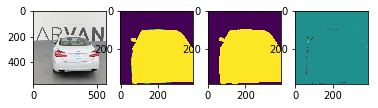

586it [06:16,  1.62it/s]

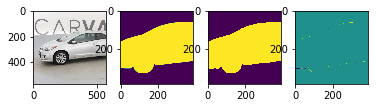

587it [06:16,  1.58it/s]

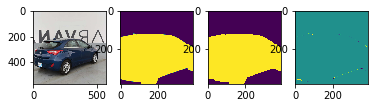

588it [06:17,  1.61it/s]

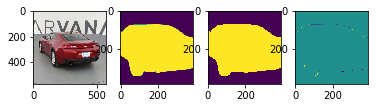

589it [06:17,  1.59it/s]

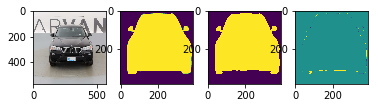

590it [06:18,  1.57it/s]

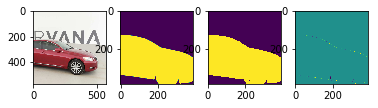

591it [06:19,  1.55it/s]

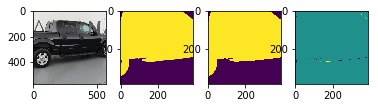

592it [06:20,  1.42it/s]

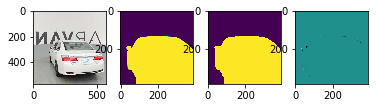

593it [06:20,  1.50it/s]

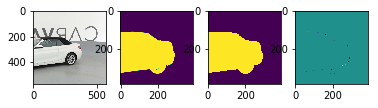

594it [06:21,  1.56it/s]

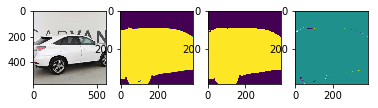

595it [06:21,  1.60it/s]

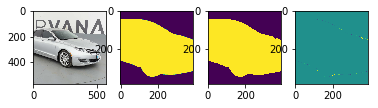

596it [06:22,  1.60it/s]

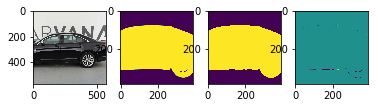

597it [06:23,  1.60it/s]

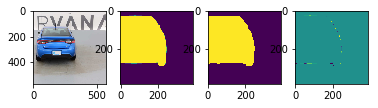

598it [06:23,  1.57it/s]

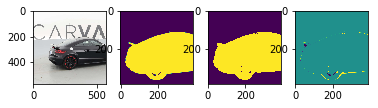

599it [06:24,  1.56it/s]

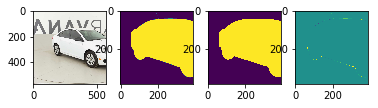

600it [06:25,  1.43it/s]

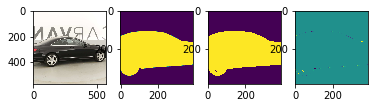

601it [06:25,  1.50it/s]

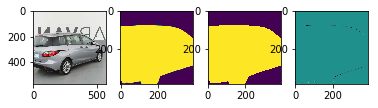

602it [06:26,  1.53it/s]

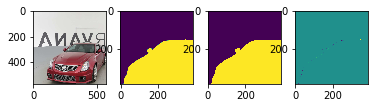

603it [06:27,  1.56it/s]

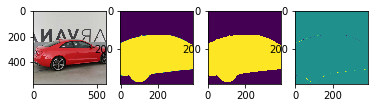

604it [06:27,  1.60it/s]

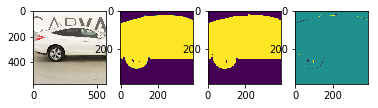

605it [06:28,  1.64it/s]

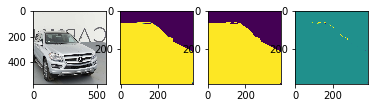

606it [06:28,  1.65it/s]

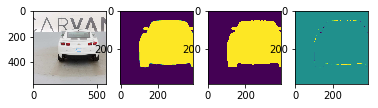

607it [06:29,  1.46it/s]

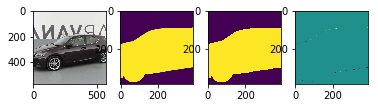

608it [06:30,  1.50it/s]

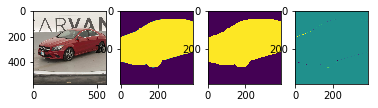

609it [06:30,  1.51it/s]

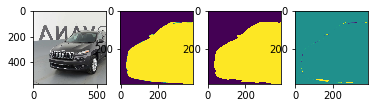

610it [06:31,  1.52it/s]

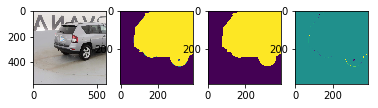

611it [06:32,  1.52it/s]

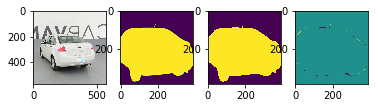

612it [06:32,  1.52it/s]

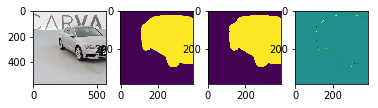

613it [06:33,  1.57it/s]

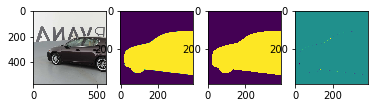

614it [06:34,  1.61it/s]

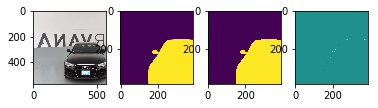

615it [06:34,  1.48it/s]

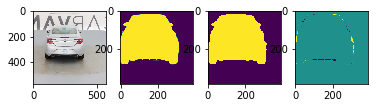

616it [06:35,  1.48it/s]

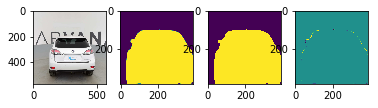

617it [06:36,  1.55it/s]

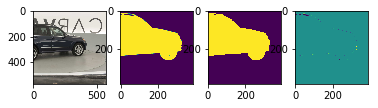

618it [06:36,  1.55it/s]

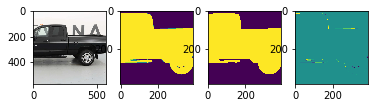

619it [06:37,  1.58it/s]

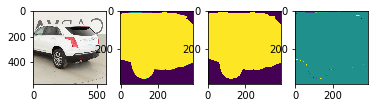

620it [06:38,  1.59it/s]

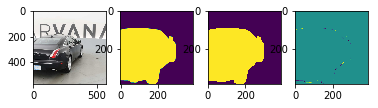

621it [06:38,  1.60it/s]

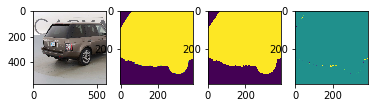

622it [06:39,  1.61it/s]

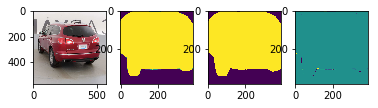

623it [06:40,  1.42it/s]

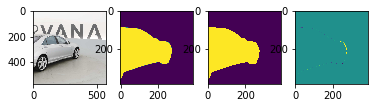

624it [06:40,  1.50it/s]

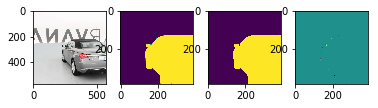

625it [06:41,  1.56it/s]

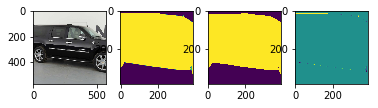

626it [06:41,  1.60it/s]

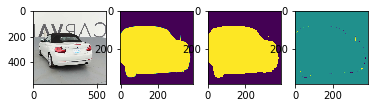

627it [06:42,  1.59it/s]

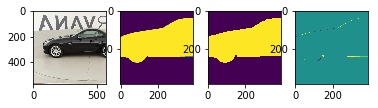

628it [06:43,  1.57it/s]

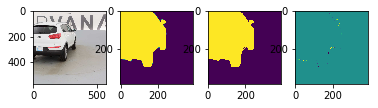

629it [06:43,  1.56it/s]

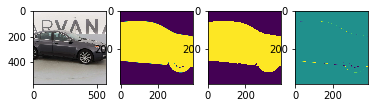

630it [06:44,  1.41it/s]

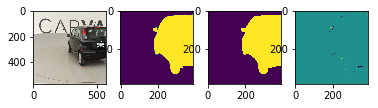

631it [06:45,  1.49it/s]

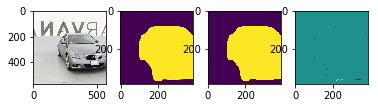

632it [06:45,  1.53it/s]

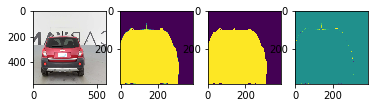

633it [06:46,  1.57it/s]

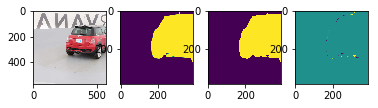

634it [06:47,  1.56it/s]

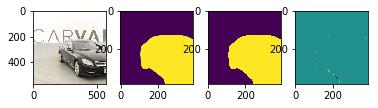

635it [06:47,  1.59it/s]

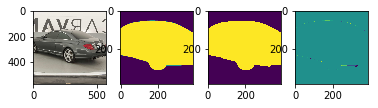

636it [06:48,  1.62it/s]

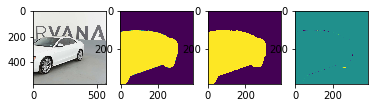

637it [06:48,  1.59it/s]

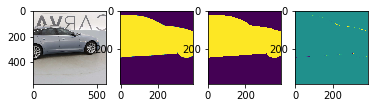

638it [06:49,  1.43it/s]

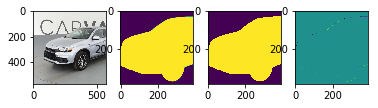

639it [06:50,  1.46it/s]

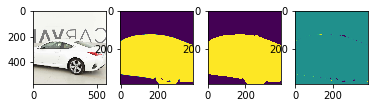

640it [06:51,  1.52it/s]

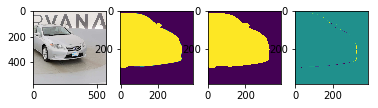

641it [06:51,  1.52it/s]

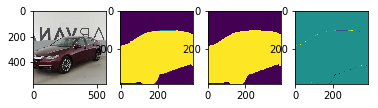

642it [06:52,  1.58it/s]

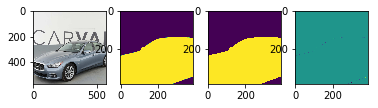

643it [06:52,  1.59it/s]

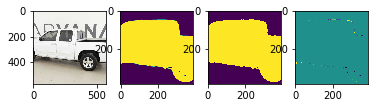

644it [06:53,  1.62it/s]

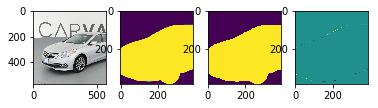

645it [06:54,  1.65it/s]

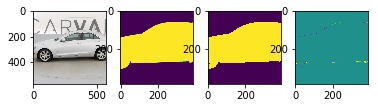

646it [06:55,  1.44it/s]

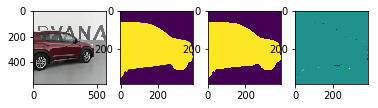

647it [06:55,  1.46it/s]

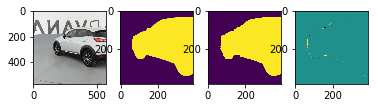

648it [06:56,  1.48it/s]

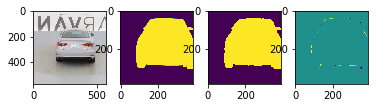

649it [06:56,  1.50it/s]

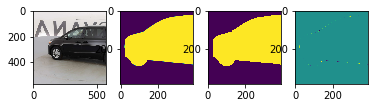

650it [06:57,  1.54it/s]

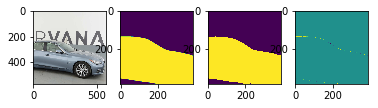

651it [06:58,  1.57it/s]

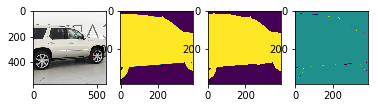

652it [06:58,  1.61it/s]

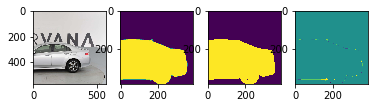

653it [06:59,  1.44it/s]

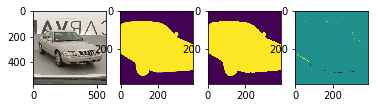

654it [07:00,  1.49it/s]

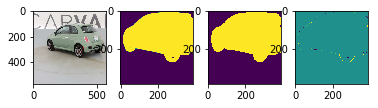

655it [07:00,  1.55it/s]

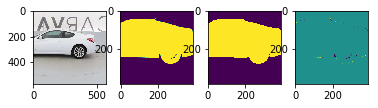

656it [07:01,  1.56it/s]

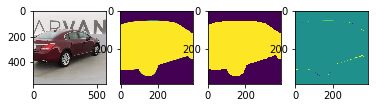

657it [07:02,  1.60it/s]

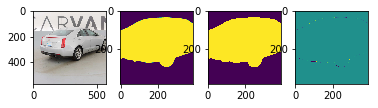

658it [07:02,  1.62it/s]

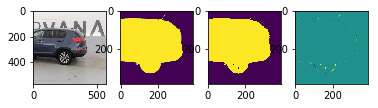

659it [07:03,  1.62it/s]

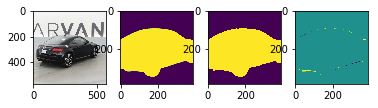

660it [07:03,  1.64it/s]

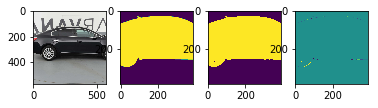

661it [07:04,  1.50it/s]

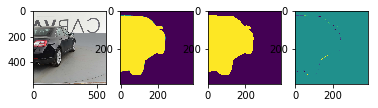

662it [07:05,  1.54it/s]

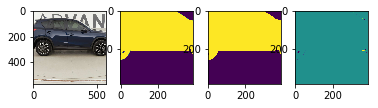

663it [07:05,  1.57it/s]

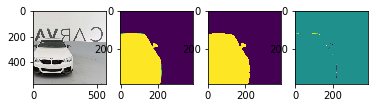

664it [07:06,  1.59it/s]

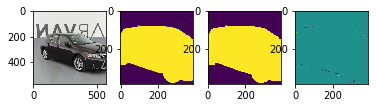

665it [07:07,  1.62it/s]

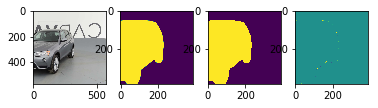

666it [07:07,  1.59it/s]

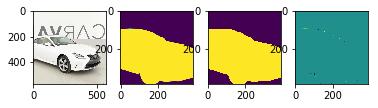

667it [07:08,  1.61it/s]

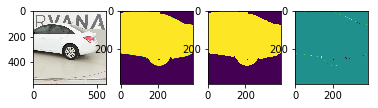

668it [07:09,  1.47it/s]

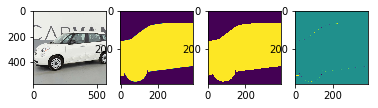

669it [07:09,  1.50it/s]

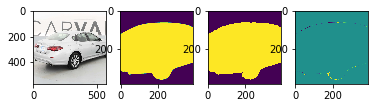

670it [07:10,  1.57it/s]

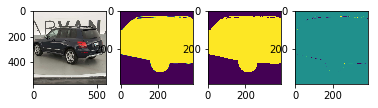

671it [07:10,  1.61it/s]

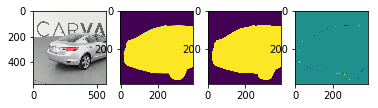

672it [07:11,  1.57it/s]

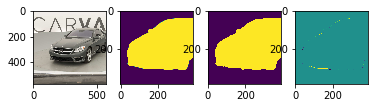

673it [07:12,  1.58it/s]

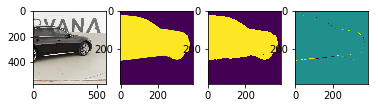

674it [07:12,  1.61it/s]

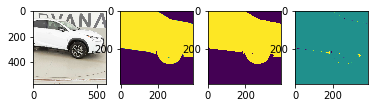

675it [07:13,  1.65it/s]

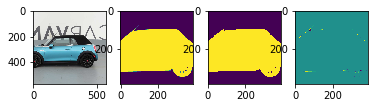

676it [07:14,  1.48it/s]

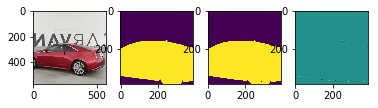

677it [07:14,  1.55it/s]

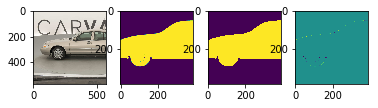

678it [07:15,  1.60it/s]

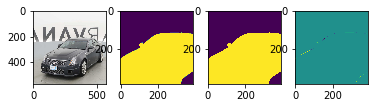

679it [07:16,  1.62it/s]

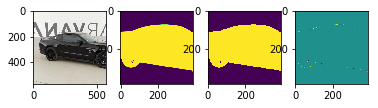

680it [07:16,  1.64it/s]

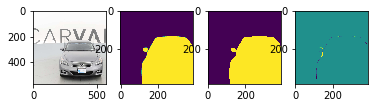

681it [07:17,  1.66it/s]

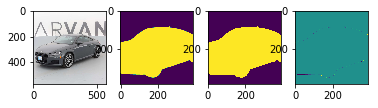

682it [07:17,  1.61it/s]

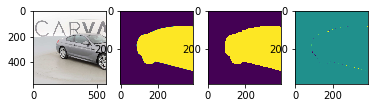

683it [07:18,  1.58it/s]

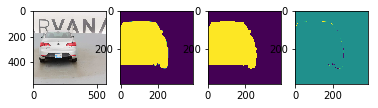

684it [07:19,  1.42it/s]

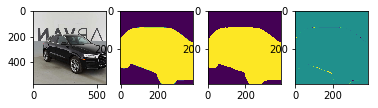

685it [07:20,  1.45it/s]

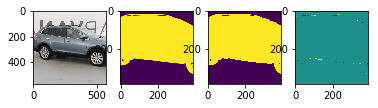

686it [07:20,  1.50it/s]

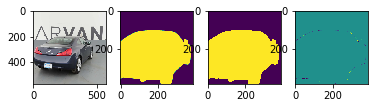

687it [07:21,  1.51it/s]

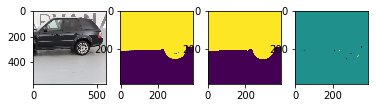

688it [07:21,  1.56it/s]

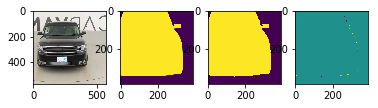

689it [07:22,  1.59it/s]

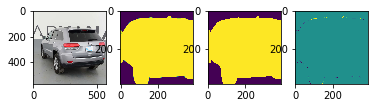

690it [07:23,  1.59it/s]

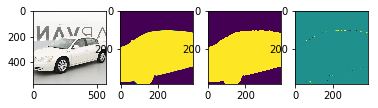

691it [07:23,  1.47it/s]

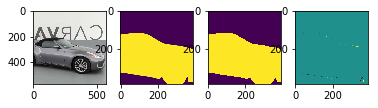

692it [07:24,  1.51it/s]

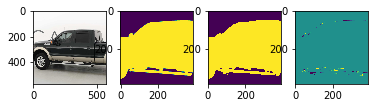

693it [07:25,  1.54it/s]

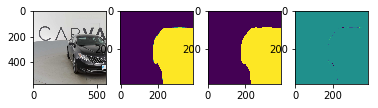

694it [07:25,  1.59it/s]

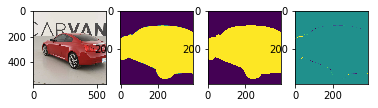

695it [07:26,  1.60it/s]

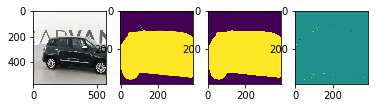

696it [07:26,  1.61it/s]

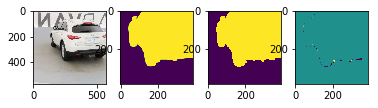

697it [07:27,  1.63it/s]

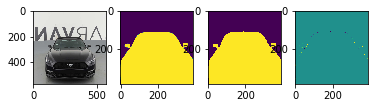

698it [07:28,  1.60it/s]

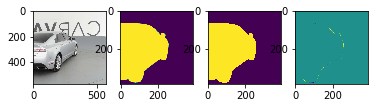

699it [07:29,  1.48it/s]

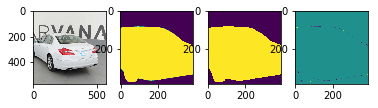

700it [07:29,  1.54it/s]

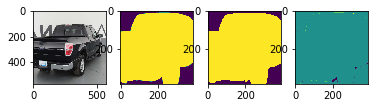

701it [07:30,  1.56it/s]

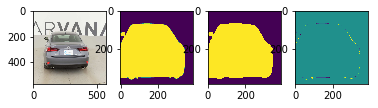

702it [07:30,  1.61it/s]

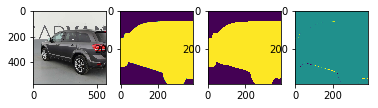

703it [07:31,  1.60it/s]

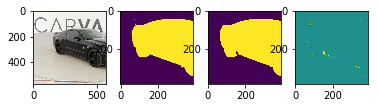

704it [07:32,  1.64it/s]

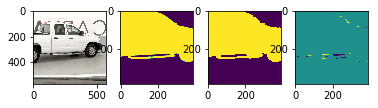

705it [07:32,  1.66it/s]

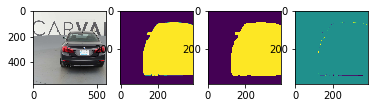

706it [07:33,  1.51it/s]

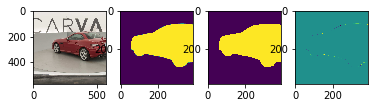

707it [07:33,  1.57it/s]

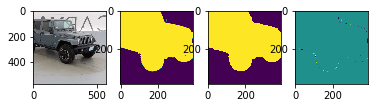

708it [07:34,  1.56it/s]

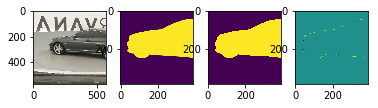

709it [07:35,  1.59it/s]

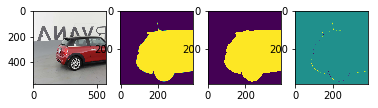

710it [07:35,  1.62it/s]

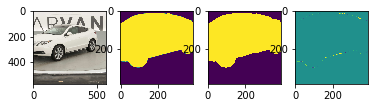

711it [07:36,  1.64it/s]

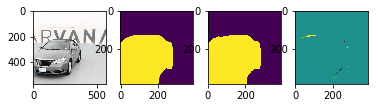

712it [07:37,  1.62it/s]

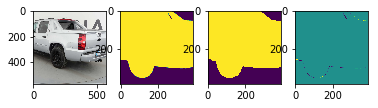

713it [07:37,  1.65it/s]

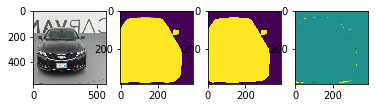

714it [07:38,  1.45it/s]

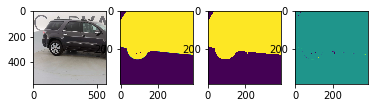

715it [07:39,  1.50it/s]

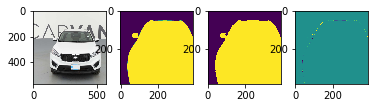

716it [07:39,  1.50it/s]

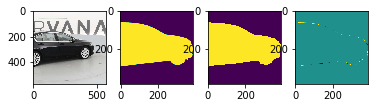

717it [07:40,  1.54it/s]

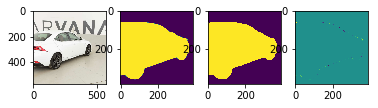

718it [07:40,  1.58it/s]

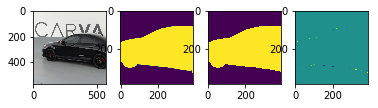

719it [07:41,  1.61it/s]

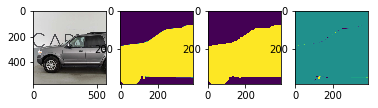

720it [07:42,  1.64it/s]

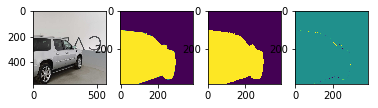

721it [07:42,  1.61it/s]

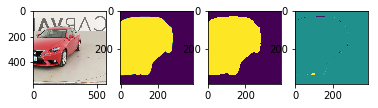

722it [07:43,  1.48it/s]

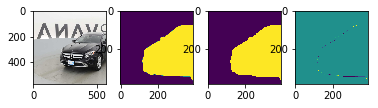

723it [07:44,  1.51it/s]

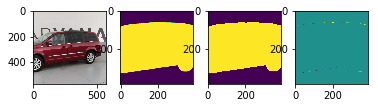

724it [07:44,  1.54it/s]

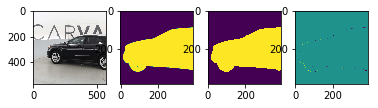

725it [07:45,  1.52it/s]

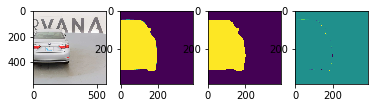

726it [07:46,  1.55it/s]

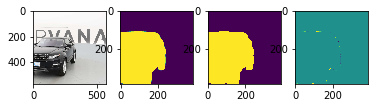

727it [07:46,  1.59it/s]

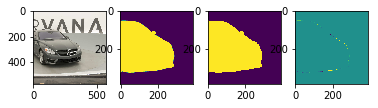

728it [07:47,  1.63it/s]

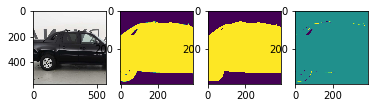

729it [07:48,  1.47it/s]

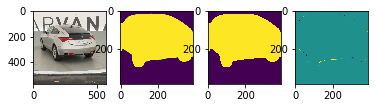

730it [07:48,  1.54it/s]

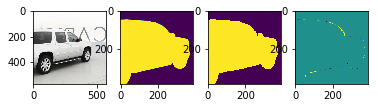

731it [07:49,  1.60it/s]

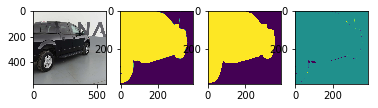

732it [07:49,  1.63it/s]

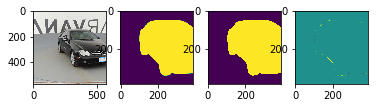

733it [07:50,  1.64it/s]

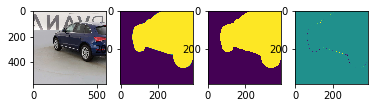

734it [07:51,  1.66it/s]

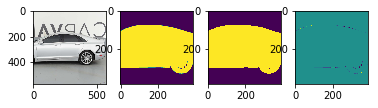

735it [07:51,  1.68it/s]

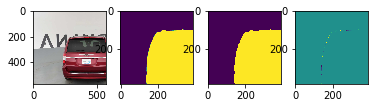

736it [07:52,  1.69it/s]

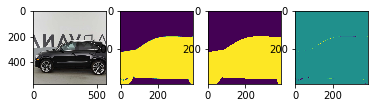

737it [07:53,  1.51it/s]

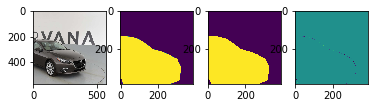

738it [07:53,  1.53it/s]

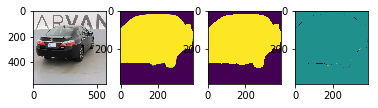

739it [07:54,  1.58it/s]

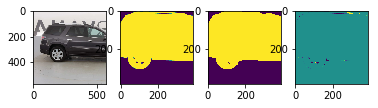

740it [07:54,  1.63it/s]

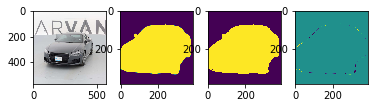

741it [07:55,  1.62it/s]

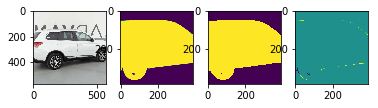

742it [07:56,  1.66it/s]

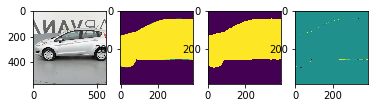

743it [07:56,  1.67it/s]

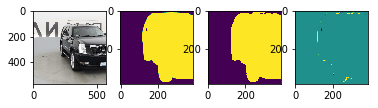

744it [07:57,  1.46it/s]

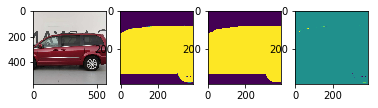

745it [07:58,  1.50it/s]

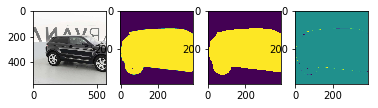

746it [07:58,  1.54it/s]

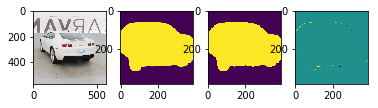

747it [07:59,  1.56it/s]

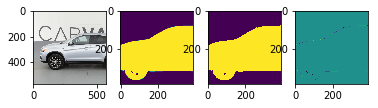

748it [07:59,  1.58it/s]

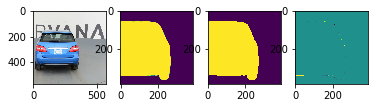

749it [08:00,  1.59it/s]

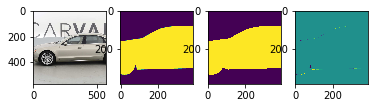

750it [08:01,  1.62it/s]

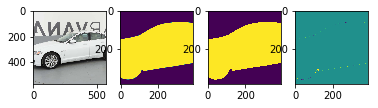

751it [08:01,  1.66it/s]

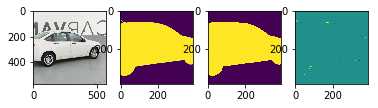

752it [08:02,  1.44it/s]

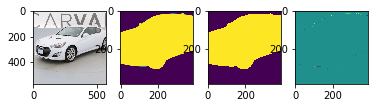

753it [08:03,  1.50it/s]

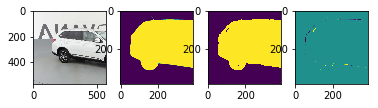

754it [08:03,  1.55it/s]

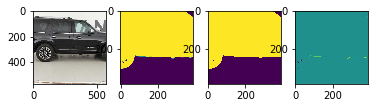

755it [08:04,  1.55it/s]

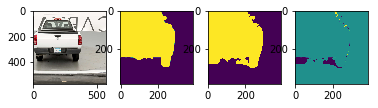

756it [08:05,  1.54it/s]

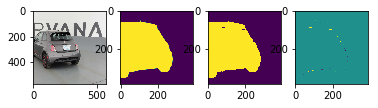

757it [08:05,  1.56it/s]

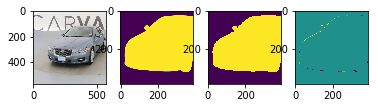

758it [08:06,  1.59it/s]

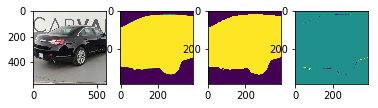

759it [08:07,  1.57it/s]

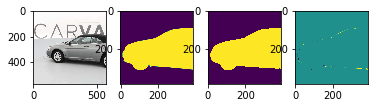

760it [08:07,  1.41it/s]

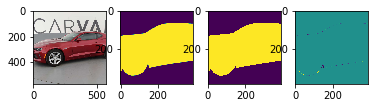

761it [08:08,  1.44it/s]

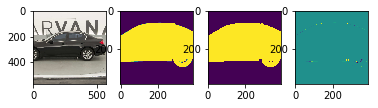

762it [08:09,  1.51it/s]

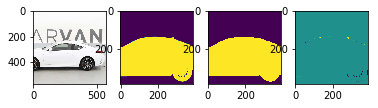

763it [08:09,  1.52it/s]

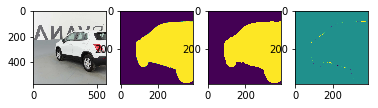

764it [08:10,  1.57it/s]

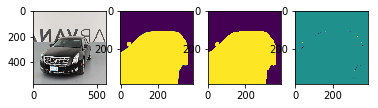

765it [08:11,  1.55it/s]

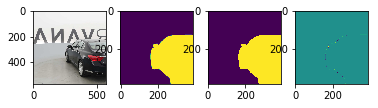

766it [08:11,  1.54it/s]

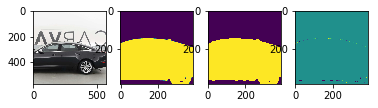

767it [08:12,  1.42it/s]

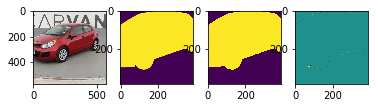

768it [08:13,  1.50it/s]

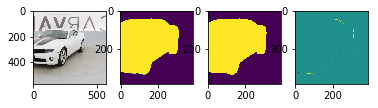

769it [08:13,  1.52it/s]

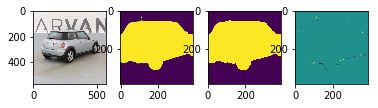

770it [08:14,  1.57it/s]

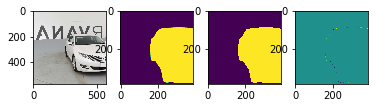

771it [08:15,  1.56it/s]

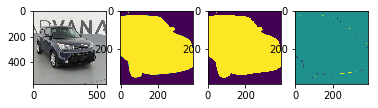

772it [08:15,  1.55it/s]

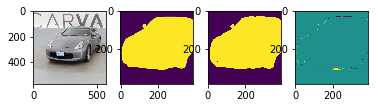

773it [08:16,  1.56it/s]

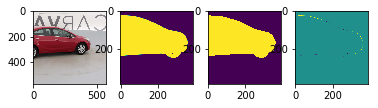

774it [08:16,  1.59it/s]

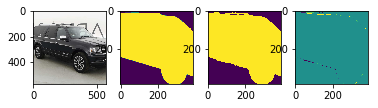

775it [08:17,  1.41it/s]

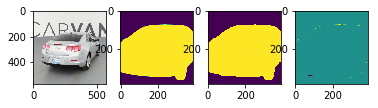

776it [08:18,  1.44it/s]

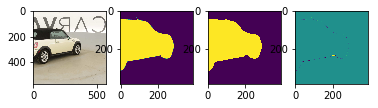

777it [08:19,  1.48it/s]

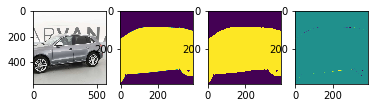

778it [08:19,  1.54it/s]

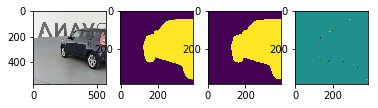

779it [08:20,  1.59it/s]

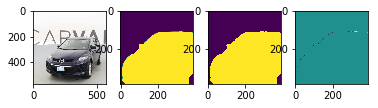

780it [08:20,  1.57it/s]

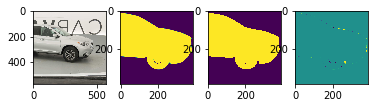

781it [08:21,  1.60it/s]

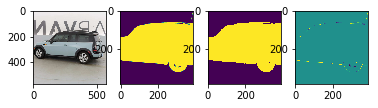

782it [08:22,  1.43it/s]

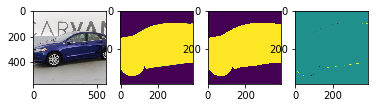

783it [08:22,  1.51it/s]

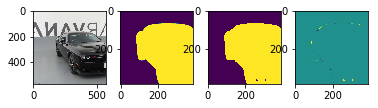

784it [08:23,  1.57it/s]

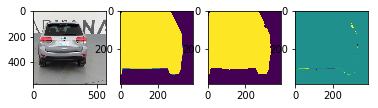

785it [08:24,  1.60it/s]

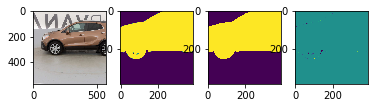

786it [08:24,  1.59it/s]

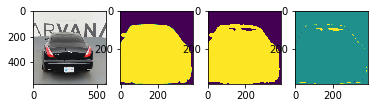

787it [08:25,  1.59it/s]

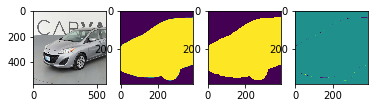

788it [08:26,  1.57it/s]

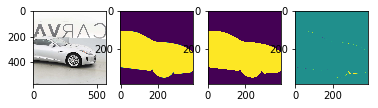

789it [08:26,  1.61it/s]

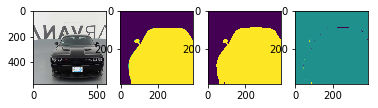

790it [08:27,  1.43it/s]

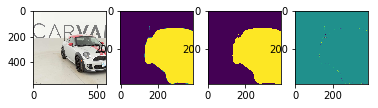

791it [08:28,  1.48it/s]

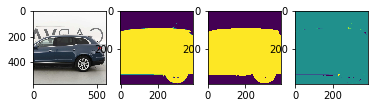

792it [08:28,  1.50it/s]

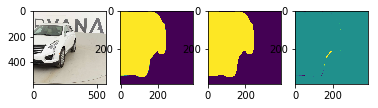

793it [08:29,  1.50it/s]

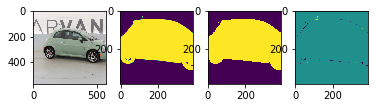

794it [08:30,  1.53it/s]

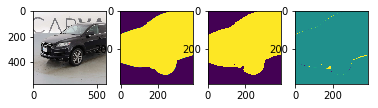

795it [08:30,  1.53it/s]

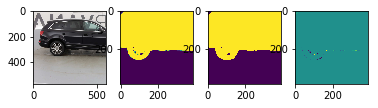

796it [08:31,  1.53it/s]

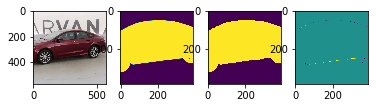

797it [08:31,  1.59it/s]

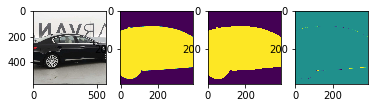

798it [08:32,  1.47it/s]

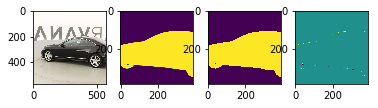

799it [08:33,  1.54it/s]

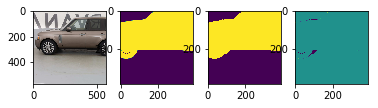

800it [08:33,  1.58it/s]

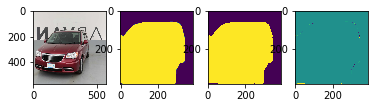

801it [08:34,  1.59it/s]

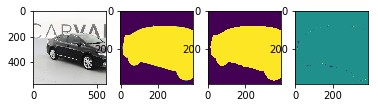

802it [08:35,  1.63it/s]

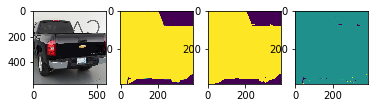

803it [08:35,  1.65it/s]

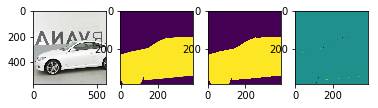

804it [08:36,  1.65it/s]

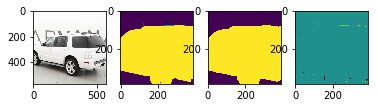

805it [08:37,  1.50it/s]

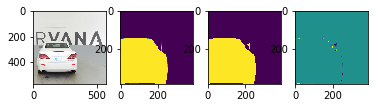

806it [08:37,  1.52it/s]

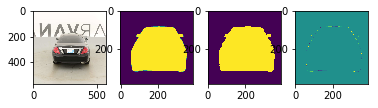

807it [08:38,  1.58it/s]

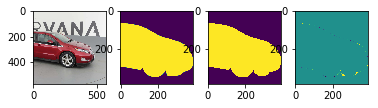

808it [08:38,  1.60it/s]

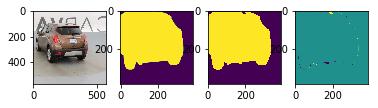

809it [08:39,  1.61it/s]

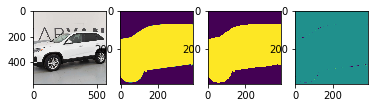

810it [08:40,  1.59it/s]

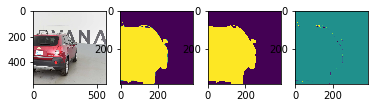

811it [08:40,  1.60it/s]

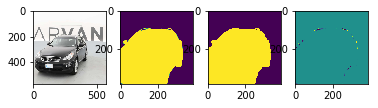

812it [08:41,  1.63it/s]

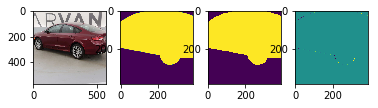

813it [08:42,  1.48it/s]

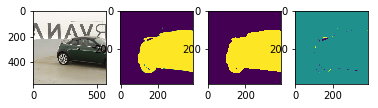

814it [08:42,  1.51it/s]

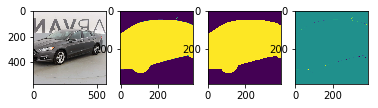

815it [08:43,  1.56it/s]

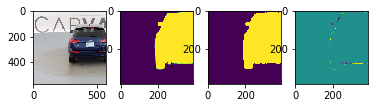

816it [08:44,  1.61it/s]

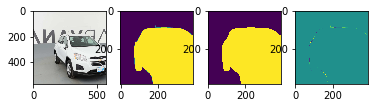

817it [08:44,  1.64it/s]

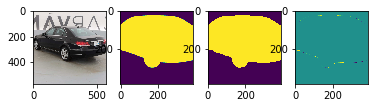

818it [08:45,  1.67it/s]

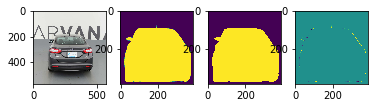

819it [08:45,  1.69it/s]

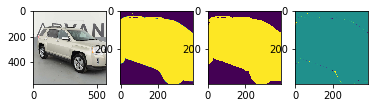

820it [08:46,  1.51it/s]

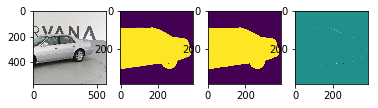

821it [08:47,  1.56it/s]

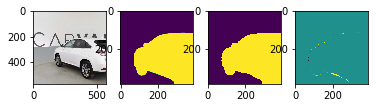

822it [08:47,  1.60it/s]

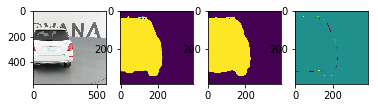

823it [08:48,  1.61it/s]

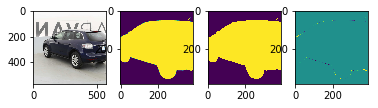

824it [08:48,  1.64it/s]

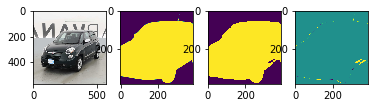

825it [08:49,  1.61it/s]

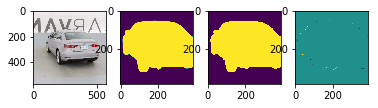

826it [08:50,  1.57it/s]

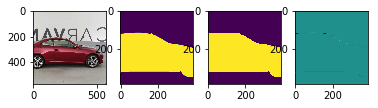

827it [08:50,  1.57it/s]

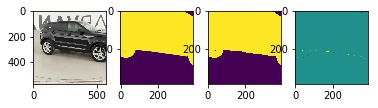

828it [08:51,  1.45it/s]

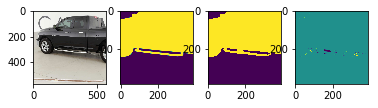

829it [08:52,  1.52it/s]

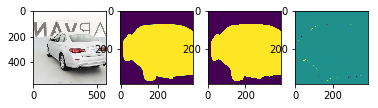

830it [08:53,  1.51it/s]

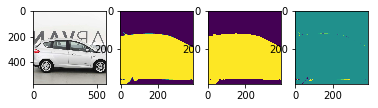

831it [08:53,  1.56it/s]

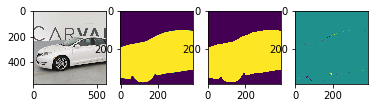

832it [08:54,  1.60it/s]

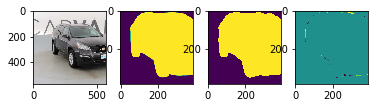

833it [08:54,  1.57it/s]

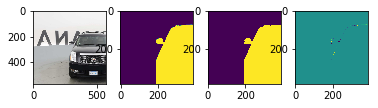

834it [08:55,  1.59it/s]

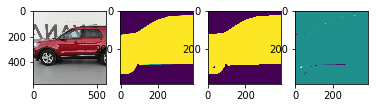

835it [08:56,  1.57it/s]

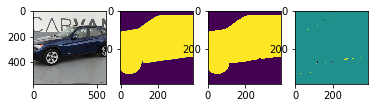

836it [08:56,  1.42it/s]

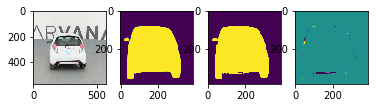

837it [08:57,  1.46it/s]

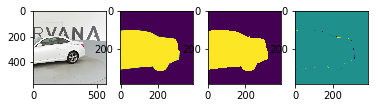

838it [08:58,  1.52it/s]

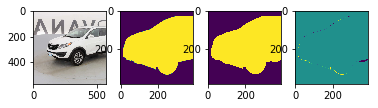

839it [08:58,  1.52it/s]

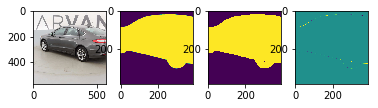

840it [08:59,  1.56it/s]

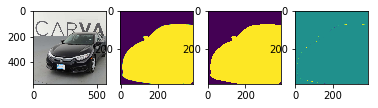

841it [09:00,  1.57it/s]

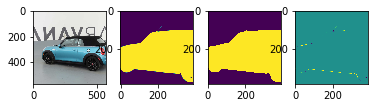

842it [09:00,  1.62it/s]

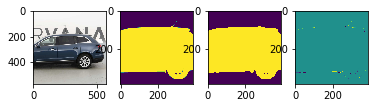

843it [09:01,  1.46it/s]

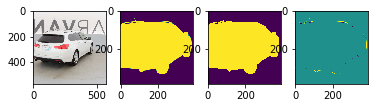

844it [09:02,  1.50it/s]

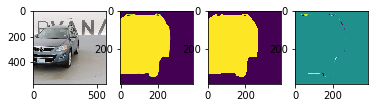

845it [09:02,  1.54it/s]

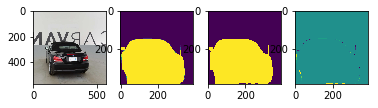

846it [09:03,  1.56it/s]

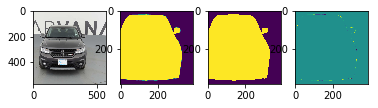

847it [09:04,  1.55it/s]

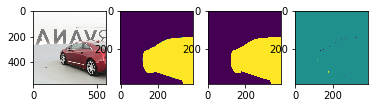

848it [09:04,  1.60it/s]

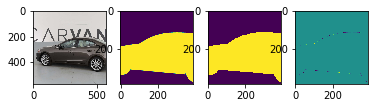

849it [09:05,  1.60it/s]

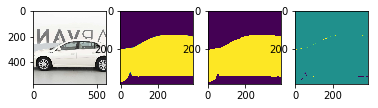

850it [09:05,  1.58it/s]

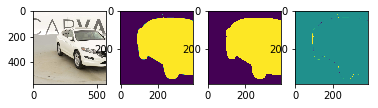

851it [09:06,  1.40it/s]

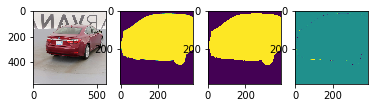

852it [09:07,  1.44it/s]

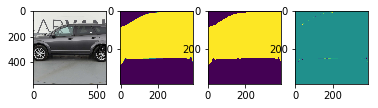

853it [09:08,  1.46it/s]

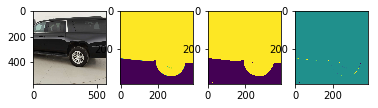

854it [09:08,  1.48it/s]

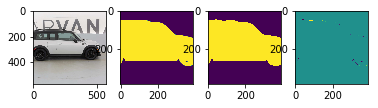

855it [09:09,  1.52it/s]

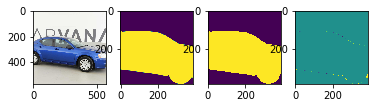

856it [09:09,  1.57it/s]

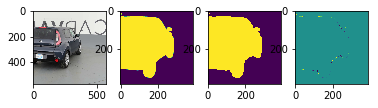

857it [09:10,  1.57it/s]

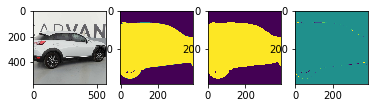

858it [09:11,  1.55it/s]

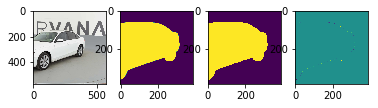

859it [09:12,  1.44it/s]

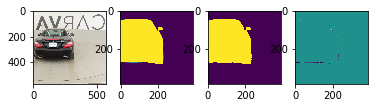

860it [09:12,  1.48it/s]

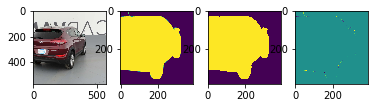

861it [09:13,  1.51it/s]

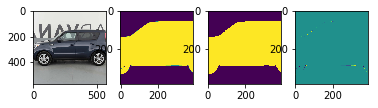

862it [09:13,  1.57it/s]

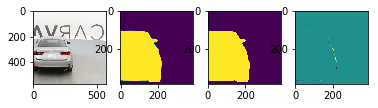

863it [09:14,  1.60it/s]

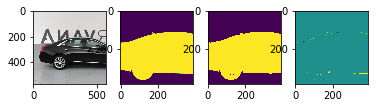

864it [09:15,  1.64it/s]

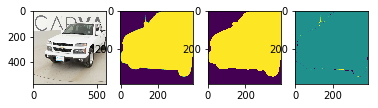

865it [09:15,  1.66it/s]

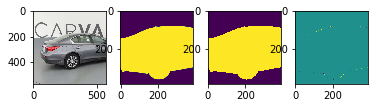

866it [09:16,  1.49it/s]

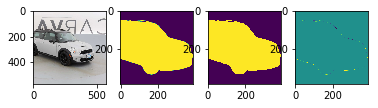

867it [09:17,  1.52it/s]

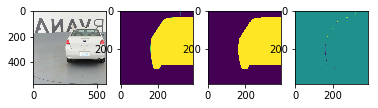

868it [09:17,  1.53it/s]

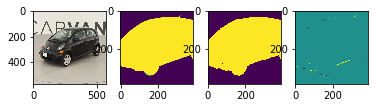

869it [09:18,  1.52it/s]

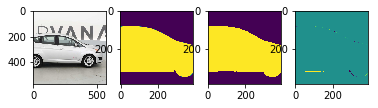

870it [09:19,  1.54it/s]

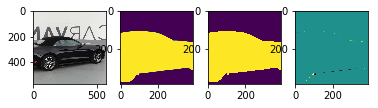

871it [09:19,  1.53it/s]

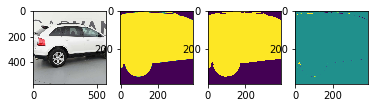

872it [09:20,  1.58it/s]

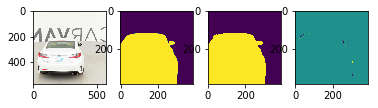

873it [09:20,  1.63it/s]

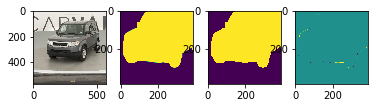

874it [09:21,  1.47it/s]

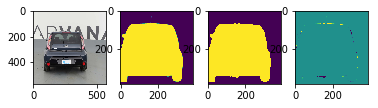

875it [09:22,  1.54it/s]

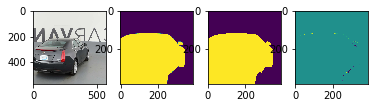

876it [09:22,  1.59it/s]

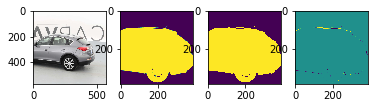

877it [09:23,  1.62it/s]

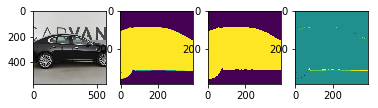

878it [09:24,  1.64it/s]

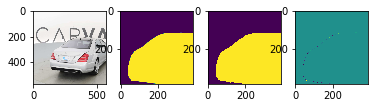

879it [09:24,  1.60it/s]

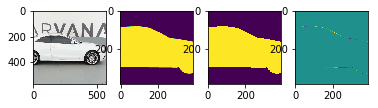

880it [09:25,  1.61it/s]

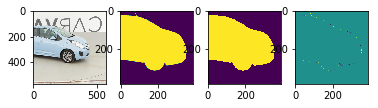

881it [09:25,  1.59it/s]

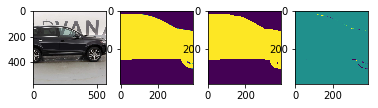

882it [09:26,  1.46it/s]

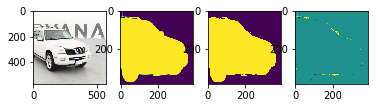

883it [09:27,  1.53it/s]

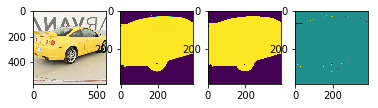

884it [09:27,  1.58it/s]

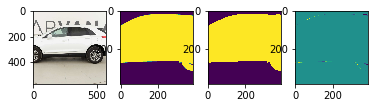

885it [09:28,  1.62it/s]

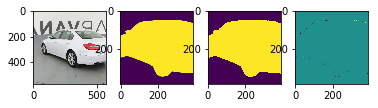

886it [09:29,  1.65it/s]

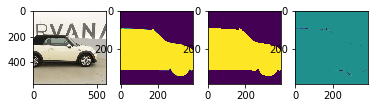

887it [09:29,  1.67it/s]

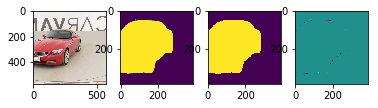

888it [09:30,  1.70it/s]

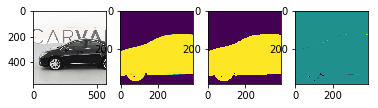

889it [09:31,  1.48it/s]

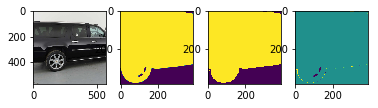

890it [09:31,  1.51it/s]

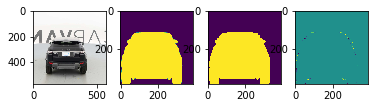

891it [09:32,  1.57it/s]

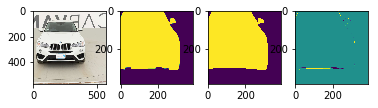

892it [09:32,  1.58it/s]

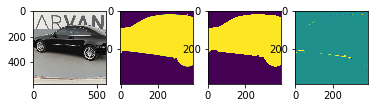

893it [09:33,  1.58it/s]

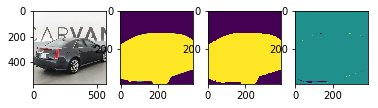

894it [09:34,  1.63it/s]

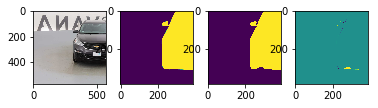

895it [09:34,  1.66it/s]

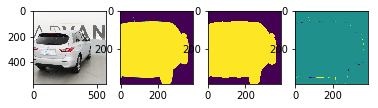

896it [09:35,  1.66it/s]

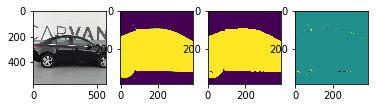

897it [09:36,  1.50it/s]

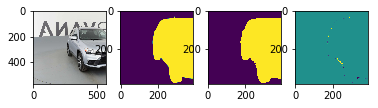

898it [09:36,  1.57it/s]

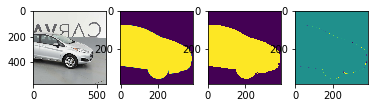

899it [09:37,  1.61it/s]

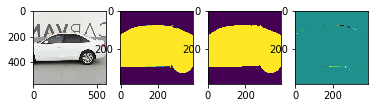

900it [09:37,  1.60it/s]

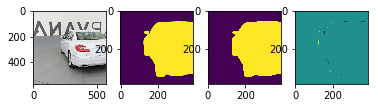

901it [09:38,  1.58it/s]

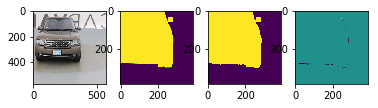

902it [09:39,  1.59it/s]

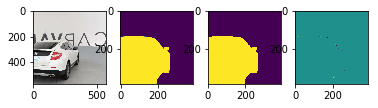

903it [09:39,  1.62it/s]

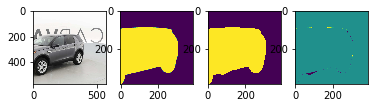

904it [09:40,  1.62it/s]

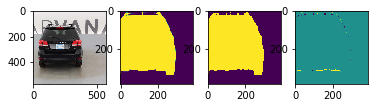

905it [09:41,  1.49it/s]

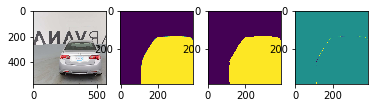

906it [09:41,  1.55it/s]

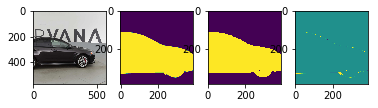

907it [09:42,  1.60it/s]

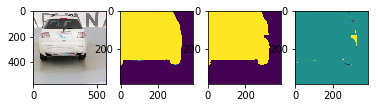

908it [09:42,  1.61it/s]

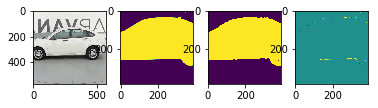

909it [09:43,  1.62it/s]

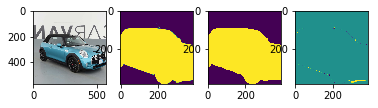

910it [09:44,  1.65it/s]

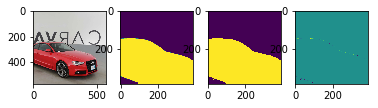

911it [09:44,  1.67it/s]

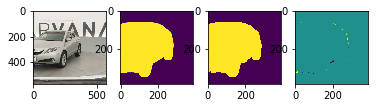

912it [09:45,  1.49it/s]

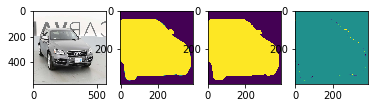

913it [09:46,  1.55it/s]

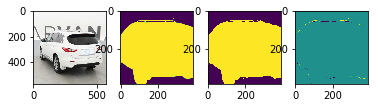

914it [09:46,  1.60it/s]

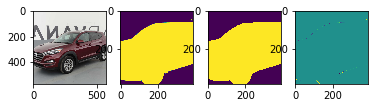

915it [09:47,  1.63it/s]

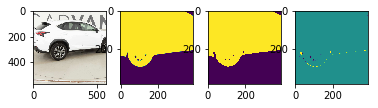

916it [09:47,  1.64it/s]

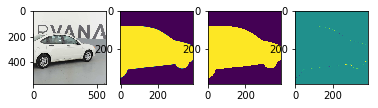

917it [09:48,  1.64it/s]

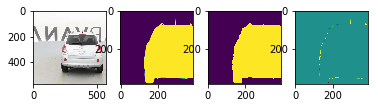

918it [09:49,  1.62it/s]

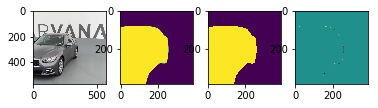

919it [09:49,  1.65it/s]

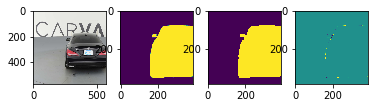

920it [09:50,  1.50it/s]

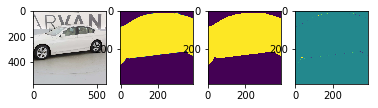

921it [09:51,  1.56it/s]

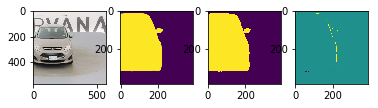

922it [09:51,  1.60it/s]

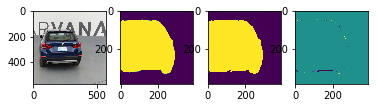

923it [09:52,  1.63it/s]

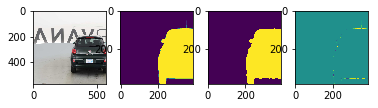

924it [09:52,  1.59it/s]

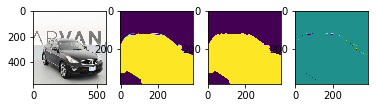

925it [09:53,  1.62it/s]

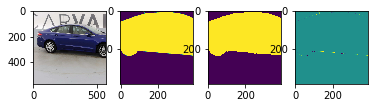

926it [09:54,  1.63it/s]

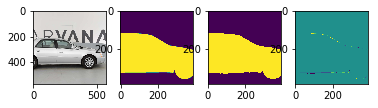

927it [09:54,  1.65it/s]

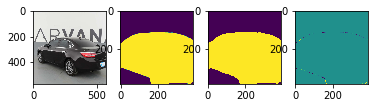

928it [09:55,  1.45it/s]

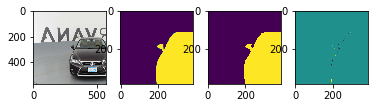

929it [09:56,  1.52it/s]

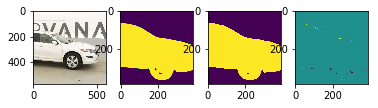

930it [09:56,  1.58it/s]

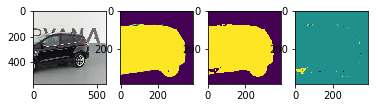

931it [09:57,  1.61it/s]

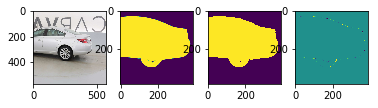

932it [09:57,  1.64it/s]

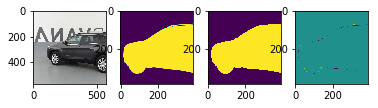

933it [09:58,  1.66it/s]

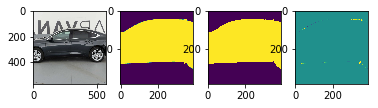

934it [09:59,  1.63it/s]

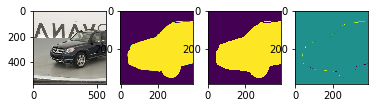

935it [10:00,  1.44it/s]

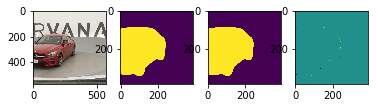

936it [10:00,  1.51it/s]

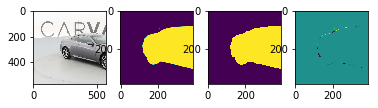

937it [10:01,  1.54it/s]

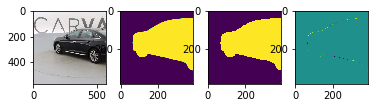

938it [10:01,  1.56it/s]

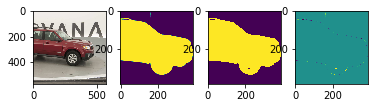

939it [10:02,  1.58it/s]

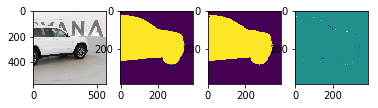

940it [10:03,  1.59it/s]

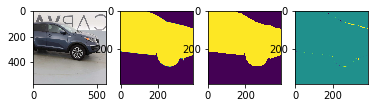

941it [10:03,  1.64it/s]

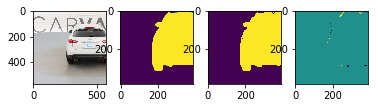

942it [10:04,  1.66it/s]

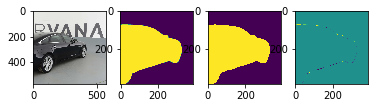

943it [10:05,  1.48it/s]

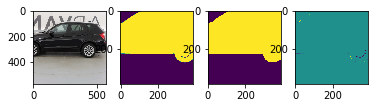

944it [10:05,  1.53it/s]

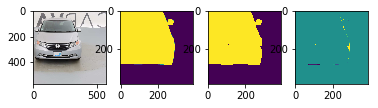

945it [10:06,  1.57it/s]

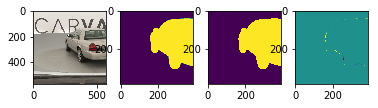

946it [10:06,  1.59it/s]

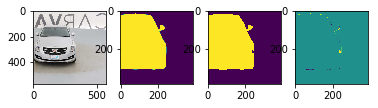

947it [10:07,  1.58it/s]

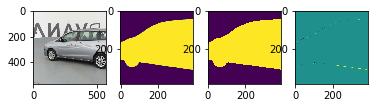

948it [10:08,  1.56it/s]

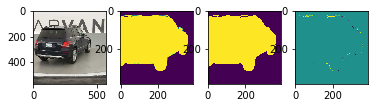

949it [10:08,  1.61it/s]

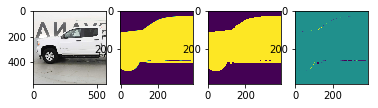

950it [10:09,  1.58it/s]

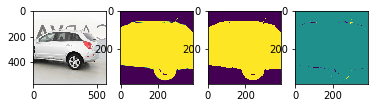

951it [10:10,  1.46it/s]

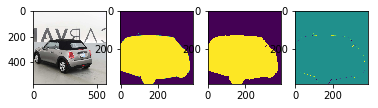

952it [10:10,  1.51it/s]

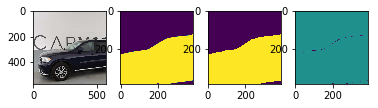

953it [10:11,  1.54it/s]

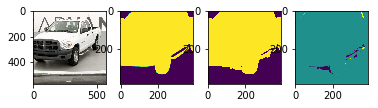

954it [10:12,  1.54it/s]

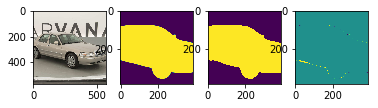

955it [10:12,  1.57it/s]

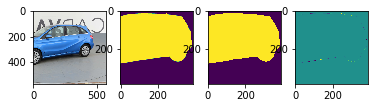

956it [10:13,  1.61it/s]

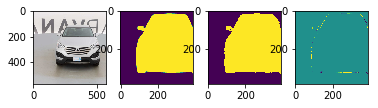

957it [10:13,  1.64it/s]

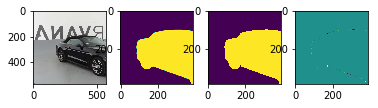

958it [10:14,  1.51it/s]

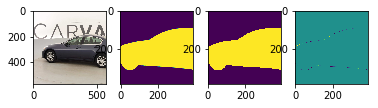

959it [10:15,  1.57it/s]

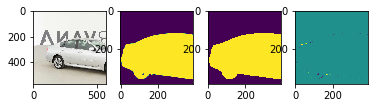

960it [10:15,  1.61it/s]

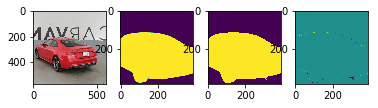

961it [10:16,  1.58it/s]

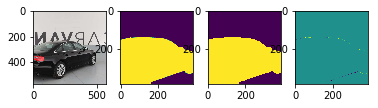

962it [10:17,  1.62it/s]

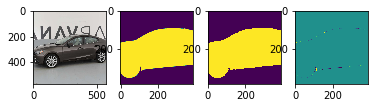

963it [10:17,  1.64it/s]

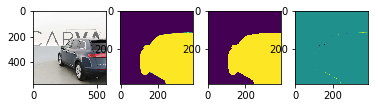

964it [10:18,  1.66it/s]

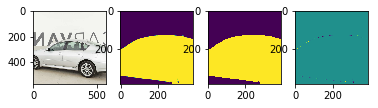

965it [10:18,  1.61it/s]

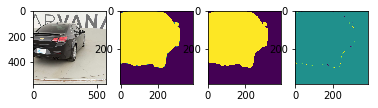

966it [10:19,  1.44it/s]

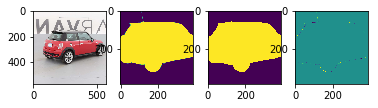

967it [10:20,  1.48it/s]

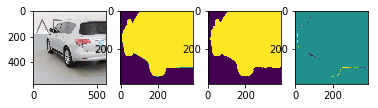

968it [10:21,  1.55it/s]

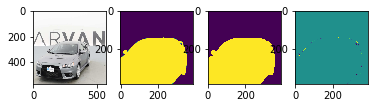

969it [10:21,  1.60it/s]

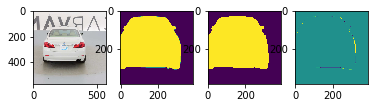

970it [10:22,  1.62it/s]

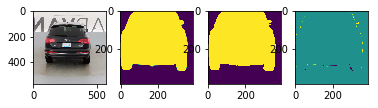

971it [10:22,  1.58it/s]

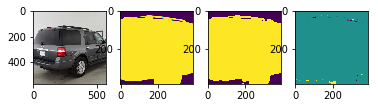

972it [10:23,  1.62it/s]

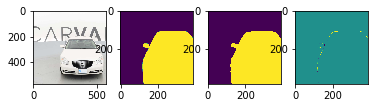

973it [10:24,  1.44it/s]

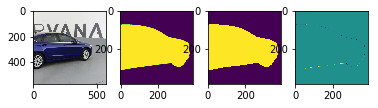

974it [10:24,  1.49it/s]

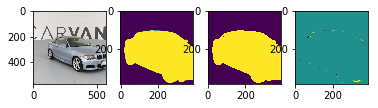

975it [10:25,  1.54it/s]

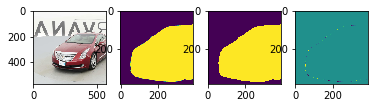

976it [10:26,  1.56it/s]

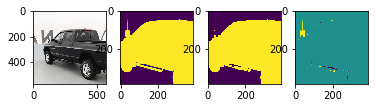

977it [10:26,  1.54it/s]

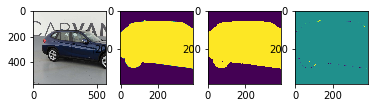

978it [10:27,  1.54it/s]

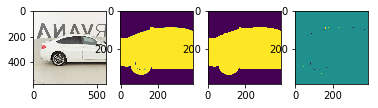

979it [10:28,  1.60it/s]

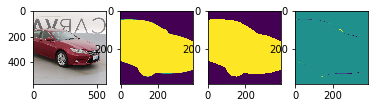

980it [10:28,  1.58it/s]

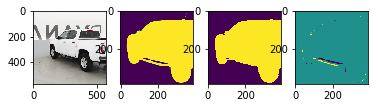

981it [10:29,  1.42it/s]

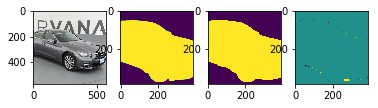

982it [10:30,  1.46it/s]

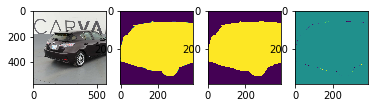

983it [10:30,  1.49it/s]

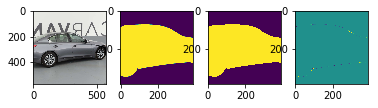

984it [10:31,  1.54it/s]

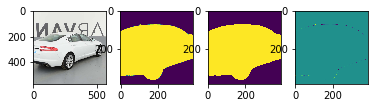

985it [10:32,  1.59it/s]

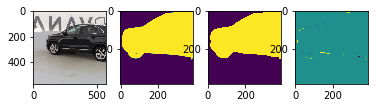

986it [10:32,  1.62it/s]

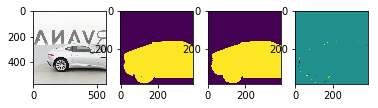

987it [10:33,  1.65it/s]

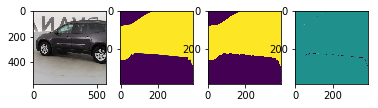

988it [10:33,  1.67it/s]

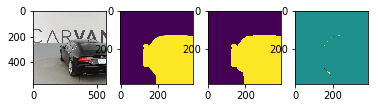

989it [10:34,  1.45it/s]

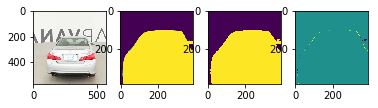

990it [10:35,  1.47it/s]

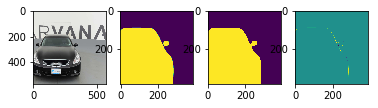

991it [10:36,  1.49it/s]

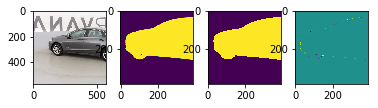

992it [10:36,  1.50it/s]

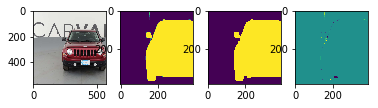

993it [10:37,  1.53it/s]

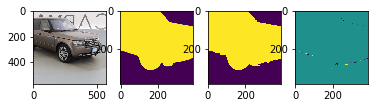

994it [10:37,  1.59it/s]

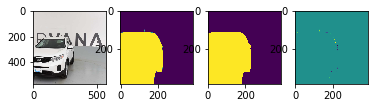

995it [10:38,  1.62it/s]

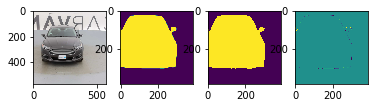

996it [10:39,  1.49it/s]

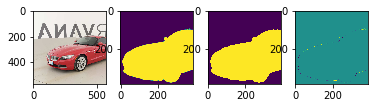

997it [10:39,  1.56it/s]

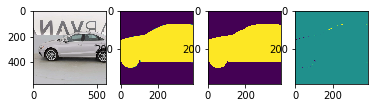

998it [10:40,  1.58it/s]

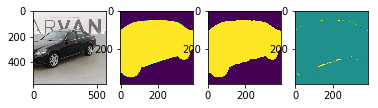

999it [10:41,  1.62it/s]

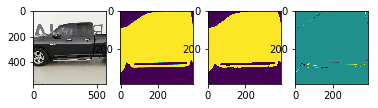

1000it [10:41,  1.65it/s]

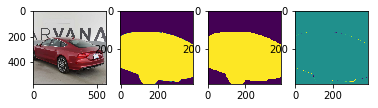

1001it [10:42,  1.66it/s]

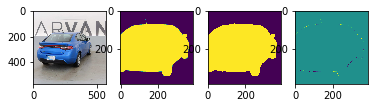

1002it [10:42,  1.67it/s]

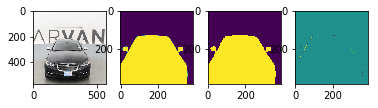

1003it [10:43,  1.63it/s]

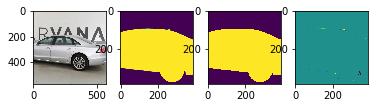

1004it [10:44,  1.47it/s]

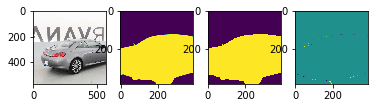

1005it [10:44,  1.54it/s]

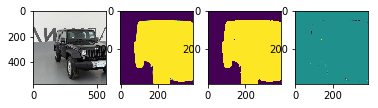

1006it [10:45,  1.55it/s]

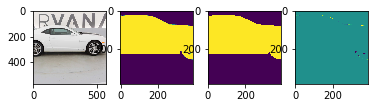

1007it [10:46,  1.57it/s]

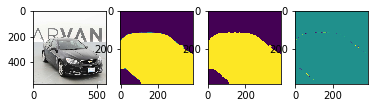

1008it [10:46,  1.61it/s]

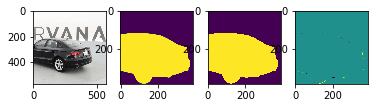

1009it [10:47,  1.64it/s]

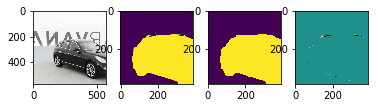

1010it [10:47,  1.67it/s]

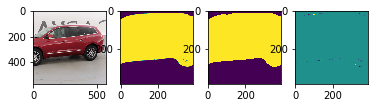

1011it [10:48,  1.50it/s]

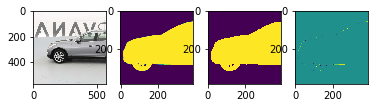

1012it [10:49,  1.53it/s]

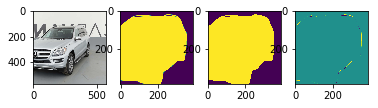

1013it [10:49,  1.59it/s]

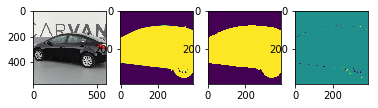

1014it [10:50,  1.63it/s]

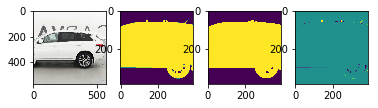

1015it [10:51,  1.65it/s]

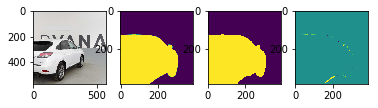

1016it [10:51,  1.67it/s]

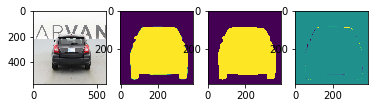

1017it [10:52,  1.69it/s]

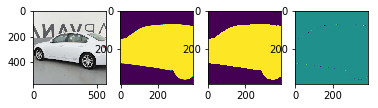

1018it [10:52,  1.69it/s]


In [133]:
mean_dice, mask_pred = val_dice_coef(model, val_images, val_masks, 
                                     96, image_size, input_dims, output_dims)


0it [00:00, ?it/s]

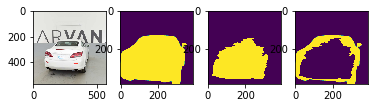


1it [00:00,  1.01it/s]


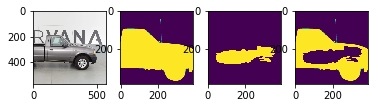

2it [00:01,  1.01it/s]

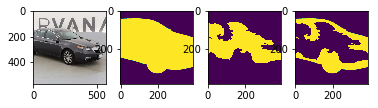

3it [00:02,  1.02it/s]

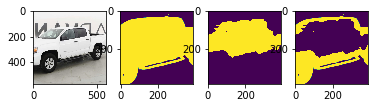

4it [00:03,  1.04it/s]

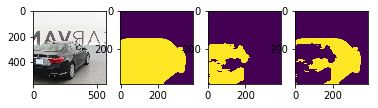

5it [00:04,  1.01s/it]

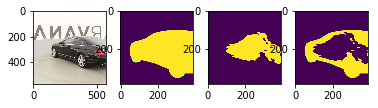

6it [00:05,  1.01it/s]

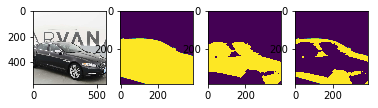

7it [00:06,  1.03it/s]

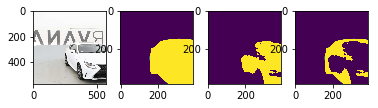

8it [00:07,  1.03it/s]

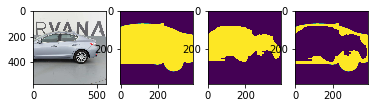

9it [00:08,  1.05it/s]

KeyboardInterrupt: 

In [152]:
# Calculate the dice coefficient on the validation set. The mask is smaller than the image.
def val_dice_coef(model, images, masks, 
                  pad_width, image_size, input_size, output_size):
    """
    Calculate dice coefficient on the generated validation data. This data is the
    same as the ones used in training. Hence no need to pad and can be predict 
    use model's original predict method.
    
    Will write the prediction to disk.
    
    # Args:
    image_size:      The size on which the image is cropped from
    input_size:      The input size of image, the cropped ones
    output_size:     The size of mask, smaller than input_size
    
    # Return:
    mean_dice
    mask_pred:       Lsit of predicted mask
    """
    dices = []
    masks_pred = []
    for image, mask in tqdm(zip(images, masks)):
        mask_pred = model.predict(image[None,:,:,:])
        mask_pred = mask_pred[0,:,:,0]
        mask_pred = remove_artifacts(mask_pred)
        dice = cal_dice_coef(mask, mask_pred)
        dices.append(dice)
        masks_pred.append([image, mask, mask_pred])
        # Show image, mask, prediction and difference
        show_4_images(image, mask[:,:,0], mask_pred[:,:], mask[:,:,0]-mask_pred[:,:])
    with open(tmp_dir + 'masks_pred.pickel', 'wb') as f:
        pickle.dump(masks_pred, f)
    dices = np.array(dices)
    return dices.mean(), mask_pred
mean_dice, mask_pred = val_dice_coef(model, val_images, val_masks, 
                                     96, image_size, input_dims, output_dims)

In [ ]:
# Conclusion
# Maybe CRF is needed.

In [135]:
mean_dice

0.99342203530461226

In [ ]:
# Dice coefficient 0.99404688814624165
# When training, the validation dice coefficient is ~0.996. 
# It is different from here because when training generator is used to produce validation data.
# It seems if the hole cannot be predicted properly. Try to put more weight on hole
# The outer egde is also not so correct.
# Some area are dark, which make it hard to predict
# Can try input dropout
# Boundry --> input dropout
# Hole --> weighted loss

  0%|          | 0/1018 [00:00<?, ?it/s]

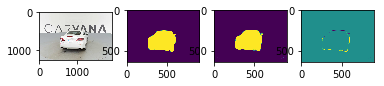

  0%|          | 1/1018 [00:03<1:00:47,  3.59s/it]

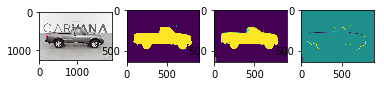

  0%|          | 2/1018 [00:07<1:01:11,  3.61s/it]

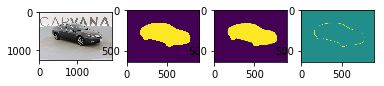

  0%|          | 3/1018 [00:10<1:00:27,  3.57s/it]

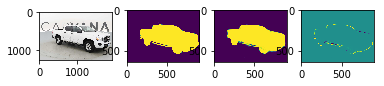

  0%|          | 4/1018 [00:14<1:00:16,  3.57s/it]

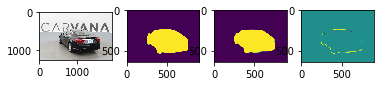

  0%|          | 5/1018 [00:17<1:00:05,  3.56s/it]

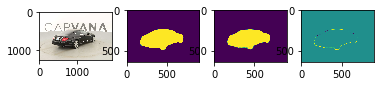

  1%|          | 6/1018 [00:21<59:34,  3.53s/it]  

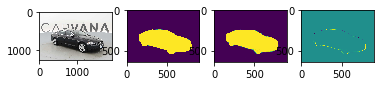

  1%|          | 7/1018 [00:24<59:30,  3.53s/it]

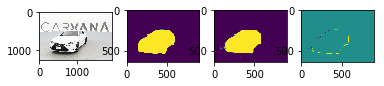

  1%|          | 8/1018 [00:28<59:26,  3.53s/it]

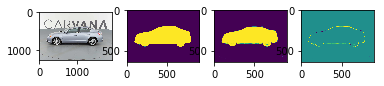

  1%|          | 9/1018 [00:31<59:04,  3.51s/it]

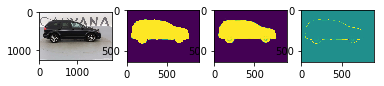

  1%|          | 10/1018 [00:35<59:53,  3.57s/it]

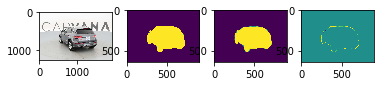

  1%|          | 11/1018 [00:39<59:53,  3.57s/it]

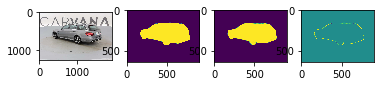

  1%|          | 12/1018 [00:42<59:14,  3.53s/it]

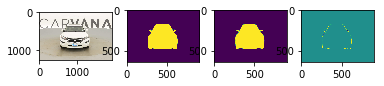

  1%|▏         | 13/1018 [00:46<59:20,  3.54s/it]

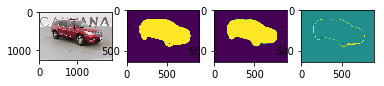

  1%|▏         | 14/1018 [00:49<58:56,  3.52s/it]

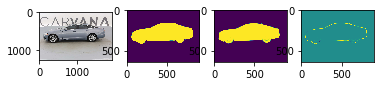

  1%|▏         | 15/1018 [00:53<58:54,  3.52s/it]

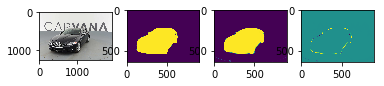

  2%|▏         | 16/1018 [00:56<58:54,  3.53s/it]

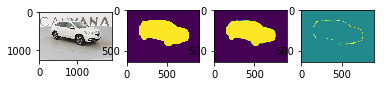

  2%|▏         | 17/1018 [01:00<58:55,  3.53s/it]

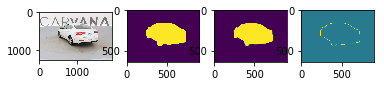

  2%|▏         | 18/1018 [01:03<59:52,  3.59s/it]

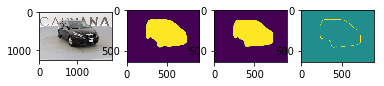

  2%|▏         | 19/1018 [01:07<59:18,  3.56s/it]

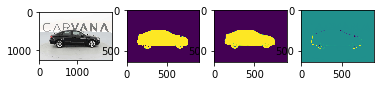

  2%|▏         | 20/1018 [01:10<59:14,  3.56s/it]

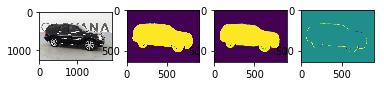

  2%|▏         | 21/1018 [01:14<59:18,  3.57s/it]

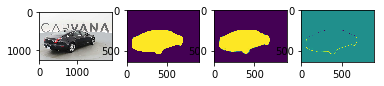

  2%|▏         | 22/1018 [01:18<59:16,  3.57s/it]

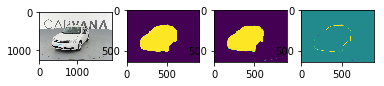

  2%|▏         | 23/1018 [01:21<59:13,  3.57s/it]

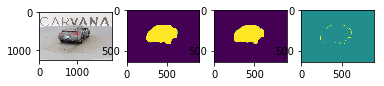

  2%|▏         | 24/1018 [01:25<59:02,  3.56s/it]

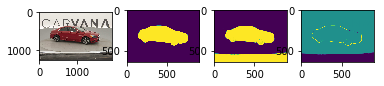

  2%|▏         | 25/1018 [01:29<1:00:13,  3.64s/it]

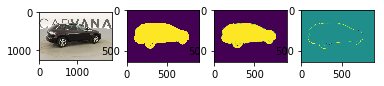

  3%|▎         | 26/1018 [01:32<59:32,  3.60s/it]  

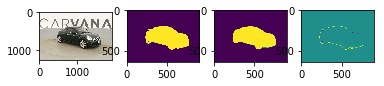

  3%|▎         | 27/1018 [01:36<59:19,  3.59s/it]

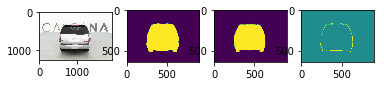

  3%|▎         | 28/1018 [01:39<59:22,  3.60s/it]

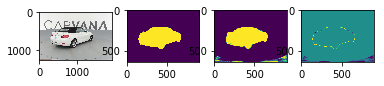

  3%|▎         | 29/1018 [01:43<58:52,  3.57s/it]

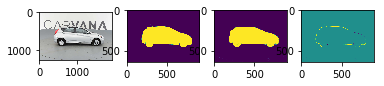

  3%|▎         | 30/1018 [01:46<58:26,  3.55s/it]

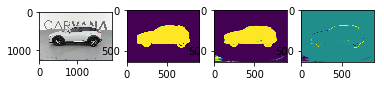

  3%|▎         | 31/1018 [01:50<58:21,  3.55s/it]

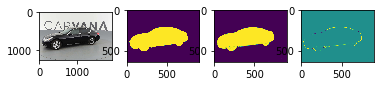

  3%|▎         | 32/1018 [01:53<58:10,  3.54s/it]

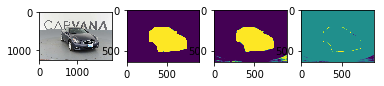

  3%|▎         | 33/1018 [01:57<59:26,  3.62s/it]

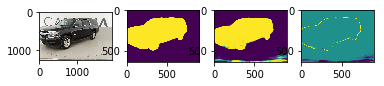

  3%|▎         | 34/1018 [02:01<59:00,  3.60s/it]

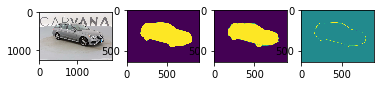

  3%|▎         | 35/1018 [02:04<58:26,  3.57s/it]

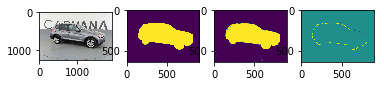

  4%|▎         | 36/1018 [02:08<58:12,  3.56s/it]

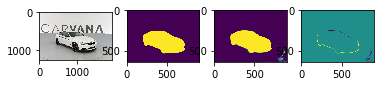

  4%|▎         | 37/1018 [02:11<58:26,  3.57s/it]

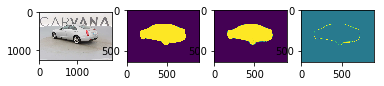

  4%|▎         | 38/1018 [02:15<57:54,  3.55s/it]

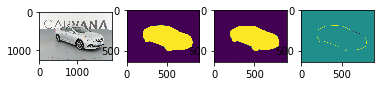

  4%|▍         | 39/1018 [02:18<57:37,  3.53s/it]

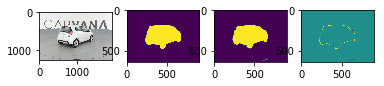

  4%|▍         | 40/1018 [02:22<57:21,  3.52s/it]

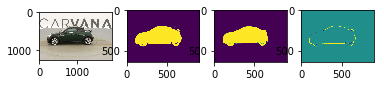

  4%|▍         | 41/1018 [02:26<58:33,  3.60s/it]

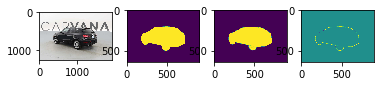

  4%|▍         | 42/1018 [02:29<57:58,  3.56s/it]

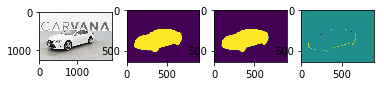

  4%|▍         | 43/1018 [02:33<57:57,  3.57s/it]

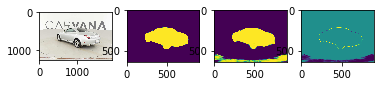

  4%|▍         | 44/1018 [02:36<57:44,  3.56s/it]

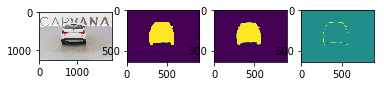

  4%|▍         | 45/1018 [02:40<57:51,  3.57s/it]

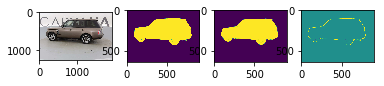

  5%|▍         | 46/1018 [02:43<57:34,  3.55s/it]

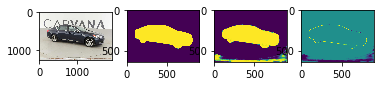

  5%|▍         | 47/1018 [02:47<57:22,  3.55s/it]

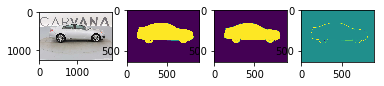

  5%|▍         | 48/1018 [02:51<58:21,  3.61s/it]

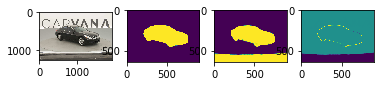

  5%|▍         | 49/1018 [02:54<58:01,  3.59s/it]

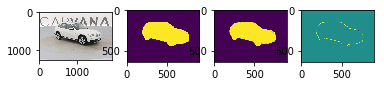

  5%|▍         | 50/1018 [02:58<57:30,  3.56s/it]

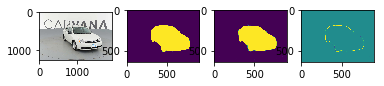

  5%|▌         | 51/1018 [03:01<57:36,  3.57s/it]

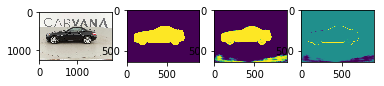

  5%|▌         | 52/1018 [03:05<57:22,  3.56s/it]

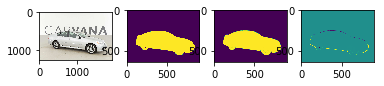

  5%|▌         | 53/1018 [03:08<57:21,  3.57s/it]

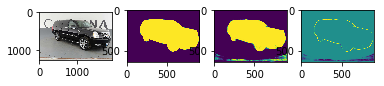

  5%|▌         | 54/1018 [03:12<57:25,  3.57s/it]

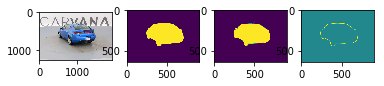

  5%|▌         | 55/1018 [03:16<57:35,  3.59s/it]

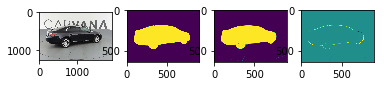

  6%|▌         | 56/1018 [03:19<58:25,  3.64s/it]

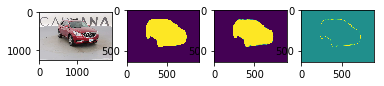

  6%|▌         | 57/1018 [03:23<58:05,  3.63s/it]

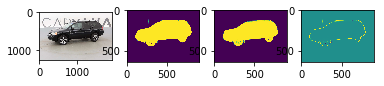

  6%|▌         | 58/1018 [03:26<57:41,  3.61s/it]

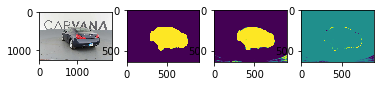

  6%|▌         | 59/1018 [03:30<57:39,  3.61s/it]

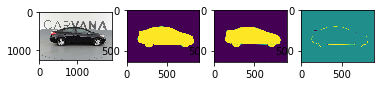

  6%|▌         | 60/1018 [03:34<57:15,  3.59s/it]

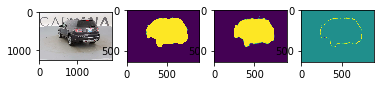

  6%|▌         | 61/1018 [03:37<56:53,  3.57s/it]

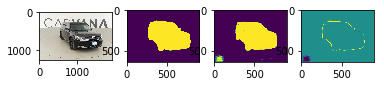

  6%|▌         | 62/1018 [03:41<56:32,  3.55s/it]

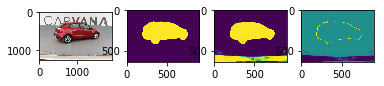

  6%|▌         | 63/1018 [03:44<56:11,  3.53s/it]

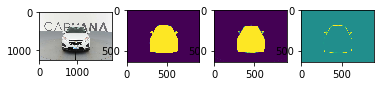

  6%|▋         | 64/1018 [03:48<56:56,  3.58s/it]

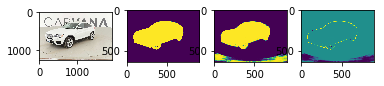

  6%|▋         | 65/1018 [03:51<56:56,  3.58s/it]

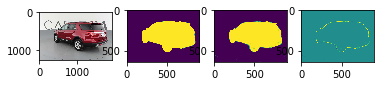

  6%|▋         | 66/1018 [03:55<56:53,  3.59s/it]

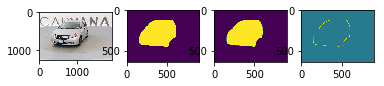

  7%|▋         | 67/1018 [03:59<56:44,  3.58s/it]

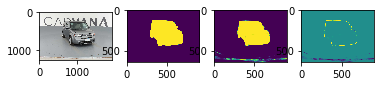

  7%|▋         | 68/1018 [04:02<56:32,  3.57s/it]

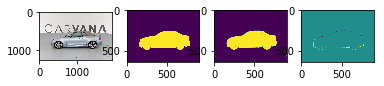

  7%|▋         | 69/1018 [04:06<56:33,  3.58s/it]

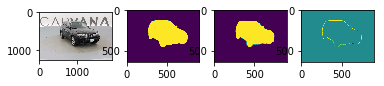

  7%|▋         | 70/1018 [04:09<56:15,  3.56s/it]

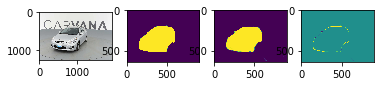

  7%|▋         | 71/1018 [04:13<57:10,  3.62s/it]

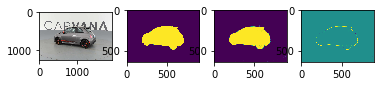

  7%|▋         | 72/1018 [04:17<56:59,  3.61s/it]

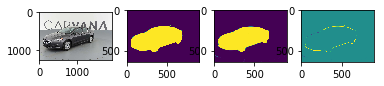

  7%|▋         | 73/1018 [04:20<56:33,  3.59s/it]

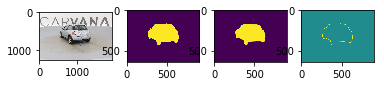

  7%|▋         | 74/1018 [04:24<56:12,  3.57s/it]

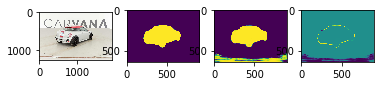

  7%|▋         | 75/1018 [04:27<55:54,  3.56s/it]

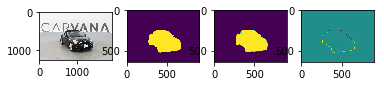

  7%|▋         | 76/1018 [04:31<55:28,  3.53s/it]

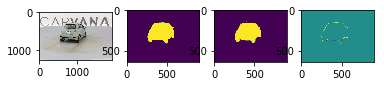

  8%|▊         | 77/1018 [04:34<55:22,  3.53s/it]

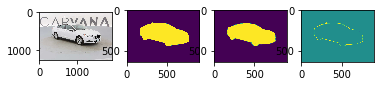

  8%|▊         | 78/1018 [04:38<55:06,  3.52s/it]

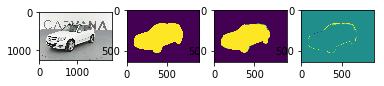

  8%|▊         | 79/1018 [04:41<56:21,  3.60s/it]

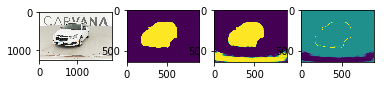

  8%|▊         | 80/1018 [04:45<56:06,  3.59s/it]

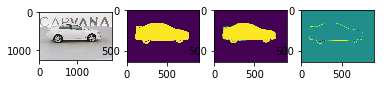

  8%|▊         | 81/1018 [04:49<55:51,  3.58s/it]

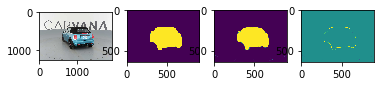

  8%|▊         | 82/1018 [04:52<55:54,  3.58s/it]

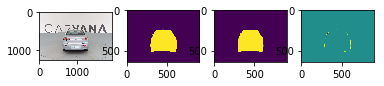

  8%|▊         | 83/1018 [04:56<55:38,  3.57s/it]

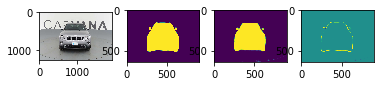

  8%|▊         | 84/1018 [04:59<55:20,  3.55s/it]

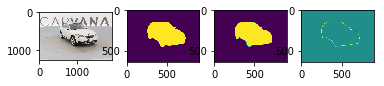

  8%|▊         | 85/1018 [05:03<55:23,  3.56s/it]

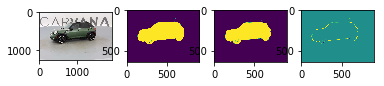

  8%|▊         | 86/1018 [05:06<55:21,  3.56s/it]

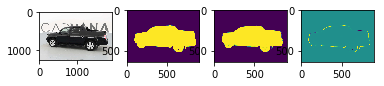

  9%|▊         | 87/1018 [05:10<56:12,  3.62s/it]

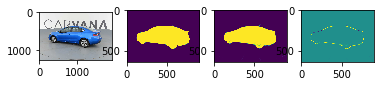

  9%|▊         | 88/1018 [05:14<55:51,  3.60s/it]

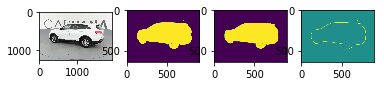

  9%|▊         | 89/1018 [05:17<55:45,  3.60s/it]

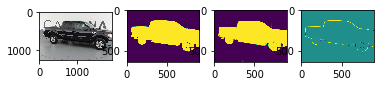

  9%|▉         | 90/1018 [05:21<55:44,  3.60s/it]

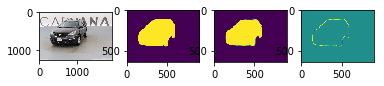

  9%|▉         | 91/1018 [05:24<55:31,  3.59s/it]

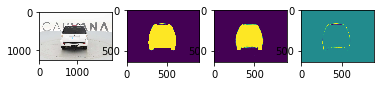

  9%|▉         | 92/1018 [05:28<55:08,  3.57s/it]

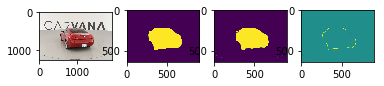

  9%|▉         | 93/1018 [05:32<55:11,  3.58s/it]

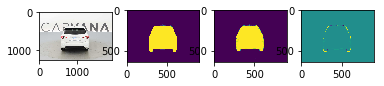

  9%|▉         | 94/1018 [05:35<56:00,  3.64s/it]

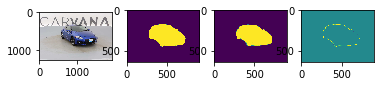

  9%|▉         | 95/1018 [05:39<55:15,  3.59s/it]

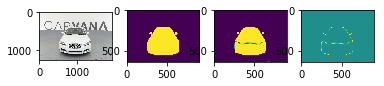

  9%|▉         | 96/1018 [05:42<54:47,  3.57s/it]

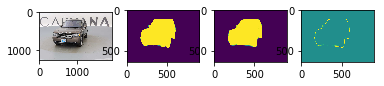

 10%|▉         | 97/1018 [05:46<54:44,  3.57s/it]

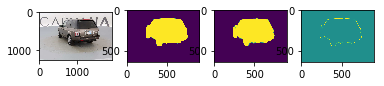

 10%|▉         | 98/1018 [05:50<54:47,  3.57s/it]

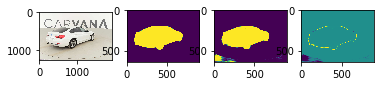

 10%|▉         | 99/1018 [05:53<54:27,  3.56s/it]

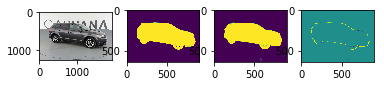

 10%|▉         | 100/1018 [05:57<54:17,  3.55s/it]

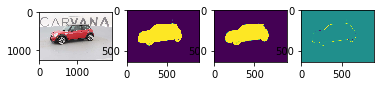

 10%|▉         | 101/1018 [06:00<54:20,  3.56s/it]

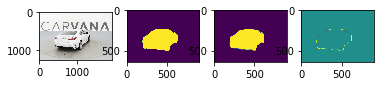

 10%|█         | 102/1018 [06:04<55:04,  3.61s/it]

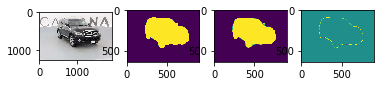

 10%|█         | 103/1018 [06:07<54:56,  3.60s/it]

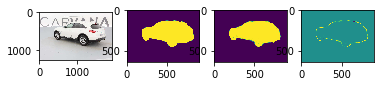

 10%|█         | 104/1018 [06:11<54:42,  3.59s/it]

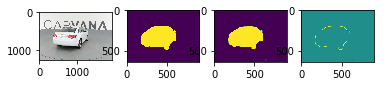

 10%|█         | 105/1018 [06:15<54:19,  3.57s/it]

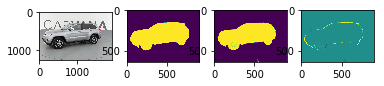

 10%|█         | 106/1018 [06:18<53:56,  3.55s/it]

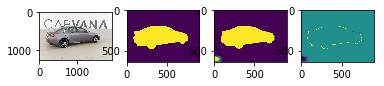

 11%|█         | 107/1018 [06:22<53:56,  3.55s/it]

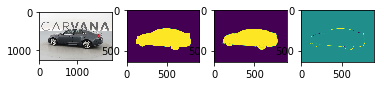

 11%|█         | 108/1018 [06:25<53:55,  3.56s/it]

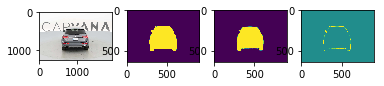

 11%|█         | 109/1018 [06:29<53:30,  3.53s/it]

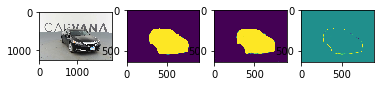

 11%|█         | 110/1018 [06:32<54:24,  3.59s/it]

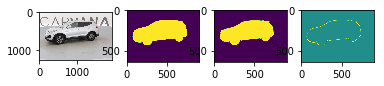

 11%|█         | 111/1018 [06:36<54:16,  3.59s/it]

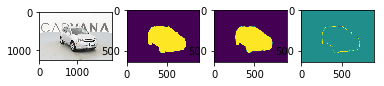

 11%|█         | 112/1018 [06:40<54:08,  3.59s/it]

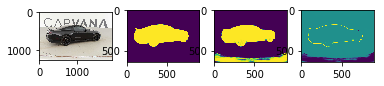

 11%|█         | 113/1018 [06:43<54:10,  3.59s/it]

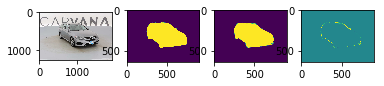

 11%|█         | 114/1018 [06:47<53:54,  3.58s/it]

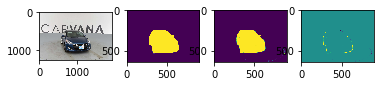

 11%|█▏        | 115/1018 [06:50<53:58,  3.59s/it]

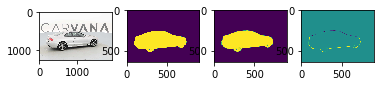

 11%|█▏        | 116/1018 [06:54<53:49,  3.58s/it]

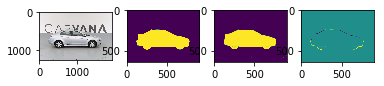

 11%|█▏        | 117/1018 [06:58<54:45,  3.65s/it]

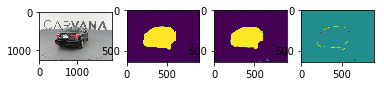

 12%|█▏        | 118/1018 [07:01<54:31,  3.64s/it]

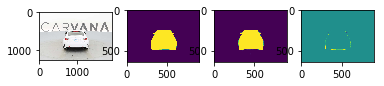

 12%|█▏        | 119/1018 [07:05<54:23,  3.63s/it]

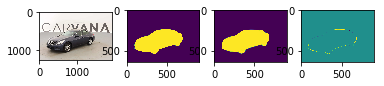

 12%|█▏        | 120/1018 [07:08<54:07,  3.62s/it]

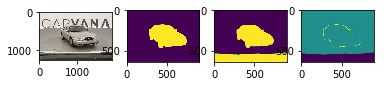

 12%|█▏        | 121/1018 [07:12<53:54,  3.61s/it]

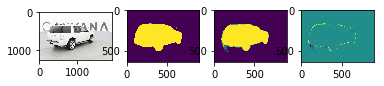

 12%|█▏        | 122/1018 [07:16<53:47,  3.60s/it]

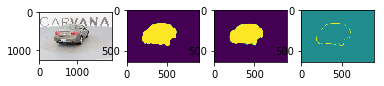

 12%|█▏        | 123/1018 [07:19<53:35,  3.59s/it]

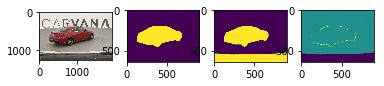

 12%|█▏        | 124/1018 [07:23<53:14,  3.57s/it]

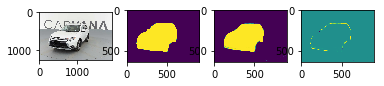

 12%|█▏        | 125/1018 [07:27<54:21,  3.65s/it]

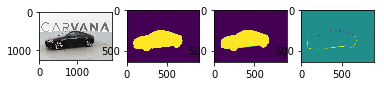

 12%|█▏        | 126/1018 [07:30<53:46,  3.62s/it]

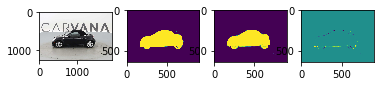

 12%|█▏        | 127/1018 [07:34<53:14,  3.59s/it]

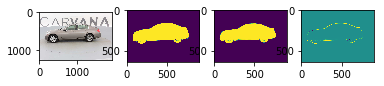

 13%|█▎        | 128/1018 [07:37<52:58,  3.57s/it]

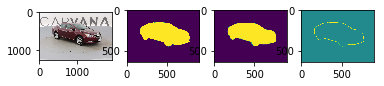

 13%|█▎        | 129/1018 [07:41<52:46,  3.56s/it]

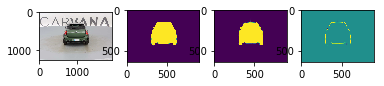

 13%|█▎        | 130/1018 [07:44<52:51,  3.57s/it]

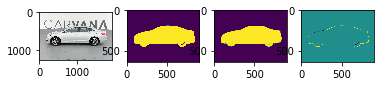

 13%|█▎        | 131/1018 [07:48<52:52,  3.58s/it]

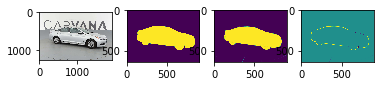

 13%|█▎        | 132/1018 [07:51<52:37,  3.56s/it]

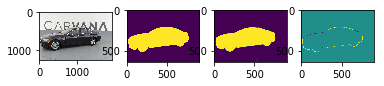

 13%|█▎        | 133/1018 [07:55<53:37,  3.64s/it]

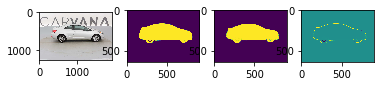

 13%|█▎        | 134/1018 [07:59<53:10,  3.61s/it]

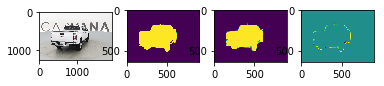

 13%|█▎        | 135/1018 [08:02<52:53,  3.59s/it]

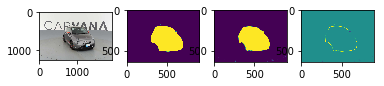

 13%|█▎        | 136/1018 [08:06<52:32,  3.57s/it]

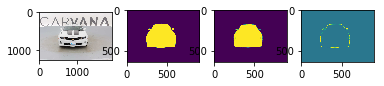

 13%|█▎        | 137/1018 [08:09<52:23,  3.57s/it]

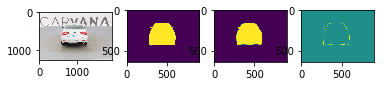

 14%|█▎        | 138/1018 [08:13<52:14,  3.56s/it]

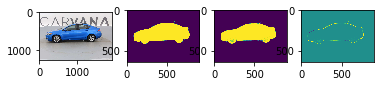

 14%|█▎        | 139/1018 [08:16<51:49,  3.54s/it]

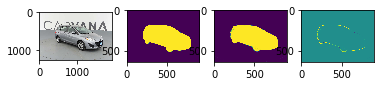

 14%|█▍        | 140/1018 [08:20<52:30,  3.59s/it]

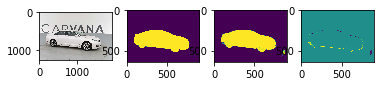

 14%|█▍        | 141/1018 [08:24<52:18,  3.58s/it]

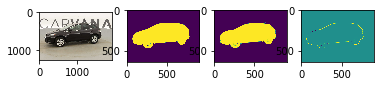

 14%|█▍        | 142/1018 [08:27<52:12,  3.58s/it]

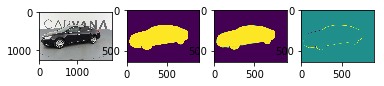

 14%|█▍        | 143/1018 [08:31<52:18,  3.59s/it]

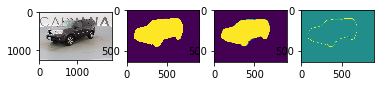

 14%|█▍        | 144/1018 [08:34<52:16,  3.59s/it]

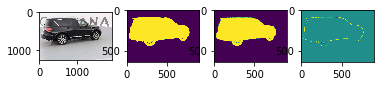

 14%|█▍        | 145/1018 [08:38<52:16,  3.59s/it]

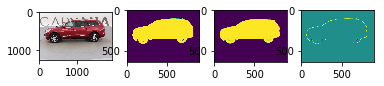

 14%|█▍        | 146/1018 [08:42<52:00,  3.58s/it]

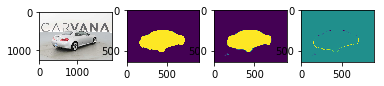

 14%|█▍        | 147/1018 [08:45<51:45,  3.57s/it]

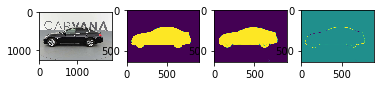

 15%|█▍        | 148/1018 [08:49<52:51,  3.65s/it]

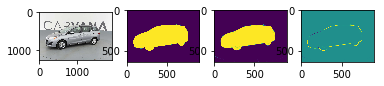

 15%|█▍        | 149/1018 [08:53<52:36,  3.63s/it]

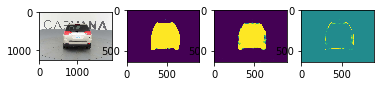

 15%|█▍        | 150/1018 [08:56<52:09,  3.61s/it]

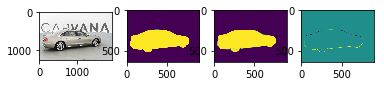

 15%|█▍        | 151/1018 [09:00<51:59,  3.60s/it]

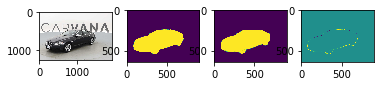

 15%|█▍        | 152/1018 [09:03<51:43,  3.58s/it]

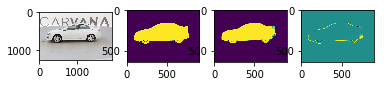

 15%|█▌        | 153/1018 [09:07<51:29,  3.57s/it]

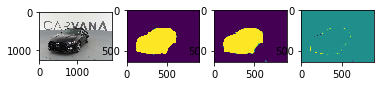

 15%|█▌        | 154/1018 [09:10<51:28,  3.57s/it]

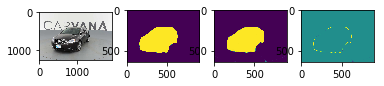

 15%|█▌        | 155/1018 [09:14<51:27,  3.58s/it]

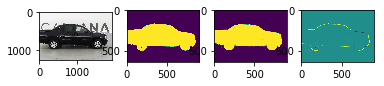

 15%|█▌        | 156/1018 [09:18<52:20,  3.64s/it]

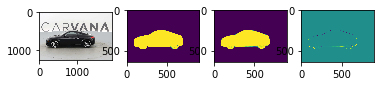

 15%|█▌        | 157/1018 [09:21<51:48,  3.61s/it]

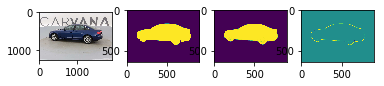

 16%|█▌        | 158/1018 [09:25<51:10,  3.57s/it]

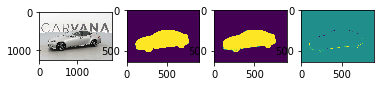

 16%|█▌        | 159/1018 [09:28<51:06,  3.57s/it]

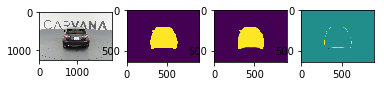

 16%|█▌        | 160/1018 [09:32<51:10,  3.58s/it]

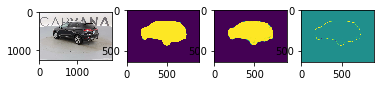

 16%|█▌        | 161/1018 [09:35<50:53,  3.56s/it]

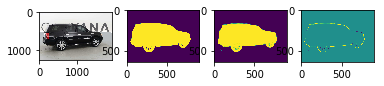

 16%|█▌        | 162/1018 [09:39<50:54,  3.57s/it]

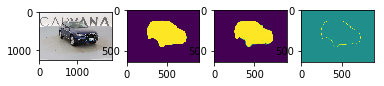

 16%|█▌        | 163/1018 [09:43<51:45,  3.63s/it]

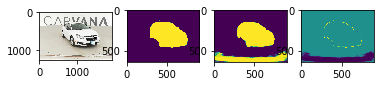

 16%|█▌        | 164/1018 [09:46<51:08,  3.59s/it]

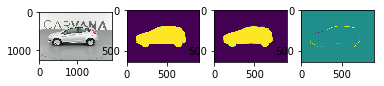

 16%|█▌        | 165/1018 [09:50<50:46,  3.57s/it]

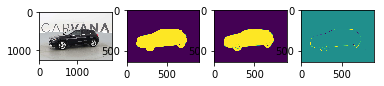

 16%|█▋        | 166/1018 [09:53<50:44,  3.57s/it]

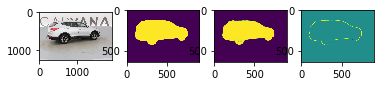

 16%|█▋        | 167/1018 [09:57<50:30,  3.56s/it]

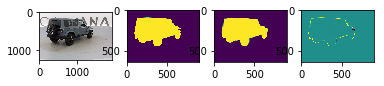

 17%|█▋        | 168/1018 [10:01<50:35,  3.57s/it]

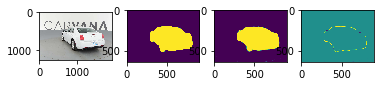

 17%|█▋        | 169/1018 [10:04<50:40,  3.58s/it]

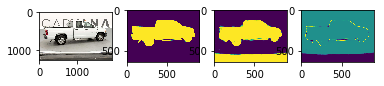

 17%|█▋        | 170/1018 [10:08<50:37,  3.58s/it]

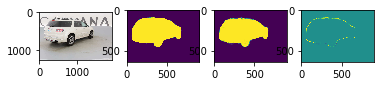

 17%|█▋        | 171/1018 [10:12<51:30,  3.65s/it]

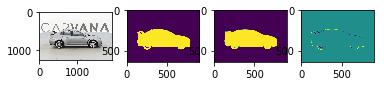

 17%|█▋        | 172/1018 [10:15<51:13,  3.63s/it]

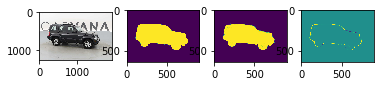

 17%|█▋        | 173/1018 [10:19<50:57,  3.62s/it]

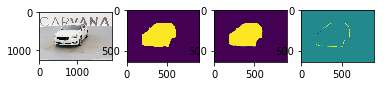

 17%|█▋        | 174/1018 [10:22<50:22,  3.58s/it]

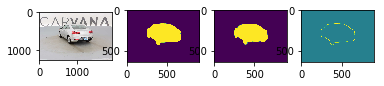

 17%|█▋        | 175/1018 [10:26<50:07,  3.57s/it]

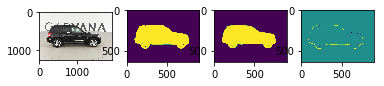

 17%|█▋        | 176/1018 [10:29<49:42,  3.54s/it]

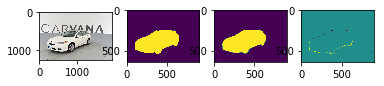

 17%|█▋        | 177/1018 [10:33<49:32,  3.53s/it]

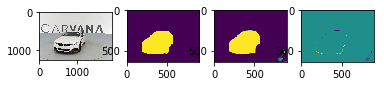

 17%|█▋        | 178/1018 [10:36<49:25,  3.53s/it]

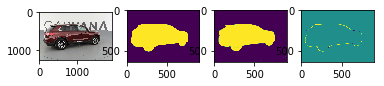

 18%|█▊        | 179/1018 [10:40<50:18,  3.60s/it]

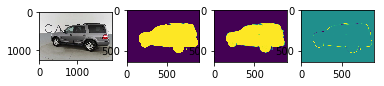

 18%|█▊        | 180/1018 [10:44<50:07,  3.59s/it]

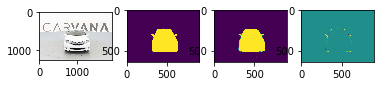

 18%|█▊        | 181/1018 [10:47<49:59,  3.58s/it]

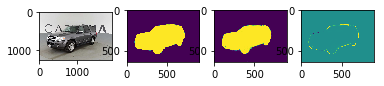

 18%|█▊        | 182/1018 [10:51<50:01,  3.59s/it]

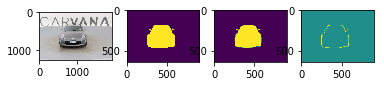

 18%|█▊        | 183/1018 [10:54<49:54,  3.59s/it]

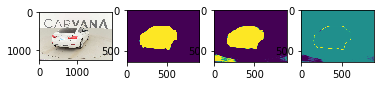

 18%|█▊        | 184/1018 [10:58<49:54,  3.59s/it]

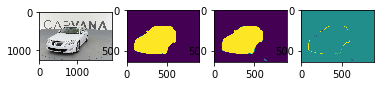

 18%|█▊        | 185/1018 [11:02<49:36,  3.57s/it]

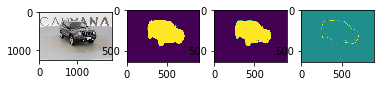

 18%|█▊        | 186/1018 [11:05<50:01,  3.61s/it]

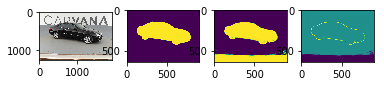

 18%|█▊        | 187/1018 [11:09<49:40,  3.59s/it]

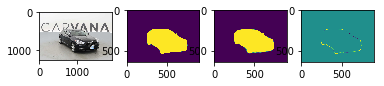

 18%|█▊        | 188/1018 [11:12<49:41,  3.59s/it]

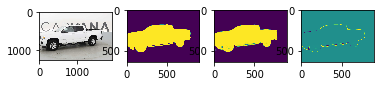

 19%|█▊        | 189/1018 [11:16<49:35,  3.59s/it]

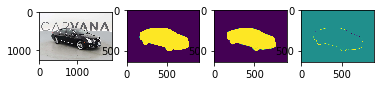

 19%|█▊        | 190/1018 [11:19<49:14,  3.57s/it]

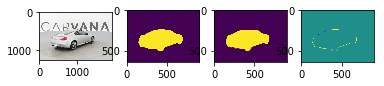

 19%|█▉        | 191/1018 [11:23<48:47,  3.54s/it]

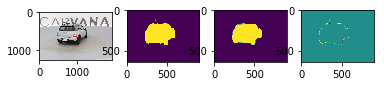

 19%|█▉        | 192/1018 [11:26<48:42,  3.54s/it]

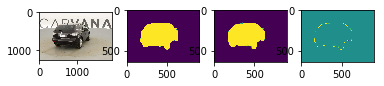

 19%|█▉        | 193/1018 [11:30<48:31,  3.53s/it]

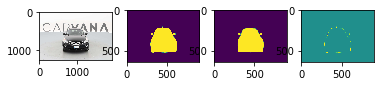

 19%|█▉        | 194/1018 [11:34<49:36,  3.61s/it]

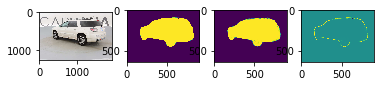

 19%|█▉        | 195/1018 [11:37<49:11,  3.59s/it]

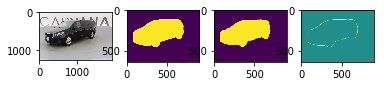

 19%|█▉        | 196/1018 [11:41<48:43,  3.56s/it]

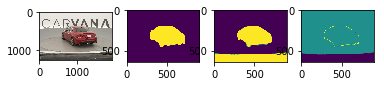

 19%|█▉        | 197/1018 [11:44<48:51,  3.57s/it]

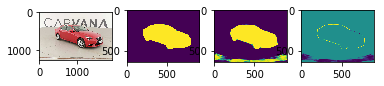

 19%|█▉        | 198/1018 [11:48<48:53,  3.58s/it]

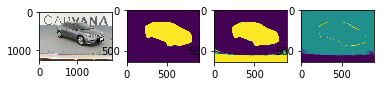

 20%|█▉        | 199/1018 [11:52<48:45,  3.57s/it]

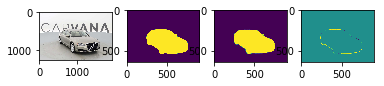

 20%|█▉        | 200/1018 [11:55<48:32,  3.56s/it]

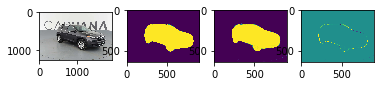

 20%|█▉        | 201/1018 [11:59<49:10,  3.61s/it]

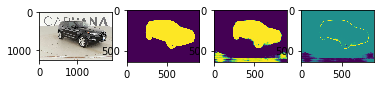

 20%|█▉        | 202/1018 [12:02<48:50,  3.59s/it]

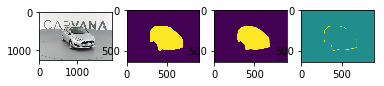

 20%|█▉        | 203/1018 [12:06<48:41,  3.58s/it]

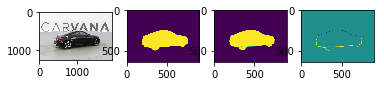

 20%|██        | 204/1018 [12:09<48:29,  3.57s/it]

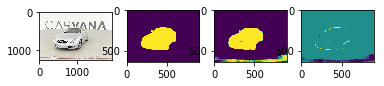

 20%|██        | 205/1018 [12:13<48:12,  3.56s/it]

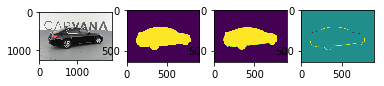

 20%|██        | 206/1018 [12:17<48:21,  3.57s/it]

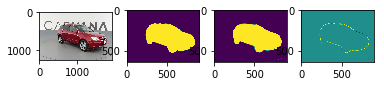

 20%|██        | 207/1018 [12:20<48:08,  3.56s/it]

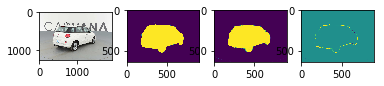

 20%|██        | 208/1018 [12:24<47:50,  3.54s/it]

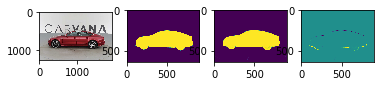

 21%|██        | 209/1018 [12:27<48:54,  3.63s/it]

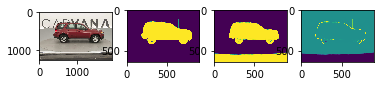

 21%|██        | 210/1018 [12:31<48:31,  3.60s/it]

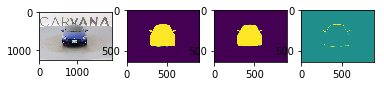

 21%|██        | 211/1018 [12:35<48:12,  3.58s/it]

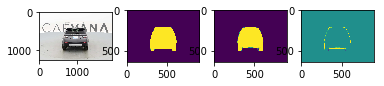

 21%|██        | 212/1018 [12:38<47:45,  3.56s/it]

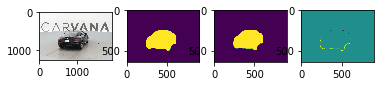

 21%|██        | 213/1018 [12:42<47:50,  3.57s/it]

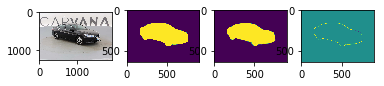

 21%|██        | 214/1018 [12:45<47:49,  3.57s/it]

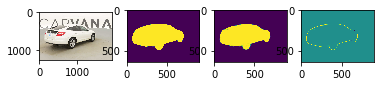

 21%|██        | 215/1018 [12:49<47:51,  3.58s/it]

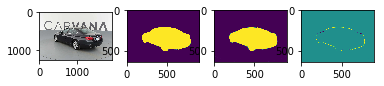

 21%|██        | 216/1018 [12:53<48:27,  3.63s/it]

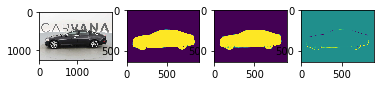

 21%|██▏       | 217/1018 [12:56<47:55,  3.59s/it]

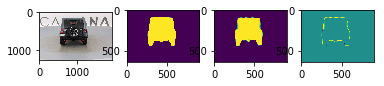

 21%|██▏       | 218/1018 [13:00<47:32,  3.57s/it]

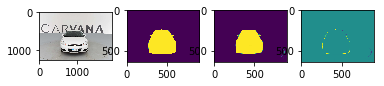

 22%|██▏       | 219/1018 [13:03<47:21,  3.56s/it]

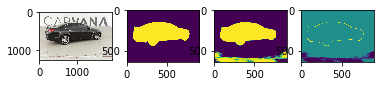

 22%|██▏       | 220/1018 [13:07<47:11,  3.55s/it]

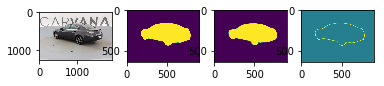

 22%|██▏       | 221/1018 [13:10<47:08,  3.55s/it]

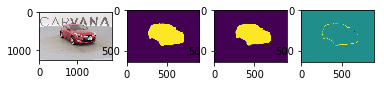

 22%|██▏       | 222/1018 [13:14<46:57,  3.54s/it]

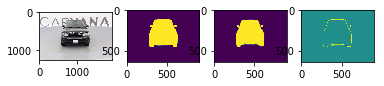

 22%|██▏       | 223/1018 [13:17<46:50,  3.54s/it]

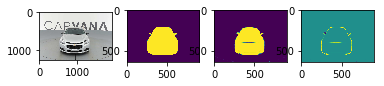

 22%|██▏       | 224/1018 [13:21<47:49,  3.61s/it]

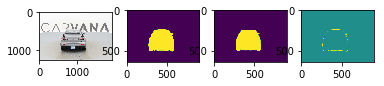

 22%|██▏       | 225/1018 [13:25<47:42,  3.61s/it]

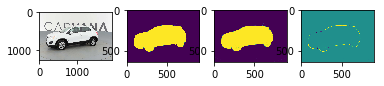

 22%|██▏       | 226/1018 [13:28<48:05,  3.64s/it]

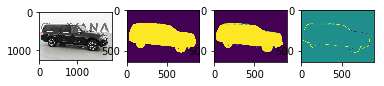

 22%|██▏       | 227/1018 [13:32<47:56,  3.64s/it]

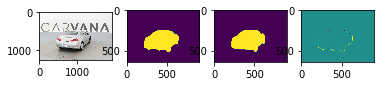

 22%|██▏       | 228/1018 [13:35<47:27,  3.60s/it]

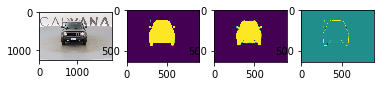

 22%|██▏       | 229/1018 [13:39<46:58,  3.57s/it]

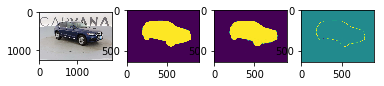

 23%|██▎       | 230/1018 [13:42<46:39,  3.55s/it]

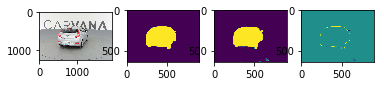

 23%|██▎       | 231/1018 [13:46<47:23,  3.61s/it]

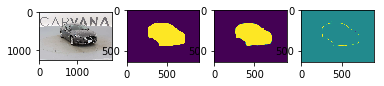

 23%|██▎       | 232/1018 [13:50<47:16,  3.61s/it]

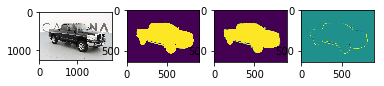

 23%|██▎       | 233/1018 [13:53<46:56,  3.59s/it]

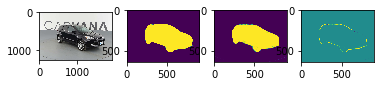

 23%|██▎       | 234/1018 [13:57<46:34,  3.56s/it]

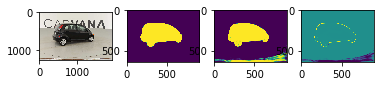

 23%|██▎       | 235/1018 [14:00<46:13,  3.54s/it]

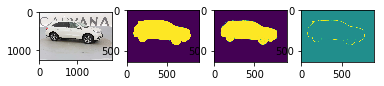

 23%|██▎       | 236/1018 [14:04<45:57,  3.53s/it]

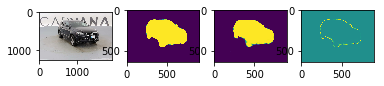

 23%|██▎       | 237/1018 [14:07<45:54,  3.53s/it]

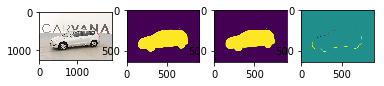

 23%|██▎       | 238/1018 [14:11<46:04,  3.54s/it]

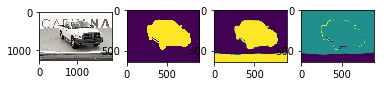

 23%|██▎       | 239/1018 [14:15<46:55,  3.61s/it]

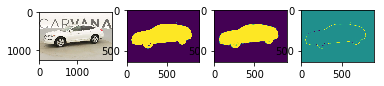

 24%|██▎       | 240/1018 [14:18<46:36,  3.59s/it]

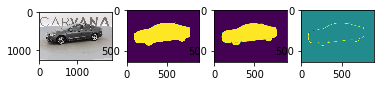

 24%|██▎       | 241/1018 [14:22<46:12,  3.57s/it]

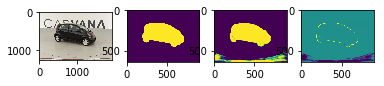

 24%|██▍       | 242/1018 [14:25<46:13,  3.57s/it]

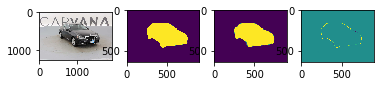

 24%|██▍       | 243/1018 [14:29<45:53,  3.55s/it]

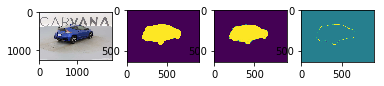

 24%|██▍       | 244/1018 [14:33<46:04,  3.57s/it]

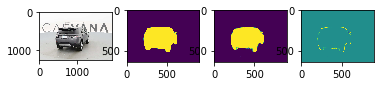

 24%|██▍       | 245/1018 [14:36<46:53,  3.64s/it]

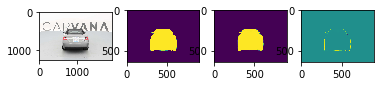

 24%|██▍       | 246/1018 [14:40<46:30,  3.61s/it]

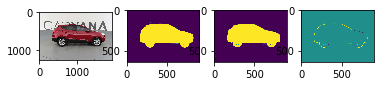

 24%|██▍       | 247/1018 [14:43<46:00,  3.58s/it]

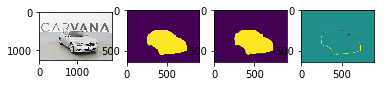

 24%|██▍       | 248/1018 [14:47<46:03,  3.59s/it]

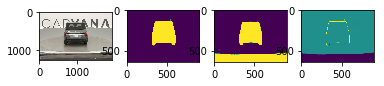

 24%|██▍       | 249/1018 [14:51<46:06,  3.60s/it]

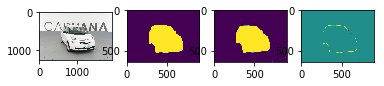

 25%|██▍       | 250/1018 [14:54<45:46,  3.58s/it]

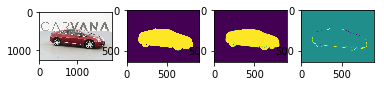

 25%|██▍       | 251/1018 [14:58<45:45,  3.58s/it]

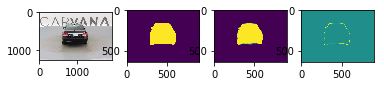

 25%|██▍       | 252/1018 [15:01<45:33,  3.57s/it]

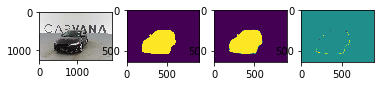

 25%|██▍       | 253/1018 [15:05<46:14,  3.63s/it]

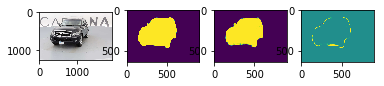

 25%|██▍       | 254/1018 [15:09<45:43,  3.59s/it]

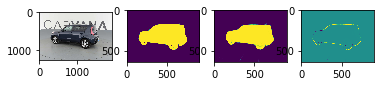

 25%|██▌       | 255/1018 [15:12<45:43,  3.60s/it]

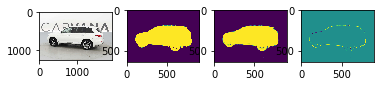

 25%|██▌       | 256/1018 [15:16<45:31,  3.58s/it]

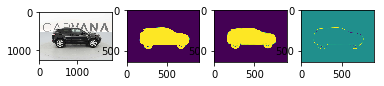

 25%|██▌       | 257/1018 [15:19<45:24,  3.58s/it]

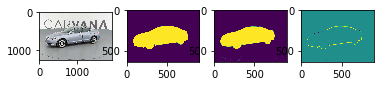

 25%|██▌       | 258/1018 [15:23<45:25,  3.59s/it]

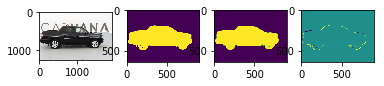

 25%|██▌       | 259/1018 [15:26<45:21,  3.59s/it]

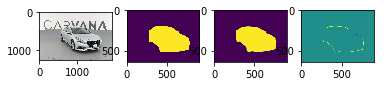

 26%|██▌       | 260/1018 [15:30<44:55,  3.56s/it]

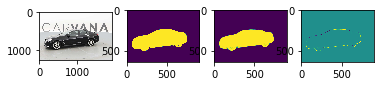

 26%|██▌       | 261/1018 [15:34<45:25,  3.60s/it]

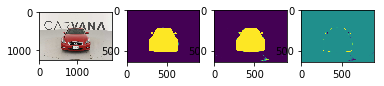

 26%|██▌       | 262/1018 [15:37<45:08,  3.58s/it]

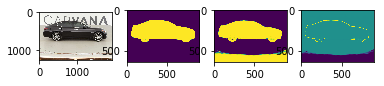

 26%|██▌       | 263/1018 [15:41<44:49,  3.56s/it]

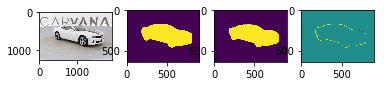

 26%|██▌       | 264/1018 [15:44<44:36,  3.55s/it]

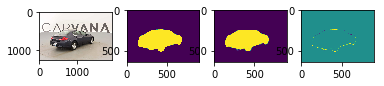

 26%|██▌       | 265/1018 [15:48<44:39,  3.56s/it]

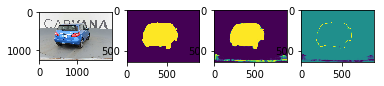

 26%|██▌       | 266/1018 [15:51<44:41,  3.57s/it]

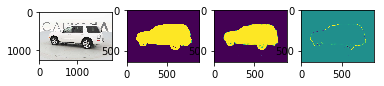

 26%|██▌       | 267/1018 [15:55<44:34,  3.56s/it]

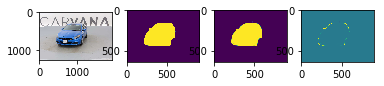

 26%|██▋       | 268/1018 [15:59<45:12,  3.62s/it]

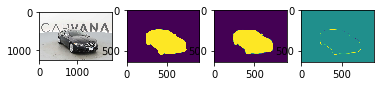

 26%|██▋       | 269/1018 [16:02<44:54,  3.60s/it]

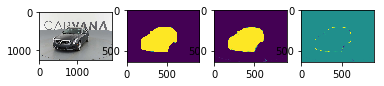

 27%|██▋       | 270/1018 [16:06<44:46,  3.59s/it]

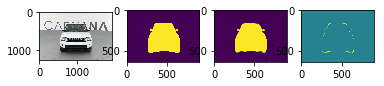

 27%|██▋       | 271/1018 [16:09<44:44,  3.59s/it]

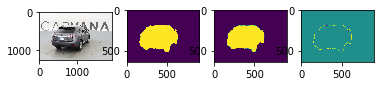

 27%|██▋       | 272/1018 [16:13<44:33,  3.58s/it]

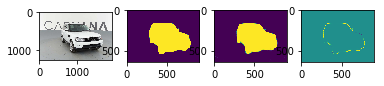

 27%|██▋       | 273/1018 [16:16<44:14,  3.56s/it]

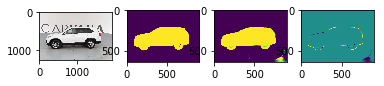

 27%|██▋       | 274/1018 [16:20<44:02,  3.55s/it]

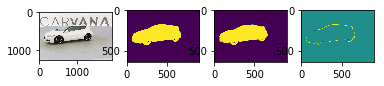

 27%|██▋       | 275/1018 [16:24<44:03,  3.56s/it]

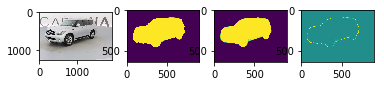

 27%|██▋       | 276/1018 [16:27<44:39,  3.61s/it]

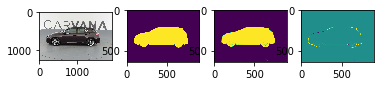

 27%|██▋       | 277/1018 [16:31<44:38,  3.61s/it]

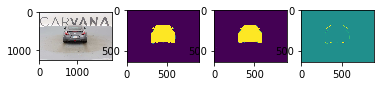

 27%|██▋       | 278/1018 [16:34<44:15,  3.59s/it]

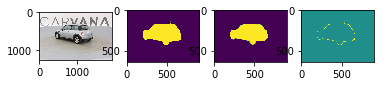

 27%|██▋       | 279/1018 [16:38<43:51,  3.56s/it]

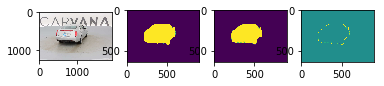

 28%|██▊       | 280/1018 [16:42<43:50,  3.56s/it]

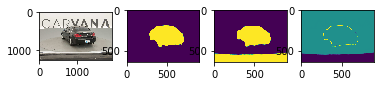

 28%|██▊       | 281/1018 [16:45<43:44,  3.56s/it]

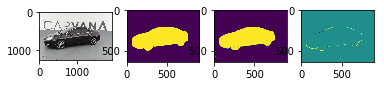

 28%|██▊       | 282/1018 [16:49<43:26,  3.54s/it]

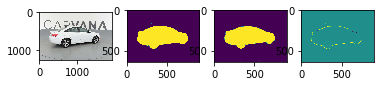

 28%|██▊       | 283/1018 [16:52<44:23,  3.62s/it]

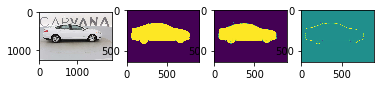

 28%|██▊       | 284/1018 [16:56<43:54,  3.59s/it]

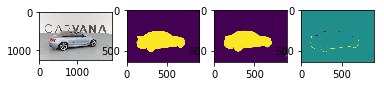

 28%|██▊       | 285/1018 [16:59<43:49,  3.59s/it]

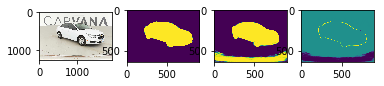

 28%|██▊       | 286/1018 [17:03<43:49,  3.59s/it]

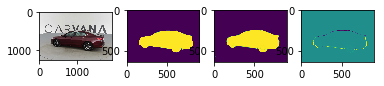

 28%|██▊       | 287/1018 [17:07<43:50,  3.60s/it]

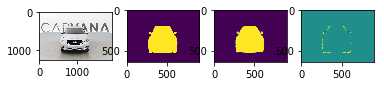

 28%|██▊       | 288/1018 [17:10<43:38,  3.59s/it]

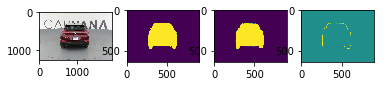

 28%|██▊       | 289/1018 [17:14<43:30,  3.58s/it]

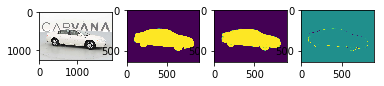

 28%|██▊       | 290/1018 [17:17<43:11,  3.56s/it]

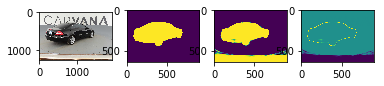

 29%|██▊       | 291/1018 [17:21<44:06,  3.64s/it]

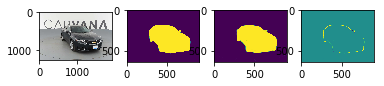

 29%|██▊       | 292/1018 [17:25<43:39,  3.61s/it]

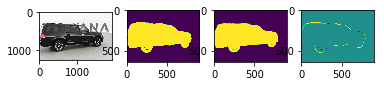

 29%|██▉       | 293/1018 [17:28<43:08,  3.57s/it]

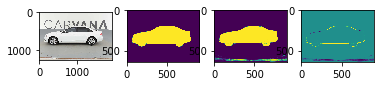

 29%|██▉       | 294/1018 [17:32<43:04,  3.57s/it]

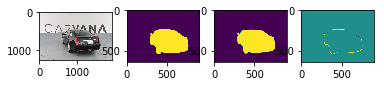

 29%|██▉       | 295/1018 [17:35<42:47,  3.55s/it]

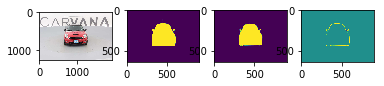

 29%|██▉       | 296/1018 [17:39<42:33,  3.54s/it]

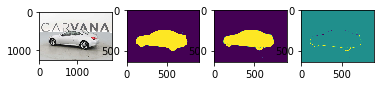

 29%|██▉       | 297/1018 [17:42<42:42,  3.55s/it]

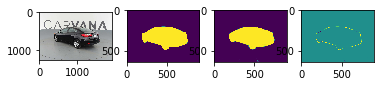

 29%|██▉       | 298/1018 [17:46<42:50,  3.57s/it]

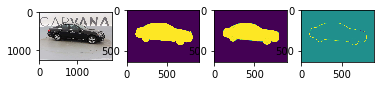

 29%|██▉       | 299/1018 [17:50<43:41,  3.65s/it]

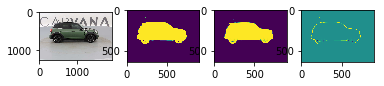

 29%|██▉       | 300/1018 [17:53<43:20,  3.62s/it]

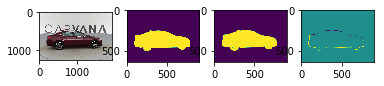

 30%|██▉       | 301/1018 [17:57<42:53,  3.59s/it]

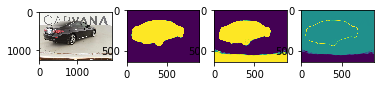

 30%|██▉       | 302/1018 [18:00<42:36,  3.57s/it]

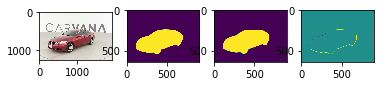

 30%|██▉       | 303/1018 [18:04<42:36,  3.58s/it]

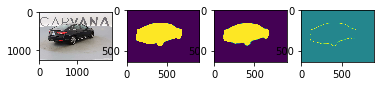

 30%|██▉       | 304/1018 [18:08<42:38,  3.58s/it]

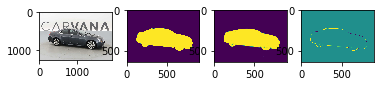

 30%|██▉       | 305/1018 [18:11<42:34,  3.58s/it]

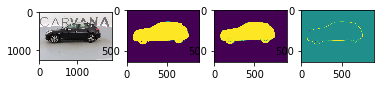

 30%|███       | 306/1018 [18:15<43:21,  3.65s/it]

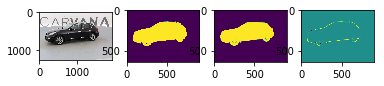

 30%|███       | 307/1018 [18:18<42:46,  3.61s/it]

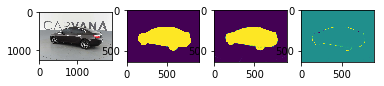

 30%|███       | 308/1018 [18:22<42:25,  3.58s/it]

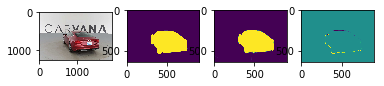

 30%|███       | 309/1018 [18:26<42:25,  3.59s/it]

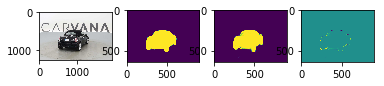

 30%|███       | 310/1018 [18:29<42:09,  3.57s/it]

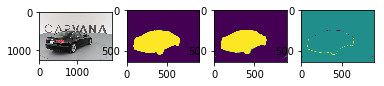

 31%|███       | 311/1018 [18:33<42:02,  3.57s/it]

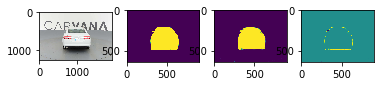

 31%|███       | 312/1018 [18:36<41:54,  3.56s/it]

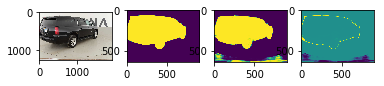

 31%|███       | 313/1018 [18:40<41:38,  3.54s/it]

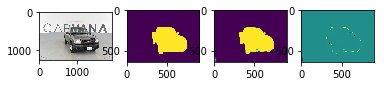

 31%|███       | 314/1018 [18:43<42:12,  3.60s/it]

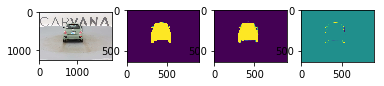

 31%|███       | 315/1018 [18:47<41:56,  3.58s/it]

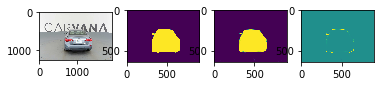

 31%|███       | 316/1018 [18:51<41:48,  3.57s/it]

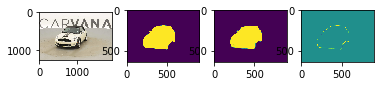

 31%|███       | 317/1018 [18:54<41:54,  3.59s/it]

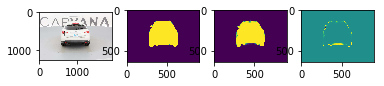

 31%|███       | 318/1018 [18:58<41:51,  3.59s/it]

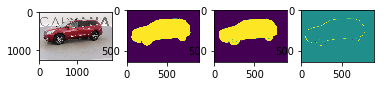

 31%|███▏      | 319/1018 [19:01<41:30,  3.56s/it]

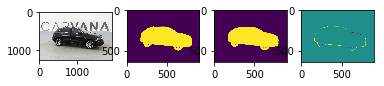

 31%|███▏      | 320/1018 [19:05<41:14,  3.54s/it]

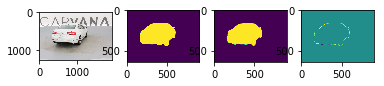

 32%|███▏      | 321/1018 [19:08<41:12,  3.55s/it]

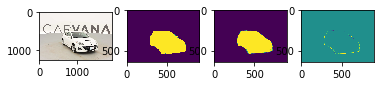

 32%|███▏      | 322/1018 [19:12<41:49,  3.61s/it]

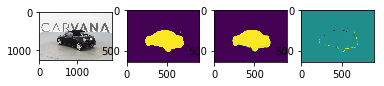

 32%|███▏      | 323/1018 [19:16<41:27,  3.58s/it]

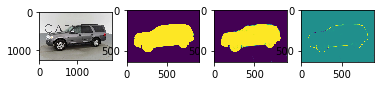

 32%|███▏      | 324/1018 [19:19<41:31,  3.59s/it]

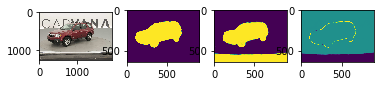

 32%|███▏      | 325/1018 [19:23<41:26,  3.59s/it]

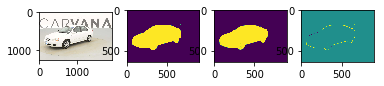

 32%|███▏      | 326/1018 [19:26<41:08,  3.57s/it]

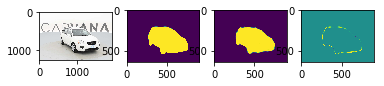

 32%|███▏      | 327/1018 [19:30<41:13,  3.58s/it]

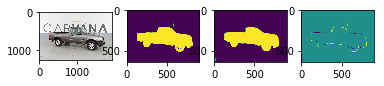

 32%|███▏      | 328/1018 [19:33<40:58,  3.56s/it]

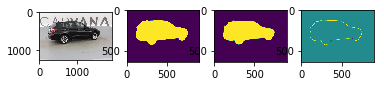

 32%|███▏      | 329/1018 [19:37<41:32,  3.62s/it]

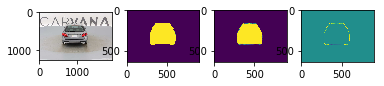

 32%|███▏      | 330/1018 [19:41<41:16,  3.60s/it]

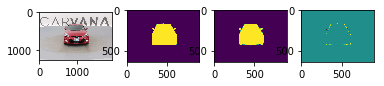

 33%|███▎      | 331/1018 [19:44<41:01,  3.58s/it]

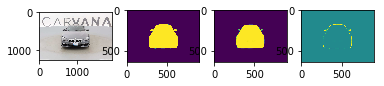

 33%|███▎      | 332/1018 [19:48<41:07,  3.60s/it]

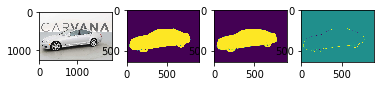

 33%|███▎      | 333/1018 [19:51<40:43,  3.57s/it]

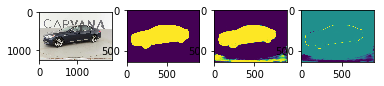

 33%|███▎      | 334/1018 [19:55<40:50,  3.58s/it]

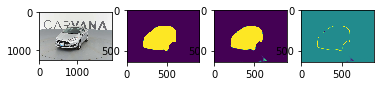

 33%|███▎      | 335/1018 [19:59<40:39,  3.57s/it]

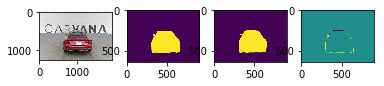

 33%|███▎      | 336/1018 [20:02<40:24,  3.56s/it]

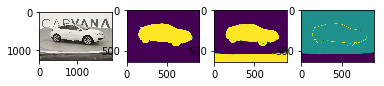

 33%|███▎      | 337/1018 [20:06<41:12,  3.63s/it]

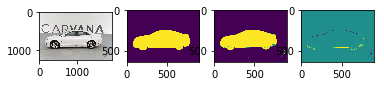

 33%|███▎      | 338/1018 [20:09<40:47,  3.60s/it]

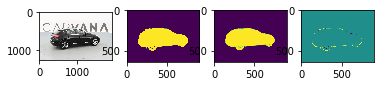

 33%|███▎      | 339/1018 [20:13<40:31,  3.58s/it]

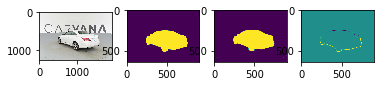

 33%|███▎      | 340/1018 [20:16<40:13,  3.56s/it]

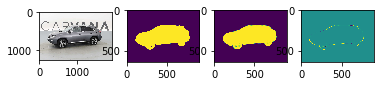

 33%|███▎      | 341/1018 [20:20<40:05,  3.55s/it]

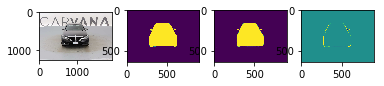

 34%|███▎      | 342/1018 [20:24<39:55,  3.54s/it]

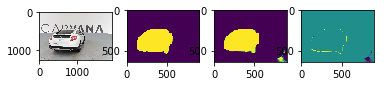

 34%|███▎      | 343/1018 [20:27<39:42,  3.53s/it]

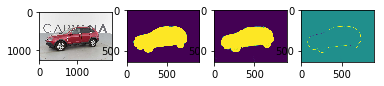

 34%|███▍      | 344/1018 [20:31<40:30,  3.61s/it]

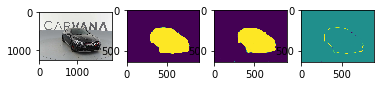

 34%|███▍      | 345/1018 [20:34<40:18,  3.59s/it]

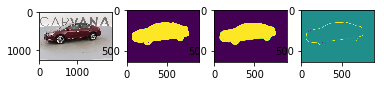

 34%|███▍      | 346/1018 [20:38<40:01,  3.57s/it]

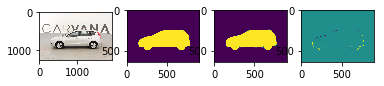

 34%|███▍      | 347/1018 [20:42<40:02,  3.58s/it]

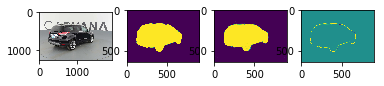

 34%|███▍      | 348/1018 [20:45<39:50,  3.57s/it]

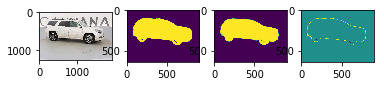

 34%|███▍      | 349/1018 [20:49<39:39,  3.56s/it]

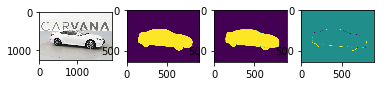

 34%|███▍      | 350/1018 [20:52<39:36,  3.56s/it]

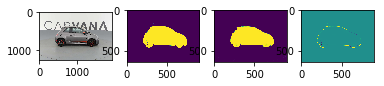

 34%|███▍      | 351/1018 [20:56<39:41,  3.57s/it]

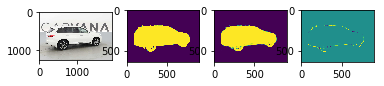

 35%|███▍      | 352/1018 [20:59<40:10,  3.62s/it]

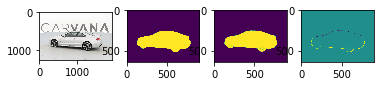

 35%|███▍      | 353/1018 [21:03<39:46,  3.59s/it]

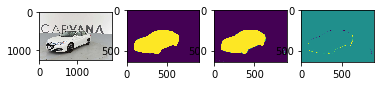

 35%|███▍      | 354/1018 [21:07<39:49,  3.60s/it]

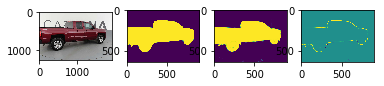

 35%|███▍      | 355/1018 [21:10<39:37,  3.59s/it]

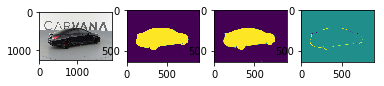

 35%|███▍      | 356/1018 [21:14<39:19,  3.56s/it]

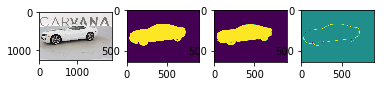

 35%|███▌      | 357/1018 [21:17<39:13,  3.56s/it]

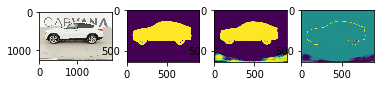

 35%|███▌      | 358/1018 [21:21<39:18,  3.57s/it]

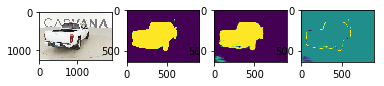

 35%|███▌      | 359/1018 [21:25<39:54,  3.63s/it]

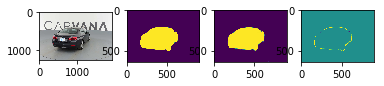

 35%|███▌      | 360/1018 [21:28<39:37,  3.61s/it]

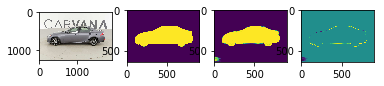

 35%|███▌      | 361/1018 [21:32<39:22,  3.60s/it]

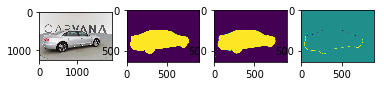

 36%|███▌      | 362/1018 [21:35<39:02,  3.57s/it]

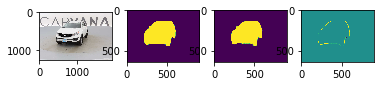

 36%|███▌      | 363/1018 [21:39<39:03,  3.58s/it]

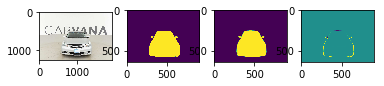

 36%|███▌      | 364/1018 [21:42<38:50,  3.56s/it]

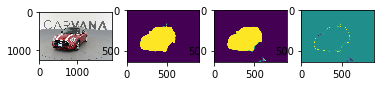

 36%|███▌      | 365/1018 [21:46<38:50,  3.57s/it]

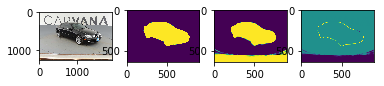

 36%|███▌      | 366/1018 [21:50<38:52,  3.58s/it]

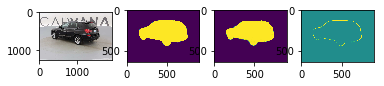

 36%|███▌      | 367/1018 [21:53<39:19,  3.62s/it]

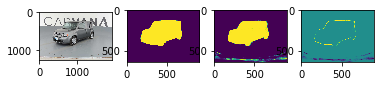

 36%|███▌      | 368/1018 [21:57<38:58,  3.60s/it]

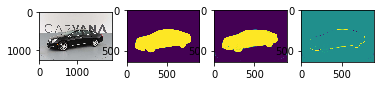

 36%|███▌      | 369/1018 [22:00<38:39,  3.57s/it]

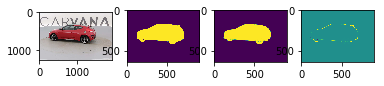

 36%|███▋      | 370/1018 [22:04<38:25,  3.56s/it]

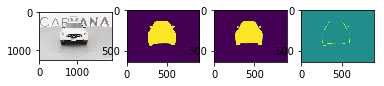

 36%|███▋      | 371/1018 [22:07<38:16,  3.55s/it]

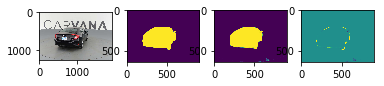

 37%|███▋      | 372/1018 [22:11<38:25,  3.57s/it]

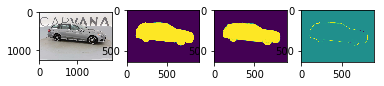

 37%|███▋      | 373/1018 [22:15<38:09,  3.55s/it]

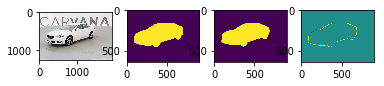

 37%|███▋      | 374/1018 [22:18<37:58,  3.54s/it]

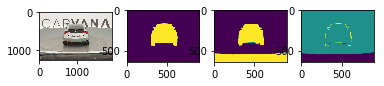

 37%|███▋      | 375/1018 [22:22<38:41,  3.61s/it]

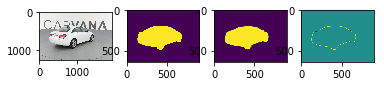

 37%|███▋      | 376/1018 [22:25<38:22,  3.59s/it]

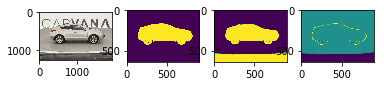

 37%|███▋      | 377/1018 [22:29<38:21,  3.59s/it]

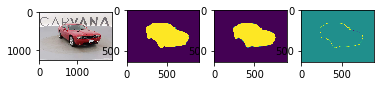

 37%|███▋      | 378/1018 [22:33<38:16,  3.59s/it]

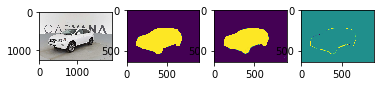

 37%|███▋      | 379/1018 [22:36<38:05,  3.58s/it]

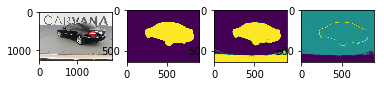

 37%|███▋      | 380/1018 [22:40<38:04,  3.58s/it]

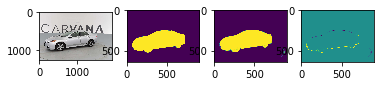

 37%|███▋      | 381/1018 [22:43<37:53,  3.57s/it]

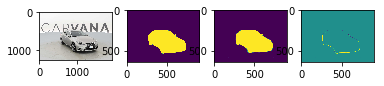

 38%|███▊      | 382/1018 [22:47<38:58,  3.68s/it]

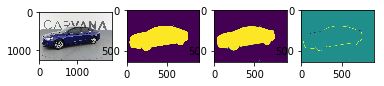

 38%|███▊      | 383/1018 [22:51<38:35,  3.65s/it]

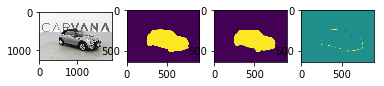

 38%|███▊      | 384/1018 [22:54<38:07,  3.61s/it]

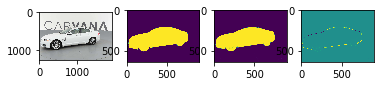

 38%|███▊      | 385/1018 [22:58<37:59,  3.60s/it]

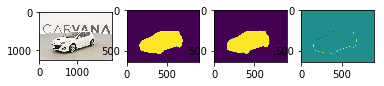

 38%|███▊      | 386/1018 [23:01<37:38,  3.57s/it]

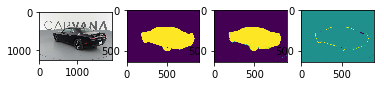

 38%|███▊      | 387/1018 [23:05<37:29,  3.57s/it]

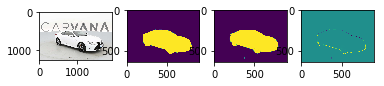

 38%|███▊      | 388/1018 [23:08<37:20,  3.56s/it]

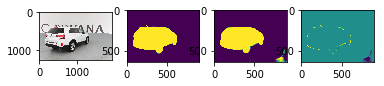

 38%|███▊      | 389/1018 [23:12<37:20,  3.56s/it]

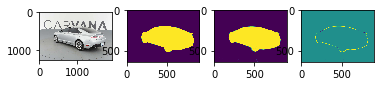

 38%|███▊      | 390/1018 [23:16<38:06,  3.64s/it]

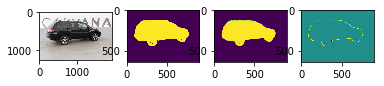

 38%|███▊      | 391/1018 [23:19<37:45,  3.61s/it]

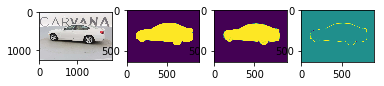

 39%|███▊      | 392/1018 [23:23<37:26,  3.59s/it]

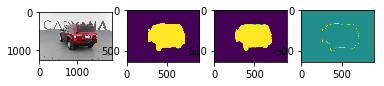

 39%|███▊      | 393/1018 [23:26<37:09,  3.57s/it]

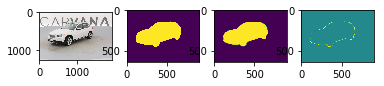

 39%|███▊      | 394/1018 [23:30<37:09,  3.57s/it]

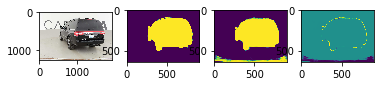

 39%|███▉      | 395/1018 [23:34<37:10,  3.58s/it]

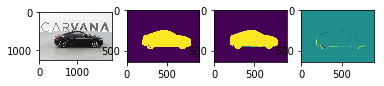

 39%|███▉      | 396/1018 [23:37<37:04,  3.58s/it]

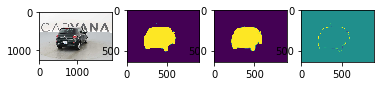

 39%|███▉      | 397/1018 [23:41<37:53,  3.66s/it]

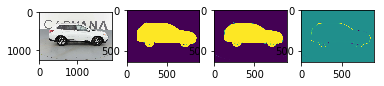

 39%|███▉      | 398/1018 [23:45<37:41,  3.65s/it]

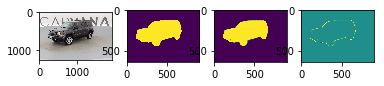

 39%|███▉      | 399/1018 [23:48<37:14,  3.61s/it]

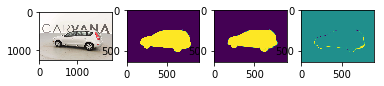

 39%|███▉      | 400/1018 [23:52<36:48,  3.57s/it]

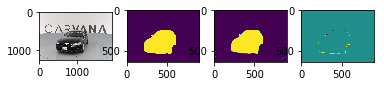

 39%|███▉      | 401/1018 [23:55<36:28,  3.55s/it]

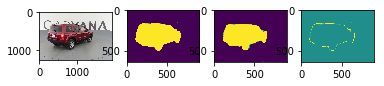

 39%|███▉      | 402/1018 [23:59<36:33,  3.56s/it]

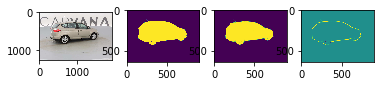

 40%|███▉      | 403/1018 [24:02<36:27,  3.56s/it]

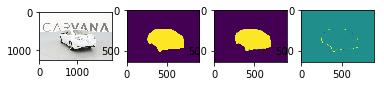

 40%|███▉      | 404/1018 [24:06<36:26,  3.56s/it]

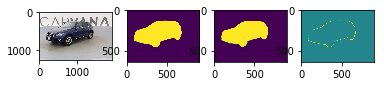

 40%|███▉      | 405/1018 [24:10<37:01,  3.62s/it]

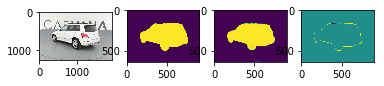

 40%|███▉      | 406/1018 [24:13<36:34,  3.59s/it]

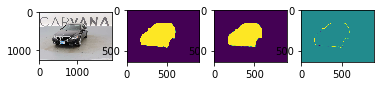

 40%|███▉      | 407/1018 [24:17<36:30,  3.59s/it]

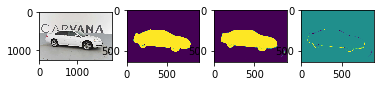

 40%|████      | 408/1018 [24:20<36:19,  3.57s/it]

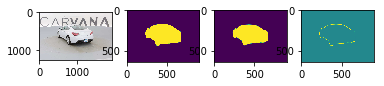

 40%|████      | 409/1018 [24:24<36:21,  3.58s/it]

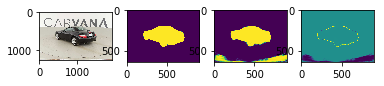

 40%|████      | 410/1018 [24:28<36:35,  3.61s/it]

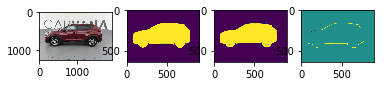

 40%|████      | 411/1018 [24:31<36:29,  3.61s/it]

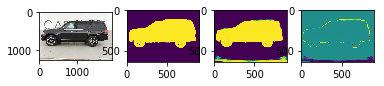

 40%|████      | 412/1018 [24:35<36:49,  3.65s/it]

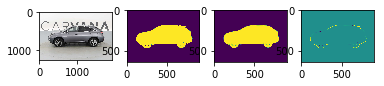

 41%|████      | 413/1018 [24:38<36:27,  3.62s/it]

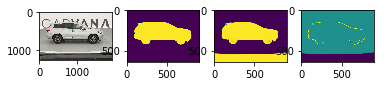

 41%|████      | 414/1018 [24:42<36:03,  3.58s/it]

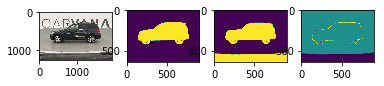

 41%|████      | 415/1018 [24:45<35:46,  3.56s/it]

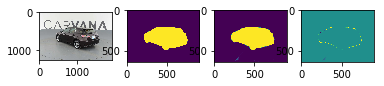

 41%|████      | 416/1018 [24:49<35:40,  3.56s/it]

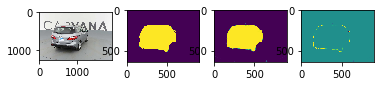

 41%|████      | 417/1018 [24:52<35:35,  3.55s/it]

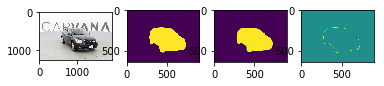

 41%|████      | 418/1018 [24:56<35:23,  3.54s/it]

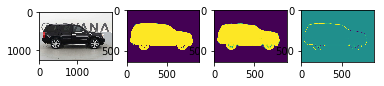

 41%|████      | 419/1018 [25:00<35:31,  3.56s/it]

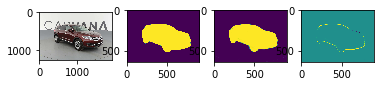

 41%|████▏     | 420/1018 [25:03<36:00,  3.61s/it]

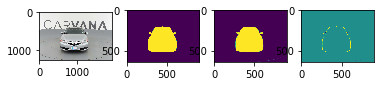

 41%|████▏     | 421/1018 [25:07<35:56,  3.61s/it]

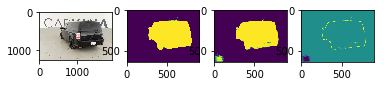

 41%|████▏     | 422/1018 [25:11<35:51,  3.61s/it]

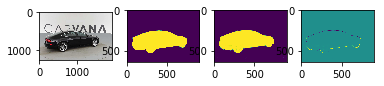

 42%|████▏     | 423/1018 [25:14<35:36,  3.59s/it]

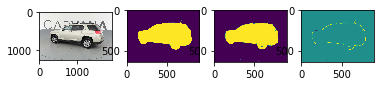

 42%|████▏     | 424/1018 [25:18<35:23,  3.57s/it]

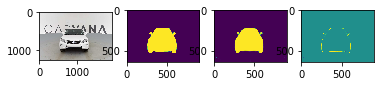

 42%|████▏     | 425/1018 [25:21<35:19,  3.57s/it]

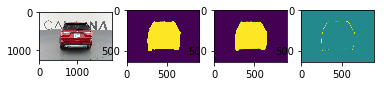

 42%|████▏     | 426/1018 [25:25<35:18,  3.58s/it]

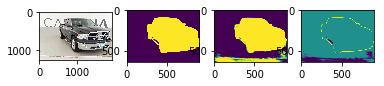

 42%|████▏     | 427/1018 [25:28<35:00,  3.55s/it]

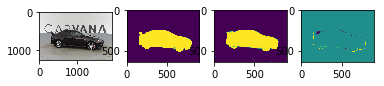

 42%|████▏     | 428/1018 [25:32<35:37,  3.62s/it]

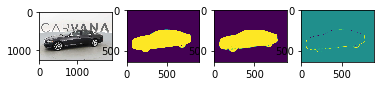

 42%|████▏     | 429/1018 [25:36<35:12,  3.59s/it]

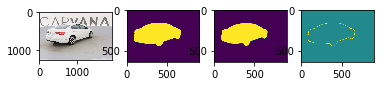

 42%|████▏     | 430/1018 [25:39<35:10,  3.59s/it]

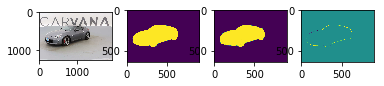

 42%|████▏     | 431/1018 [25:43<34:58,  3.58s/it]

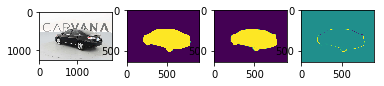

 42%|████▏     | 432/1018 [25:46<34:55,  3.58s/it]

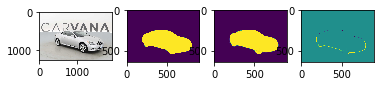

 43%|████▎     | 433/1018 [25:50<34:44,  3.56s/it]

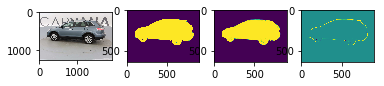

 43%|████▎     | 434/1018 [25:53<34:30,  3.55s/it]

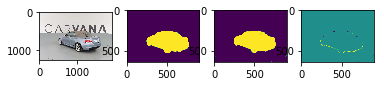

 43%|████▎     | 435/1018 [25:57<35:00,  3.60s/it]

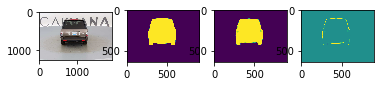

 43%|████▎     | 436/1018 [26:01<34:38,  3.57s/it]

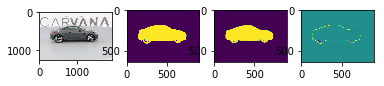

 43%|████▎     | 437/1018 [26:04<34:19,  3.55s/it]

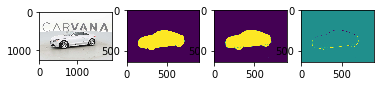

 43%|████▎     | 438/1018 [26:08<34:22,  3.56s/it]

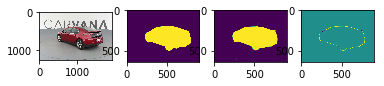

 43%|████▎     | 439/1018 [26:11<34:25,  3.57s/it]

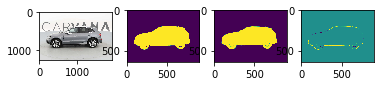

 43%|████▎     | 440/1018 [26:15<34:19,  3.56s/it]

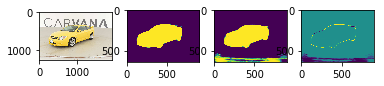

 43%|████▎     | 441/1018 [26:18<34:05,  3.55s/it]

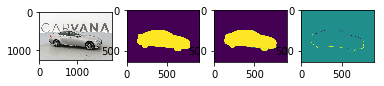

 43%|████▎     | 442/1018 [26:22<34:43,  3.62s/it]

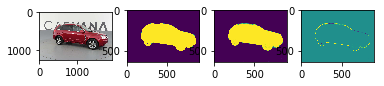

 44%|████▎     | 443/1018 [26:26<34:26,  3.59s/it]

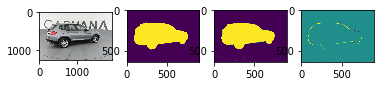

 44%|████▎     | 444/1018 [26:29<34:24,  3.60s/it]

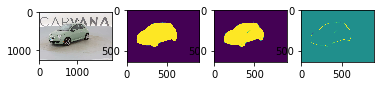

 44%|████▎     | 445/1018 [26:33<34:10,  3.58s/it]

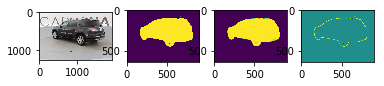

 44%|████▍     | 446/1018 [26:36<34:21,  3.60s/it]

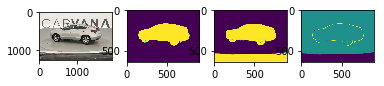

 44%|████▍     | 447/1018 [26:40<34:12,  3.60s/it]

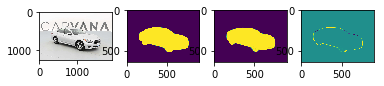

 44%|████▍     | 448/1018 [26:44<33:57,  3.57s/it]

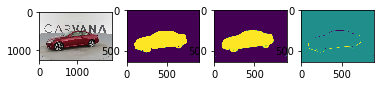

 44%|████▍     | 449/1018 [26:47<33:47,  3.56s/it]

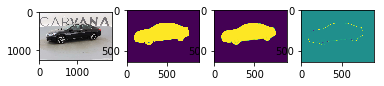

 44%|████▍     | 450/1018 [26:51<34:14,  3.62s/it]

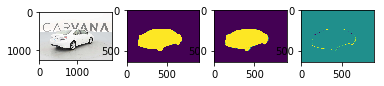

 44%|████▍     | 451/1018 [26:54<33:53,  3.59s/it]

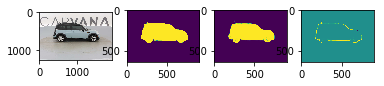

 44%|████▍     | 452/1018 [26:58<33:46,  3.58s/it]

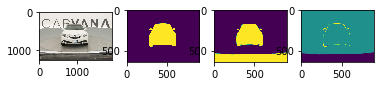

 44%|████▍     | 453/1018 [27:01<33:39,  3.57s/it]

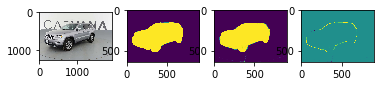

 45%|████▍     | 454/1018 [27:05<33:34,  3.57s/it]

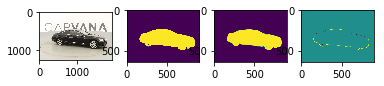

 45%|████▍     | 455/1018 [27:09<33:39,  3.59s/it]

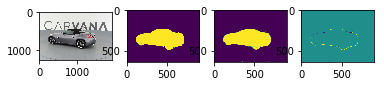

 45%|████▍     | 456/1018 [27:12<33:32,  3.58s/it]

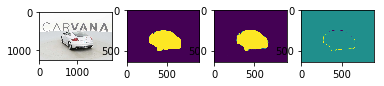

 45%|████▍     | 457/1018 [27:16<34:10,  3.65s/it]

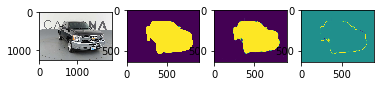

 45%|████▍     | 458/1018 [27:20<33:53,  3.63s/it]

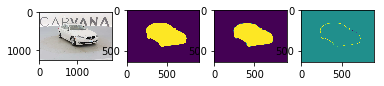

 45%|████▌     | 459/1018 [27:23<33:34,  3.60s/it]

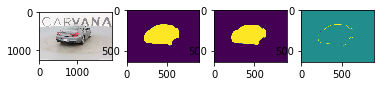

 45%|████▌     | 460/1018 [27:27<33:21,  3.59s/it]

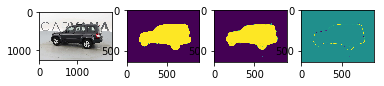

 45%|████▌     | 461/1018 [27:30<33:12,  3.58s/it]

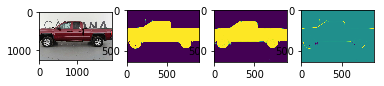

 45%|████▌     | 462/1018 [27:34<33:34,  3.62s/it]

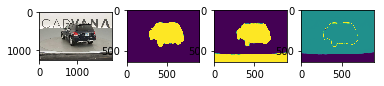

 45%|████▌     | 463/1018 [27:38<33:26,  3.61s/it]

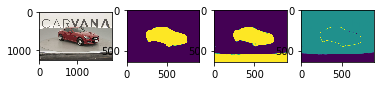

 46%|████▌     | 464/1018 [27:41<33:58,  3.68s/it]

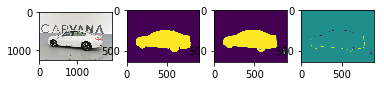

 46%|████▌     | 465/1018 [27:45<33:34,  3.64s/it]

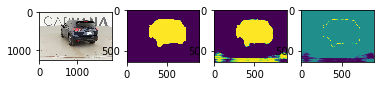

 46%|████▌     | 466/1018 [27:48<33:14,  3.61s/it]

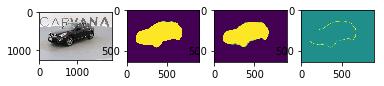

 46%|████▌     | 467/1018 [27:52<33:07,  3.61s/it]

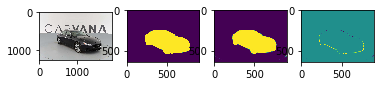

 46%|████▌     | 468/1018 [27:56<32:53,  3.59s/it]

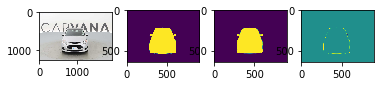

 46%|████▌     | 469/1018 [27:59<32:54,  3.60s/it]

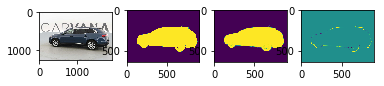

 46%|████▌     | 470/1018 [28:03<32:42,  3.58s/it]

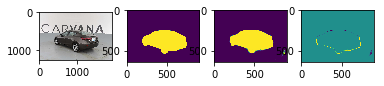

 46%|████▋     | 471/1018 [28:07<33:08,  3.63s/it]

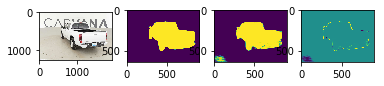

 46%|████▋     | 472/1018 [28:10<32:57,  3.62s/it]

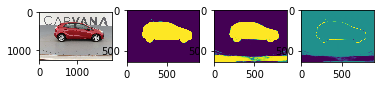

 46%|████▋     | 473/1018 [28:14<32:41,  3.60s/it]

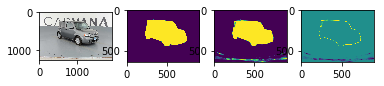

 47%|████▋     | 474/1018 [28:17<32:21,  3.57s/it]

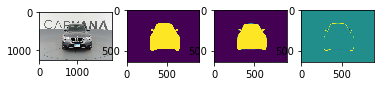

 47%|████▋     | 475/1018 [28:21<32:21,  3.58s/it]

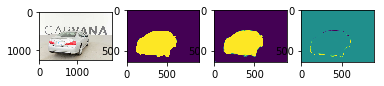

 47%|████▋     | 476/1018 [28:24<32:34,  3.61s/it]

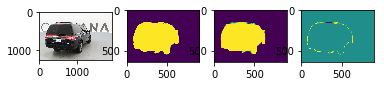

 47%|████▋     | 477/1018 [28:28<32:11,  3.57s/it]

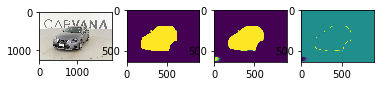

 47%|████▋     | 478/1018 [28:32<32:37,  3.62s/it]

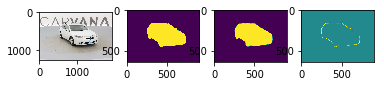

 47%|████▋     | 479/1018 [28:35<32:24,  3.61s/it]

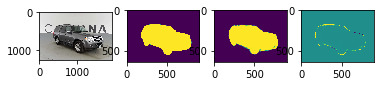

 47%|████▋     | 480/1018 [28:39<32:13,  3.59s/it]

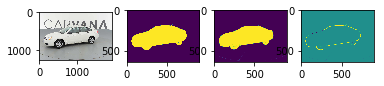

 47%|████▋     | 481/1018 [28:42<31:56,  3.57s/it]

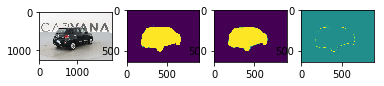

 47%|████▋     | 482/1018 [28:46<31:48,  3.56s/it]

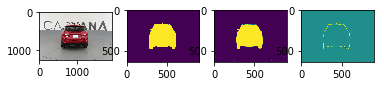

 47%|████▋     | 483/1018 [28:49<31:48,  3.57s/it]

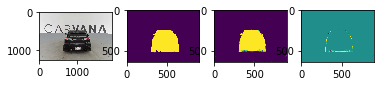

 48%|████▊     | 484/1018 [28:53<31:39,  3.56s/it]

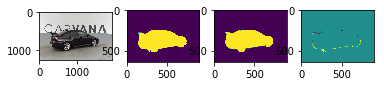

 48%|████▊     | 485/1018 [28:57<32:15,  3.63s/it]

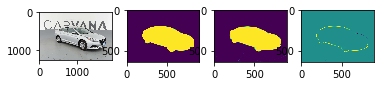

 48%|████▊     | 486/1018 [29:00<32:01,  3.61s/it]

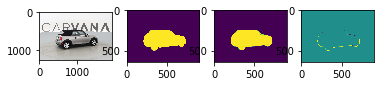

 48%|████▊     | 487/1018 [29:04<31:54,  3.61s/it]

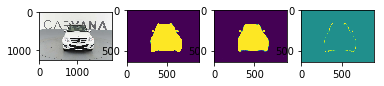

 48%|████▊     | 488/1018 [29:07<31:40,  3.59s/it]

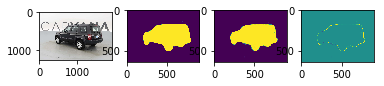

 48%|████▊     | 489/1018 [29:11<31:41,  3.59s/it]

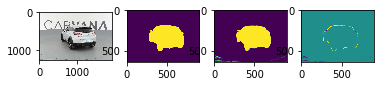

 48%|████▊     | 490/1018 [29:15<31:33,  3.59s/it]

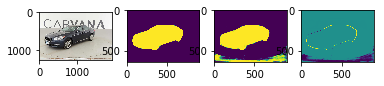

 48%|████▊     | 491/1018 [29:18<31:19,  3.57s/it]

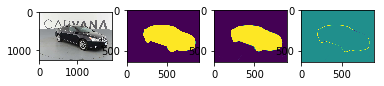

 48%|████▊     | 492/1018 [29:22<31:45,  3.62s/it]

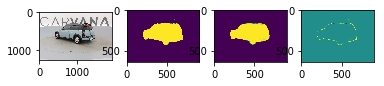

 48%|████▊     | 493/1018 [29:25<31:24,  3.59s/it]

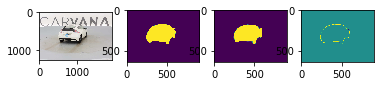

 49%|████▊     | 494/1018 [29:29<31:12,  3.57s/it]

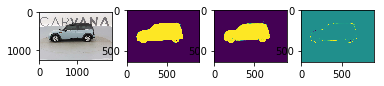

 49%|████▊     | 495/1018 [29:33<31:09,  3.58s/it]

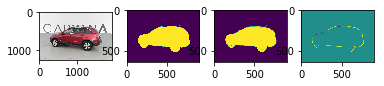

 49%|████▊     | 496/1018 [29:36<31:03,  3.57s/it]

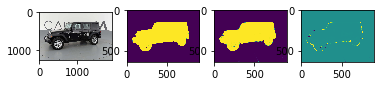

 49%|████▉     | 497/1018 [29:40<30:48,  3.55s/it]

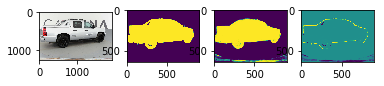

 49%|████▉     | 498/1018 [29:43<31:03,  3.58s/it]

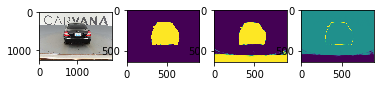

 49%|████▉     | 499/1018 [29:47<31:24,  3.63s/it]

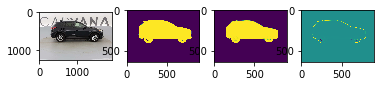

 49%|████▉     | 500/1018 [29:51<31:12,  3.61s/it]

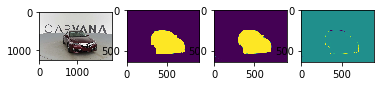

 49%|████▉     | 501/1018 [29:54<30:53,  3.58s/it]

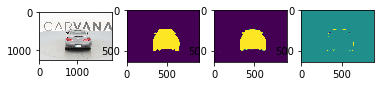

 49%|████▉     | 502/1018 [29:58<30:42,  3.57s/it]

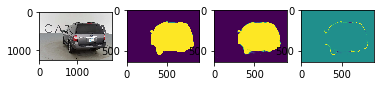

 49%|████▉     | 503/1018 [30:01<31:00,  3.61s/it]

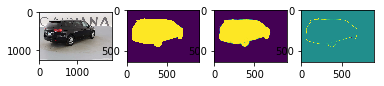

 50%|████▉     | 504/1018 [30:05<30:46,  3.59s/it]

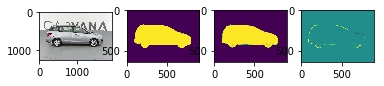

 50%|████▉     | 505/1018 [30:09<30:41,  3.59s/it]

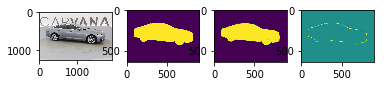

 50%|████▉     | 506/1018 [30:12<31:08,  3.65s/it]

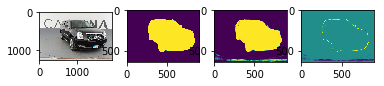

 50%|████▉     | 507/1018 [30:16<31:02,  3.64s/it]

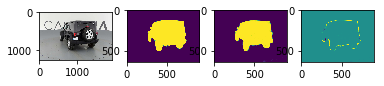

 50%|████▉     | 508/1018 [30:19<30:42,  3.61s/it]

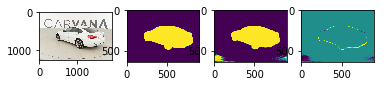

 50%|█████     | 509/1018 [30:23<30:21,  3.58s/it]

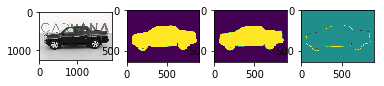

 50%|█████     | 510/1018 [30:26<30:06,  3.56s/it]

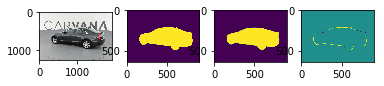

 50%|█████     | 511/1018 [30:30<30:08,  3.57s/it]

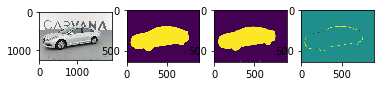

 50%|█████     | 512/1018 [30:34<29:54,  3.55s/it]

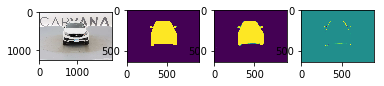

 50%|█████     | 513/1018 [30:37<30:18,  3.60s/it]

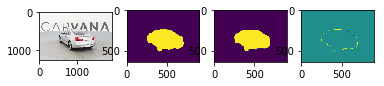

 50%|█████     | 514/1018 [30:41<30:07,  3.59s/it]

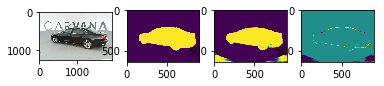

 51%|█████     | 515/1018 [30:44<30:01,  3.58s/it]

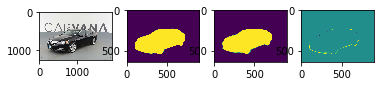

 51%|█████     | 516/1018 [30:48<30:05,  3.60s/it]

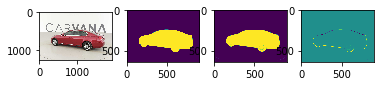

 51%|█████     | 517/1018 [30:52<29:51,  3.58s/it]

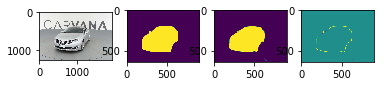

 51%|█████     | 518/1018 [30:55<29:39,  3.56s/it]

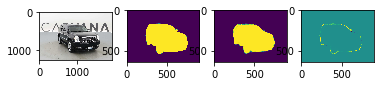

 51%|█████     | 519/1018 [30:59<29:32,  3.55s/it]

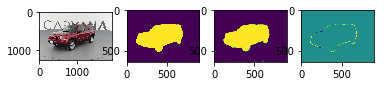

 51%|█████     | 520/1018 [31:02<30:01,  3.62s/it]

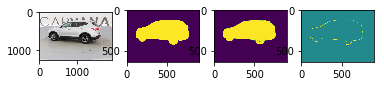

 51%|█████     | 521/1018 [31:06<29:45,  3.59s/it]

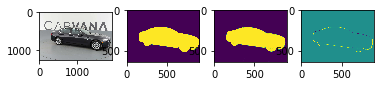

 51%|█████▏    | 522/1018 [31:09<29:37,  3.58s/it]

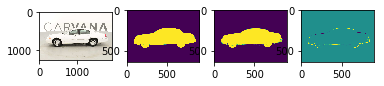

 51%|█████▏    | 523/1018 [31:13<29:36,  3.59s/it]

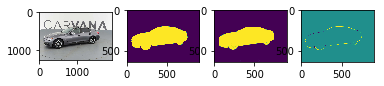

 51%|█████▏    | 524/1018 [31:17<29:30,  3.58s/it]

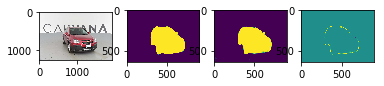

 52%|█████▏    | 525/1018 [31:20<29:23,  3.58s/it]

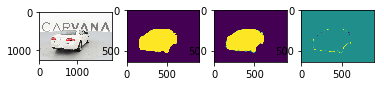

 52%|█████▏    | 526/1018 [31:24<29:17,  3.57s/it]

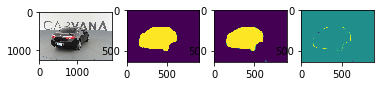

 52%|█████▏    | 527/1018 [31:28<29:34,  3.61s/it]

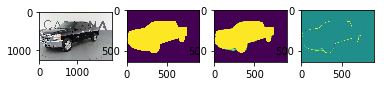

 52%|█████▏    | 528/1018 [31:31<29:37,  3.63s/it]

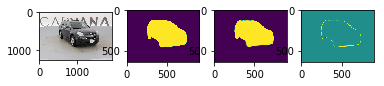

 52%|█████▏    | 529/1018 [31:35<29:29,  3.62s/it]

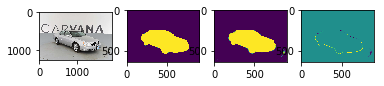

 52%|█████▏    | 530/1018 [31:38<29:17,  3.60s/it]

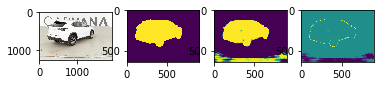

 52%|█████▏    | 531/1018 [31:42<29:00,  3.57s/it]

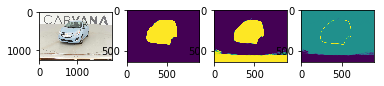

 52%|█████▏    | 532/1018 [31:45<28:53,  3.57s/it]

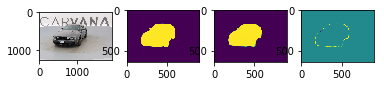

 52%|█████▏    | 533/1018 [31:49<28:53,  3.57s/it]

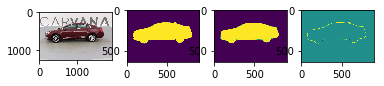

 52%|█████▏    | 534/1018 [31:53<29:20,  3.64s/it]

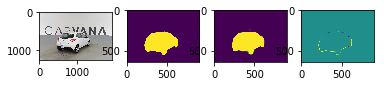

 53%|█████▎    | 535/1018 [31:56<28:57,  3.60s/it]

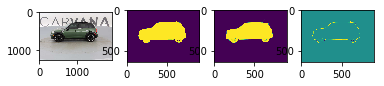

 53%|█████▎    | 536/1018 [32:00<28:52,  3.59s/it]

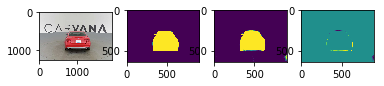

 53%|█████▎    | 537/1018 [32:03<28:40,  3.58s/it]

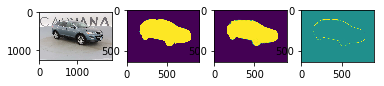

 53%|█████▎    | 538/1018 [32:07<28:52,  3.61s/it]

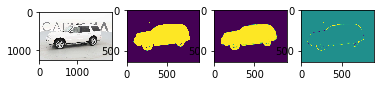

 53%|█████▎    | 539/1018 [32:11<28:55,  3.62s/it]

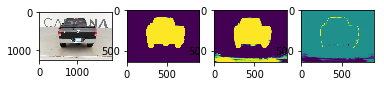

 53%|█████▎    | 540/1018 [32:14<28:39,  3.60s/it]

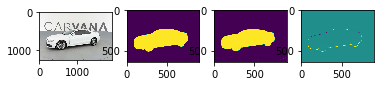

 53%|█████▎    | 541/1018 [32:18<29:00,  3.65s/it]

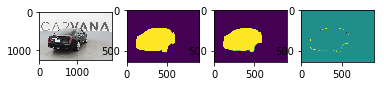

 53%|█████▎    | 542/1018 [32:22<28:51,  3.64s/it]

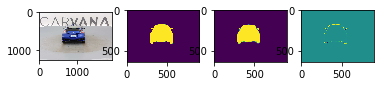

 53%|█████▎    | 543/1018 [32:25<28:44,  3.63s/it]

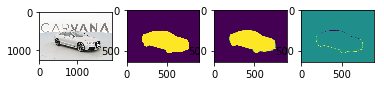

 53%|█████▎    | 544/1018 [32:29<28:26,  3.60s/it]

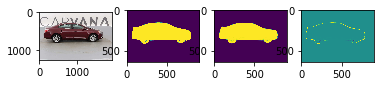

 54%|█████▎    | 545/1018 [32:32<28:15,  3.58s/it]

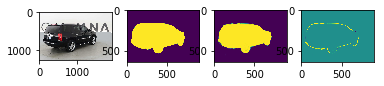

 54%|█████▎    | 546/1018 [32:36<28:15,  3.59s/it]

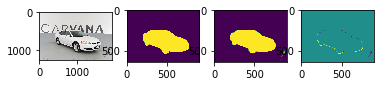

 54%|█████▎    | 547/1018 [32:39<28:02,  3.57s/it]

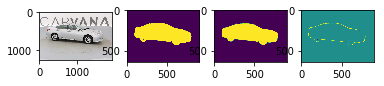

 54%|█████▍    | 548/1018 [32:43<28:40,  3.66s/it]

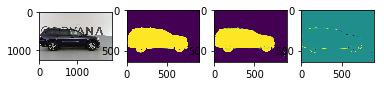

 54%|█████▍    | 549/1018 [32:47<28:30,  3.65s/it]

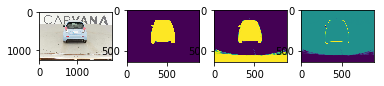

 54%|█████▍    | 550/1018 [32:50<28:09,  3.61s/it]

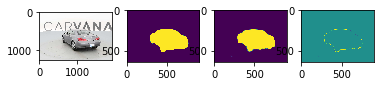

 54%|█████▍    | 551/1018 [32:54<27:53,  3.58s/it]

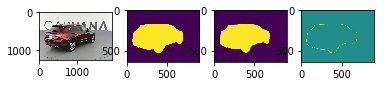

 54%|█████▍    | 552/1018 [32:58<27:51,  3.59s/it]

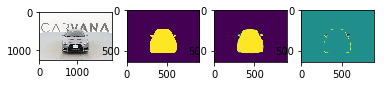

 54%|█████▍    | 553/1018 [33:01<27:31,  3.55s/it]

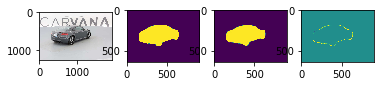

 54%|█████▍    | 554/1018 [33:05<27:33,  3.56s/it]

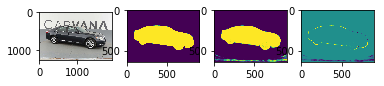

 55%|█████▍    | 555/1018 [33:08<27:37,  3.58s/it]

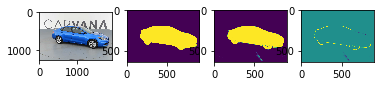

 55%|█████▍    | 556/1018 [33:12<28:05,  3.65s/it]

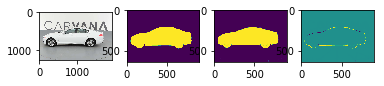

 55%|█████▍    | 557/1018 [33:16<27:50,  3.62s/it]

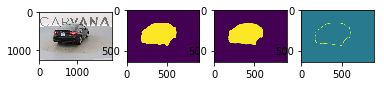

 55%|█████▍    | 558/1018 [33:19<27:31,  3.59s/it]

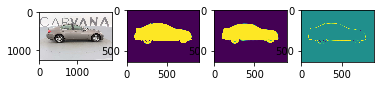

 55%|█████▍    | 559/1018 [33:23<27:23,  3.58s/it]

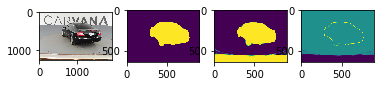

 55%|█████▌    | 560/1018 [33:26<27:16,  3.57s/it]

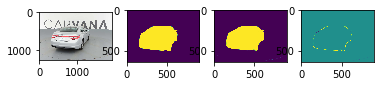

 55%|█████▌    | 561/1018 [33:30<27:17,  3.58s/it]

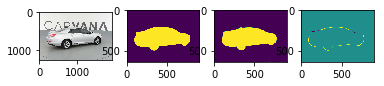

 55%|█████▌    | 562/1018 [33:34<27:38,  3.64s/it]

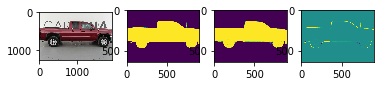

 55%|█████▌    | 563/1018 [33:37<27:30,  3.63s/it]

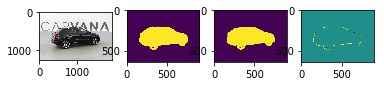

 55%|█████▌    | 564/1018 [33:41<27:21,  3.62s/it]

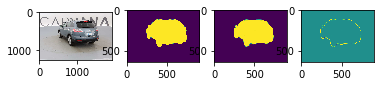

 56%|█████▌    | 565/1018 [33:44<27:11,  3.60s/it]

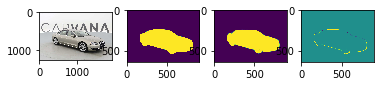

 56%|█████▌    | 566/1018 [33:48<27:14,  3.62s/it]

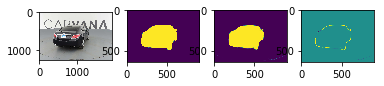

 56%|█████▌    | 567/1018 [33:52<27:02,  3.60s/it]

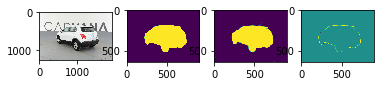

 56%|█████▌    | 568/1018 [33:55<26:56,  3.59s/it]

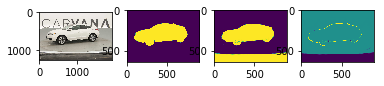

 56%|█████▌    | 569/1018 [33:59<26:48,  3.58s/it]

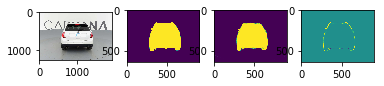

 56%|█████▌    | 570/1018 [34:03<27:16,  3.65s/it]

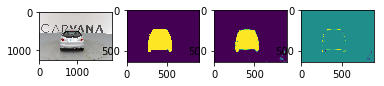

 56%|█████▌    | 571/1018 [34:06<27:06,  3.64s/it]

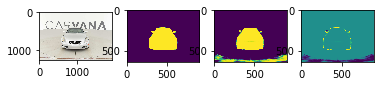

 56%|█████▌    | 572/1018 [34:10<26:54,  3.62s/it]

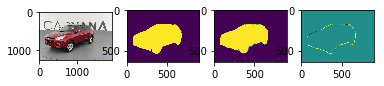

 56%|█████▋    | 573/1018 [34:13<26:41,  3.60s/it]

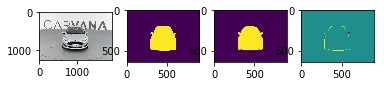

 56%|█████▋    | 574/1018 [34:17<26:36,  3.60s/it]

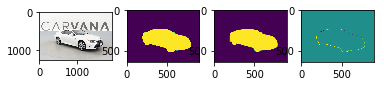

 56%|█████▋    | 575/1018 [34:20<26:26,  3.58s/it]

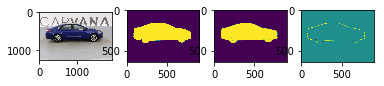

 57%|█████▋    | 576/1018 [34:24<26:17,  3.57s/it]

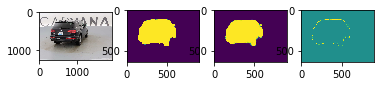

 57%|█████▋    | 577/1018 [34:28<26:35,  3.62s/it]

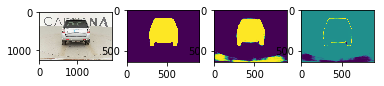

 57%|█████▋    | 578/1018 [34:31<26:45,  3.65s/it]

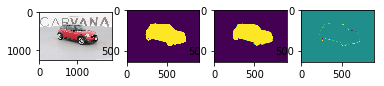

 57%|█████▋    | 579/1018 [34:35<26:45,  3.66s/it]

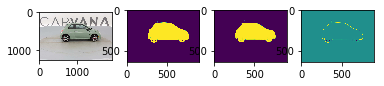

 57%|█████▋    | 580/1018 [34:39<26:34,  3.64s/it]

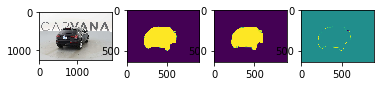

 57%|█████▋    | 581/1018 [34:42<26:21,  3.62s/it]

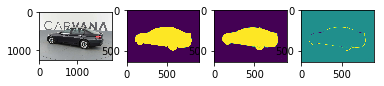

 57%|█████▋    | 582/1018 [34:46<26:17,  3.62s/it]

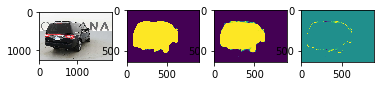

 57%|█████▋    | 583/1018 [34:49<26:01,  3.59s/it]

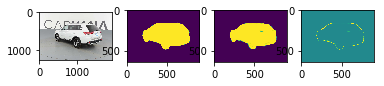

 57%|█████▋    | 584/1018 [34:53<26:21,  3.64s/it]

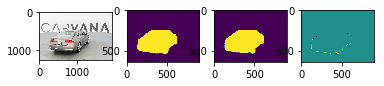

 57%|█████▋    | 585/1018 [34:57<26:06,  3.62s/it]

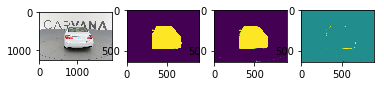

 58%|█████▊    | 586/1018 [35:00<25:59,  3.61s/it]

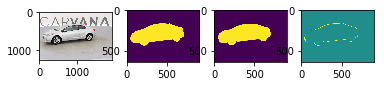

 58%|█████▊    | 587/1018 [35:04<25:50,  3.60s/it]

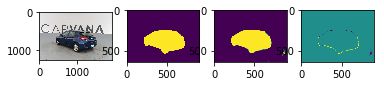

 58%|█████▊    | 588/1018 [35:08<25:48,  3.60s/it]

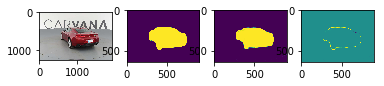

 58%|█████▊    | 589/1018 [35:11<25:36,  3.58s/it]

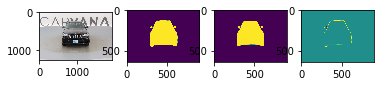

 58%|█████▊    | 590/1018 [35:15<25:29,  3.57s/it]

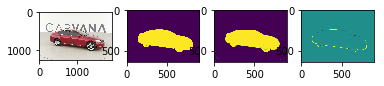

 58%|█████▊    | 591/1018 [35:18<25:45,  3.62s/it]

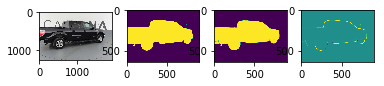

 58%|█████▊    | 592/1018 [35:22<25:38,  3.61s/it]

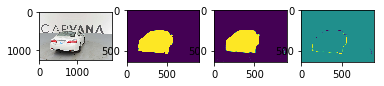

 58%|█████▊    | 593/1018 [35:25<25:28,  3.60s/it]

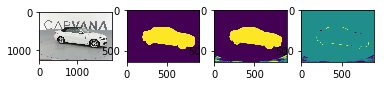

 58%|█████▊    | 594/1018 [35:29<25:17,  3.58s/it]

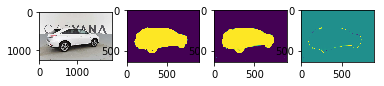

 58%|█████▊    | 595/1018 [35:33<25:10,  3.57s/it]

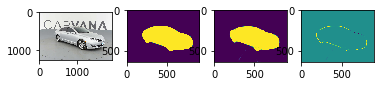

 59%|█████▊    | 596/1018 [35:36<25:10,  3.58s/it]

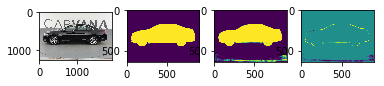

 59%|█████▊    | 597/1018 [35:40<25:10,  3.59s/it]

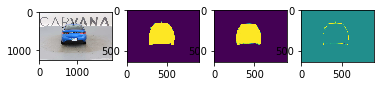

 59%|█████▊    | 598/1018 [35:43<25:01,  3.58s/it]

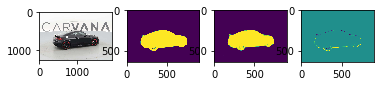

 59%|█████▉    | 599/1018 [35:47<25:20,  3.63s/it]

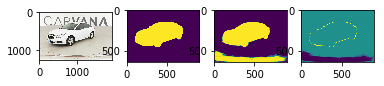

 59%|█████▉    | 600/1018 [35:51<25:17,  3.63s/it]

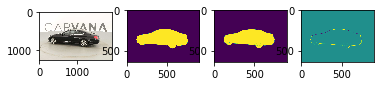

 59%|█████▉    | 601/1018 [35:54<25:03,  3.60s/it]

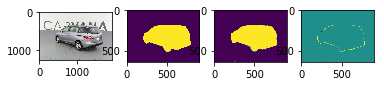

 59%|█████▉    | 602/1018 [35:58<24:49,  3.58s/it]

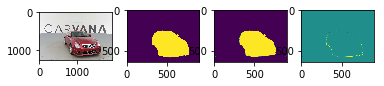

 59%|█████▉    | 603/1018 [36:02<25:05,  3.63s/it]

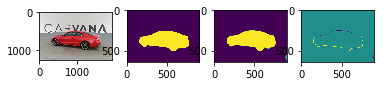

 59%|█████▉    | 604/1018 [36:05<24:49,  3.60s/it]

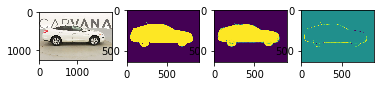

 59%|█████▉    | 605/1018 [36:09<24:45,  3.60s/it]

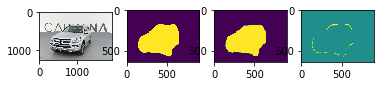

 60%|█████▉    | 606/1018 [36:12<25:02,  3.65s/it]

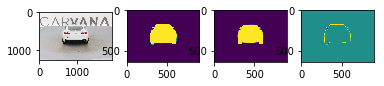

 60%|█████▉    | 607/1018 [36:16<24:58,  3.64s/it]

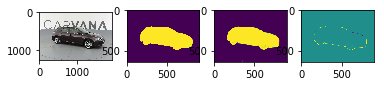

 60%|█████▉    | 608/1018 [36:20<24:42,  3.62s/it]

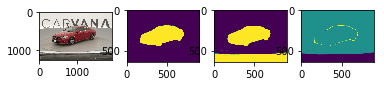

 60%|█████▉    | 609/1018 [36:23<24:29,  3.59s/it]

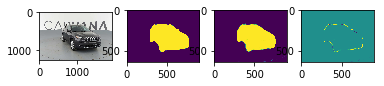

 60%|█████▉    | 610/1018 [36:27<24:19,  3.58s/it]

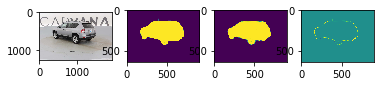

 60%|██████    | 611/1018 [36:30<24:03,  3.55s/it]

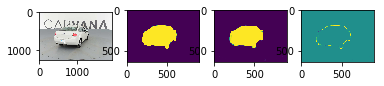

 60%|██████    | 612/1018 [36:34<24:02,  3.55s/it]

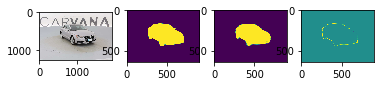

 60%|██████    | 613/1018 [36:37<24:24,  3.62s/it]

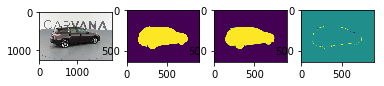

 60%|██████    | 614/1018 [36:41<24:14,  3.60s/it]

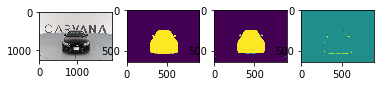

 60%|██████    | 615/1018 [36:45<24:04,  3.58s/it]

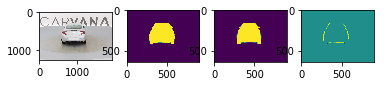

 61%|██████    | 616/1018 [36:48<23:58,  3.58s/it]

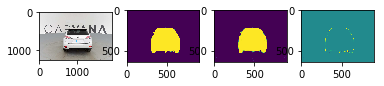

 61%|██████    | 617/1018 [36:52<23:49,  3.57s/it]

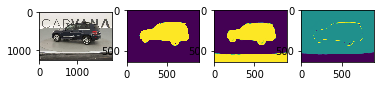

 61%|██████    | 618/1018 [36:55<23:52,  3.58s/it]

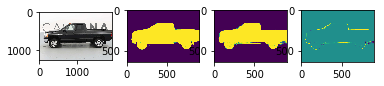

 61%|██████    | 619/1018 [36:59<23:50,  3.59s/it]

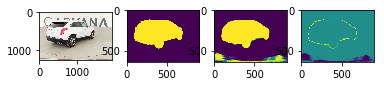

 61%|██████    | 620/1018 [37:03<24:09,  3.64s/it]

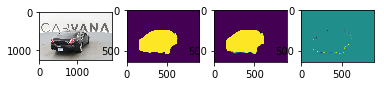

 61%|██████    | 621/1018 [37:06<23:55,  3.62s/it]

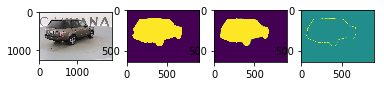

 61%|██████    | 622/1018 [37:10<23:57,  3.63s/it]

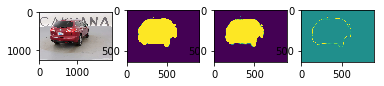

 61%|██████    | 623/1018 [37:13<23:45,  3.61s/it]

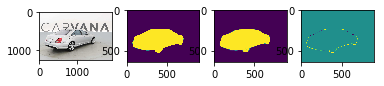

 61%|██████▏   | 624/1018 [37:17<23:42,  3.61s/it]

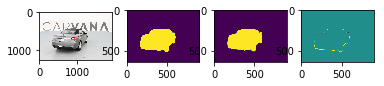

 61%|██████▏   | 625/1018 [37:21<23:39,  3.61s/it]

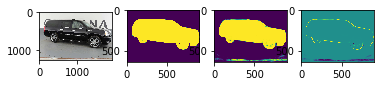

 61%|██████▏   | 626/1018 [37:24<23:33,  3.61s/it]

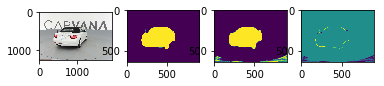

 62%|██████▏   | 627/1018 [37:28<23:47,  3.65s/it]

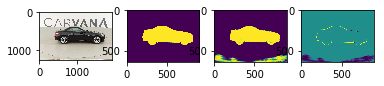

 62%|██████▏   | 628/1018 [37:32<23:31,  3.62s/it]

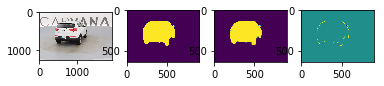

 62%|██████▏   | 629/1018 [37:35<23:13,  3.58s/it]

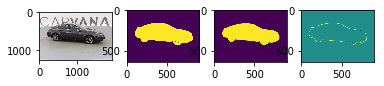

 62%|██████▏   | 630/1018 [37:39<23:04,  3.57s/it]

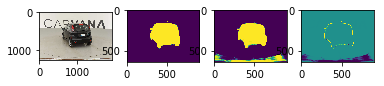

 62%|██████▏   | 631/1018 [37:42<23:00,  3.57s/it]

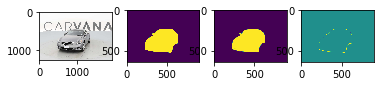

 62%|██████▏   | 632/1018 [37:46<22:59,  3.57s/it]

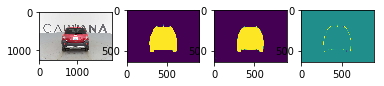

 62%|██████▏   | 633/1018 [37:49<23:03,  3.59s/it]

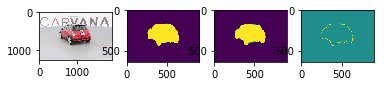

 62%|██████▏   | 634/1018 [37:53<23:16,  3.64s/it]

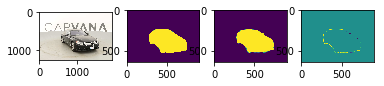

 62%|██████▏   | 635/1018 [37:57<22:58,  3.60s/it]

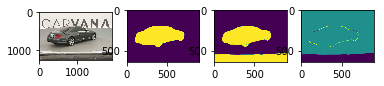

 62%|██████▏   | 636/1018 [38:00<22:46,  3.58s/it]

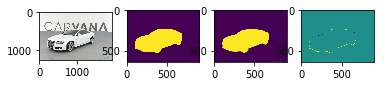

 63%|██████▎   | 637/1018 [38:04<22:33,  3.55s/it]

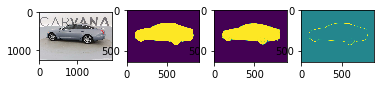

 63%|██████▎   | 638/1018 [38:07<22:23,  3.54s/it]

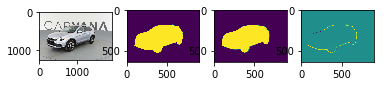

 63%|██████▎   | 639/1018 [38:11<22:35,  3.58s/it]

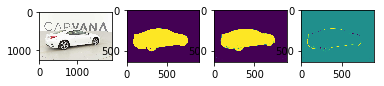

 63%|██████▎   | 640/1018 [38:14<22:26,  3.56s/it]

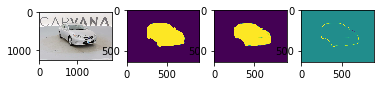

 63%|██████▎   | 641/1018 [38:18<22:16,  3.54s/it]

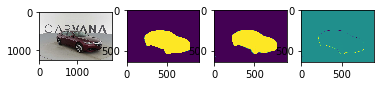

 63%|██████▎   | 642/1018 [38:22<22:36,  3.61s/it]

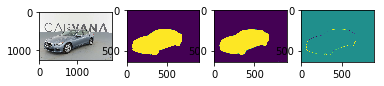

 63%|██████▎   | 643/1018 [38:25<22:20,  3.57s/it]

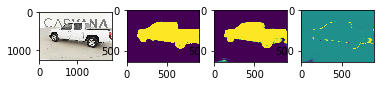

 63%|██████▎   | 644/1018 [38:29<22:20,  3.58s/it]

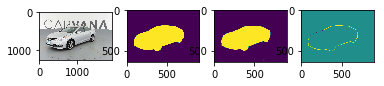

 63%|██████▎   | 645/1018 [38:32<22:17,  3.59s/it]

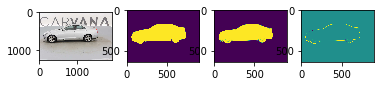

 63%|██████▎   | 646/1018 [38:36<22:04,  3.56s/it]

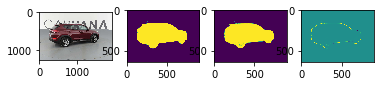

 64%|██████▎   | 647/1018 [38:39<21:53,  3.54s/it]

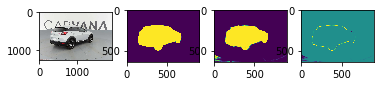

 64%|██████▎   | 648/1018 [38:43<22:14,  3.61s/it]

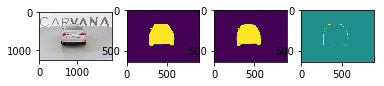

 64%|██████▍   | 649/1018 [38:47<22:05,  3.59s/it]

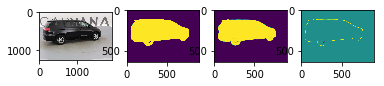

 64%|██████▍   | 650/1018 [38:50<22:08,  3.61s/it]

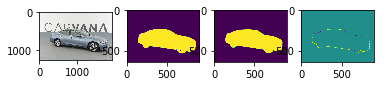

 64%|██████▍   | 651/1018 [38:54<21:57,  3.59s/it]

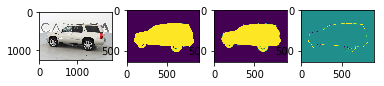

 64%|██████▍   | 652/1018 [38:57<21:42,  3.56s/it]

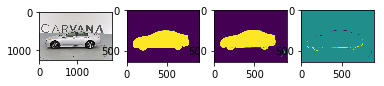

 64%|██████▍   | 653/1018 [39:01<21:33,  3.54s/it]

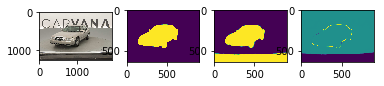

 64%|██████▍   | 654/1018 [39:04<21:25,  3.53s/it]

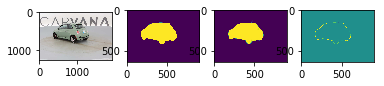

 64%|██████▍   | 655/1018 [39:08<21:54,  3.62s/it]

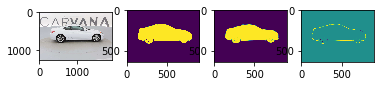

 64%|██████▍   | 656/1018 [39:12<21:49,  3.62s/it]

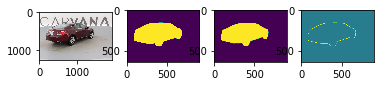

 65%|██████▍   | 657/1018 [39:15<21:40,  3.60s/it]

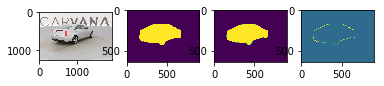

 65%|██████▍   | 658/1018 [39:19<21:36,  3.60s/it]

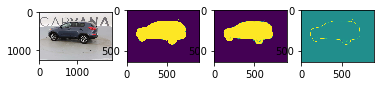

 65%|██████▍   | 659/1018 [39:22<21:21,  3.57s/it]

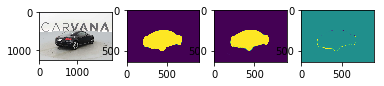

 65%|██████▍   | 660/1018 [39:26<21:09,  3.55s/it]

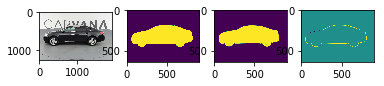

 65%|██████▍   | 661/1018 [39:29<21:07,  3.55s/it]

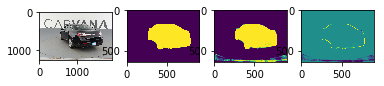

 65%|██████▌   | 662/1018 [39:33<20:55,  3.53s/it]

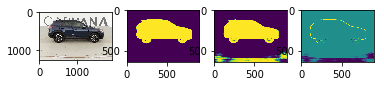

 65%|██████▌   | 663/1018 [39:37<21:04,  3.56s/it]

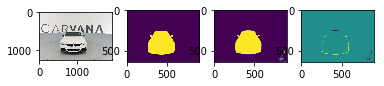

 65%|██████▌   | 664/1018 [39:40<21:15,  3.60s/it]

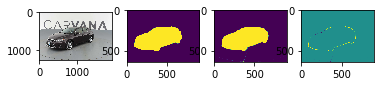

 65%|██████▌   | 665/1018 [39:44<21:04,  3.58s/it]

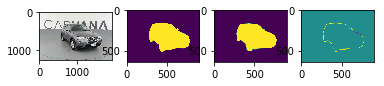

 65%|██████▌   | 666/1018 [39:47<21:01,  3.58s/it]

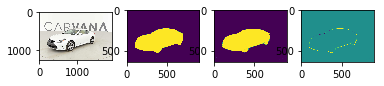

 66%|██████▌   | 667/1018 [39:51<20:53,  3.57s/it]

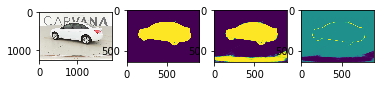

 66%|██████▌   | 668/1018 [39:55<20:47,  3.56s/it]

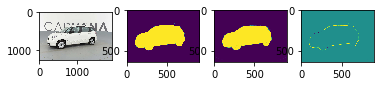

 66%|██████▌   | 669/1018 [39:58<21:02,  3.62s/it]

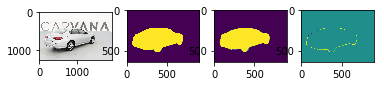

 66%|██████▌   | 670/1018 [40:02<20:52,  3.60s/it]

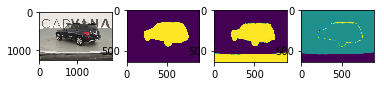

 66%|██████▌   | 671/1018 [40:05<20:37,  3.57s/it]

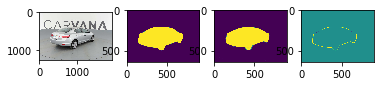

 66%|██████▌   | 672/1018 [40:09<20:27,  3.55s/it]

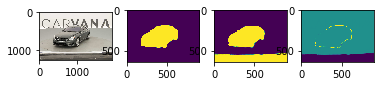

 66%|██████▌   | 673/1018 [40:12<20:21,  3.54s/it]

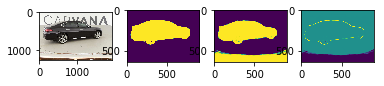

 66%|██████▌   | 674/1018 [40:16<20:25,  3.56s/it]

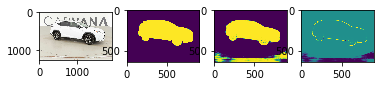

 66%|██████▋   | 675/1018 [40:20<20:24,  3.57s/it]

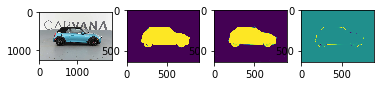

 66%|██████▋   | 676/1018 [40:23<20:13,  3.55s/it]

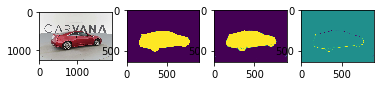

 67%|██████▋   | 677/1018 [40:27<20:34,  3.62s/it]

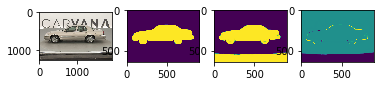

 67%|██████▋   | 678/1018 [40:30<20:20,  3.59s/it]

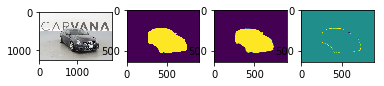

 67%|██████▋   | 679/1018 [40:34<20:09,  3.57s/it]

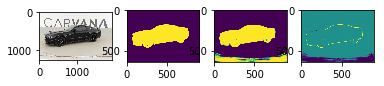

 67%|██████▋   | 680/1018 [40:37<20:04,  3.56s/it]

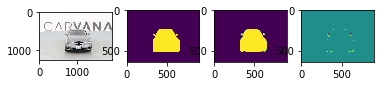

 67%|██████▋   | 681/1018 [40:41<19:55,  3.55s/it]

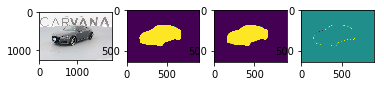

 67%|██████▋   | 682/1018 [40:44<19:46,  3.53s/it]

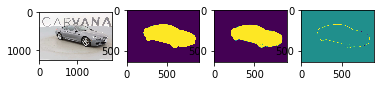

 67%|██████▋   | 683/1018 [40:48<19:40,  3.52s/it]

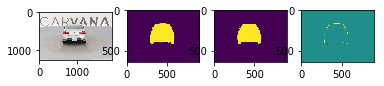

 67%|██████▋   | 684/1018 [40:51<19:39,  3.53s/it]

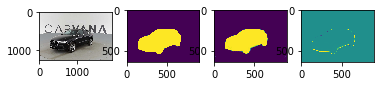

 67%|██████▋   | 685/1018 [40:55<20:07,  3.62s/it]

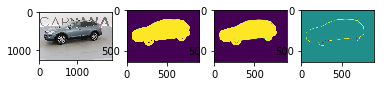

 67%|██████▋   | 686/1018 [40:59<20:04,  3.63s/it]

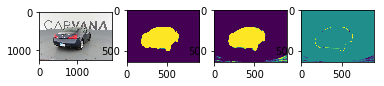

 67%|██████▋   | 687/1018 [41:03<19:57,  3.62s/it]

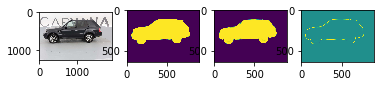

 68%|██████▊   | 688/1018 [41:06<19:47,  3.60s/it]

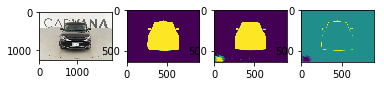

 68%|██████▊   | 689/1018 [41:10<19:44,  3.60s/it]

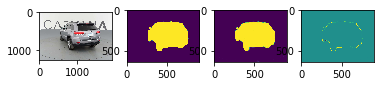

 68%|██████▊   | 690/1018 [41:13<19:30,  3.57s/it]

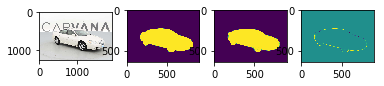

 68%|██████▊   | 691/1018 [41:17<19:28,  3.57s/it]

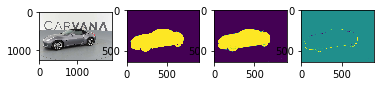

 68%|██████▊   | 692/1018 [41:21<19:53,  3.66s/it]

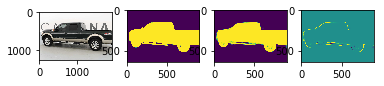

 68%|██████▊   | 693/1018 [41:24<19:35,  3.62s/it]

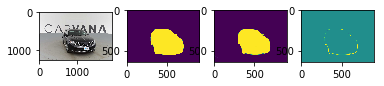

 68%|██████▊   | 694/1018 [41:28<19:23,  3.59s/it]

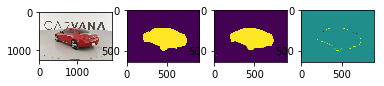

 68%|██████▊   | 695/1018 [41:31<19:21,  3.60s/it]

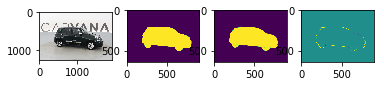

 68%|██████▊   | 696/1018 [41:35<19:11,  3.58s/it]

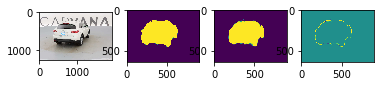

 68%|██████▊   | 697/1018 [41:38<19:06,  3.57s/it]

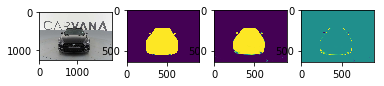

 69%|██████▊   | 698/1018 [41:42<18:55,  3.55s/it]

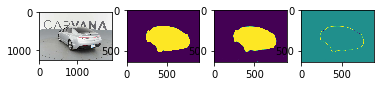

 69%|██████▊   | 699/1018 [41:46<19:14,  3.62s/it]

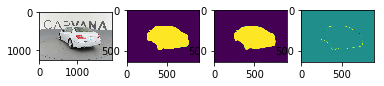

 69%|██████▉   | 700/1018 [41:49<19:03,  3.60s/it]

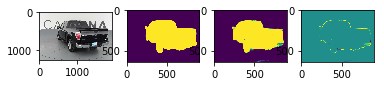

 69%|██████▉   | 701/1018 [41:53<18:54,  3.58s/it]

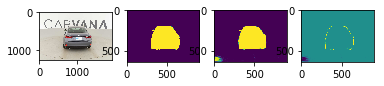

 69%|██████▉   | 702/1018 [41:56<18:43,  3.56s/it]

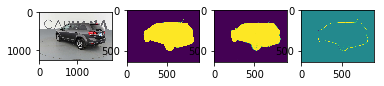

 69%|██████▉   | 703/1018 [42:00<18:39,  3.56s/it]

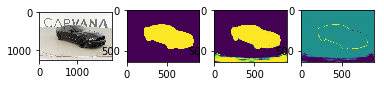

 69%|██████▉   | 704/1018 [42:03<18:35,  3.55s/it]

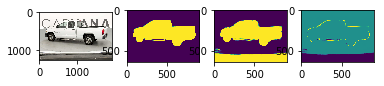

 69%|██████▉   | 705/1018 [42:07<18:37,  3.57s/it]

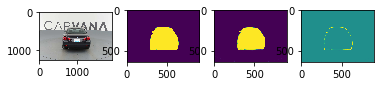

 69%|██████▉   | 706/1018 [42:10<18:29,  3.56s/it]

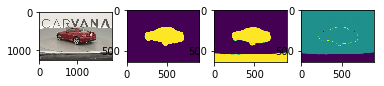

 69%|██████▉   | 707/1018 [42:14<18:39,  3.60s/it]

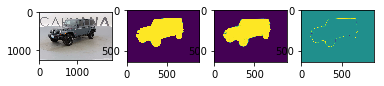

 70%|██████▉   | 708/1018 [42:18<18:38,  3.61s/it]

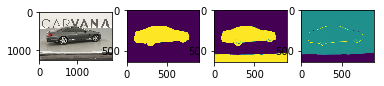

 70%|██████▉   | 709/1018 [42:21<18:27,  3.58s/it]

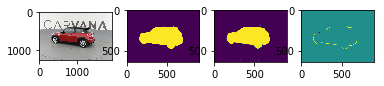

 70%|██████▉   | 710/1018 [42:25<18:25,  3.59s/it]

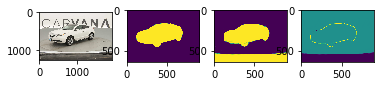

 70%|██████▉   | 711/1018 [42:29<18:19,  3.58s/it]

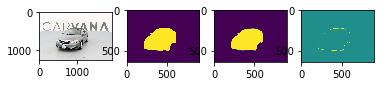

 70%|██████▉   | 712/1018 [42:32<18:15,  3.58s/it]

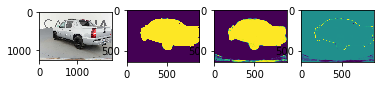

 70%|███████   | 713/1018 [42:36<18:32,  3.65s/it]

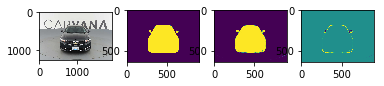

 70%|███████   | 714/1018 [42:40<18:25,  3.64s/it]

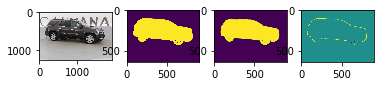

 70%|███████   | 715/1018 [42:43<18:13,  3.61s/it]

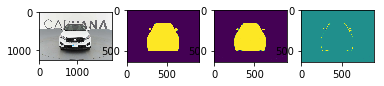

 70%|███████   | 716/1018 [42:47<18:07,  3.60s/it]

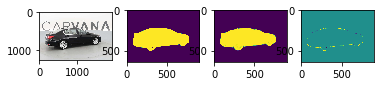

 70%|███████   | 717/1018 [42:50<17:57,  3.58s/it]

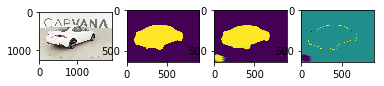

 71%|███████   | 718/1018 [42:54<17:55,  3.58s/it]

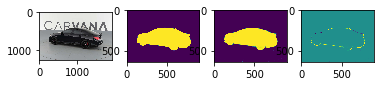

 71%|███████   | 719/1018 [42:57<17:48,  3.57s/it]

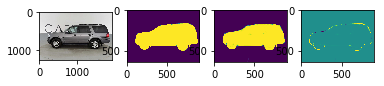

 71%|███████   | 720/1018 [43:01<17:38,  3.55s/it]

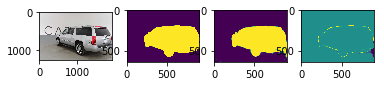

 71%|███████   | 721/1018 [43:05<18:02,  3.65s/it]

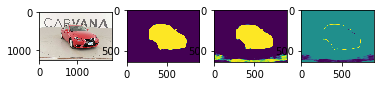

 71%|███████   | 722/1018 [43:08<17:50,  3.62s/it]

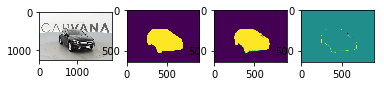

 71%|███████   | 723/1018 [43:12<17:45,  3.61s/it]

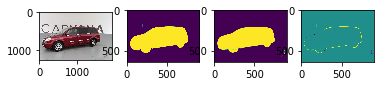

 71%|███████   | 724/1018 [43:15<17:35,  3.59s/it]

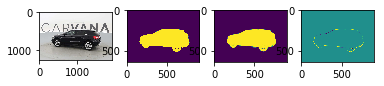

 71%|███████   | 725/1018 [43:19<17:25,  3.57s/it]

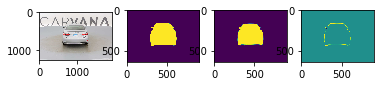

 71%|███████▏  | 726/1018 [43:22<17:21,  3.57s/it]

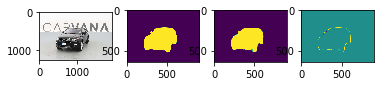

 71%|███████▏  | 727/1018 [43:26<17:16,  3.56s/it]

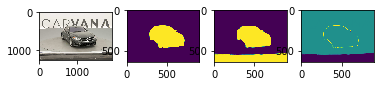

 72%|███████▏  | 728/1018 [43:30<17:36,  3.64s/it]

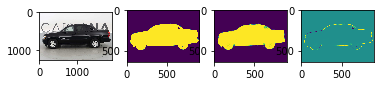

 72%|███████▏  | 729/1018 [43:33<17:26,  3.62s/it]

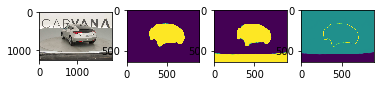

 72%|███████▏  | 730/1018 [43:37<17:13,  3.59s/it]

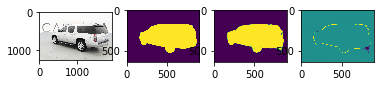

 72%|███████▏  | 731/1018 [43:40<17:08,  3.58s/it]

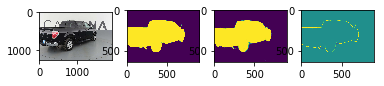

 72%|███████▏  | 732/1018 [43:44<17:07,  3.59s/it]

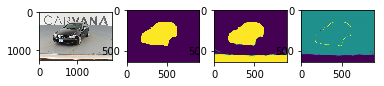

 72%|███████▏  | 733/1018 [43:48<17:04,  3.59s/it]

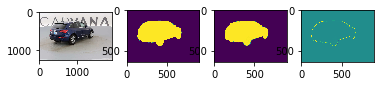

 72%|███████▏  | 734/1018 [43:51<16:56,  3.58s/it]

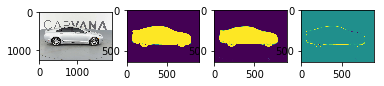

 72%|███████▏  | 735/1018 [43:55<17:07,  3.63s/it]

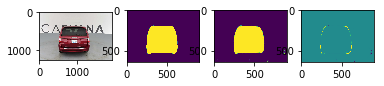

 72%|███████▏  | 736/1018 [43:59<17:01,  3.62s/it]

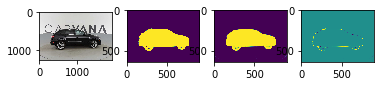

 72%|███████▏  | 737/1018 [44:02<16:48,  3.59s/it]

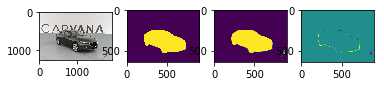

 72%|███████▏  | 738/1018 [44:06<16:44,  3.59s/it]

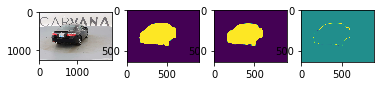

 73%|███████▎  | 739/1018 [44:09<16:45,  3.60s/it]

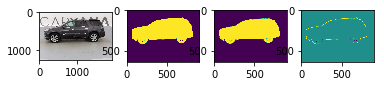

 73%|███████▎  | 740/1018 [44:13<16:41,  3.60s/it]

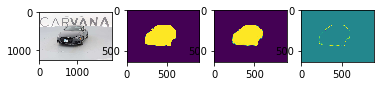

 73%|███████▎  | 741/1018 [44:16<16:31,  3.58s/it]

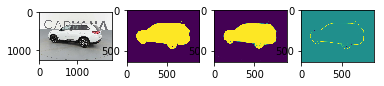

 73%|███████▎  | 742/1018 [44:20<16:26,  3.57s/it]

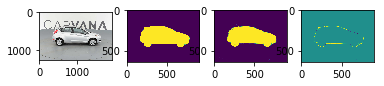

 73%|███████▎  | 743/1018 [44:24<16:40,  3.64s/it]

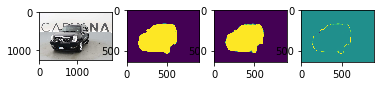

 73%|███████▎  | 744/1018 [44:27<16:28,  3.61s/it]

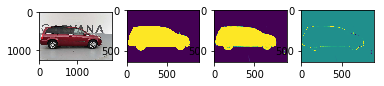

 73%|███████▎  | 745/1018 [44:31<16:15,  3.57s/it]

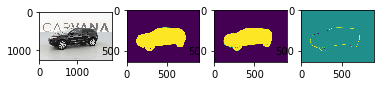

 73%|███████▎  | 746/1018 [44:34<16:14,  3.58s/it]

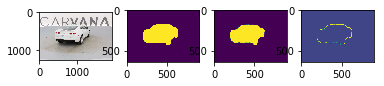

 73%|███████▎  | 747/1018 [44:38<16:07,  3.57s/it]

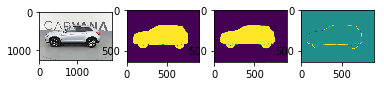

 73%|███████▎  | 748/1018 [44:42<16:03,  3.57s/it]

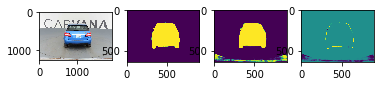

 74%|███████▎  | 749/1018 [44:45<15:55,  3.55s/it]

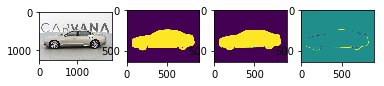

 74%|███████▎  | 750/1018 [44:49<16:25,  3.68s/it]

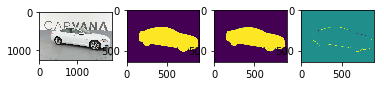

 74%|███████▍  | 751/1018 [44:53<16:10,  3.63s/it]

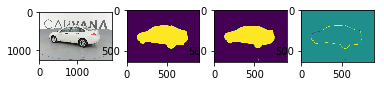

 74%|███████▍  | 752/1018 [44:56<15:58,  3.60s/it]

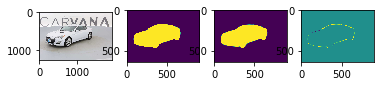

 74%|███████▍  | 753/1018 [45:00<15:52,  3.59s/it]

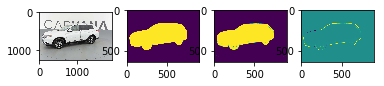

 74%|███████▍  | 754/1018 [45:03<15:46,  3.58s/it]

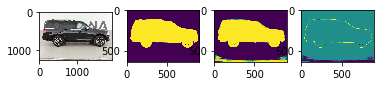

 74%|███████▍  | 755/1018 [45:07<15:49,  3.61s/it]

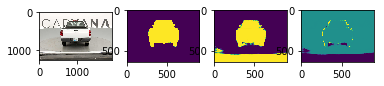

 74%|███████▍  | 756/1018 [45:10<15:43,  3.60s/it]

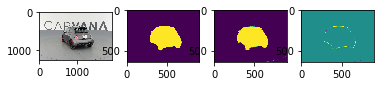

 74%|███████▍  | 757/1018 [45:14<15:57,  3.67s/it]

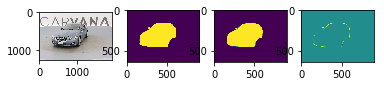

 74%|███████▍  | 758/1018 [45:18<15:40,  3.62s/it]

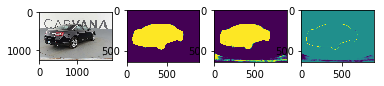

 75%|███████▍  | 759/1018 [45:21<15:32,  3.60s/it]

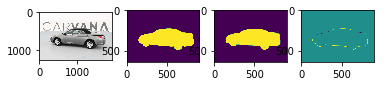

 75%|███████▍  | 760/1018 [45:25<15:28,  3.60s/it]

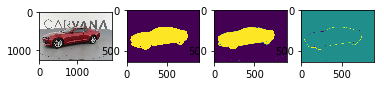

 75%|███████▍  | 761/1018 [45:28<15:19,  3.58s/it]

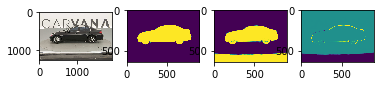

 75%|███████▍  | 762/1018 [45:32<15:13,  3.57s/it]

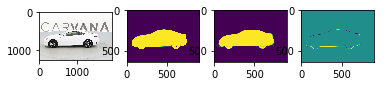

 75%|███████▍  | 763/1018 [45:36<15:06,  3.55s/it]

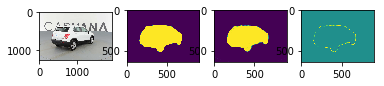

 75%|███████▌  | 764/1018 [45:39<15:00,  3.55s/it]

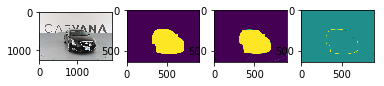

 75%|███████▌  | 765/1018 [45:43<15:13,  3.61s/it]

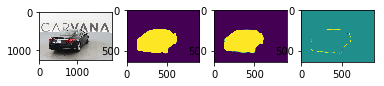

 75%|███████▌  | 766/1018 [45:46<15:06,  3.60s/it]

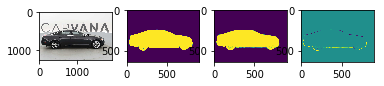

 75%|███████▌  | 767/1018 [45:50<15:03,  3.60s/it]

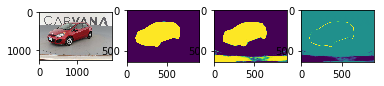

 75%|███████▌  | 768/1018 [45:54<14:56,  3.59s/it]

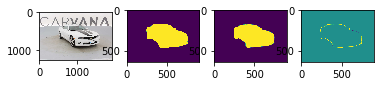

 76%|███████▌  | 769/1018 [45:57<14:51,  3.58s/it]

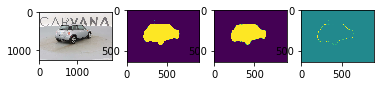

 76%|███████▌  | 770/1018 [46:01<14:40,  3.55s/it]

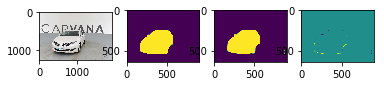

 76%|███████▌  | 771/1018 [46:04<14:39,  3.56s/it]

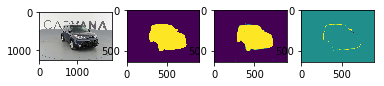

 76%|███████▌  | 772/1018 [46:08<14:37,  3.57s/it]

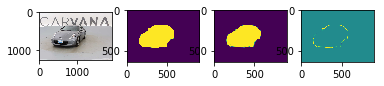

 76%|███████▌  | 773/1018 [46:12<14:50,  3.63s/it]

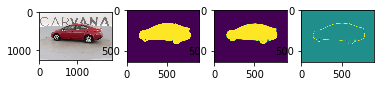

 76%|███████▌  | 774/1018 [46:15<14:37,  3.60s/it]

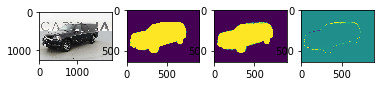

 76%|███████▌  | 775/1018 [46:19<14:29,  3.58s/it]

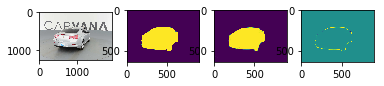

 76%|███████▌  | 776/1018 [46:22<14:20,  3.56s/it]

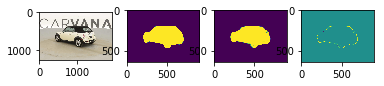

 76%|███████▋  | 777/1018 [46:26<14:14,  3.55s/it]

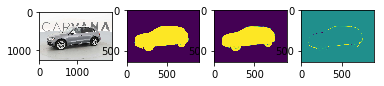

 76%|███████▋  | 778/1018 [46:29<14:06,  3.53s/it]

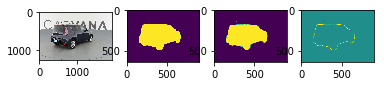

 77%|███████▋  | 779/1018 [46:33<14:03,  3.53s/it]

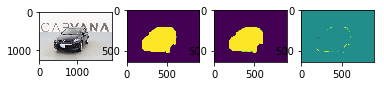

 77%|███████▋  | 780/1018 [46:36<14:18,  3.61s/it]

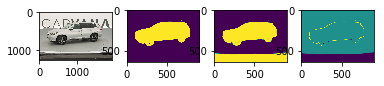

 77%|███████▋  | 781/1018 [46:40<14:09,  3.58s/it]

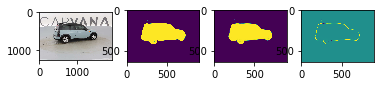

 77%|███████▋  | 782/1018 [46:44<14:02,  3.57s/it]

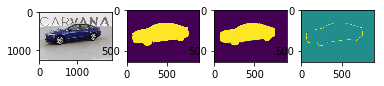

 77%|███████▋  | 783/1018 [46:47<14:02,  3.58s/it]

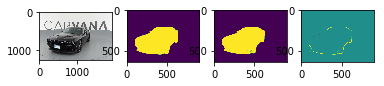

 77%|███████▋  | 784/1018 [46:51<13:54,  3.57s/it]

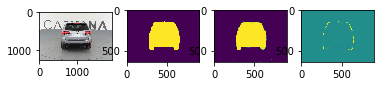

 77%|███████▋  | 785/1018 [46:54<13:52,  3.57s/it]

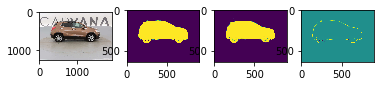

 77%|███████▋  | 786/1018 [46:58<13:50,  3.58s/it]

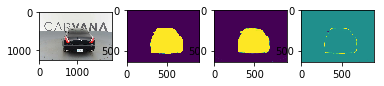

 77%|███████▋  | 787/1018 [47:01<13:42,  3.56s/it]

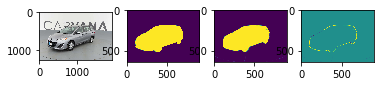

 77%|███████▋  | 788/1018 [47:05<13:55,  3.63s/it]

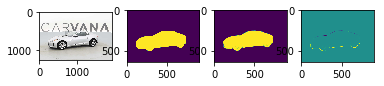

 78%|███████▊  | 789/1018 [47:09<13:50,  3.63s/it]

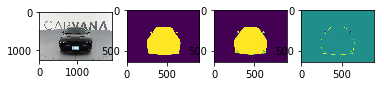

 78%|███████▊  | 790/1018 [47:12<13:41,  3.60s/it]

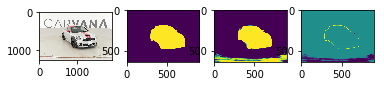

 78%|███████▊  | 791/1018 [47:16<13:35,  3.59s/it]

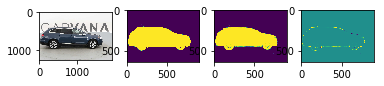

 78%|███████▊  | 792/1018 [47:19<13:26,  3.57s/it]

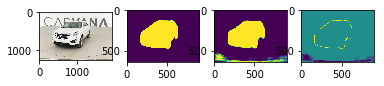

 78%|███████▊  | 793/1018 [47:23<13:23,  3.57s/it]

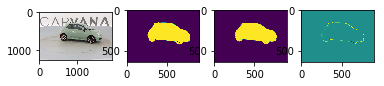

 78%|███████▊  | 794/1018 [47:27<13:17,  3.56s/it]

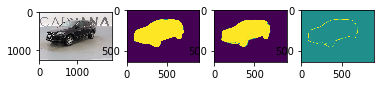

 78%|███████▊  | 795/1018 [47:30<13:16,  3.57s/it]

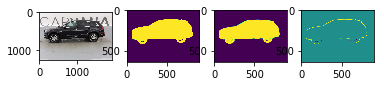

 78%|███████▊  | 796/1018 [47:34<13:28,  3.64s/it]

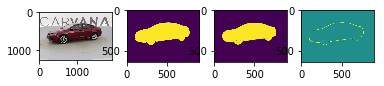

 78%|███████▊  | 797/1018 [47:37<13:19,  3.62s/it]

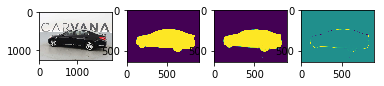

 78%|███████▊  | 798/1018 [47:41<13:05,  3.57s/it]

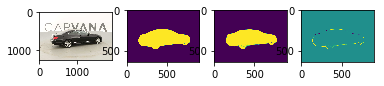

 78%|███████▊  | 799/1018 [47:45<13:03,  3.58s/it]

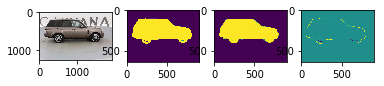

 79%|███████▊  | 800/1018 [47:48<12:55,  3.56s/it]

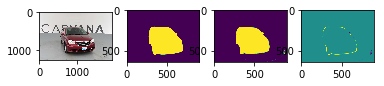

 79%|███████▊  | 801/1018 [47:52<12:49,  3.55s/it]

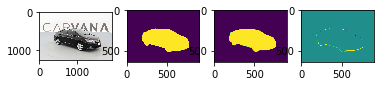

 79%|███████▉  | 802/1018 [47:55<12:47,  3.55s/it]

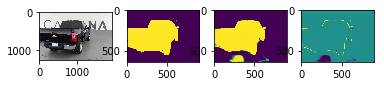

 79%|███████▉  | 803/1018 [47:59<12:54,  3.60s/it]

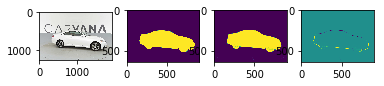

 79%|███████▉  | 804/1018 [48:02<12:43,  3.57s/it]

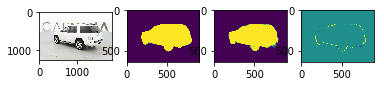

 79%|███████▉  | 805/1018 [48:06<12:38,  3.56s/it]

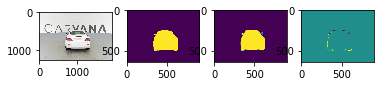

 79%|███████▉  | 806/1018 [48:09<12:32,  3.55s/it]

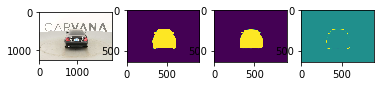

 79%|███████▉  | 807/1018 [48:13<12:26,  3.54s/it]

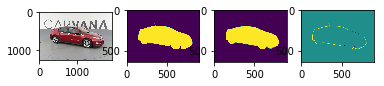

 79%|███████▉  | 808/1018 [48:16<12:24,  3.54s/it]

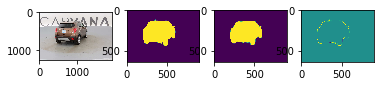

 79%|███████▉  | 809/1018 [48:20<12:18,  3.53s/it]

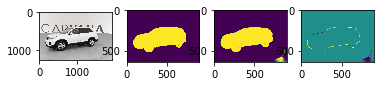

 80%|███████▉  | 810/1018 [48:24<12:19,  3.56s/it]

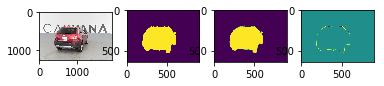

 80%|███████▉  | 811/1018 [48:27<12:30,  3.63s/it]

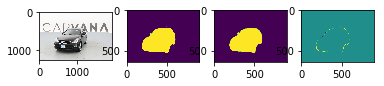

 80%|███████▉  | 812/1018 [48:31<12:18,  3.59s/it]

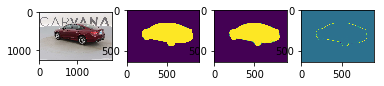

 80%|███████▉  | 813/1018 [48:34<12:12,  3.57s/it]

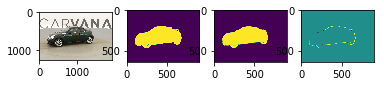

 80%|███████▉  | 814/1018 [48:38<12:01,  3.54s/it]

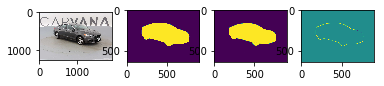

 80%|████████  | 815/1018 [48:41<11:56,  3.53s/it]

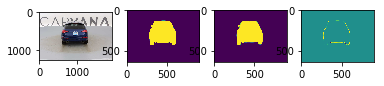

 80%|████████  | 816/1018 [48:45<11:52,  3.53s/it]

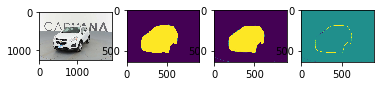

 80%|████████  | 817/1018 [48:48<11:49,  3.53s/it]

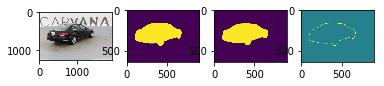

 80%|████████  | 818/1018 [48:52<11:48,  3.54s/it]

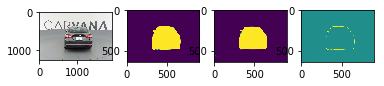

 80%|████████  | 819/1018 [48:56<11:58,  3.61s/it]

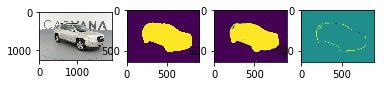

 81%|████████  | 820/1018 [48:59<11:52,  3.60s/it]

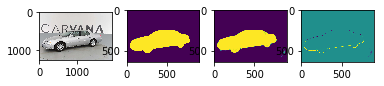

 81%|████████  | 821/1018 [49:03<11:43,  3.57s/it]

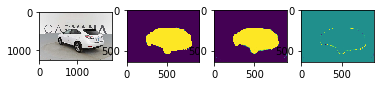

 81%|████████  | 822/1018 [49:06<11:43,  3.59s/it]

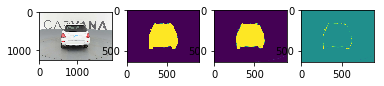

 81%|████████  | 823/1018 [49:10<11:35,  3.57s/it]

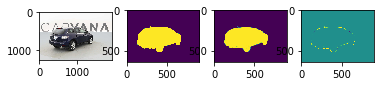

 81%|████████  | 824/1018 [49:13<11:28,  3.55s/it]

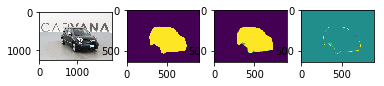

 81%|████████  | 825/1018 [49:17<11:23,  3.54s/it]

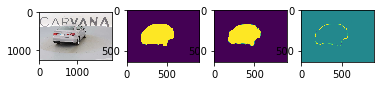

 81%|████████  | 826/1018 [49:21<11:34,  3.62s/it]

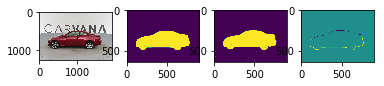

 81%|████████  | 827/1018 [49:24<11:25,  3.59s/it]

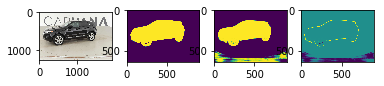

 81%|████████▏ | 828/1018 [49:28<11:21,  3.59s/it]

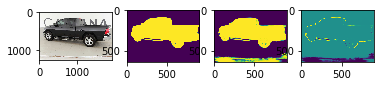

 81%|████████▏ | 829/1018 [49:32<11:17,  3.59s/it]

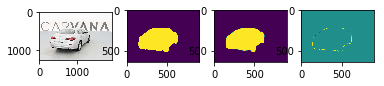

 82%|████████▏ | 830/1018 [49:35<11:15,  3.59s/it]

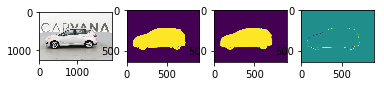

 82%|████████▏ | 831/1018 [49:39<11:12,  3.59s/it]

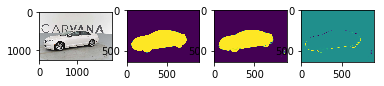

 82%|████████▏ | 832/1018 [49:42<11:06,  3.58s/it]

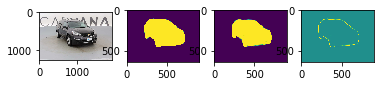

 82%|████████▏ | 833/1018 [49:46<11:01,  3.58s/it]

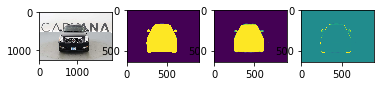

 82%|████████▏ | 834/1018 [49:50<11:06,  3.62s/it]

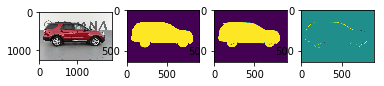

 82%|████████▏ | 835/1018 [49:53<10:55,  3.58s/it]

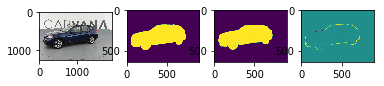

 82%|████████▏ | 836/1018 [49:57<10:50,  3.57s/it]

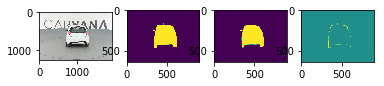

 82%|████████▏ | 837/1018 [50:00<10:46,  3.57s/it]

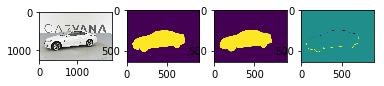

 82%|████████▏ | 838/1018 [50:04<10:39,  3.55s/it]

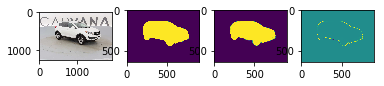

 82%|████████▏ | 839/1018 [50:07<10:36,  3.56s/it]

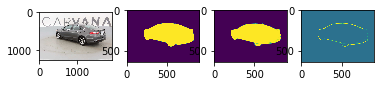

 83%|████████▎ | 840/1018 [50:11<10:35,  3.57s/it]

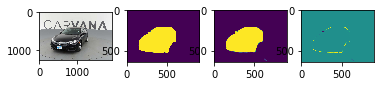

 83%|████████▎ | 841/1018 [50:15<10:41,  3.63s/it]

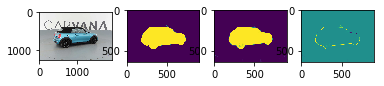

 83%|████████▎ | 842/1018 [50:18<10:37,  3.62s/it]

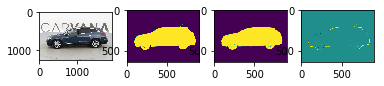

 83%|████████▎ | 843/1018 [50:22<10:32,  3.61s/it]

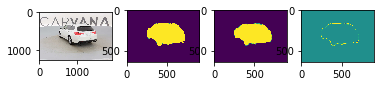

 83%|████████▎ | 844/1018 [50:25<10:22,  3.58s/it]

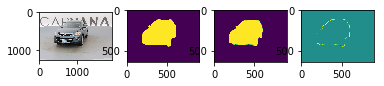

 83%|████████▎ | 845/1018 [50:29<10:15,  3.56s/it]

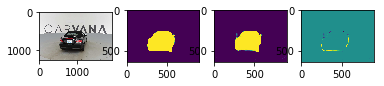

 83%|████████▎ | 846/1018 [50:32<10:09,  3.54s/it]

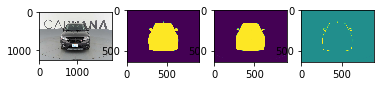

 83%|████████▎ | 847/1018 [50:36<10:04,  3.53s/it]

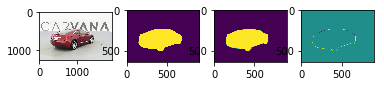

 83%|████████▎ | 848/1018 [50:39<10:03,  3.55s/it]

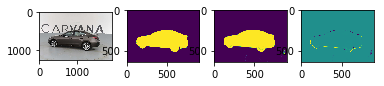

 83%|████████▎ | 849/1018 [50:43<10:13,  3.63s/it]

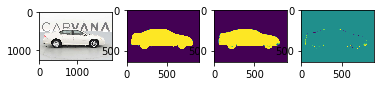

 83%|████████▎ | 850/1018 [50:47<10:09,  3.63s/it]

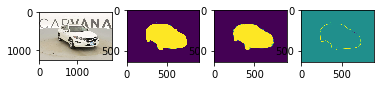

 84%|████████▎ | 851/1018 [50:50<10:01,  3.60s/it]

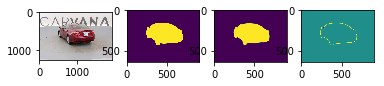

 84%|████████▎ | 852/1018 [50:54<09:54,  3.58s/it]

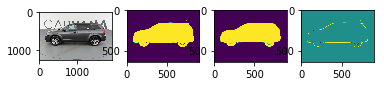

 84%|████████▍ | 853/1018 [50:57<09:49,  3.57s/it]

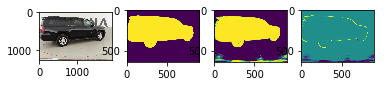

 84%|████████▍ | 854/1018 [51:01<09:43,  3.56s/it]

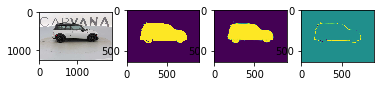

 84%|████████▍ | 855/1018 [51:05<09:41,  3.57s/it]

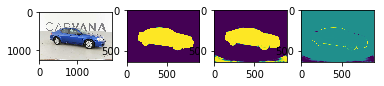

 84%|████████▍ | 856/1018 [51:08<09:46,  3.62s/it]

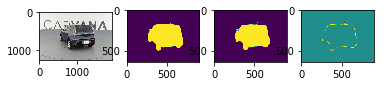

 84%|████████▍ | 857/1018 [51:12<09:43,  3.62s/it]

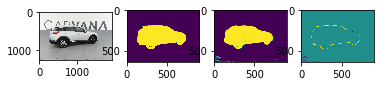

 84%|████████▍ | 858/1018 [51:16<09:38,  3.61s/it]

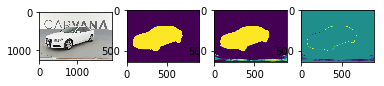

 84%|████████▍ | 859/1018 [51:19<09:34,  3.61s/it]

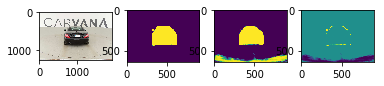

 84%|████████▍ | 860/1018 [51:23<09:29,  3.60s/it]

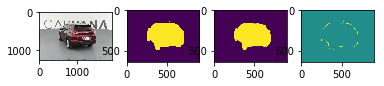

 85%|████████▍ | 861/1018 [51:26<09:22,  3.58s/it]

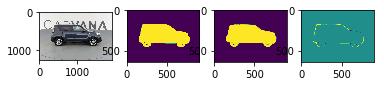

 85%|████████▍ | 862/1018 [51:30<09:17,  3.57s/it]

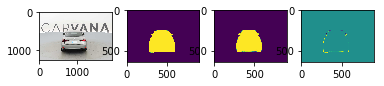

 85%|████████▍ | 863/1018 [51:33<09:14,  3.58s/it]

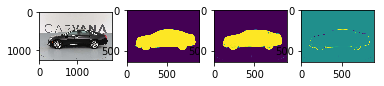

 85%|████████▍ | 864/1018 [51:37<09:19,  3.63s/it]

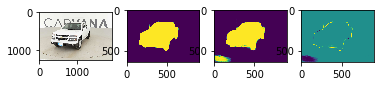

 85%|████████▍ | 865/1018 [51:41<09:15,  3.63s/it]

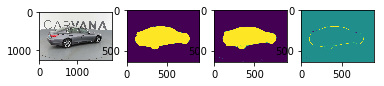

 85%|████████▌ | 866/1018 [51:44<09:10,  3.62s/it]

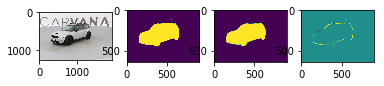

 85%|████████▌ | 867/1018 [51:48<09:04,  3.61s/it]

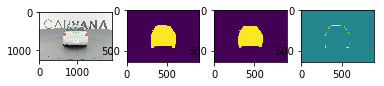

 85%|████████▌ | 868/1018 [51:52<08:56,  3.58s/it]

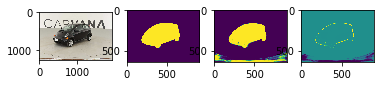

 85%|████████▌ | 869/1018 [51:55<08:52,  3.57s/it]

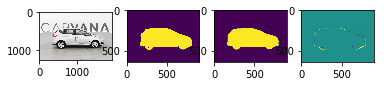

 85%|████████▌ | 870/1018 [51:59<08:46,  3.55s/it]

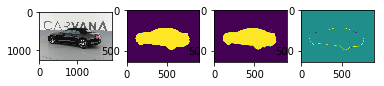

 86%|████████▌ | 871/1018 [52:02<08:48,  3.60s/it]

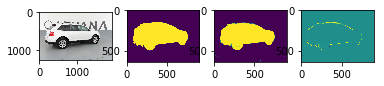

 86%|████████▌ | 872/1018 [52:06<08:44,  3.59s/it]

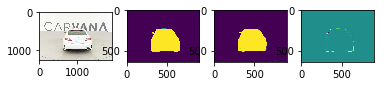

 86%|████████▌ | 873/1018 [52:09<08:37,  3.57s/it]

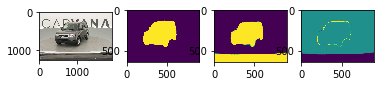

 86%|████████▌ | 874/1018 [52:13<08:31,  3.55s/it]

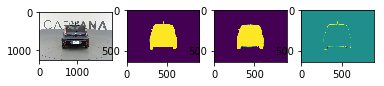

 86%|████████▌ | 875/1018 [52:16<08:26,  3.54s/it]

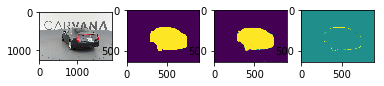

 86%|████████▌ | 876/1018 [52:20<08:24,  3.55s/it]

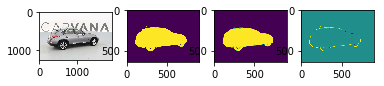

 86%|████████▌ | 877/1018 [52:24<08:20,  3.55s/it]

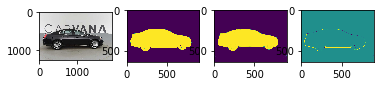

 86%|████████▌ | 878/1018 [52:27<08:14,  3.54s/it]

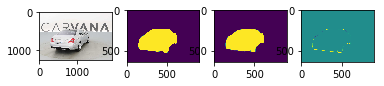

 86%|████████▋ | 879/1018 [52:31<08:21,  3.61s/it]

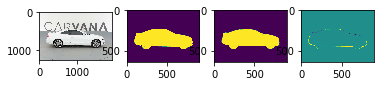

 86%|████████▋ | 880/1018 [52:34<08:15,  3.59s/it]

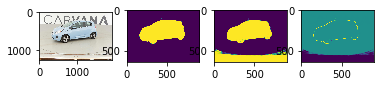

 87%|████████▋ | 881/1018 [52:38<08:07,  3.56s/it]

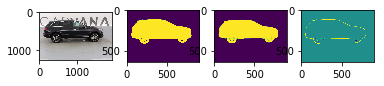

 87%|████████▋ | 882/1018 [52:41<08:02,  3.54s/it]

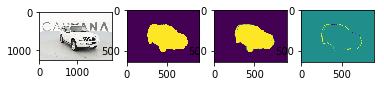

 87%|████████▋ | 883/1018 [52:45<08:00,  3.56s/it]

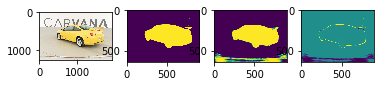

 87%|████████▋ | 884/1018 [52:48<07:57,  3.56s/it]

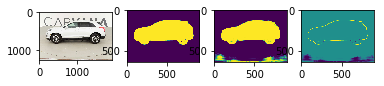

 87%|████████▋ | 885/1018 [52:52<07:54,  3.57s/it]

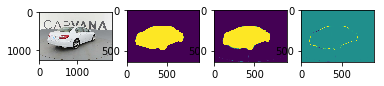

 87%|████████▋ | 886/1018 [52:56<07:58,  3.62s/it]

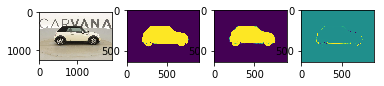

 87%|████████▋ | 887/1018 [52:59<07:51,  3.60s/it]

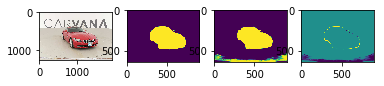

 87%|████████▋ | 888/1018 [53:03<07:45,  3.58s/it]

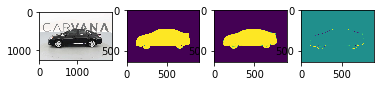

 87%|████████▋ | 889/1018 [53:06<07:39,  3.56s/it]

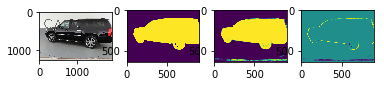

 87%|████████▋ | 890/1018 [53:10<07:37,  3.57s/it]

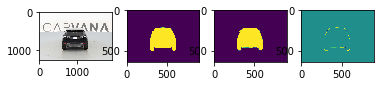

 88%|████████▊ | 891/1018 [53:14<07:32,  3.56s/it]

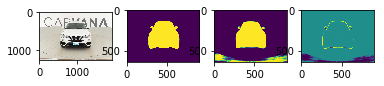

 88%|████████▊ | 892/1018 [53:17<07:25,  3.53s/it]

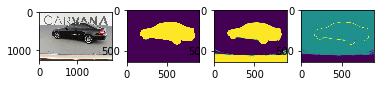

 88%|████████▊ | 893/1018 [53:21<07:21,  3.53s/it]

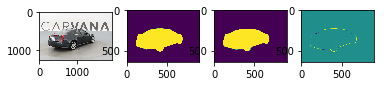

 88%|████████▊ | 894/1018 [53:24<07:27,  3.61s/it]

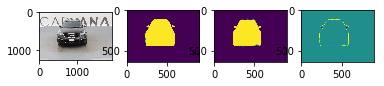

 88%|████████▊ | 895/1018 [53:28<07:23,  3.61s/it]

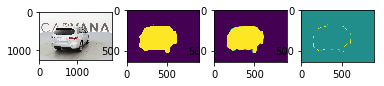

 88%|████████▊ | 896/1018 [53:32<07:19,  3.61s/it]

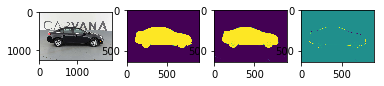

 88%|████████▊ | 897/1018 [53:35<07:12,  3.58s/it]

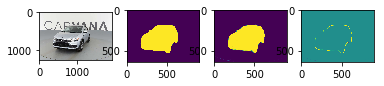

 88%|████████▊ | 898/1018 [53:39<07:07,  3.56s/it]

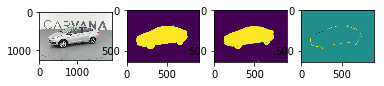

 88%|████████▊ | 899/1018 [53:42<07:03,  3.56s/it]

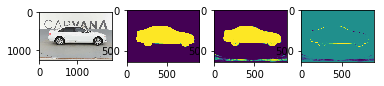

 88%|████████▊ | 900/1018 [53:46<07:01,  3.57s/it]

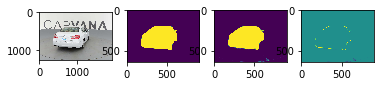

 89%|████████▊ | 901/1018 [53:49<07:04,  3.63s/it]

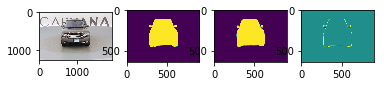

 89%|████████▊ | 902/1018 [53:53<06:59,  3.61s/it]

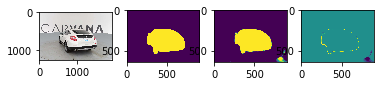

 89%|████████▊ | 903/1018 [53:57<06:53,  3.60s/it]

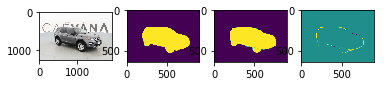

 89%|████████▉ | 904/1018 [54:00<06:50,  3.60s/it]

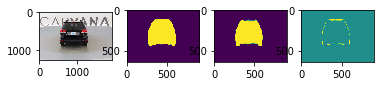

 89%|████████▉ | 905/1018 [54:04<06:46,  3.60s/it]

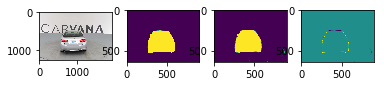

 89%|████████▉ | 906/1018 [54:07<06:41,  3.59s/it]

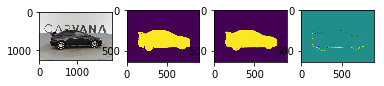

 89%|████████▉ | 907/1018 [54:11<06:37,  3.58s/it]

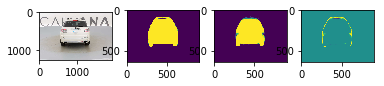

 89%|████████▉ | 908/1018 [54:15<06:32,  3.57s/it]

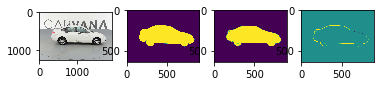

 89%|████████▉ | 909/1018 [54:18<06:34,  3.62s/it]

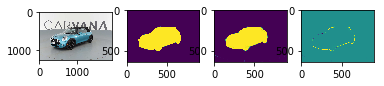

 89%|████████▉ | 910/1018 [54:22<06:28,  3.59s/it]

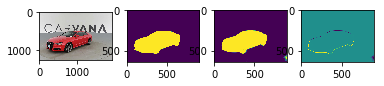

 89%|████████▉ | 911/1018 [54:25<06:20,  3.56s/it]

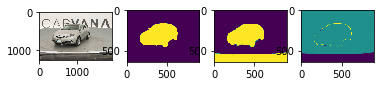

 90%|████████▉ | 912/1018 [54:29<06:14,  3.54s/it]

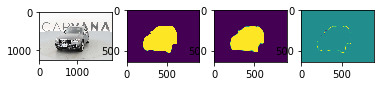

 90%|████████▉ | 913/1018 [54:32<06:09,  3.52s/it]

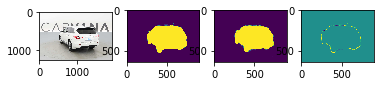

 90%|████████▉ | 914/1018 [54:36<06:07,  3.54s/it]

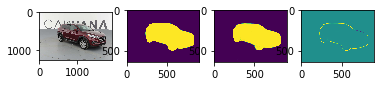

 90%|████████▉ | 915/1018 [54:39<06:03,  3.53s/it]

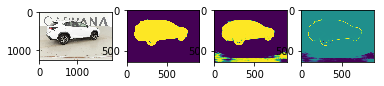

 90%|████████▉ | 916/1018 [54:43<06:08,  3.61s/it]

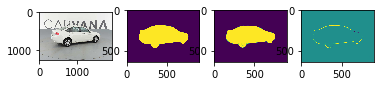

 90%|█████████ | 917/1018 [54:47<06:02,  3.59s/it]

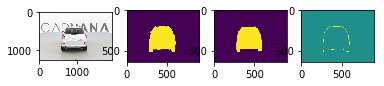

 90%|█████████ | 918/1018 [54:50<05:58,  3.58s/it]

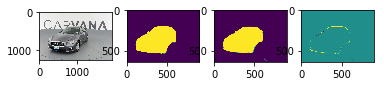

 90%|█████████ | 919/1018 [54:54<05:52,  3.56s/it]

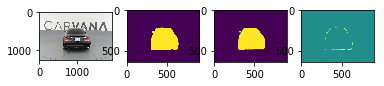

 90%|█████████ | 920/1018 [54:57<05:49,  3.57s/it]

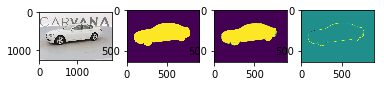

 90%|█████████ | 921/1018 [55:01<05:46,  3.57s/it]

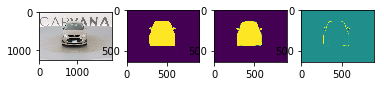

 91%|█████████ | 922/1018 [55:04<05:41,  3.56s/it]

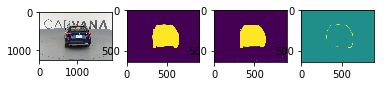

 91%|█████████ | 923/1018 [55:08<05:38,  3.56s/it]

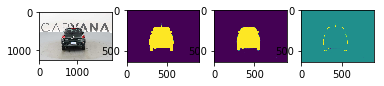

 91%|█████████ | 924/1018 [55:12<05:40,  3.62s/it]

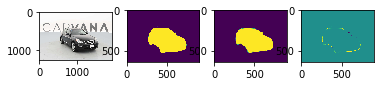

 91%|█████████ | 925/1018 [55:15<05:35,  3.61s/it]

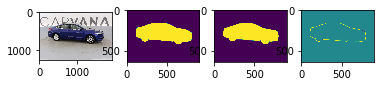

 91%|█████████ | 926/1018 [55:19<05:31,  3.60s/it]

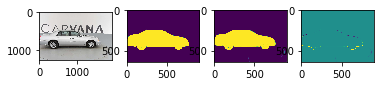

 91%|█████████ | 927/1018 [55:22<05:26,  3.59s/it]

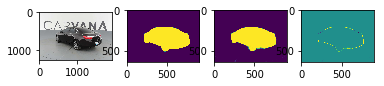

 91%|█████████ | 928/1018 [55:26<05:21,  3.57s/it]

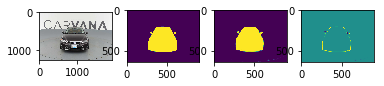

 91%|█████████▏| 929/1018 [55:30<05:18,  3.58s/it]

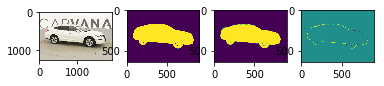

 91%|█████████▏| 930/1018 [55:33<05:13,  3.56s/it]

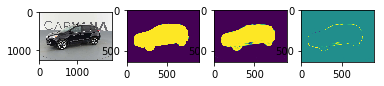

 91%|█████████▏| 931/1018 [55:37<05:17,  3.65s/it]

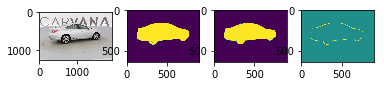

 92%|█████████▏| 932/1018 [55:41<05:10,  3.61s/it]

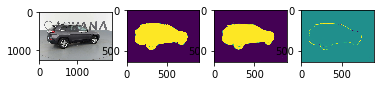

 92%|█████████▏| 933/1018 [55:44<05:04,  3.58s/it]

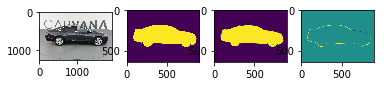

 92%|█████████▏| 934/1018 [55:48<04:59,  3.56s/it]

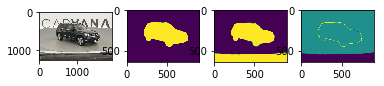

 92%|█████████▏| 935/1018 [55:51<04:54,  3.55s/it]

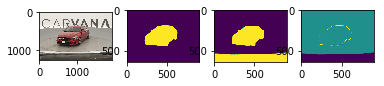

 92%|█████████▏| 936/1018 [55:55<04:51,  3.55s/it]

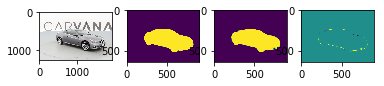

 92%|█████████▏| 937/1018 [55:58<04:46,  3.54s/it]

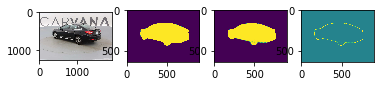

 92%|█████████▏| 938/1018 [56:02<04:42,  3.53s/it]

 92%|█████████▏| 939/1018 [56:05<04:43,  3.59s/it]

 92%|█████████▏| 940/1018 [56:09<04:38,  3.56s/it]

 92%|█████████▏| 941/1018 [56:12<04:35,  3.57s/it]

 93%|█████████▎| 942/1018 [56:16<04:31,  3.57s/it]

 93%|█████████▎| 943/1018 [56:19<04:25,  3.54s/it]

 93%|█████████▎| 944/1018 [56:23<04:21,  3.53s/it]

 93%|█████████▎| 945/1018 [56:27<04:18,  3.54s/it]

 93%|█████████▎| 946/1018 [56:30<04:18,  3.59s/it]

 93%|█████████▎| 947/1018 [56:34<04:13,  3.58s/it]

 93%|█████████▎| 948/1018 [56:37<04:09,  3.56s/it]

 93%|█████████▎| 949/1018 [56:41<04:05,  3.56s/it]

 93%|█████████▎| 950/1018 [56:44<04:02,  3.56s/it]

 93%|█████████▎| 951/1018 [56:48<03:57,  3.54s/it]

 94%|█████████▎| 952/1018 [56:52<03:54,  3.56s/it]

 94%|█████████▎| 953/1018 [56:55<03:51,  3.57s/it]

 94%|█████████▎| 954/1018 [56:59<03:52,  3.63s/it]

 94%|█████████▍| 955/1018 [57:02<03:46,  3.60s/it]

 94%|█████████▍| 956/1018 [57:06<03:43,  3.60s/it]

 94%|█████████▍| 957/1018 [57:10<03:38,  3.58s/it]

 94%|█████████▍| 958/1018 [57:13<03:33,  3.55s/it]

 94%|█████████▍| 959/1018 [57:17<03:30,  3.57s/it]

 94%|█████████▍| 960/1018 [57:20<03:27,  3.57s/it]

 94%|█████████▍| 961/1018 [57:24<03:26,  3.62s/it]

 94%|█████████▍| 962/1018 [57:28<03:22,  3.62s/it]

 95%|█████████▍| 963/1018 [57:31<03:18,  3.60s/it]

 95%|█████████▍| 964/1018 [57:35<03:14,  3.61s/it]

 95%|█████████▍| 965/1018 [57:38<03:09,  3.58s/it]

 95%|█████████▍| 966/1018 [57:42<03:05,  3.58s/it]

 95%|█████████▍| 967/1018 [57:45<03:01,  3.56s/it]

 95%|█████████▌| 968/1018 [57:49<02:58,  3.57s/it]

 95%|█████████▌| 969/1018 [57:53<02:59,  3.66s/it]

 95%|█████████▌| 970/1018 [57:56<02:53,  3.62s/it]

 95%|█████████▌| 971/1018 [58:00<02:48,  3.59s/it]

 95%|█████████▌| 972/1018 [58:03<02:43,  3.56s/it]

 96%|█████████▌| 973/1018 [58:07<02:39,  3.55s/it]

 96%|█████████▌| 974/1018 [58:11<02:36,  3.56s/it]

 96%|█████████▌| 975/1018 [58:14<02:34,  3.58s/it]

 96%|█████████▌| 976/1018 [58:18<02:34,  3.67s/it]

 96%|█████████▌| 977/1018 [58:22<02:29,  3.65s/it]

 96%|█████████▌| 978/1018 [58:25<02:25,  3.64s/it]

 96%|█████████▌| 979/1018 [58:29<02:21,  3.62s/it]

 96%|█████████▋| 980/1018 [58:32<02:17,  3.61s/it]

 96%|█████████▋| 981/1018 [58:36<02:13,  3.60s/it]

 96%|█████████▋| 982/1018 [58:40<02:09,  3.60s/it]

 97%|█████████▋| 983/1018 [58:43<02:05,  3.57s/it]

 97%|█████████▋| 984/1018 [58:47<02:04,  3.65s/it]

 97%|█████████▋| 985/1018 [58:51<02:00,  3.64s/it]

 97%|█████████▋| 986/1018 [58:54<01:55,  3.62s/it]

 97%|█████████▋| 987/1018 [58:58<01:51,  3.60s/it]

 97%|█████████▋| 988/1018 [59:01<01:47,  3.59s/it]

 97%|█████████▋| 989/1018 [59:05<01:43,  3.57s/it]

 97%|█████████▋| 990/1018 [59:08<01:40,  3.58s/it]

 97%|█████████▋| 991/1018 [59:12<01:38,  3.66s/it]

 97%|█████████▋| 992/1018 [59:16<01:33,  3.62s/it]

 98%|█████████▊| 993/1018 [59:19<01:29,  3.60s/it]

 98%|█████████▊| 994/1018 [59:23<01:26,  3.59s/it]

 98%|█████████▊| 995/1018 [59:26<01:22,  3.59s/it]

 98%|█████████▊| 996/1018 [59:30<01:18,  3.57s/it]

 98%|█████████▊| 997/1018 [59:34<01:14,  3.56s/it]

 98%|█████████▊| 998/1018 [59:37<01:11,  3.56s/it]

 98%|█████████▊| 999/1018 [59:41<01:08,  3.62s/it]

 98%|█████████▊| 1000/1018 [59:44<01:04,  3.59s/it]

 98%|█████████▊| 1001/1018 [59:48<01:00,  3.56s/it]

 98%|█████████▊| 1002/1018 [59:51<00:57,  3.56s/it]

 99%|█████████▊| 1003/1018 [59:55<00:53,  3.54s/it]

 99%|█████████▊| 1004/1018 [59:59<00:49,  3.56s/it]

 99%|█████████▊| 1005/1018 [1:00:02<00:46,  3.55s/it]

 99%|█████████▉| 1006/1018 [1:00:06<00:43,  3.63s/it]

 99%|█████████▉| 1007/1018 [1:00:09<00:39,  3.60s/it]

 99%|█████████▉| 1008/1018 [1:00:13<00:35,  3.57s/it]

 99%|█████████▉| 1009/1018 [1:00:16<00:32,  3.56s/it]

 99%|█████████▉| 1010/1018 [1:00:20<00:28,  3.56s/it]

 99%|█████████▉| 1011/1018 [1:00:24<00:25,  3.58s/it]

 99%|█████████▉| 1012/1018 [1:00:27<00:21,  3.57s/it]

100%|█████████▉| 1013/1018 [1:00:31<00:17,  3.56s/it]

100%|█████████▉| 1014/1018 [1:00:34<00:14,  3.64s/it]

100%|█████████▉| 1015/1018 [1:00:38<00:10,  3.61s/it]

100%|█████████▉| 1016/1018 [1:00:42<00:07,  3.60s/it]

100%|█████████▉| 1017/1018 [1:00:45<00:03,  3.58s/it]

100%|██████████| 1018/1018 [1:00:49<00:00,  3.59s/it]


In [137]:
# Calculate the dice coefficient on the validation set. The original image will be predict part by part.
def val_dice_coef2(model, validation_images, data_dir, mask_dir, 
                   pad_width, mode, image_size, input_size, output_size):
    """
    Calculate dice coefficient on validation set on give size. The result will
    be slightly different form original size. But the variance will not be too
    much.
    
    Will save the prediction to disk 
    
    The prediction will be performed patch by patch on each images and combined 
    to 1. Mirror average is used to boost the performance. 
    
    # Args:
    Almost the same as val_dice_coef
    
    # Return:
    dice_mean
    mask_pred:        List of predicted masks
    """
    dices = []
    masks_pred = []
    for image in tqdm(validation_images):
        image, mask = read_image_and_mask(data_dir, mask_dir, image)
        mask = imresize(mask, image_size[::-1]) / 255.
        mask_pred = mirror_average_prediction(model, image, 
                                               96, mode, image_size, input_dims, output_dims)
        # Show image, mask, prediction and difference
        show_4_images(image, mask[:,:,0], mask_pred[:,:], mask[:,:,0]-mask_pred[:,:])
        dices.append(cal_dice_coef(mask[:,:,0], mask_pred))
    with open(tmp_dir + 'masks_pred.pickel', 'wb') as f:
        pickle.dump(masks_pred, f)
    dices = np.array(dices)
    return dices.mean(), mask_pred
mean_dice, mask_pred = val_dice_coef2(model, validation_images, data_dir, mask_dir,
                                      96, 'edge', image_size, input_dims, output_dims)

In [138]:
mean_dice

0.94970620573764786

In [148]:
# Calculate the dice coefficient on the validation set. The original image will be predict part by part.
def val_dice_coef2(model, validation_images, data_dir, mask_dir, 
                   pad_width, mode, image_size, input_size, output_size):
    dices = []
    masks_pred = []
    for image in tqdm(validation_images):
        image, mask = read_image_and_mask(data_dir, mask_dir, image)
        mask = imresize(mask, image_size[::-1]) / 255.
        mask_pred = mirror_average_prediction(model, image, 
                                               96, mode, image_size, input_dims, output_dims)
        mask_pred = remove_artifacts(mask_pred)
        # Show image, mask, prediction and difference
        show_4_images(image, mask[:,:,0], mask_pred[:,:], mask[:,:,0]-mask_pred[:,:])
        dices.append(cal_dice_coef(mask[:,:,0], mask_pred))
    with open(tmp_dir + 'masks_pred-symmetric.pickel') as f:
        pickle.dump(masks_pred, f)
    dices = np.array(dices)
    return dices.mean(), mask_pred
mean_dice, mask_pred = val_dice_coef2(model, validation_images, data_dir, mask_dir,
                                      96, 'edge', image_size, input_dims, output_dims)

  0%|          | 0/1018 [00:00<?, ?it/s]

  0%|          | 1/1018 [00:03<1:00:30,  3.57s/it]

  0%|          | 2/1018 [00:07<1:00:15,  3.56s/it]

  0%|          | 3/1018 [00:10<59:51,  3.54s/it]  

  0%|          | 4/1018 [00:14<59:51,  3.54s/it]

  0%|          | 5/1018 [00:17<1:00:43,  3.60s/it]

  1%|          | 6/1018 [00:21<59:56,  3.55s/it]  

  1%|          | 7/1018 [00:24<59:26,  3.53s/it]

  1%|          | 8/1018 [00:28<59:21,  3.53s/it]

  1%|          | 9/1018 [00:31<59:08,  3.52s/it]

  1%|          | 10/1018 [00:35<59:02,  3.51s/it]

  1%|          | 11/1018 [00:38<59:20,  3.54s/it]

  1%|          | 12/1018 [00:42<59:33,  3.55s/it]

  1%|▏         | 13/1018 [00:46<1:00:30,  3.61s/it]

  1%|▏         | 14/1018 [00:49<1:00:01,  3.59s/it]

  1%|▏         | 15/1018 [00:53<59:36,  3.57s/it]  

KeyboardInterrupt: 